<a href="https://colab.research.google.com/github/ahmedengu/feature_importance/blob/master/Forex/EURUSD/EURUSD_1H_Close.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from IPython.display import clear_output
import pandas as pd

try:
  from findatapy.market import Market, MarketDataRequest, MarketDataGenerator
except:
  # install
  !apt-get install default-jre build-essential swig
  !pip  install h2o==3.24.0.5 yfinance==0.1.43
  !pip  install git+https://github.com/ahmedengu/findatapy.git
  clear_output(wait=True)

  !wget http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz
  !tar -xzvf ta-lib-0.4.0-src.tar.gz
  %cd ta-lib
  !./configure --prefix=/usr
  clear_output(wait=True)
  !make
  clear_output(wait=True)
  !make install
  clear_output(wait=True)
  !pip install Ta-Lib==0.4.17
  clear_output(wait=True)

     |████████████████████████████████| 727kB 2.8MB/s 
  Created wheel for Ta-Lib: filename=TA_Lib-0.4.17-cp36-cp36m-linux_x86_64.whl size=2405580 sha256=72dbdd4a3953ed3e6e2549a8e1fd05c5b20a4c990738bae7458edada20f0859a
  Stored in directory: /root/.cache/pip/wheels/2a/2e/ec/71c565b2e0091e03a2b56abfbfd062f14a01a8d7b20ffe8bd5
Successfully built Ta-Lib


In [0]:
# Experiment Config
import pandas as pd
from IPython.display import display
from IPython.core.debugger import set_trace

data_ticker = "EURUSD"
data_resample = '1H'
data_label = 'Close'
data_label_name = 'y'
start_date = '1 Jan 2018'
finish_date = '1 Jan 2019'
is_duka = True
is_yahoo = False
kaggle_file = 'bitstamp' # default None
kaggle_folder = '1 Day/Stocks'

folds = 0 # should be 0, corss validation cause overfitting

models_summary = {}
for metric in ['accuracy','F1','auc','logloss','mean_per_class_error','rmse','mse']:
  models_summary.update({metric:pd.DataFrame()})

best_models = {}
ensemble_model_threshold = 0.05
split_percentages = [0.2,0.1] # validation size, test size

# feature elimination config
model_selected_features = 50
PCA_k = 50
HCF_threshold = 0.90
LVF_threshold = 0.1
GLRM_k = 20
select_k = 50
select_percentile = 10
select_alpha = 0.1
select_rfe = 50
cv_rfe = 5

features_to_include = ['All', 'DLF', 'XGBF', 'RFE', 'Fwe', 'Super_learner'] # True for all , ['All','Fwe','RFE','RFECV','Percentile','KBest','LVF','HCF','PCA','XGBF','GLMF','DLF','GLRM'] 
algos_to_include = [None, 'GLM' ,'XGBoost' ,'DeepLearning'] # [None, 'DRF', 'GLM' ,'XGBoost' ,'GBM' ,'DeepLearning' ,'StackedEnsemble'], None for all
is_EDA = True
is_minmax = True # use minmax
max_models_num = 10

# pandas options
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [3]:
# random seed
from numpy.random import seed
seed(1)
from tensorflow import set_random_seed
set_random_seed(1)
import pandas as pd
import gc
import os

resample_how= {'Open': 'first', 'High': 'max', 'Low': 'min', 'Close': 'last',
                             'Volume': 'sum', 'Date': 'first'}

if is_duka:
  from findatapy.util import DataConstants

  DataConstants.market_thread_no.update({'dukascopy': 64})

  # Download dataset
  from findatapy.market import Market, MarketDataRequest, MarketDataGenerator

  market = Market(market_data_generator=MarketDataGenerator(log_every_day=30))

  md_request = MarketDataRequest(start_date=start_date, finish_date=finish_date,
                                       fields=['temp', 'ask', 'bid', 'askv', 'bidv'], vendor_fields=['temp', 'ask', 'bid', 'askv', 'bidv'],
                                       freq='tick', data_source='dukascopy',
                                       tickers=[data_ticker], vendor_tickers=[data_ticker])

  temp_dataset = market.fetch_market(md_request)
  full_dataset = pd.DataFrame(temp_dataset[data_ticker + '.bid'].resample(data_resample).ohlc())
  full_dataset.columns = ['Open', 'High', 'Low', 'Close']
  temp_dataset = pd.DataFrame(temp_dataset[data_ticker + '.bidv'].resample(data_resample).sum())
  temp_dataset.columns = ['Volume']
  full_dataset['Volume'] = temp_dataset['Volume']

  del temp_dataset, md_request, market, DataConstants, Market, MarketDataRequest, MarketDataGenerator

  gc.collect()

elif is_yahoo:
  import yfinance as yf
  from datetime import datetime

  full_dataset = yf.download(data_ticker, start=str(datetime.strptime(start_date, '%d %b %Y')).split(' ')[0], end=str(datetime.strptime(finish_date, '%d %b %Y')).split(' ')[0])
  full_dataset['Date']=full_dataset.index
  del yf,datetime

elif data_ticker == 'EURUSD':
  !wget -q https://github.com/philipperemy/FX-1-Minute-Data/raw/master/2000-Jun2019/eurusd/DAT_ASCII_EURUSD_M1_2014.zip
  !wget -q https://github.com/philipperemy/FX-1-Minute-Data/raw/master/2000-Jun2019/eurusd/DAT_ASCII_EURUSD_M1_2015.zip
  !wget -q https://github.com/philipperemy/FX-1-Minute-Data/raw/master/2000-Jun2019/eurusd/DAT_ASCII_EURUSD_M1_2016.zip
  !wget -q https://github.com/philipperemy/FX-1-Minute-Data/raw/master/2000-Jun2019/eurusd/DAT_ASCII_EURUSD_M1_2017.zip
  !wget -q https://github.com/philipperemy/FX-1-Minute-Data/raw/master/2000-Jun2019/eurusd/DAT_ASCII_EURUSD_M1_2018.zip
  !unzip -qq -o \*.zip
  full_dataset = pd.read_csv('DAT_ASCII_EURUSD_M1_2014.csv',names=['Date','Open', 'High', 'Low', 'Close','Volume'], delimiter=';')
  full_dataset = full_dataset.append(pd.read_csv('DAT_ASCII_EURUSD_M1_2015.csv',names=['Date','Open', 'High', 'Low', 'Close','Volume'], delimiter=';'))
  full_dataset = full_dataset.append(pd.read_csv('DAT_ASCII_EURUSD_M1_2016.csv',names=['Date','Open', 'High', 'Low', 'Close','Volume'], delimiter=';'))
  full_dataset = full_dataset.append(pd.read_csv('DAT_ASCII_EURUSD_M1_2017.csv',names=['Date','Open', 'High', 'Low', 'Close','Volume'], delimiter=';'))
  full_dataset = full_dataset.append(pd.read_csv('DAT_ASCII_EURUSD_M1_2018.csv',names=['Date','Open', 'High', 'Low', 'Close','Volume'], delimiter=';'))
  full_dataset['Date'] = pd.to_datetime(full_dataset['Date'])
  full_dataset.index = full_dataset['Date']
  full_dataset = full_dataset.dropna()
  full_dataset = full_dataset.sort_index()
  full_dataset = full_dataset.resample(data_resample, how=resample_how).dropna()
  full_dataset = full_dataset[full_dataset.index > start_date]
  full_dataset = full_dataset[full_dataset.index < finish_date]


    
elif data_ticker == 'APPLUSUSD':
  full_dataset=pd.read_csv('https://github.com/kyleconroy/apple-stock/raw/master/apple_stock_data.csv',index_col =0,parse_dates =[0])

  full_dataset = full_dataset.astype(float)
  full_dataset['Date']=full_dataset.index
  full_dataset = full_dataset[full_dataset.index > '2007-04-01']


elif data_ticker == 'COMI':
  full_dataset=pd.read_csv('https://static.mubasher.info/File.MubasherCharts/File.Historical_Stock_Charts_Dir/44507230b2b03e2da37352abf1a659545b44.csv',index_col =0,names =['Open', 'High', 'Low', 'Close','Volume'],parse_dates =[0])

  full_dataset = full_dataset.astype(float)
  full_dataset['Volume'] = full_dataset['Volume'] * full_dataset['Close'] 
  full_dataset = full_dataset.drop_duplicates()
  full_dataset['Date']=full_dataset.index
  full_dataset = full_dataset[full_dataset.index > start_date]
  full_dataset = full_dataset[full_dataset.index < finish_date]
  
elif kaggle_file is not None:
  if not os.path.isfile('kaggle.json'):
    from google.colab import files
    files.upload()
    
    import time
    time.sleep(10)
    !ls
    !mkdir -p ~/.kaggle
    !cp kaggle.json ~/.kaggle/
    !ls ~/.kaggle

    !chmod 600 /root/.kaggle/kaggle.json
    del files
    
  !kaggle datasets download $data_ticker
  !unzip -qq -o \*.zip
  !unzip -qq -o \*.zip

  if data_ticker == 'mczielinski/bitcoin-historical-data':
    
    full_dataset = pd.read_csv([file for file in os.listdir() if kaggle_file in file][0])
    full_dataset.columns= ['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Volume_(Currency)','Weighted_Price']
    full_dataset.index=pd.to_datetime(full_dataset['Date'], unit='s')

    resample_how.update({'Volume_(Currency)': 'sum', 'Weighted_Price': 'last'})

    full_dataset = full_dataset.resample(data_resample, how=resample_how).dropna()[1:-1]
    full_dataset = full_dataset[full_dataset.index > start_date]
    full_dataset = full_dataset[full_dataset.index < finish_date]
  
  elif data_ticker == 'borismarjanovic/daily-and-intraday-stock-price-data':
    
    full_dataset = pd.read_csv(kaggle_folder + '/' + [file for file in os.listdir(kaggle_folder) if kaggle_file in file][0])
    if 'Time' in full_dataset.columns:
      full_dataset['Date'] = pd.to_datetime(full_dataset['Date'] + ' ' + full_dataset['Time'])
      full_dataset = full_dataset.drop('Time',axis=1)
    full_dataset.columns= ['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'OpenInt']
    full_dataset.index=pd.to_datetime(full_dataset['Date'])

    full_dataset = full_dataset[full_dataset.index > start_date]
    full_dataset = full_dataset[full_dataset.index < finish_date]

  
gc.collect()
full_dataset = full_dataset.dropna()

full_dataset = full_dataset.drop('Date',axis=1, errors='ignore')
full_dataset = full_dataset.sort_index()
full_dataset = full_dataset[-100000:]
display(full_dataset)
display(full_dataset.describe())
full_dataset.to_pickle('full_dataset')
del full_dataset, set_random_seed, seed
gc.collect()

2019-12-08 05:51:41,669 - findatapy.market.datavendorweb - INFO - Request Dukascopy data
2019-12-08 05:51:41,670 - findatapy.market.datavendorweb - INFO - About to download from Dukascopy... for EURUSD
2019-12-08 05:51:47,122 - numexpr.utils - INFO - NumExpr defaulting to 4 threads.
2019-12-08 05:55:15,665 - findatapy.market.datavendorweb - INFO - Downloading... 2018-01-30 00:00:00
2019-12-08 06:02:40,918 - findatapy.market.datavendorweb - INFO - Downloading... 2018-03-30 00:00:00
2019-12-08 06:06:17,646 - findatapy.market.datavendorweb - INFO - Downloading... 2018-04-30 00:00:00
2019-12-08 06:09:59,081 - findatapy.market.datavendorweb - INFO - Downloading... 2018-05-30 00:00:00
2019-12-08 06:13:51,069 - findatapy.market.datavendorweb - INFO - Downloading... 2018-06-30 00:00:00
2019-12-08 06:17:28,027 - findatapy.market.datavendorweb - INFO - Downloading... 2018-07-30 00:00:00
2019-12-08 06:21:13,194 - findatapy.market.datavendorweb - INFO - Downloading... 2018-08-30 00:00:00
2019-12-0

/usr/local/lib/python3.6/dist-packages/findatapy/market/ioengine.py:264: FutureWarning: to_msgpack is deprecated and will be removed in a future version.
It is recommended to use pyarrow for on-the-wire transmission of pandas objects.
  r.set(fname, data_frame.to_msgpack(compress='blosc'))


2019-12-08 06:36:31,744 - findatapy.market.ioengine - WARNING - Couldn't push MarketDataRequest_436__abstract_curve_key-None__category-None__category_key-backtest_default-cat_dukascopy_tick_NYC_EURUSD__cut-NYC__data_source-dukascopy__environment-backtest__expiry_date-NaT__fields-temp_ask_bid_askv_bidv__finish_date-2019-01-01 00:00:00__freq-tick__freq_mult-1__gran_freq-None__resample-None__resample_how-last__start_date-2018-01-01 00:00:00__tickers-EURUSD__trade_side-trade__vendor_fields-temp_ask_bid_askv_bidv__vendor_tickers-EURUSD to Redis: Error 111 connecting to 127.0.0.1:6379. Connection refused.


,Open,High,Low,Close,Volume
Date,,,,,
2018-01-01 22:00:00,1.20102,1.20166,1.20007,1.20136,1687.290039
2018-01-01 23:00:00,1.20137,1.20158,1.20026,1.20106,6885.930176
2018-01-02 00:00:00,1.20105,1.20177,1.20092,1.20160,4362.529785
2018-01-02 01:00:00,1.20159,1.20231,1.20139,1.20154,5860.189941
2018-01-02 02:00:00,1.20153,1.20163,1.20078,1.20095,6161.259766
...,...,...,...,...,...
2018-12-31 18:00:00,1.14515,1.14549,1.14424,1.14452,11589.769531
2018-12-31 19:00:00,1.14452,1.14563,1.14446,1.14534,8138.859863
2018-12-31 20:00:00,1.14536,1.14612,1.14536,1.14561,5789.660156


,Open,High,Low,Close,Volume
count,6221.000000,6221.000000,6221.000000,6221.000000,6221.000000
mean,1.181234,1.182019,1.180465,1.181227,10596.013672
std,0.036889,0.036928,0.036841,0.036890,5908.182617
min,1.121740,1.122470,1.121560,1.121770,5.250000
25%,1.152390,1.153310,1.151610,1.152380,6075.970215
50%,1.169200,1.169930,1.168530,1.169190,10352.379883
75%,1.223890,1.224710,1.223120,1.223900,14169.230469
max,1.254880,1.255530,1.254320,1.254880,146464.656250


0

In [4]:
# OHLC EDA
if is_EDA:
  import pandas_profiling as pp
  display(pp.ProfileReport(pd.read_pickle('full_dataset')))
  del pp

/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/pandas_profiling/describe.py:392: FutureWarning: The join_axes-keyword is deprecated. Use .reindex or .reindex_like on the result to achieve the same functionality.
  variable_stats = pd.concat(ldesc, join_axes=pd.Index([names]), axis=1)


Number of variables,6
Number of observations,6221
Total Missing (%),0.0%
Total size in memory,170.2 KiB
Average record size in memory,28.0 B
Numeric,2
Categorical,0
Boolean,0
Date,1
Text (Unique),0
Rejected,3


In [5]:
# features
from talib._ta_lib import *
import talib
import numpy as np
import os

def fe(last_index = None):
  features_dataset = pd.read_pickle('full_dataset').sort_index()
  if last_index is not None:
    features_dataset = features_dataset[:-last_index]


  periods = np.resize([2, 3, 3, 2], len(features_dataset['Close'])).astype(float)
  timeperiods = [8, 12, 14, 20, 24, 30]
  matypes = [0,1,2,3,4,5,6,8]
  nbdevs = [2, 3, 4, 5]

  # date features
  features_dataset['day'] = features_dataset.index.day
  features_dataset['dayofweek'] = features_dataset.index.dayofweek
  features_dataset['dayofyear'] = features_dataset.index.dayofyear
  features_dataset['days_in_month'] = features_dataset.index.days_in_month
  features_dataset['hour'] = features_dataset.index.hour
  features_dataset['is_month_end'] = pd.factorize(features_dataset.index.is_month_end)[0]
  features_dataset['is_month_start'] = pd.factorize(features_dataset.index.is_month_start)[0]
  features_dataset['is_quarter_end'] = pd.factorize(features_dataset.index.is_quarter_end)[0]
  features_dataset['is_quarter_start'] = pd.factorize(features_dataset.index.is_quarter_start)[0]
  features_dataset['minute'] = features_dataset.index.minute
  features_dataset['month'] = features_dataset.index.month
  features_dataset['quarter'] = features_dataset.index.quarter
  features_dataset['second'] = features_dataset.index.second
  features_dataset['week'] = features_dataset.index.week
  features_dataset['weekday'] = features_dataset.index.weekday
  features_dataset['weekday_name'] = pd.factorize(features_dataset.index.weekday_name)[0]
  features_dataset['weekofyear'] = features_dataset.index.weekofyear

  # Overlap Studies
  features_dataset['HT_TRENDLINE'] = HT_TRENDLINE(features_dataset['Close'])
  features_dataset['mama'], features_dataset['fama'] = MAMA(features_dataset['Close'])
  features_dataset['SAREXT'] = SAREXT(features_dataset['High'], features_dataset['Low'], startvalue=-4e37,
                                      offsetonreverse=-4e37, accelerationinitlong=-4e37,
                                      accelerationlong=-4e37, accelerationmaxlong=-4e37, accelerationinitshort=-4e37,
                                      accelerationshort=-4e37, accelerationmaxshort=-4e37)

  for timeperiod in timeperiods:
      features_dataset['DEMA_' + str(timeperiod)] = DEMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['EMA_' + str(timeperiod)] = EMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['KAMA_' + str(timeperiod)] = KAMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MIDPOINT_' + str(timeperiod)] = MIDPOINT(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MIDPRICE_' + str(timeperiod)] = MIDPRICE(features_dataset['High'], features_dataset['Low'],
                                                                timeperiod=timeperiod)
      features_dataset['SAR_' + str(timeperiod / 100)] = SAR(features_dataset['High'], features_dataset['Low'],
                                                            acceleration=timeperiod / 100,
                                                            maximum=timeperiod / 100)
      features_dataset['SMA_' + str(timeperiod)] = SMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['TEMA_' + str(timeperiod)] = TEMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['TRIMA_' + str(timeperiod)] = TRIMA(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['WMA_' + str(timeperiod)] = WMA(features_dataset['Close'], timeperiod=timeperiod)

      for matype in matypes:
          features_dataset['MA_' + str(timeperiod) + '_' + str(matype)] = MA(features_dataset['Close'],
                                                                            timeperiod=timeperiod, matype=matype)
          features_dataset['MAVP_' + str(timeperiod) + '_' + str(matype)] = MAVP(features_dataset['Close'], periods,
                                                                                minperiod=2,
                                                                                maxperiod=timeperiod, matype=matype)
          features_dataset['T3_' + str(timeperiod) + '_' + str(matype)] = T3(features_dataset['Close'],
                                                                            timeperiod=timeperiod,
                                                                            vfactor=matype / 10)

          for nbdev in nbdevs:
              features_dataset['BBANDS_upperband_' + str(timeperiod) + '_' + str(matype) + '_' + str(nbdev)], \
              features_dataset['BBANDS_middleband_' + str(timeperiod) + '_' + str(matype) + '_' + str(nbdev)], \
              features_dataset['BBANDS_lowerband_' + str(timeperiod) + '_' + str(matype) + '_' + str(nbdev)] = BBANDS(
                  features_dataset['Close'], timeperiod=timeperiod, nbdevup=nbdev, nbdevdn=nbdev, matype=matype)

              
  gc.collect()
  # Momentum Indicators
  features_dataset['BOP'] = BOP(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                features_dataset['Close'])

  for timeperiod in timeperiods:
      features_dataset['ADX_' + str(timeperiod)] = ADX(features_dataset['High'], features_dataset['Low'],
                                                      features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['ADXR_' + str(timeperiod)] = ADXR(features_dataset['High'], features_dataset['Low'],
                                                        features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['aroondown_' + str(timeperiod)], features_dataset['aroonup_' + str(timeperiod)] = AROON(
          features_dataset['High'],
          features_dataset['Low'],
          timeperiod=timeperiod)
      features_dataset['AROONOSC_' + str(timeperiod)] = AROONOSC(features_dataset['High'], features_dataset['Low'],
                                                                timeperiod=timeperiod)
      features_dataset['CCI_' + str(timeperiod)] = CCI(features_dataset['High'], features_dataset['Low'],
                                                      features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['CMO_' + str(timeperiod)] = CMO(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['DX_' + str(timeperiod)] = DX(features_dataset['High'], features_dataset['Low'],
                                                    features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MACDFIX_' + str(timeperiod)], features_dataset['MACDFIX_signal_' + str(timeperiod)], features_dataset[
          'MACDFIX_hist_' + str(timeperiod)] = MACDFIX(features_dataset['Close'], signalperiod=timeperiod)
      features_dataset['MFI_' + str(timeperiod)] = MFI(features_dataset['High'], features_dataset['Low'],
                                                      features_dataset['Close'], features_dataset['Volume'],
                                                      timeperiod=timeperiod)
      features_dataset['MINUS_DI_' + str(timeperiod)] = MINUS_DI(features_dataset['High'], features_dataset['Low'],
                                                                features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MINUS_DM_' + str(timeperiod)] = MINUS_DM(features_dataset['High'], features_dataset['Low'],
                                                                timeperiod=timeperiod)
      features_dataset['MOM_' + str(timeperiod)] = MOM(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['PLUS_DI_' + str(timeperiod)] = PLUS_DI(features_dataset['High'], features_dataset['Low'],
                                                              features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['PLUS_DM_' + str(timeperiod)] = PLUS_DM(features_dataset['High'], features_dataset['Low'],
                                                              timeperiod=timeperiod)
      features_dataset['ROC_' + str(timeperiod)] = ROC(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['ROCP_' + str(timeperiod)] = ROCP(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['ROCR_' + str(timeperiod)] = ROCR(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['ROCR100_' + str(timeperiod)] = ROCR100(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['RSI_' + str(timeperiod)] = RSI(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['TRIX_' + str(timeperiod)] = TRIX(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['WILLR_' + str(timeperiod)] = WILLR(features_dataset['High'], features_dataset['Low'],
                                                          features_dataset['Close'], timeperiod=timeperiod)

      
  gc.collect()
  features_dataset['APO'] = APO(features_dataset['Close'], fastperiod=12, slowperiod=26, matype=0)

  features_dataset['MACD'], features_dataset['MACD_signal'], features_dataset['MACD_hist'] = MACD(
      features_dataset['Close'], fastperiod=12,
      slowperiod=26,
      signalperiod=9)
  features_dataset['MACDEXT'], features_dataset['MACDEXT_signal'], features_dataset['MACDEXT_hist'] = MACDEXT(
      features_dataset['Close'],
      fastperiod=12,
      fastmatype=0,
      slowperiod=26,
      slowmatype=0,
      signalperiod=9,
      signalmatype=0)

  features_dataset['PPO'] = PPO(features_dataset['Close'], fastperiod=12, slowperiod=26, matype=0)

  features_dataset['STOCH_slowk'], features_dataset['STOCH_slowd'] = STOCH(features_dataset['High'],
                                                                          features_dataset['Low'],
                                                                          features_dataset['Close'], fastk_period=5,
                                                                          slowk_period=3, slowk_matype=0,
                                                                          slowd_period=3, slowd_matype=0)
  features_dataset['STOCHF_fastk'], features_dataset['STOCHF_fastd'] = STOCHF(features_dataset['High'],
                                                                              features_dataset['Low'],
                                                                              features_dataset['Close'], fastk_period=5,
                                                                              fastd_period=3, fastd_matype=0)
  features_dataset['STOCHRSI_fastk'], features_dataset['STOCHRSI_fastd'] = STOCHRSI(features_dataset['Close'],
                                                                                    timeperiod=14,
                                                                                    fastk_period=5, fastd_period=3,
                                                                                    fastd_matype=0)
  features_dataset['ULTOSC'] = ULTOSC(features_dataset['High'], features_dataset['Low'], features_dataset['Close'],
                                      timeperiod1=7, timeperiod2=14, timeperiod3=28)

  # Volume Indicators
  features_dataset['AD'] = AD(features_dataset['High'], features_dataset['Low'], features_dataset['Close'],
                              features_dataset['Volume'])
  features_dataset['ADOSC'] = ADOSC(features_dataset['High'], features_dataset['Low'], features_dataset['Close'],
                                    features_dataset['Volume'], fastperiod=3, slowperiod=10)
  features_dataset['OBV'] = OBV(features_dataset['Close'], features_dataset['Volume'])

  gc.collect()
  # Volatility Indicators
  for timeperiod in timeperiods:
      features_dataset['ATR_' + str(timeperiod)] = ATR(features_dataset['High'], features_dataset['Low'],
                                                      features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['NATR_' + str(timeperiod)] = NATR(features_dataset['High'], features_dataset['Low'],
                                                        features_dataset['Close'], timeperiod=timeperiod)

  features_dataset['TRANGE'] = TRANGE(features_dataset['High'], features_dataset['Low'], features_dataset['Close'])

  # Price Transform
  features_dataset['AVGPRICE'] = AVGPRICE(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                          features_dataset['Close'])
  features_dataset['MEDPRICE'] = MEDPRICE(features_dataset['High'], features_dataset['Low'])
  features_dataset['TYPPRICE'] = TYPPRICE(features_dataset['High'], features_dataset['Low'], features_dataset['Close'])
  features_dataset['WCLPRICE'] = WCLPRICE(features_dataset['High'], features_dataset['Low'], features_dataset['Close'])

  gc.collect()
  # Cycle Indicators
  features_dataset['HT_DCPERIOD'] = HT_DCPERIOD(features_dataset['Close'])
  features_dataset['HT_DCPHASE'] = HT_DCPHASE(features_dataset['Close'])
  features_dataset['HT_PHASOR_inphase'], features_dataset['HT_PHASOR_quadrature'] = HT_PHASOR(features_dataset['Close'])
  features_dataset['HT_SINE_sine'], features_dataset['HT_SINE_leadsine'] = HT_SINE(features_dataset['Close'])
  features_dataset['HT_TRENDMODE'] = HT_TRENDMODE(features_dataset['Close'])

  # Pattern Recognition
  features_dataset['CDL2CROWS'] = CDL2CROWS(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDL3BLACKCROWS'] = CDL3BLACKCROWS(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDL3INSIDE'] = CDL3INSIDE(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                              features_dataset['Close'])
  features_dataset['CDL3LINESTRIKE'] = CDL3LINESTRIKE(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDL3OUTSIDE'] = CDL3OUTSIDE(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDL3STARSINSOUTH'] = CDL3STARSINSOUTH(features_dataset['Open'], features_dataset['High'],
                                                          features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDL3WHITESOLDIERS'] = CDL3WHITESOLDIERS(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLABANDONEDBABY'] = CDLABANDONEDBABY(features_dataset['Open'], features_dataset['High'],
                                                          features_dataset['Low'], features_dataset['Close'],
                                                          penetration=0)
  features_dataset['CDLADVANCEBLOCK'] = CDLADVANCEBLOCK(features_dataset['Open'], features_dataset['High'],
                                                        features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLBELTHOLD'] = CDLBELTHOLD(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLBREAKAWAY'] = CDLBREAKAWAY(features_dataset['Open'], features_dataset['High'],
                                                  features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLCLOSINGMARUBOZU'] = CDLCLOSINGMARUBOZU(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLCONCEALBABYSWALL'] = CDLCONCEALBABYSWALL(features_dataset['Open'], features_dataset['High'],
                                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLCOUNTERATTACK'] = CDLCOUNTERATTACK(features_dataset['Open'], features_dataset['High'],
                                                          features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLDARKCLOUDCOVER'] = CDLDARKCLOUDCOVER(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'],
                                                            penetration=0)
  features_dataset['CDLDOJI'] = CDLDOJI(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                        features_dataset['Close'])
  features_dataset['CDLDOJISTAR'] = CDLDOJISTAR(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLDRAGONFLYDOJI'] = CDLDRAGONFLYDOJI(features_dataset['Open'], features_dataset['High'],
                                                          features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLENGULFING'] = CDLENGULFING(features_dataset['Open'], features_dataset['High'],
                                                  features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLEVENINGDOJISTAR'] = CDLEVENINGDOJISTAR(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'],
                                                              penetration=0)
  features_dataset['CDLEVENINGSTAR'] = CDLEVENINGSTAR(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'], penetration=0)
  features_dataset['CDLGAPSIDESIDEWHITE'] = CDLGAPSIDESIDEWHITE(features_dataset['Open'], features_dataset['High'],
                                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLGRAVESTONEDOJI'] = CDLGRAVESTONEDOJI(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLHAMMER'] = CDLHAMMER(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDLHANGINGMAN'] = CDLHANGINGMAN(features_dataset['Open'], features_dataset['High'],
                                                    features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLHARAMI'] = CDLHARAMI(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDLHARAMICROSS'] = CDLHARAMICROSS(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLHIGHWAVE'] = CDLHIGHWAVE(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLHIKKAKE'] = CDLHIKKAKE(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                              features_dataset['Close'])
  features_dataset['CDLHIKKAKEMOD'] = CDLHIKKAKEMOD(features_dataset['Open'], features_dataset['High'],
                                                    features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLHOMINGPIGEON'] = CDLHOMINGPIGEON(features_dataset['Open'], features_dataset['High'],
                                                        features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLIDENTICAL3CROWS'] = CDLIDENTICAL3CROWS(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLINNECK'] = CDLINNECK(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDLINVERTEDHAMMER'] = CDLINVERTEDHAMMER(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLKICKING'] = CDLKICKING(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                              features_dataset['Close'])
  features_dataset['CDLKICKINGBYLENGTH'] = CDLKICKINGBYLENGTH(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLLADDERBOTTOM'] = CDLLADDERBOTTOM(features_dataset['Open'], features_dataset['High'],
                                                        features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLLONGLEGGEDDOJI'] = CDLLONGLEGGEDDOJI(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLLONGLINE'] = CDLLONGLINE(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLMARUBOZU'] = CDLMARUBOZU(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLMATCHINGLOW'] = CDLMATCHINGLOW(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLMATHOLD'] = CDLMATHOLD(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                              features_dataset['Close'], penetration=0)
  features_dataset['CDLMORNINGDOJISTAR'] = CDLMORNINGDOJISTAR(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'],
                                                              penetration=0)
  features_dataset['CDLMORNINGSTAR'] = CDLMORNINGSTAR(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'], penetration=0)
  features_dataset['CDLONNECK'] = CDLONNECK(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDLPIERCING'] = CDLPIERCING(features_dataset['Open'], features_dataset['High'],
                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLRICKSHAWMAN'] = CDLRICKSHAWMAN(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLRISEFALL3METHODS'] = CDLRISEFALL3METHODS(features_dataset['Open'], features_dataset['High'],
                                                                features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSEPARATINGLINES'] = CDLSEPARATINGLINES(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSHOOTINGSTAR'] = CDLSHOOTINGSTAR(features_dataset['Open'], features_dataset['High'],
                                                        features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSHORTLINE'] = CDLSHORTLINE(features_dataset['Open'], features_dataset['High'],
                                                  features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSPINNINGTOP'] = CDLSPINNINGTOP(features_dataset['Open'], features_dataset['High'],
                                                      features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSTALLEDPATTERN'] = CDLSTALLEDPATTERN(features_dataset['Open'], features_dataset['High'],
                                                            features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLSTICKSANDWICH'] = CDLSTICKSANDWICH(features_dataset['Open'], features_dataset['High'],
                                                          features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLTAKURI'] = CDLTAKURI(features_dataset['Open'], features_dataset['High'], features_dataset['Low'],
                                            features_dataset['Close'])
  features_dataset['CDLTASUKIGAP'] = CDLTASUKIGAP(features_dataset['Open'], features_dataset['High'],
                                                  features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLTHRUSTING'] = CDLTHRUSTING(features_dataset['Open'], features_dataset['High'],
                                                  features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLUNIQUE3RIVER'] = CDLUNIQUE3RIVER(features_dataset['Open'], features_dataset['High'],
                                                        features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLUPSIDEGAP2CROWS'] = CDLUPSIDEGAP2CROWS(features_dataset['Open'], features_dataset['High'],
                                                              features_dataset['Low'], features_dataset['Close'])
  features_dataset['CDLXSIDEGAP3METHODS'] = CDLXSIDEGAP3METHODS(features_dataset['Open'], features_dataset['High'],
                                                                features_dataset['Low'], features_dataset['Close'])
  gc.collect()

  # Statistic Functions
  for timeperiod in timeperiods:
      features_dataset['BETA_' + str(timeperiod)] = BETA(features_dataset['High'], features_dataset['Low'],
                                                        timeperiod=timeperiod)
      features_dataset['CORREL_' + str(timeperiod)] = CORREL(features_dataset['High'], features_dataset['Low'],
                                                            timeperiod=timeperiod)
      features_dataset['LINEARREG_' + str(timeperiod)] = LINEARREG(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['LINEARREG_ANGLE_' + str(timeperiod)] = LINEARREG_ANGLE(features_dataset['Close'],
                                                                              timeperiod=timeperiod)
      features_dataset['LINEARREG_INTERCEPT_' + str(timeperiod)] = LINEARREG_INTERCEPT(features_dataset['Close'],
                                                                                      timeperiod=timeperiod)
      features_dataset['LINEARREG_SLOPE_' + str(timeperiod)] = LINEARREG_SLOPE(features_dataset['Close'],
                                                                              timeperiod=timeperiod)
      features_dataset['STDDEV_' + str(timeperiod)] = STDDEV(features_dataset['Close'], timeperiod=timeperiod, nbdev=1)
      features_dataset['TSF_' + str(timeperiod)] = TSF(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['VAR_' + str(timeperiod)] = VAR(features_dataset['Close'], timeperiod=timeperiod, nbdev=1)

      
  gc.collect()
  # Math Transform
  features_dataset['ACOS'] = ACOS(features_dataset['Close'])
  features_dataset['ASIN'] = ASIN(features_dataset['Close'])
  features_dataset['ATAN'] = ATAN(features_dataset['Close'])
  features_dataset['CEIL'] = CEIL(features_dataset['Close'])
  features_dataset['COS'] = COS(features_dataset['Close'])
  features_dataset['COSH'] = COSH(features_dataset['Close'])
  features_dataset['EXP'] = EXP(features_dataset['Close'])
  features_dataset['FLOOR'] = FLOOR(features_dataset['Close'])
  features_dataset['LN'] = LN(features_dataset['Close'])
  features_dataset['LOG10'] = LOG10(features_dataset['Close'])
  features_dataset['SIN'] = SIN(features_dataset['Close'])
  features_dataset['SINH'] = SINH(features_dataset['Close'])
  features_dataset['SQRT'] = SQRT(features_dataset['Close'])
  features_dataset['TAN'] = TAN(features_dataset['Close'])
  features_dataset['TANH'] = TANH(features_dataset['Close'])

  gc.collect()
  # Math Operator
  features_dataset['ADD'] = ADD(features_dataset['High'], features_dataset['Low'])
  features_dataset['DIV'] = DIV(features_dataset['High'], features_dataset['Low'])
  features_dataset['MULT'] = MULT(features_dataset['High'], features_dataset['Low'])
  features_dataset['SUB'] = SUB(features_dataset['High'], features_dataset['Low'])

  for timeperiod in timeperiods:
      features_dataset['MAX_' + str(timeperiod)] = MAX(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MIN_' + str(timeperiod)] = MIN(features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['MINMAX_min_' + str(timeperiod)], features_dataset['MINMAX_max_' + str(timeperiod)] = MINMAX(
          features_dataset['Close'], timeperiod=timeperiod)
      features_dataset['SUM_' + str(timeperiod)] = SUM(features_dataset['Close'], timeperiod=timeperiod)
      
  gc.collect()


  features_dataset = features_dataset.drop(features_dataset.std()[(features_dataset.std() == 0)].index, axis=1)
  features_dataset = features_dataset[50:].replace([np.inf, -np.inf], np.nan).dropna(axis=1)
  features_dataset.to_pickle('features_dataset' if last_index is None else 'features_dataset_' + str(last_index))
  if last_index is None:
    display(features_dataset)
    display(features_dataset.describe())

  del periods, timeperiods, matypes, nbdevs, features_dataset
  gc.collect()

fe()

,Open,High,Low,Close,Volume,day,dayofweek,dayofyear,days_in_month,hour,is_month_end,is_month_start,is_quarter_end,is_quarter_start,month,quarter,week,weekday,weekday_name,weekofyear,mama,fama,SAREXT,DEMA_8,EMA_8,KAMA_8,MIDPOINT_8,MIDPRICE_8,SAR_0.08,SMA_8,TEMA_8,TRIMA_8,WMA_8,MA_8_0,MAVP_8_0,T3_8_0,BBANDS_upperband_8_0_2,BBANDS_middleband_8_0_2,BBANDS_lowerband_8_0_2,BBANDS_upperband_8_0_3,BBANDS_middleband_8_0_3,BBANDS_lowerband_8_0_3,BBANDS_upperband_8_0_4,BBANDS_middleband_8_0_4,BBANDS_lowerband_8_0_4,BBANDS_upperband_8_0_5,BBANDS_middleband_8_0_5,BBANDS_lowerband_8_0_5,MA_8_1,MAVP_8_1,T3_8_1,BBANDS_upperband_8_1_2,BBANDS_middleband_8_1_2,BBANDS_lowerband_8_1_2,BBANDS_upperband_8_1_3,BBANDS_middleband_8_1_3,BBANDS_lowerband_8_1_3,BBANDS_upperband_8_1_4,BBANDS_middleband_8_1_4,BBANDS_lowerband_8_1_4,BBANDS_upperband_8_1_5,BBANDS_middleband_8_1_5,BBANDS_lowerband_8_1_5,MA_8_2,MAVP_8_2,T3_8_2,BBANDS_upperband_8_2_2,BBANDS_middleband_8_2_2,BBANDS_lowerband_8_2_2,BBANDS_upperband_8_2_3,BBANDS_middleband_8_2_3,BBANDS_lowerband_8_2_3,BBANDS_upperband_8_2_4,BBANDS_middleband_8_2_4,BBANDS_lowerband_8_2_4,BBANDS_upperband_8_2_5,BBANDS_middleband_8_2_5,BBANDS_lowerband_8_2_5,MA_8_3,MAVP_8_3,T3_8_3,BBANDS_upperband_8_3_2,BBANDS_middleband_8_3_2,BBANDS_lowerband_8_3_2,BBANDS_upperband_8_3_3,BBANDS_middleband_8_3_3,BBANDS_lowerband_8_3_3,BBANDS_upperband_8_3_4,BBANDS_middleband_8_3_4,BBANDS_lowerband_8_3_4,BBANDS_upperband_8_3_5,BBANDS_middleband_8_3_5,BBANDS_lowerband_8_3_5,MA_8_4,MAVP_8_4,T3_8_4,BBANDS_upperband_8_4_2,BBANDS_middleband_8_4_2,BBANDS_lowerband_8_4_2,BBANDS_upperband_8_4_3,BBANDS_middleband_8_4_3,BBANDS_lowerband_8_4_3,BBANDS_upperband_8_4_4,BBANDS_middleband_8_4_4,BBANDS_lowerband_8_4_4,BBANDS_upperband_8_4_5,BBANDS_middleband_8_4_5,BBANDS_lowerband_8_4_5,MA_8_5,MAVP_8_5,T3_8_5,BBANDS_upperband_8_5_2,BBANDS_middleband_8_5_2,BBANDS_lowerband_8_5_2,BBANDS_upperband_8_5_3,BBANDS_middleband_8_5_3,BBANDS_lowerband_8_5_3,BBANDS_upperband_8_5_4,BBANDS_middleband_8_5_4,BBANDS_lowerband_8_5_4,BBANDS_upperband_8_5_5,BBANDS_middleband_8_5_5,BBANDS_lowerband_8_5_5,MA_8_6,MAVP_8_6,T3_8_6,BBANDS_upperband_8_6_2,BBANDS_middleband_8_6_2,BBANDS_lowerband_8_6_2,BBANDS_upperband_8_6_3,BBANDS_middleband_8_6_3,BBANDS_lowerband_8_6_3,BBANDS_upperband_8_6_4,BBANDS_middleband_8_6_4,BBANDS_lowerband_8_6_4,BBANDS_upperband_8_6_5,BBANDS_middleband_8_6_5,BBANDS_lowerband_8_6_5,MA_8_8,MAVP_8_8,T3_8_8,BBANDS_upperband_8_8_2,BBANDS_middleband_8_8_2,BBANDS_lowerband_8_8_2,BBANDS_upperband_8_8_3,BBANDS_middleband_8_8_3,BBANDS_lowerband_8_8_3,BBANDS_upperband_8_8_4,BBANDS_middleband_8_8_4,BBANDS_lowerband_8_8_4,BBANDS_upperband_8_8_5,BBANDS_middleband_8_8_5,BBANDS_lowerband_8_8_5,DEMA_12,EMA_12,KAMA_12,MIDPOINT_12,MIDPRICE_12,SAR_0.12,SMA_12,TEMA_12,TRIMA_12,WMA_12,MA_12_0,MAVP_12_0,BBANDS_upperband_12_0_2,BBANDS_middleband_12_0_2,BBANDS_lowerband_12_0_2,BBANDS_upperband_12_0_3,BBANDS_middleband_12_0_3,BBANDS_lowerband_12_0_3,BBANDS_upperband_12_0_4,BBANDS_middleband_12_0_4,BBANDS_lowerband_12_0_4,BBANDS_upperband_12_0_5,BBANDS_middleband_12_0_5,BBANDS_lowerband_12_0_5,MA_12_1,MAVP_12_1,BBANDS_upperband_12_1_2,BBANDS_middleband_12_1_2,BBANDS_lowerband_12_1_2,BBANDS_upperband_12_1_3,BBANDS_middleband_12_1_3,BBANDS_lowerband_12_1_3,BBANDS_upperband_12_1_4,BBANDS_middleband_12_1_4,BBANDS_lowerband_12_1_4,BBANDS_upperband_12_1_5,BBANDS_middleband_12_1_5,BBANDS_lowerband_12_1_5,MA_12_2,MAVP_12_2,BBANDS_upperband_12_2_2,BBANDS_middleband_12_2_2,BBANDS_lowerband_12_2_2,BBANDS_upperband_12_2_3,BBANDS_middleband_12_2_3,BBANDS_lowerband_12_2_3,BBANDS_upperband_12_2_4,BBANDS_middleband_12_2_4,BBANDS_lowerband_12_2_4,BBANDS_upperband_12_2_5,BBANDS_middleband_12_2_5,BBANDS_lowerband_12_2_5,MA_12_3,MAVP_12_3,BBANDS_upperband_12_3_2,BBANDS_middleband_12_3_2,BBANDS_lowerband_12_3_2,BBANDS_upperband_12_3_3,BBANDS_middleband_12_3_3,BBANDS_lowerband_12_3_3,BBANDS_upperband_12_3_4,BBANDS_middleband_12_3_4,BBANDS_lowerband_12_3_4,BBANDS_upperband_12_3_5,BBANDS_middleband_12_

,Open,High,Low,Close,Volume,day,dayofweek,dayofyear,days_in_month,hour,is_month_end,is_month_start,is_quarter_end,is_quarter_start,month,quarter,week,weekday,weekday_name,weekofyear,mama,fama,SAREXT,DEMA_8,EMA_8,KAMA_8,MIDPOINT_8,MIDPRICE_8,SAR_0.08,SMA_8,TEMA_8,TRIMA_8,WMA_8,MA_8_0,MAVP_8_0,T3_8_0,BBANDS_upperband_8_0_2,BBANDS_middleband_8_0_2,BBANDS_lowerband_8_0_2,BBANDS_upperband_8_0_3,BBANDS_middleband_8_0_3,BBANDS_lowerband_8_0_3,BBANDS_upperband_8_0_4,BBANDS_middleband_8_0_4,BBANDS_lowerband_8_0_4,BBANDS_upperband_8_0_5,BBANDS_middleband_8_0_5,BBANDS_lowerband_8_0_5,MA_8_1,MAVP_8_1,T3_8_1,BBANDS_upperband_8_1_2,BBANDS_middleband_8_1_2,BBANDS_lowerband_8_1_2,BBANDS_upperband_8_1_3,BBANDS_middleband_8_1_3,BBANDS_lowerband_8_1_3,BBANDS_upperband_8_1_4,BBANDS_middleband_8_1_4,BBANDS_lowerband_8_1_4,BBANDS_upperband_8_1_5,BBANDS_middleband_8_1_5,BBANDS_lowerband_8_1_5,MA_8_2,MAVP_8_2,T3_8_2,BBANDS_upperband_8_2_2,BBANDS_middleband_8_2_2,BBANDS_lowerband_8_2_2,BBANDS_upperband_8_2_3,BBANDS_middleband_8_2_3,BBANDS_lowerband_8_2_3,BBANDS_upperband_8_2_4,BBANDS_middleband_8_2_4,BBANDS_lowerband_8_2_4,BBANDS_upperband_8_2_5,BBANDS_middleband_8_2_5,BBANDS_lowerband_8_2_5,MA_8_3,MAVP_8_3,T3_8_3,BBANDS_upperband_8_3_2,BBANDS_middleband_8_3_2,BBANDS_lowerband_8_3_2,BBANDS_upperband_8_3_3,BBANDS_middleband_8_3_3,BBANDS_lowerband_8_3_3,BBANDS_upperband_8_3_4,BBANDS_middleband_8_3_4,BBANDS_lowerband_8_3_4,BBANDS_upperband_8_3_5,BBANDS_middleband_8_3_5,BBANDS_lowerband_8_3_5,MA_8_4,MAVP_8_4,T3_8_4,BBANDS_upperband_8_4_2,BBANDS_middleband_8_4_2,BBANDS_lowerband_8_4_2,BBANDS_upperband_8_4_3,BBANDS_middleband_8_4_3,BBANDS_lowerband_8_4_3,BBANDS_upperband_8_4_4,BBANDS_middleband_8_4_4,BBANDS_lowerband_8_4_4,BBANDS_upperband_8_4_5,BBANDS_middleband_8_4_5,BBANDS_lowerband_8_4_5,MA_8_5,MAVP_8_5,T3_8_5,BBANDS_upperband_8_5_2,BBANDS_middleband_8_5_2,BBANDS_lowerband_8_5_2,BBANDS_upperband_8_5_3,BBANDS_middleband_8_5_3,BBANDS_lowerband_8_5_3,BBANDS_upperband_8_5_4,BBANDS_middleband_8_5_4,BBANDS_lowerband_8_5_4,BBANDS_upperband_8_5_5,BBANDS_middleband_8_5_5,BBANDS_lowerband_8_5_5,MA_8_6,MAVP_8_6,T3_8_6,BBANDS_upperband_8_6_2,BBANDS_middleband_8_6_2,BBANDS_lowerband_8_6_2,BBANDS_upperband_8_6_3,BBANDS_middleband_8_6_3,BBANDS_lowerband_8_6_3,BBANDS_upperband_8_6_4,BBANDS_middleband_8_6_4,BBANDS_lowerband_8_6_4,BBANDS_upperband_8_6_5,BBANDS_middleband_8_6_5,BBANDS_lowerband_8_6_5,MA_8_8,MAVP_8_8,T3_8_8,BBANDS_upperband_8_8_2,BBANDS_middleband_8_8_2,BBANDS_lowerband_8_8_2,BBANDS_upperband_8_8_3,BBANDS_middleband_8_8_3,BBANDS_lowerband_8_8_3,BBANDS_upperband_8_8_4,BBANDS_middleband_8_8_4,BBANDS_lowerband_8_8_4,BBANDS_upperband_8_8_5,BBANDS_middleband_8_8_5,BBANDS_lowerband_8_8_5,DEMA_12,EMA_12,KAMA_12,MIDPOINT_12,MIDPRICE_12,SAR_0.12,SMA_12,TEMA_12,TRIMA_12,WMA_12,MA_12_0,MAVP_12_0,BBANDS_upperband_12_0_2,BBANDS_middleband_12_0_2,BBANDS_lowerband_12_0_2,BBANDS_upperband_12_0_3,BBANDS_middleband_12_0_3,BBANDS_lowerband_12_0_3,BBANDS_upperband_12_0_4,BBANDS_middleband_12_0_4,BBANDS_lowerband_12_0_4,BBANDS_upperband_12_0_5,BBANDS_middleband_12_0_5,BBANDS_lowerband_12_0_5,MA_12_1,MAVP_12_1,BBANDS_upperband_12_1_2,BBANDS_middleband_12_1_2,BBANDS_lowerband_12_1_2,BBANDS_upperband_12_1_3,BBANDS_middleband_12_1_3,BBANDS_lowerband_12_1_3,BBANDS_upperband_12_1_4,BBANDS_middleband_12_1_4,BBANDS_lowerband_12_1_4,BBANDS_upperband_12_1_5,BBANDS_middleband_12_1_5,BBANDS_lowerband_12_1_5,MA_12_2,MAVP_12_2,BBANDS_upperband_12_2_2,BBANDS_middleband_12_2_2,BBANDS_lowerband_12_2_2,BBANDS_upperband_12_2_3,BBANDS_middleband_12_2_3,BBANDS_lowerband_12_2_3,BBANDS_upperband_12_2_4,BBANDS_middleband_12_2_4,BBANDS_lowerband_12_2_4,BBANDS_upperband_12_2_5,BBANDS_middleband_12_2_5,BBANDS_lowerband_12_2_5,MA_12_3,MAVP_12_3,BBANDS_upperband_12_3_2,BBANDS_middleband_12_3_2,BBANDS_lowerband_12_3_2,BBANDS_upperband_12_3_3,BBANDS_middleband_12_3_3,BBANDS_lowerband_12_3_3,BBANDS_upperband_12_3_4,BBANDS_middleband_12_3_4,BBANDS_lowerband_12_3_4,BBANDS_upperband_12_3_5,BBANDS_middleband_12_

In [6]:
# features EDA
if is_EDA:
  import pandas_profiling as pp
  display(pp.ProfileReport(pd.read_pickle('features_dataset')))
  del pp

Output hidden; open in https://colab.research.google.com to view.

In [7]:
# check features data leakage
fe(100)
long_df = pd.read_pickle('features_dataset')[:-100]
short_df =  pd.read_pickle('features_dataset_100')
if False in (long_df.index.values == short_df.index.values):
  print('mismatch INDEX', long_df.index.values == short_df.index.values)

for aCol in long_df.columns.values:
  try:
    if False in (long_df[aCol].values == short_df[aCol].values):
      print('mismatch, ', aCol, long_df[aCol].values == short_df[aCol].values)
  except:
    print('mismatch exception, ', aCol)

for name in dir():
  if any( n in name for n in talib.get_functions()):
    del globals()[name]

del talib, long_df, short_df
gc.collect()
print('Nothing should be printed above')

Nothing should be printed above


In [8]:
# label and scale
import numpy as np
from sklearn.preprocessing import minmax_scale
import os
import pandas as pd

features_dataset = pd.read_pickle('features_dataset')
label_df = features_dataset[[data_label]]
longs = label_df[data_label].values[1:] > label_df[data_label].values[:-1] 
shorts = label_df[data_label].values[1:] <= label_df[data_label].values[:-1] 
label_df = label_df[:-1]
label_df[data_label_name] = (longs*1 + shorts*0).astype(int)
scaled_df = features_dataset
scaled_df = pd.DataFrame((minmax_scale(scaled_df, axis=0, feature_range=(0, 1)) if is_minmax else scaled_df), columns=scaled_df.columns,
                         index=scaled_df.index)
categorical_columns = features_dataset.select_dtypes(exclude=['float64', 'float32', 'float16', 'float_']).columns

scaled_df[categorical_columns] = features_dataset[categorical_columns]
scaled_df = scaled_df[:-1]
scaled_df[data_label_name] = label_df[data_label_name]

display(scaled_df)
scaled_df.to_pickle('scaled_df') 

label_df[-50:].to_pickle('predict_df')
del features_dataset, categorical_columns, scaled_df, label_df, minmax_scale, shorts, longs
gc.collect()

,Open,High,Low,Close,Volume,day,dayofweek,dayofyear,days_in_month,hour,is_month_end,is_month_start,is_quarter_end,is_quarter_start,month,quarter,week,weekday,weekday_name,weekofyear,mama,fama,SAREXT,DEMA_8,EMA_8,KAMA_8,MIDPOINT_8,MIDPRICE_8,SAR_0.08,SMA_8,TEMA_8,TRIMA_8,WMA_8,MA_8_0,MAVP_8_0,T3_8_0,BBANDS_upperband_8_0_2,BBANDS_middleband_8_0_2,BBANDS_lowerband_8_0_2,BBANDS_upperband_8_0_3,BBANDS_middleband_8_0_3,BBANDS_lowerband_8_0_3,BBANDS_upperband_8_0_4,BBANDS_middleband_8_0_4,BBANDS_lowerband_8_0_4,BBANDS_upperband_8_0_5,BBANDS_middleband_8_0_5,BBANDS_lowerband_8_0_5,MA_8_1,MAVP_8_1,T3_8_1,BBANDS_upperband_8_1_2,BBANDS_middleband_8_1_2,BBANDS_lowerband_8_1_2,BBANDS_upperband_8_1_3,BBANDS_middleband_8_1_3,BBANDS_lowerband_8_1_3,BBANDS_upperband_8_1_4,BBANDS_middleband_8_1_4,BBANDS_lowerband_8_1_4,BBANDS_upperband_8_1_5,BBANDS_middleband_8_1_5,BBANDS_lowerband_8_1_5,MA_8_2,MAVP_8_2,T3_8_2,BBANDS_upperband_8_2_2,BBANDS_middleband_8_2_2,BBANDS_lowerband_8_2_2,BBANDS_upperband_8_2_3,BBANDS_middleband_8_2_3,BBANDS_lowerband_8_2_3,BBANDS_upperband_8_2_4,BBANDS_middleband_8_2_4,BBANDS_lowerband_8_2_4,BBANDS_upperband_8_2_5,BBANDS_middleband_8_2_5,BBANDS_lowerband_8_2_5,MA_8_3,MAVP_8_3,T3_8_3,BBANDS_upperband_8_3_2,BBANDS_middleband_8_3_2,BBANDS_lowerband_8_3_2,BBANDS_upperband_8_3_3,BBANDS_middleband_8_3_3,BBANDS_lowerband_8_3_3,BBANDS_upperband_8_3_4,BBANDS_middleband_8_3_4,BBANDS_lowerband_8_3_4,BBANDS_upperband_8_3_5,BBANDS_middleband_8_3_5,BBANDS_lowerband_8_3_5,MA_8_4,MAVP_8_4,T3_8_4,BBANDS_upperband_8_4_2,BBANDS_middleband_8_4_2,BBANDS_lowerband_8_4_2,BBANDS_upperband_8_4_3,BBANDS_middleband_8_4_3,BBANDS_lowerband_8_4_3,BBANDS_upperband_8_4_4,BBANDS_middleband_8_4_4,BBANDS_lowerband_8_4_4,BBANDS_upperband_8_4_5,BBANDS_middleband_8_4_5,BBANDS_lowerband_8_4_5,MA_8_5,MAVP_8_5,T3_8_5,BBANDS_upperband_8_5_2,BBANDS_middleband_8_5_2,BBANDS_lowerband_8_5_2,BBANDS_upperband_8_5_3,BBANDS_middleband_8_5_3,BBANDS_lowerband_8_5_3,BBANDS_upperband_8_5_4,BBANDS_middleband_8_5_4,BBANDS_lowerband_8_5_4,BBANDS_upperband_8_5_5,BBANDS_middleband_8_5_5,BBANDS_lowerband_8_5_5,MA_8_6,MAVP_8_6,T3_8_6,BBANDS_upperband_8_6_2,BBANDS_middleband_8_6_2,BBANDS_lowerband_8_6_2,BBANDS_upperband_8_6_3,BBANDS_middleband_8_6_3,BBANDS_lowerband_8_6_3,BBANDS_upperband_8_6_4,BBANDS_middleband_8_6_4,BBANDS_lowerband_8_6_4,BBANDS_upperband_8_6_5,BBANDS_middleband_8_6_5,BBANDS_lowerband_8_6_5,MA_8_8,MAVP_8_8,T3_8_8,BBANDS_upperband_8_8_2,BBANDS_middleband_8_8_2,BBANDS_lowerband_8_8_2,BBANDS_upperband_8_8_3,BBANDS_middleband_8_8_3,BBANDS_lowerband_8_8_3,BBANDS_upperband_8_8_4,BBANDS_middleband_8_8_4,BBANDS_lowerband_8_8_4,BBANDS_upperband_8_8_5,BBANDS_middleband_8_8_5,BBANDS_lowerband_8_8_5,DEMA_12,EMA_12,KAMA_12,MIDPOINT_12,MIDPRICE_12,SAR_0.12,SMA_12,TEMA_12,TRIMA_12,WMA_12,MA_12_0,MAVP_12_0,BBANDS_upperband_12_0_2,BBANDS_middleband_12_0_2,BBANDS_lowerband_12_0_2,BBANDS_upperband_12_0_3,BBANDS_middleband_12_0_3,BBANDS_lowerband_12_0_3,BBANDS_upperband_12_0_4,BBANDS_middleband_12_0_4,BBANDS_lowerband_12_0_4,BBANDS_upperband_12_0_5,BBANDS_middleband_12_0_5,BBANDS_lowerband_12_0_5,MA_12_1,MAVP_12_1,BBANDS_upperband_12_1_2,BBANDS_middleband_12_1_2,BBANDS_lowerband_12_1_2,BBANDS_upperband_12_1_3,BBANDS_middleband_12_1_3,BBANDS_lowerband_12_1_3,BBANDS_upperband_12_1_4,BBANDS_middleband_12_1_4,BBANDS_lowerband_12_1_4,BBANDS_upperband_12_1_5,BBANDS_middleband_12_1_5,BBANDS_lowerband_12_1_5,MA_12_2,MAVP_12_2,BBANDS_upperband_12_2_2,BBANDS_middleband_12_2_2,BBANDS_lowerband_12_2_2,BBANDS_upperband_12_2_3,BBANDS_middleband_12_2_3,BBANDS_lowerband_12_2_3,BBANDS_upperband_12_2_4,BBANDS_middleband_12_2_4,BBANDS_lowerband_12_2_4,BBANDS_upperband_12_2_5,BBANDS_middleband_12_2_5,BBANDS_lowerband_12_2_5,MA_12_3,MAVP_12_3,BBANDS_upperband_12_3_2,BBANDS_middleband_12_3_2,BBANDS_lowerband_12_3_2,BBANDS_upperband_12_3_3,BBANDS_middleband_12_3_3,BBANDS_lowerband_12_3_3,BBANDS_upperband_12_3_4,BBANDS_middleband_12_3_4,BBANDS_lowerband_12_3_4,BBANDS_upperband_12_3_5,BBANDS_middleband_12_

0

In [9]:
# load data into h2o
import h2o
import pandas as pd
from h2o.automl import H2OAutoML
import matplotlib.pyplot as plt
import matplotlib as mpl
import time
import gc
import numpy as np

def load_h2o():
  global train_hf, index_splits
  try:
    h2o.cluster().shutdown()
    time.sleep(5)
  except:
    pass

  h2o.init(min_mem_size="9g",nthreads=-1)
  h2o.remove_all()
  train_hf = h2o.H2OFrame(pd.read_pickle('scaled_df'))
  
  gc.collect()
  train_hf[data_label_name] = train_hf[data_label_name].ascharacter().asfactor()
  index_splits = [int(len(train_hf)*(1-(split_percentages[0]+split_percentages[1]))),int(len(train_hf)*(1-split_percentages[1]))]
  gc.collect()


try:
  load_h2o()
except:
  pass

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.4" 2019-07-16; OpenJDK Runtime Environment (build 11.0.4+11-post-Ubuntu-1ubuntu218.04.3); OpenJDK 64-Bit Server VM (build 11.0.4+11-post-Ubuntu-1ubuntu218.04.3, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.6/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpin6ljhaj
  JVM stdout: /tmp/tmpin6ljhaj/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpin6ljhaj/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O cluster uptime:,01 secs
H2O cluster timezone:,Etc/UTC
H2O data parsing timezone:,UTC
H2O cluster version:,3.24.0.5
H2O cluster version age:,5 months and 19 days !!!
H2O cluster name:,H2O_from_python_unknownUser_xorsol
H2O cluster total nodes:,1
H2O cluster free memory:,9 Gb
H2O cluster total cores:,4
H2O cluster allowed cores:,4
H2O cluster status:,"accepting new members, healthy"


Parse progress: |█████████████████████████████████████████████████████████| 100%


In [0]:
# define the model
%matplotlib inline
from h2o.exceptions import H2OJobCancelled
from sklearn.metrics import accuracy_score

def model_train(feature_name='All', model_algo = None,features_list=None,training_frame=None, 
                nfolds=0,max_models=None):
  
  global train_hf, models_summary, features_to_include, max_models_num,best_models
  if features_to_include is not True and feature_name not in features_to_include:
    return []
  
  nfolds = nfolds or folds
  gc.collect()
  model_algo = [model_algo] if isinstance(model_algo,str) else model_algo
  for _ in range(3):
    try:
      aml = H2OAutoML(seed=1, nfolds=nfolds, max_models=(max_models or max_models_num),
                      include_algos=model_algo, keep_cross_validation_predictions=True)
      t_hf = (training_frame or train_hf)
      validation_frame =  t_hf[index_splits[0]:index_splits[1],:] if split_percentages[0] != 0 else None

      aml.train(x=(features_list or list(t_hf.columns[:-1])), y=data_label_name, training_frame=t_hf[:index_splits[0],:], validation_frame=validation_frame, leaderboard_frame=t_hf[index_splits[1]:,:])
      if aml.leader is None:
        return None
      break
    except (KeyboardInterrupt, H2OJobCancelled):
      raise Exception('Stopped')
    except Exception as e:
      print(e)
      load_h2o()
      
  
  important_features = None
  try:
    display(aml.leaderboard.as_data_frame())
    important_features = aml.leader.varimp(use_pandas=True)
    display(important_features)
    important_features = list(important_features['variable'].values)
    aml.leader.varimp_plot()
    display(aml.leader)
    model_performance = aml.leader.model_performance(test_data=t_hf[index_splits[1]:,:])
    for k in models_summary:
      result = getattr(model_performance, k)()
      result = result[0][1] if isinstance(result,list) else result
      models_summary[k] = models_summary[k].append(pd.DataFrame({(model_algo[0] if model_algo is not None else 'All'):[result]},index=[feature_name]))
      display((k,result))
  except Exception as e:
    print(e)
  
  try:
    best_models[str(feature_name) + '_' + str(model_algo)] = {'id':aml.leader.model_id ,'AUC':getattr(model_performance, "auc")(),
                                                              'path': h2o.save_model(aml.leader,force=True)}
    predicted = aml.leader.predict(t_hf).as_data_frame()

    # predicted['predict'] = (predicted['p1'] >= aml.leader.find_threshold_by_max_metric('f1', train=False, valid=True, xval=False)).astype(int)
    predicted.to_csv(str(feature_name) + '_' + str(model_algo) + '.csv', )
    predicted = predicted[['predict']]
    print(predicted)
    start_idx = max(-index_splits[1],-20)
    predicted = predicted[start_idx:]
    predict_df = pd.read_pickle('predict_df')[start_idx:]

    predicted.index = predict_df.index
    predicted[data_label] = predict_df[data_label]

    up_mask = predicted['predict'] == 1
    down_mask = predicted['predict'] == 0

    plt.plot(predicted[data_label], color='tab:blue', label='Actual')
    plt.scatter(predicted.index[up_mask], predicted[data_label][up_mask], marker=mpl.markers.CARETUPBASE, color='tab:green', s=100, label='Up')
    plt.scatter(predicted.index[down_mask], predicted[data_label][down_mask],marker=mpl.markers.CARETDOWNBASE, color='tab:red', s=100, label='Down')
    plt.xticks(rotation = '60')
    
    plt.legend(loc='upper left')
    plt.show()
  except Exception as e:
    print(e)
  
  try:
    display(model_performance)
    model_performance.plot()
  except Exception as e:
    print(e)

  try:
    aml.leader.std_coef_plot()
  except Exception as e:
    print(e)
  
  try:
    aml.leader.plot()
  except Exception as e:
    print(e)
  
  import json
  from PIL import Image
  try:
    model_path = aml.leader.download_mojo(get_genmodel_jar=True)

    try:
      !wget -c https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip && unzip -n h2o-3.24.0.5.zip 

      !java -Xmx6g -cp h2o-3.24.0.5/h2o.jar hex.genmodel.tools.PrintMojo --tree 0 -i $model_path -o model.gv --levels 3 -f 9
      !dot -Tpng model.gv -o model.png

      display(Image.open('model.png'))
    except Exception as e:
      pass

    try:
      !unzip -o -qq $model_path

      with open('experimental/modelDetails.json') as f:
          display(json.load(f)['parameters'])
    except:
      pass
  
  except Exception as e:
    print(e)

  try:
    del aml, predicted, Image, json, model_performance
  except Exception as e:
    print(e)

  gc.collect()

  return important_features

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.544592,0.689139,0.478065,0.498010,0.248014
1,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.533598,0.698022,0.500000,0.502311,0.252317
2,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.532408,0.699592,0.500000,0.502167,0.252172
3,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.511884,0.694386,0.500000,0.500619,0.250619
4,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.500000,0.694029,0.500000,0.500441,0.250441
5,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.500000,0.693401,0.500000,0.500127,0.250127
6,DeepLearning_1_AutoML_20191208_064722,0.498452,0.695560,0.500000,0.501108,0.251109
7,DeepLearning_grid_1_AutoML_20191208_064722_mod...,0.475001,0.719879,0.500000,0.512284,0.262435


,variable,relative_importance,scaled_importance,percentage
0,CDLPIERCING,1.000000,1.000000,0.004246
1,CDLEVENINGDOJISTAR,0.994636,0.994636,0.004223
2,CDLMORNINGDOJISTAR,0.980457,0.980457,0.004163
3,CDLHOMINGPIGEON,0.974026,0.974026,0.004135
4,CDLSTALLEDPATTERN,0.969975,0.969975,0.004118
...,...,...,...,...
947,KAMA_8,0.198186,0.198186,0.000841
948,SAR_0.3,0.198096,0.198096,0.000841
949,BBANDS_middleband_24_5_4,0.197116,0.197116,0.000837
950,EMA_12,0.195337,0.195337,0.000829


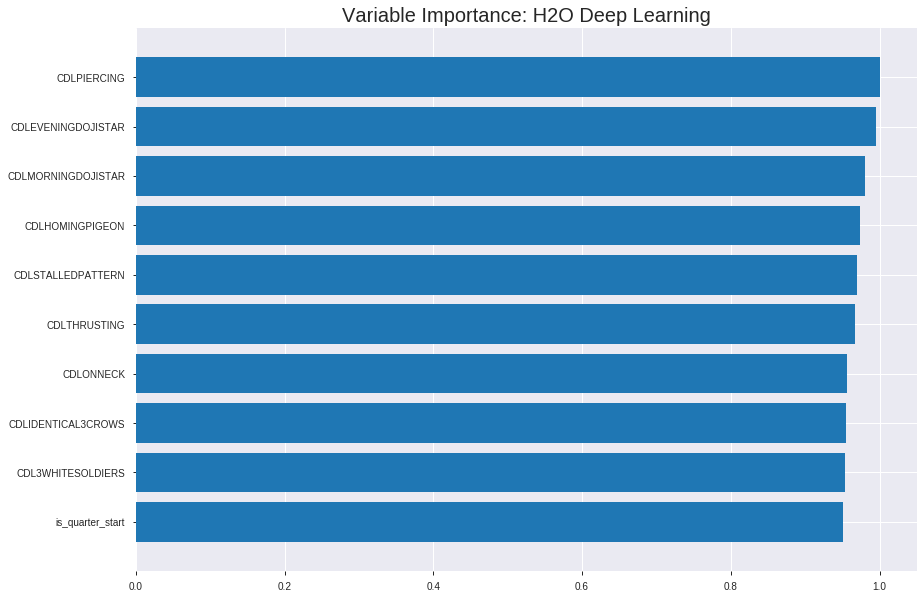

Model Details
H2ODeepLearningEstimator :  Deep Learning
Model Key:  DeepLearning_grid_1_AutoML_20191208_064722_model_4


ModelMetricsBinomial: deeplearning
** Reported on train data. **

MSE: 0.22438932533562733
RMSE: 0.4736975040420071
LogLoss: 0.6341138941207312
Mean Per-Class Error: 0.3894096129784689
AUC: 0.6652317801257545
pr_auc: 0.6632541340920624
Gini: 0.3304635602515089
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3570236394118937: 


,0,1,Error,Rate
0,410.0,1776.0,0.8124,(1776.0/2186.0)
1,93.0,2040.0,0.0436,(93.0/2133.0)
Total,503.0,3816.0,0.4327,(1869.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3570236,0.6858296,287.0
max f2,0.1935904,0.8399366,341.0
max f0point5,0.4852261,0.6071753,198.0
max accuracy,0.4852261,0.6096319,198.0
max precision,0.9992260,1.0,0.0
max recall,0.0071548,1.0,396.0
max specificity,0.9992260,1.0,0.0
max absolute_mcc,0.4362933,0.2314408,241.0
max min_per_class_accuracy,0.4951257,0.6043001,187.0
max mean_per_class_accuracy,0.4852261,0.6105904,198.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 47.95 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.9660405,1.8867898,1.8867898,0.9318182,0.9835737,0.9318182,0.9835737,0.0192218,0.0192218,88.6789839,88.6789839
,2,0.0201436,0.9251312,1.9777582,1.9317512,0.9767442,0.9495338,0.9540230,0.9667494,0.0196906,0.0389123,97.7758153,93.1751190
,3,0.0300996,0.8613253,1.7894002,1.8846659,0.8837209,0.8956177,0.9307692,0.9432212,0.0178153,0.0567276,78.9400233,88.4665873
,4,0.0400556,0.7755711,1.8364897,1.8726915,0.9069767,0.8222157,0.9248555,0.9131447,0.0182841,0.0750117,83.6489713,87.2691452
,5,0.0500116,0.7105446,1.6481318,1.8279874,0.8139535,0.7404022,0.9027778,0.8787561,0.0164088,0.0914205,64.8131794,82.7987446
,6,0.1000232,0.5870675,1.4155185,1.6217530,0.6990741,0.6332654,0.8009259,0.7560107,0.0707923,0.1622128,41.5518484,62.1752965
,7,0.1500347,0.5463551,1.2186583,1.4873881,0.6018519,0.5643590,0.7345679,0.6921268,0.0609470,0.2231599,21.8658297,48.7388076
,8,0.2000463,0.5291229,1.2749041,1.4342671,0.6296296,0.5361600,0.7083333,0.6531351,0.0637600,0.2869198,27.4904065,43.4267073
,9,0.3000695,0.5173811,1.0733567,1.3139636,0.5300926,0.5222436,0.6489198,0.6095046,0.1073605,0.3942804,7.3356731,31.3963626
,10,0.4000926,0.5082662,1.1108539,1.2631862,0.5486111,0.5131201,0.6238426,0.5854085,0.1111111,0.5053915,11.0853909,26.3186197




ModelMetricsBinomial: deeplearning
** Reported on validation data. **

MSE: 0.2510734963767919
RMSE: 0.5010723464498833
LogLoss: 0.695540441729989
Mean Per-Class Error: 0.47205385878489325
AUC: 0.5235612479474548
pr_auc: 0.5194050521752654
Gini: 0.04712249589490969
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.22140216376071584: 


,0,1,Error,Rate
0,6.0,619.0,0.9904,(619.0/625.0)
1,1.0,608.0,0.0016,(1.0/609.0)
Total,7.0,1227.0,0.5024,(620.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2214022,0.6623094,392.0
max f2,0.2214022,0.8299208,392.0
max f0point5,0.2915131,0.5517997,382.0
max accuracy,0.5130747,0.5275527,132.0
max precision,0.8274781,1.0,0.0
max recall,0.1169884,1.0,399.0
max specificity,0.8274781,1.0,0.0
max absolute_mcc,0.6059498,0.0788312,9.0
max min_per_class_accuracy,0.5147865,0.5188834,125.0
max mean_per_class_accuracy,0.5130747,0.5279461,132.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.27 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5955221,1.5586712,1.5586712,0.7692308,0.6546275,0.7692308,0.6546275,0.0164204,0.0164204,55.8671214,55.8671214
,2,0.0202593,0.5608049,0.6754242,1.1347126,0.3333333,0.5755092,0.56,0.6166507,0.0065681,0.0229885,-32.4575807,13.4712644
,3,0.0299838,0.5441963,0.6754242,0.9857542,0.3333333,0.5543145,0.4864865,0.5964336,0.0065681,0.0295567,-32.4575807,-1.4245773
,4,0.0405186,0.5367464,1.2469370,1.0536617,0.6153846,0.5398057,0.52,0.5817103,0.0131363,0.0426929,24.6936971,5.3661741
,5,0.0502431,0.5339659,1.5197044,1.1438636,0.75,0.5353888,0.5645161,0.5727449,0.0147783,0.0574713,51.9704433,14.3863552
,6,0.1004862,0.5286939,0.9477727,1.0458181,0.4677419,0.5311222,0.5161290,0.5519335,0.0476190,0.1050903,-5.2227343,4.5818105
,7,0.1499190,0.5263850,1.1293978,1.0733768,0.5573770,0.5274488,0.5297297,0.5438602,0.0558292,0.1609195,12.9397830,7.3376825
,8,0.2001621,0.5243854,1.1438636,1.0910698,0.5645161,0.5253196,0.5384615,0.5392063,0.0574713,0.2183908,14.3863552,9.1069850
,9,0.2998379,0.5217024,0.9884256,1.0569476,0.4878049,0.5228796,0.5216216,0.5337787,0.0985222,0.3169130,-1.1574352,5.6947588
,10,0.4003241,0.5180204,0.9150908,1.0213398,0.4516129,0.5197742,0.5040486,0.5302634,0.0919540,0.4088670,-8.4909158,2.1339822



Scoring History: 


,timestamp,duration,training_speed,epochs,iterations,samples,training_rmse,training_logloss,training_r2,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_r2,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 06:54:05,0.000 sec,None,0.0,0,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
,2019-12-08 06:54:12,9.156 sec,345 obs/sec,0.5316045,1,2296.0,0.6232250,1.4674927,-0.5538714,0.5180077,0.5127975,1.3805779,0.5061357,0.6491077,1.5666336,-0.6856464,0.5293333,0.5291688,1.4028041,0.5040519
,2019-12-08 06:54:36,33.918 sec,395 obs/sec,2.6459829,5,11428.0,0.6216090,1.4494149,-0.5458237,0.5135954,0.5004344,0.9203853,0.5061357,0.6180802,1.3010707,-0.5283494,0.4717202,0.4560913,0.9352027,0.5064830
,2019-12-08 06:55:02,59.942 sec,434 obs/sec,5.2801574,10,22805.0,0.5500719,0.8685266,-0.2104987,0.5560110,0.5427190,1.1044623,0.5049780,0.5376619,0.8236555,-0.1565157,0.5287842,0.5236486,1.5586712,0.5064830
,2019-12-08 06:55:27,1 min 24.387 sec,458 obs/sec,7.9173420,15,34195.0,0.5535622,0.8805893,-0.2259092,0.5484069,0.5403368,1.4265972,0.5061357,0.6438231,1.3831718,-0.6583115,0.4801156,0.4855010,1.0910698,0.5064830
,2019-12-08 06:55:55,1 min 52.069 sec,480 obs/sec,11.0997916,21,47940.0,0.5134450,0.7459136,-0.0546619,0.5803619,0.5566929,1.2425201,0.4797407,0.5427601,0.8128289,-0.1785524,0.5160591,0.5201780,1.7145383,0.5040519
,2019-12-08 06:56:22,2 min 20.633 sec,493 obs/sec,14.2609400,27,61593.0,0.5430761,0.8149989,-0.1799045,0.5529888,0.5394679,1.2885394,0.4834452,0.5970473,1.0106143,-0.4261018,0.5290719,0.5172604,1.2469370,0.4959481
,2019-12-08 06:56:58,2 min 55.900 sec,506 obs/sec,18.4971058,35,79889.0,0.4893137,0.6679821,0.0421442,0.6030476,0.6114415,1.8407706,0.4677009,0.5365943,0.7790186,-0.1519276,0.4685780,0.4743870,1.2469370,0.5048622
,2019-12-08 06:57:24,3 min 21.999 sec,516 obs/sec,21.6686733,41,93587.0,0.4865291,0.6610470,0.0530150,0.6202104,0.6187660,1.8867898,0.4565872,0.5107025,0.7153394,-0.0434436,0.5204611,0.5129614,1.5586712,0.5032415
,2019-12-08 06:57:51,3 min 48.275 sec,523 obs/sec,24.8594582,47,107368.0,0.4799201,0.6460087,0.0785680,0.6334373,0.6395385,2.0248476,0.4538088,0.5093990,0.7152647,-0.0381240,0.5146588,0.5142530,1.4028041,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
CDLPIERCING,1.0,1.0,0.0042457
CDLEVENINGDOJISTAR,0.9946361,0.9946361,0.0042229
CDLMORNINGDOJISTAR,0.9804568,0.9804568,0.0041627
CDLHOMINGPIGEON,0.9740261,0.9740261,0.0041354
CDLSTALLEDPATTERN,0.9699748,0.9699748,0.0041182
---,---,---,---
KAMA_8,0.1981856,0.1981856,0.0008414
SAR_0.3,0.1980960,0.1980960,0.0008411
BBANDS_middleband_24_5_4,0.1971159,0.1971159,0.0008369
EMA_12,0.1953371,0.1953371,0.0008293



See the whole table with table.as_data_frame()


('accuracy', 0.5494327390599676)

('F1', 0.6894273127753304)

('auc', 0.5445915208188539)

('logloss', 0.6891386800945938)

('mean_per_class_error', 0.45278637770897834)

('rmse', 0.49801018222598853)

('mse', 0.24801414160076232)

deeplearning prediction progress: |███████████████████████████████████████| 100%
      predict
0           0
1           1
2           0
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


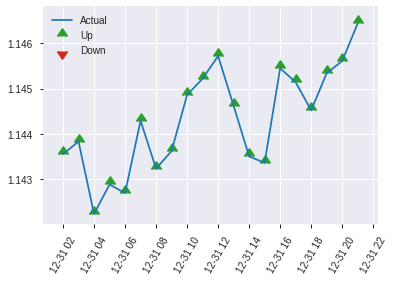


ModelMetricsBinomial: deeplearning
** Reported on test data. **

MSE: 0.24801414160076232
RMSE: 0.49801018222598853
LogLoss: 0.6891386800945938
Mean Per-Class Error: 0.45278637770897834
AUC: 0.5445915208188539
pr_auc: 0.5625544220324645
Gini: 0.08918304163770774
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4597966468680863: 


,0,1,Error,Rate
0,22.0,272.0,0.9252,(272.0/294.0)
1,10.0,313.0,0.031,(10.0/323.0)
Total,32.0,585.0,0.4571,(282.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4597966,0.6894273,370.0
max f2,0.4003972,0.8459927,399.0
max f0point5,0.4786109,0.5895197,338.0
max accuracy,0.5155424,0.5494327,183.0
max precision,0.7042282,1.0,0.0
max recall,0.4003972,1.0,399.0
max specificity,0.7042282,1.0,0.0
max absolute_mcc,0.4786109,0.0994610,338.0
max min_per_class_accuracy,0.5176515,0.5238095,165.0
max mean_per_class_accuracy,0.5155424,0.5472136,183.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 50.95 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5501809,1.0915524,1.0915524,0.5714286,0.5896560,0.5714286,0.5896560,0.0123839,0.0123839,9.1552410,9.1552410
,2,0.0210697,0.5355717,1.2734778,1.1755180,0.6666667,0.5396125,0.6153846,0.5665590,0.0123839,0.0247678,27.3477812,17.5517980
,3,0.0307942,0.5339259,1.5918473,1.3069904,0.8333333,0.5349270,0.6842105,0.5565699,0.0154799,0.0402477,59.1847265,30.6990386
,4,0.0405186,0.5316519,0.3183695,1.0697214,0.1666667,0.5328959,0.56,0.5508882,0.0030960,0.0433437,-68.1630547,6.9721362
,5,0.0502431,0.5304290,1.5918473,1.1707780,0.8333333,0.5310111,0.6129032,0.5470410,0.0154799,0.0588235,59.1847265,17.0777989
,6,0.1004862,0.5274361,1.0475382,1.1091581,0.5483871,0.5288283,0.5806452,0.5379347,0.0526316,0.1114551,4.7538200,10.9158094
,7,0.1507293,0.5257375,1.2940178,1.1707780,0.6774194,0.5264186,0.6129032,0.5340960,0.0650155,0.1764706,29.4017777,17.0777989
,8,0.2009724,0.5247896,1.0475382,1.1399680,0.5483871,0.5252761,0.5967742,0.5318910,0.0526316,0.2291022,4.7538200,13.9968042
,9,0.2998379,0.5223097,0.8455058,1.0428751,0.4426230,0.5237776,0.5459459,0.5292158,0.0835913,0.3126935,-15.4494239,4.2875073
,10,0.4003241,0.5200655,1.0475382,1.0440456,0.5483871,0.5212826,0.5465587,0.5272245,0.1052632,0.4179567,4.7538200,4.4045575


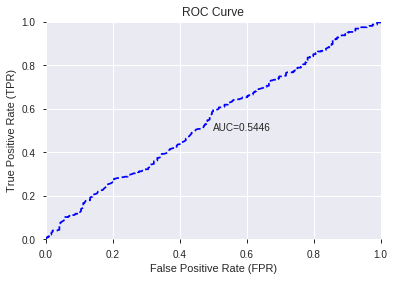

This function is available for GLM models only


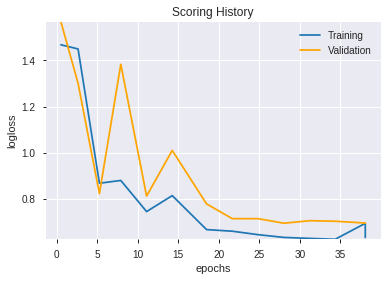

--2019-12-08 07:08:30--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.171.3
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.171.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 368257676 (351M) [application/zip]
Saving to: ‘h2o-3.24.0.5.zip’

h2o-3.24.0.5.zip    100%[===================>] 351.20M  50.3MB/s    in 7.1s    

2019-12-08 07:08:37 (49.4 MB/s) - ‘h2o-3.24.0.5.zip’ saved [368257676/368257676]

Archive:  h2o-3.24.0.5.zip
   creating: h2o-3.24.0.5/
   creating: h2o-3.24.0.5/bindings/
   creating: h2o-3.24.0.5/bindings/java/
 extracting: h2o-3.24.0.5/bindings/java/h2o-bindings-3.24.0.zip  
  inflating: h2o-3.24.0.5/h2o.jar    
   creating: h2o-3.24.0.5/python/
  inflating: h2o-3.24.0.5/python/h2o-3.24.0.5-py2.py3-none-any.whl  
   creating: h2o-3.24.0.5/R/
  inflating: h2o-3.24.0.5/R/h2o_3.24.0.5.tar.gz  
ERROR: Unkno

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/DeepLearning_grid_1_AutoML_20191208_064722_model_4',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'DeepLearning_grid_1_AutoML_20191208_064722_model_4',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_2_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl

952

['CDLPIERCING',
 'CDLEVENINGDOJISTAR',
 'CDLMORNINGDOJISTAR',
 'CDLHOMINGPIGEON',
 'CDLSTALLEDPATTERN',
 'CDLTHRUSTING',
 'CDLONNECK',
 'CDLIDENTICAL3CROWS',
 'CDL3WHITESOLDIERS',
 'is_quarter_start',
 'CDLMORNINGSTAR',
 'CDLDARKCLOUDCOVER',
 'CDL3BLACKCROWS',
 'CDLGAPSIDESIDEWHITE',
 'CDLEVENINGSTAR',
 'CDLINNECK',
 'CDLUNIQUE3RIVER',
 'CDLSHOOTINGSTAR',
 'CDLSEPARATINGLINES',
 'CORREL_8',
 'CDLADVANCEBLOCK',
 'CDLINVERTEDHAMMER',
 'CDLXSIDEGAP3METHODS',
 'is_month_start',
 'CDLHIKKAKEMOD',
 'CDLMATCHINGLOW',
 'is_month_end',
 'CDLHANGINGMAN',
 'CDLTAKURI',
 'CDLDRAGONFLYDOJI',
 'CDLGRAVESTONEDOJI',
 'CDLHAMMER',
 'CDL3LINESTRIKE',
 'CDLSHORTLINE',
 'CDLHARAMICROSS',
 'CORREL_12',
 'hour',
 'aroonup_8',
 'days_in_month',
 'Volume',
 'CORREL_14',
 'BOP',
 'CDLRICKSHAWMAN',
 'STOCHRSI_fastk',
 'CDLLONGLEGGEDDOJI',
 'day',
 'CDLDOJI',
 'HT_TRENDMODE',
 'CDL3INSIDE',
 'weekday_name']

In [11]:
# DeepLearning
features_list = model_train(feature_name='All',model_algo="DeepLearning")
display(len(features_list),features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,DeepLearning_grid_1_AutoML_20191208_070932_model_9,0.529659,0.689175,0.498299,0.498021,0.248025
1,DeepLearning_grid_1_AutoML_20191208_070932_model_7,0.529449,0.701956,0.494745,0.503834,0.253849
2,DeepLearning_grid_1_AutoML_20191208_070932_model_6,0.526010,0.693741,0.496599,0.500241,0.250241
3,DeepLearning_grid_1_AutoML_20191208_070932_model_2,0.522909,0.804126,0.498147,0.538188,0.289646
4,DeepLearning_grid_1_AutoML_20191208_070932_model_4,0.522514,0.710001,0.496446,0.507519,0.257576
5,DeepLearning_grid_1_AutoML_20191208_070932_model_5,0.513821,0.692202,0.496293,0.499587,0.249587
6,DeepLearning_grid_1_AutoML_20191208_070932_model_8,0.509346,0.695579,0.496599,0.501213,0.251215
7,DeepLearning_1_AutoML_20191208_070932,0.500595,0.714695,0.500000,0.509303,0.259390
8,DeepLearning_grid_1_AutoML_20191208_070932_model_3,0.499495,0.745181,0.498299,0.517613,0.267923
9,DeepLearning_grid_1_AutoML_20191208_070932_model_1,0.478433,0.814266,0.500000,0.534763,0.285972


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,1.000000,1.000000,0.028005
1,hour,0.999191,0.999191,0.027982
2,CDLSHORTLINE,0.971776,0.971776,0.027215
3,aroonup_8,0.965970,0.965970,0.027052
4,Volume,0.874831,0.874831,0.024500
5,CDLRICKSHAWMAN,0.842825,0.842825,0.023603
6,is_month_start,0.821665,0.821665,0.023011
7,CORREL_14,0.809769,0.809769,0.022678
8,days_in_month,0.801310,0.801310,0.022441
9,is_month_end,0.792127,0.792127,0.022184


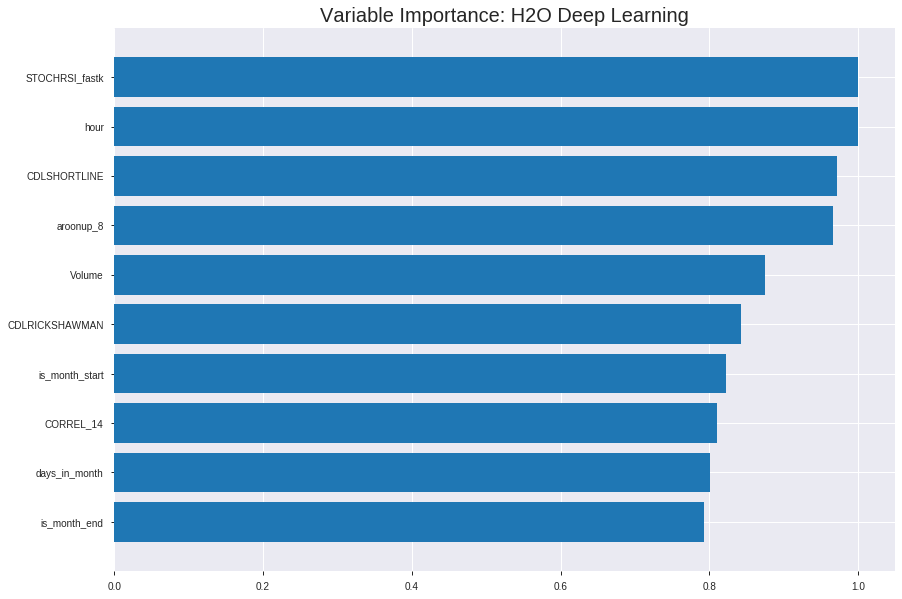

Model Details
H2ODeepLearningEstimator :  Deep Learning
Model Key:  DeepLearning_grid_1_AutoML_20191208_070932_model_9


ModelMetricsBinomial: deeplearning
** Reported on train data. **

MSE: 0.24729579933048804
RMSE: 0.4972884468097847
LogLoss: 0.6876962897236312
Mean Per-Class Error: 0.44977714810482605
AUC: 0.566681850878175
pr_auc: 0.5602242089078509
Gini: 0.13336370175635004
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.46583441627671274: 


,0,1,Error,Rate
0,60.0,2126.0,0.9726,(2126.0/2186.0)
1,25.0,2108.0,0.0117,(25.0/2133.0)
Total,85.0,4234.0,0.498,(2151.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4658344,0.6621643,370.0
max f2,0.4465876,0.8300257,397.0
max f0point5,0.4900189,0.5569058,288.0
max accuracy,0.4969842,0.5512850,252.0
max precision,0.6916174,1.0,0.0
max recall,0.4465876,1.0,397.0
max specificity,0.6916174,1.0,0.0
max absolute_mcc,0.5350727,0.1098150,157.0
max min_per_class_accuracy,0.4963726,0.5471167,256.0
max mean_per_class_accuracy,0.4969842,0.5502229,252.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 50.35 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6322173,1.4265972,1.4265972,0.7045455,0.6506447,0.7045455,0.6506447,0.0145335,0.0145335,42.6597196,42.6597196
,2,0.0201436,0.6147554,1.4597739,1.4429949,0.7209302,0.6220504,0.7126437,0.6365119,0.0145335,0.0290670,45.9773875,44.2994864
,3,0.0300996,0.6019809,1.0359686,1.3083631,0.5116279,0.6071145,0.6461538,0.6267881,0.0103141,0.0393812,3.5968556,30.8363086
,4,0.0400556,0.5917485,1.2714160,1.2991797,0.6279070,0.5969826,0.6416185,0.6193798,0.0126582,0.0520394,27.1415955,29.9179695
,5,0.0500116,0.5804505,1.2243265,1.2842784,0.6046512,0.5856800,0.6342593,0.6126711,0.0121894,0.0642288,22.4326475,28.4278359
,6,0.1000232,0.5439710,1.2936527,1.2889655,0.6388889,0.5627445,0.6365741,0.5877078,0.0646976,0.1289264,29.3652654,28.8965507
,7,0.1500347,0.5176574,1.1717868,1.2499059,0.5787037,0.5295737,0.6172840,0.5683297,0.0586029,0.1875293,17.1786824,24.9905946
,8,0.2000463,0.5083788,0.9749266,1.1811611,0.4814815,0.5122025,0.5833333,0.5542979,0.0487576,0.2362869,-2.5073362,18.1161119
,9,0.3000695,0.4987766,1.0921053,1.1514759,0.5393519,0.5032728,0.5686728,0.5372895,0.1092358,0.3455227,9.2105320,15.1475853
,10,0.4000926,0.4969765,1.0499210,1.1260871,0.5185185,0.4972164,0.5561343,0.5272713,0.1050164,0.4505391,4.9920995,12.6087138




ModelMetricsBinomial: deeplearning
** Reported on validation data. **

MSE: 0.24969798734301646
RMSE: 0.4996978960762357
LogLoss: 0.6925429903392767
Mean Per-Class Error: 0.4701793103448275
AUC: 0.5272893267651888
pr_auc: 0.5195198269933685
Gini: 0.05457865353037761
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4501923179086823: 


,0,1,Error,Rate
0,0.0,625.0,1.0,(625.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,0.0,1234.0,0.5065,(625.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4501923,0.6608790,399.0
max f2,0.4501923,0.8297003,399.0
max f0point5,0.4685021,0.5523739,376.0
max accuracy,0.4969617,0.5299838,238.0
max precision,0.7010856,1.0,0.0
max recall,0.4501923,1.0,399.0
max specificity,0.7010856,1.0,0.0
max absolute_mcc,0.4969617,0.0596564,238.0
max min_per_class_accuracy,0.4969617,0.5172414,238.0
max mean_per_class_accuracy,0.4969617,0.5298207,238.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 50.47 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6269769,1.2469370,1.2469370,0.6153846,0.6514903,0.6153846,0.6514903,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.6086132,1.1819923,1.2157635,0.5833333,0.6157480,0.6,0.6343340,0.0114943,0.0246305,18.1992337,21.5763547
,3,0.0299838,0.5960442,1.1819923,1.2048107,0.5833333,0.6021842,0.5945946,0.6239070,0.0114943,0.0361248,18.1992337,20.4810722
,4,0.0405186,0.5861310,0.7793356,1.0941872,0.3846154,0.5907684,0.54,0.6152910,0.0082102,0.0443350,-22.0664393,9.4187192
,5,0.0502431,0.5809566,1.3508484,1.1438636,0.6666667,0.5827211,0.5645161,0.6089871,0.0131363,0.0574713,35.0848385,14.3863552
,6,0.1004862,0.5508512,1.0131363,1.0784999,0.5,0.5638176,0.5322581,0.5864024,0.0509031,0.1083744,1.3136289,7.8499921
,7,0.1499190,0.5251216,1.0297451,1.0624240,0.5081967,0.5396367,0.5243243,0.5709823,0.0509031,0.1592775,2.9745081,6.2424000
,8,0.2001621,0.5104097,1.1438636,1.0828663,0.5645161,0.5163417,0.5344130,0.5572669,0.0574713,0.2167488,14.3863552,8.2866317
,9,0.2998379,0.5013488,0.9719519,1.0459948,0.4796748,0.5056535,0.5162162,0.5401089,0.0968801,0.3136289,-2.8048113,4.5994763
,10,0.4003241,0.4970041,1.0458181,1.0459504,0.5161290,0.4981382,0.5161943,0.5295738,0.1050903,0.4187192,4.5818105,4.5950420



Scoring History: 


,timestamp,duration,training_speed,epochs,iterations,samples,training_rmse,training_logloss,training_r2,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_r2,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:18:09,0.000 sec,None,0.0,0,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
,2019-12-08 07:18:13,3 min 29.934 sec,1434 obs/sec,1.2058347,1,5208.0,0.4996805,0.6925127,0.0011274,0.5389731,0.5234148,1.0124238,0.5059041,0.5000810,0.6932942,-0.0004921,0.5228690,0.5166138,1.2469370,0.5064830
,2019-12-08 07:18:24,3 min 41.819 sec,2168 obs/sec,7.1984256,6,31090.0,0.5006237,0.6943920,-0.0026473,0.5447030,0.5399723,1.3805779,0.5061357,0.5011844,0.6955210,-0.0049120,0.5177576,0.5217991,1.2469370,0.5064830
,2019-12-08 07:18:37,3 min 53.955 sec,2469 obs/sec,14.4283399,12,62316.0,0.4985179,0.6901647,0.0057698,0.5420628,0.5435119,1.2425201,0.5056726,0.4998798,0.6929163,0.0003125,0.5232197,0.5157683,1.2469370,0.5048622
,2019-12-08 07:18:51,4 min 8.104 sec,2596 obs/sec,22.8951146,19,98884.0,0.4972884,0.6876963,0.0106678,0.5666819,0.5602242,1.4265972,0.4980320,0.4996979,0.6925430,0.0010401,0.5272893,0.5195198,1.2469370,0.5064830
,2019-12-08 07:19:04,4 min 21.467 sec,2695 obs/sec,31.3199815,26,135271.0,0.4984131,0.6899520,0.0061877,0.5518383,0.5561630,1.4726165,0.4968743,0.5007780,0.6947924,-0.0032831,0.5118082,0.5143370,1.4028041,0.5064830
,2019-12-08 07:19:18,4 min 35.637 sec,2804 obs/sec,40.9627229,34,176918.0,0.4970284,0.6871508,0.0117021,0.5704452,0.5685284,1.5646550,0.4982635,0.5036993,0.7008985,-0.0150227,0.5098273,0.5116964,1.0910698,0.5064830
,2019-12-08 07:19:19,4 min 36.948 sec,2802 obs/sec,40.9627229,34,176918.0,0.4972884,0.6876963,0.0106678,0.5666819,0.5602242,1.4265972,0.4980320,0.4996979,0.6925430,0.0010401,0.5272893,0.5195198,1.2469370,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
STOCHRSI_fastk,1.0,1.0,0.0280051
hour,0.9991909,0.9991909,0.0279825
CDLSHORTLINE,0.9717757,0.9717757,0.0272147
aroonup_8,0.9659700,0.9659700,0.0270521
Volume,0.8748313,0.8748313,0.0244998
---,---,---,---
CDLHARAMICROSS,0.5591459,0.5591459,0.0156590
CDLUNIQUE3RIVER,0.5517935,0.5517935,0.0154530
CDLHIKKAKEMOD,0.5435170,0.5435170,0.0152213
CDL3LINESTRIKE,0.5167121,0.5167121,0.0144706



See the whole table with table.as_data_frame()


('accuracy', 0.5413290113452188)

('F1', 0.6879659211927582)

('auc', 0.5296592321138982)

('logloss', 0.689174570597305)

('mean_per_class_error', 0.4539763273730545)

('rmse', 0.4980214697399844)

('mse', 0.2480253843219742)

deeplearning prediction progress: |███████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


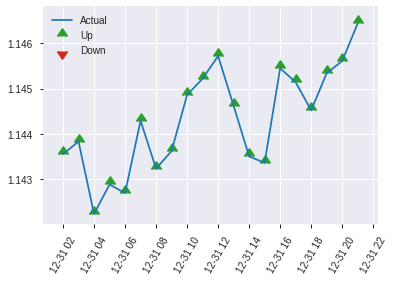


ModelMetricsBinomial: deeplearning
** Reported on test data. **

MSE: 0.2480253843219742
RMSE: 0.4980214697399844
LogLoss: 0.689174570597305
Mean Per-Class Error: 0.4539763273730545
AUC: 0.5296592321138982
pr_auc: 0.5689394160505353
Gini: 0.05931846422779641
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.44739664151751873: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4473966,0.6879659,398.0
max f2,0.4473966,0.8464361,398.0
max f0point5,0.4690359,0.5816969,376.0
max accuracy,0.4876519,0.5413290,281.0
max precision,0.5783985,0.8333333,16.0
max recall,0.4473966,1.0,398.0
max specificity,0.6694167,0.9965986,0.0
max absolute_mcc,0.5159905,0.1383390,74.0
max min_per_class_accuracy,0.4953140,0.5139319,188.0
max mean_per_class_accuracy,0.5159905,0.5460237,74.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.99 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6140773,1.3644405,1.3644405,0.7142857,0.6356158,0.7142857,0.6356158,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.5893516,1.5918473,1.4693975,0.8333333,0.6004889,0.7692308,0.6194033,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.5742769,1.5918473,1.5080658,0.8333333,0.5802282,0.7894737,0.6070322,0.0154799,0.0464396,59.1847265,50.8065830
,4,0.0405186,0.5661986,1.5918473,1.5281734,0.8333333,0.5685481,0.8,0.5977961,0.0154799,0.0619195,59.1847265,52.8173375
,5,0.0502431,0.5560485,0.9551084,1.4172576,0.5,0.5623396,0.7419355,0.5909335,0.0092879,0.0712074,-4.4891641,41.7257565
,6,0.1004862,0.5257263,1.2323979,1.3248277,0.6451613,0.5409826,0.6935484,0.5659580,0.0619195,0.1331269,23.2397883,32.4827724
,7,0.1507293,0.5108124,0.9242984,1.1913180,0.4838710,0.5166633,0.6236559,0.5495265,0.0464396,0.1795666,-7.5701588,19.1317953
,8,0.2009724,0.5057358,0.9859183,1.1399680,0.5161290,0.5083258,0.5967742,0.5392263,0.0495356,0.2291022,-1.4081694,13.9968042
,9,0.2998379,0.4971626,0.7515607,1.0118986,0.3934426,0.5017729,0.5297297,0.5268768,0.0743034,0.3034056,-24.8439324,1.1898586
,10,0.4003241,0.4969712,0.9551084,0.9976435,0.5,0.4970126,0.5222672,0.5193805,0.0959752,0.3993808,-4.4891641,-0.2356451


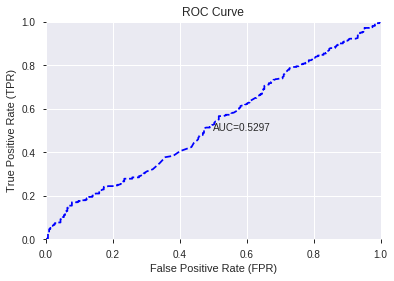

This function is available for GLM models only


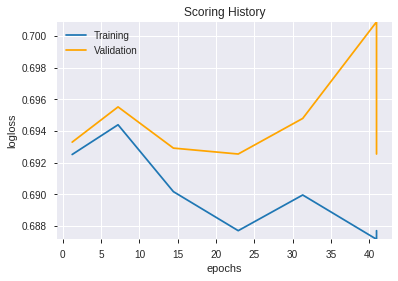

--2019-12-08 07:19:32--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.136.59
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.136.59|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/DeepLearning_grid_1_AutoML_20191208_070932_model_9',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'DeepLearning_grid_1_AutoML_20191208_070932_model_9',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_7_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl

['STOCHRSI_fastk',
 'hour',
 'CDLSHORTLINE',
 'aroonup_8',
 'Volume',
 'CDLRICKSHAWMAN',
 'is_month_start',
 'CORREL_14',
 'days_in_month',
 'is_month_end',
 'CDLMATCHINGLOW',
 'HT_TRENDMODE',
 'CDLSHOOTINGSTAR',
 'CORREL_12',
 'CDLADVANCEBLOCK',
 'CDLGRAVESTONEDOJI',
 'day',
 'CDLMORNINGSTAR',
 'CORREL_8',
 'BOP',
 'CDLLONGLEGGEDDOJI',
 'CDLINVERTEDHAMMER',
 'CDLTAKURI',
 'CDLHANGINGMAN',
 'CDLSTALLEDPATTERN',
 'CDLEVENINGSTAR',
 'CDLGAPSIDESIDEWHITE',
 'CDLHAMMER',
 'CDLDOJI',
 'CDLDRAGONFLYDOJI',
 'CDLIDENTICAL3CROWS',
 'CDLTHRUSTING',
 'CDLEVENINGDOJISTAR',
 'CDL3WHITESOLDIERS',
 'CDLPIERCING',
 'CDLMORNINGDOJISTAR',
 'is_quarter_start',
 'CDLSEPARATINGLINES',
 'CDLDARKCLOUDCOVER',
 'CDLONNECK',
 'weekday_name',
 'CDLXSIDEGAP3METHODS',
 'CDL3BLACKCROWS',
 'CDLINNECK',
 'CDLHOMINGPIGEON',
 'CDLHARAMICROSS',
 'CDLUNIQUE3RIVER',
 'CDLHIKKAKEMOD',
 'CDL3LINESTRIKE',
 'CDL3INSIDE']

In [12]:
# DeepLearning with top DeepLearning features
model_train(feature_name='DLF',model_algo="DeepLearning",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_072029_model_1,0.531365,0.691863,0.491039,0.499366,0.249366


,variable,relative_importance,scaled_importance,percentage
0,aroonup_8,0.026862,1.000000,0.071156
1,CDLSHORTLINE,0.025899,0.964129,0.068603
2,hour,0.023931,0.890893,0.063392
3,STOCHRSI_fastk,0.021553,0.802361,0.057093
4,BOP,0.019481,0.725208,0.051603
5,is_month_start,0.017230,0.641414,0.045640
6,CDLHOMINGPIGEON,0.012835,0.477823,0.034000
7,CDLGRAVESTONEDOJI,0.012800,0.476519,0.033907
8,CDLRICKSHAWMAN,0.012651,0.470971,0.033512
9,CDLTHRUSTING,0.011672,0.434500,0.030917


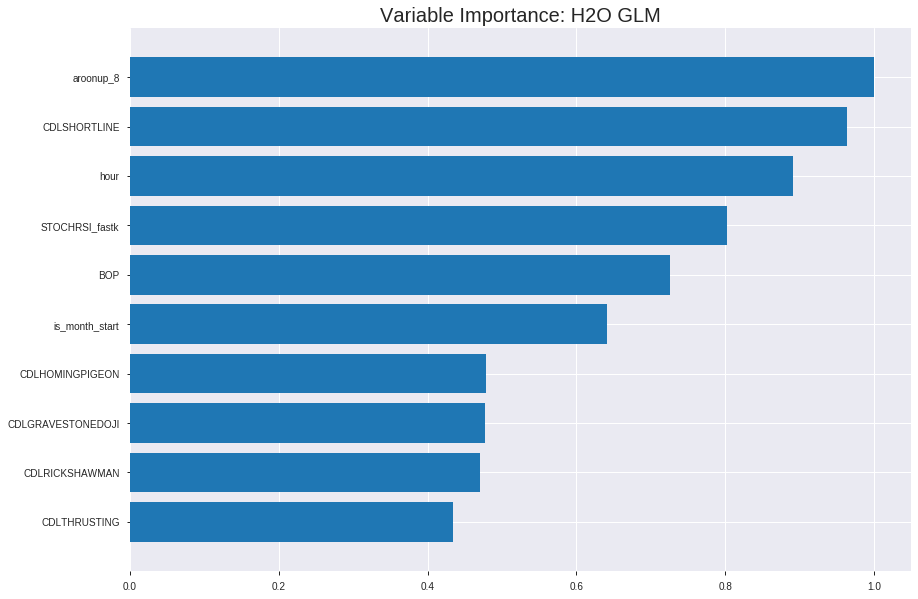

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_072029_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24793421348013533
RMSE: 0.49792992828322274
LogLoss: 0.6889980929442392
Null degrees of freedom: 4318
Residual degrees of freedom: 4268
Null deviance: 5986.754947319863
Residual deviance: 5951.565526852338
AIC: 6053.565526852338
AUC: 0.5645525225736467
pr_auc: 0.5559395368417082
Gini: 0.12910504514729348
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.42780919514039845: 


,0,1,Error,Rate
0,3.0,2183.0,0.9986,(2183.0/2186.0)
1,0.0,2133.0,0.0,(0.0/2133.0)
Total,3.0,4316.0,0.5054,(2183.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4278092,0.6614979,396.0
max f2,0.4278092,0.8300903,396.0
max f0point5,0.4831107,0.5565764,261.0
max accuracy,0.4935294,0.5512850,208.0
max precision,0.7198523,1.0,0.0
max recall,0.4278092,1.0,396.0
max specificity,0.7198523,1.0,0.0
max absolute_mcc,0.4935294,0.1023561,208.0
max min_per_class_accuracy,0.4930694,0.5485232,210.0
max mean_per_class_accuracy,0.4935294,0.5511720,208.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5466793,1.5186357,1.5186357,0.75,0.5683870,0.75,0.5683870,0.0154712,0.0154712,51.8635724,51.8635724
,2,0.0201436,0.5400859,1.3655949,1.4429949,0.6744186,0.5429503,0.7126437,0.5558149,0.0135959,0.0290670,36.5594915,44.2994864
,3,0.0300996,0.5353543,1.0830580,1.3239388,0.5348837,0.5372930,0.6538462,0.5496884,0.0107829,0.0398500,8.3058036,32.3938837
,4,0.0400556,0.5322869,1.0830580,1.2640667,0.5348837,0.5338422,0.6242775,0.5457498,0.0107829,0.0506329,8.3058036,26.4066730
,5,0.0500116,0.5287264,1.1301475,1.2374069,0.5581395,0.5303564,0.6111111,0.5426853,0.0112518,0.0618847,13.0147516,23.7406886
,6,0.1000232,0.5187332,1.2280326,1.2327197,0.6064815,0.5233597,0.6087963,0.5330225,0.0614158,0.1233005,22.8032592,23.2719739
,7,0.1500347,0.5131961,1.1624125,1.2092840,0.5740741,0.5159596,0.5972222,0.5273349,0.0581341,0.1814346,16.2412530,20.9284003
,8,0.2000463,0.5089508,1.0592953,1.1717868,0.5231481,0.5109965,0.5787037,0.5232503,0.0529770,0.2344116,5.9295289,17.1786824
,9,0.3000695,0.5028844,1.0639824,1.1358520,0.5254630,0.5059258,0.5609568,0.5174754,0.1064229,0.3408345,6.3982436,13.5852028
,10,0.4000926,0.4977145,1.0124238,1.1049950,0.5,0.5003528,0.5457176,0.5131948,0.1012658,0.4421003,1.2423816,10.4994975




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.24962630869331423
RMSE: 0.4996261689436555
LogLoss: 0.6923810771867579
Null degrees of freedom: 1233
Residual degrees of freedom: 1183
Null deviance: 1710.4803758483042
Residual deviance: 1708.7964984969185
AIC: 1810.7964984969185
AUC: 0.5170863711001642
pr_auc: 0.5131575969034103
Gini: 0.0341727422003284
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.42312586544678565: 


,0,1,Error,Rate
0,0.0,625.0,1.0,(625.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,0.0,1234.0,0.5065,(625.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4231259,0.6608790,399.0
max f2,0.4231259,0.8297003,399.0
max f0point5,0.4231259,0.5491434,399.0
max accuracy,0.5077373,0.5259319,126.0
max precision,0.7244152,1.0,0.0
max recall,0.4231259,1.0,399.0
max specificity,0.7244152,1.0,0.0
max absolute_mcc,0.5077373,0.0526924,126.0
max min_per_class_accuracy,0.4939018,0.5056,209.0
max mean_per_class_accuracy,0.5077373,0.5226049,126.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.45 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5432649,1.0910698,1.0910698,0.5384615,0.5689648,0.5384615,0.5689648,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.5373609,1.1819923,1.1347126,0.5833333,0.5405175,0.56,0.5553101,0.0114943,0.0229885,18.1992337,13.4712644
,3,0.0299838,0.5334701,1.1819923,1.1500466,0.5833333,0.5352424,0.5675676,0.5488017,0.0114943,0.0344828,18.1992337,15.0046598
,4,0.0405186,0.5301404,0.7793356,1.0536617,0.3846154,0.5318249,0.52,0.5443877,0.0082102,0.0426929,-22.0664393,5.3661741
,5,0.0502431,0.5282759,1.1819923,1.0784999,0.5833333,0.5290886,0.5322581,0.5414266,0.0114943,0.0541872,18.1992337,7.8499921
,6,0.1004862,0.5202139,1.1438636,1.1111817,0.5645161,0.5236594,0.5483871,0.5325430,0.0574713,0.1116585,14.3863552,11.1181736
,7,0.1499190,0.5148245,1.0629627,1.0952825,0.5245902,0.5175491,0.5405405,0.5275991,0.0525452,0.1642036,6.2962664,9.5282475
,8,0.2001621,0.5103301,1.0131363,1.0746628,0.5,0.5123871,0.5303644,0.5237807,0.0509031,0.2151067,1.3136289,7.4662784
,9,0.2998379,0.5038637,1.0378469,1.0624240,0.5121951,0.5072220,0.5243243,0.5182760,0.1034483,0.3185550,3.7846930,6.2424000
,10,0.4003241,0.4983754,0.9314317,1.0295434,0.4596774,0.5013333,0.5080972,0.5140232,0.0935961,0.4121511,-6.8568250,2.9543354



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 07:20:30,0.000 sec,2,.27E1,51,1.3831038,1.3852799
,2019-12-08 07:20:30,0.059 sec,4,.17E1,51,1.3817229,1.3850088
,2019-12-08 07:20:30,0.119 sec,6,.1E1,51,1.3799865,1.3847962
,2019-12-08 07:20:30,0.168 sec,8,.64E0,51,1.3779962,1.3847622
,2019-12-08 07:20:30,0.199 sec,10,.4E0,51,1.3759573,1.3850317
,2019-12-08 07:20:30,0.225 sec,12,.25E0,51,1.3741014,1.3856733
,2019-12-08 07:20:30,0.249 sec,14,.15E0,51,1.3726036,1.3866233
,2019-12-08 07:20:30,0.269 sec,16,.96E-1,51,1.3715256,1.3877310
,2019-12-08 07:20:30,0.284 sec,18,.59E-1,51,1.3708216,1.3888183


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5348460291734197)

('F1', 0.6889128094725511)

('auc', 0.5313651776500073)

('logloss', 0.6918634574967393)

('mean_per_class_error', 0.45177544702091366)

('rmse', 0.4993658514561675)

('mse', 0.24936625360054315)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


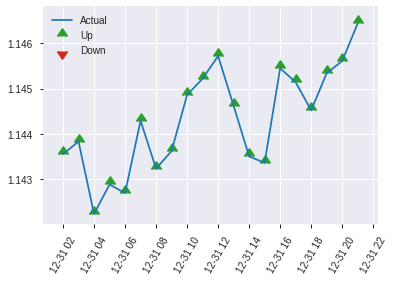


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.24936625360054315
RMSE: 0.4993658514561675
LogLoss: 0.6918634574967393
Null degrees of freedom: 616
Residual degrees of freedom: 566
Null deviance: 856.148314083962
Residual deviance: 853.7595065509763
AIC: 955.7595065509763
AUC: 0.5313651776500073
pr_auc: 0.5752069855912062
Gini: 0.0627303553000147
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4541228610423431: 


,0,1,Error,Rate
0,8.0,286.0,0.9728,(286.0/294.0)
1,3.0,320.0,0.0093,(3.0/323.0)
Total,11.0,606.0,0.4684,(289.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4541229,0.6889128,388.0
max f2,0.4328274,0.8459927,399.0
max f0point5,0.4541229,0.5824536,388.0
max accuracy,0.5006647,0.5348460,138.0
max precision,0.6710436,1.0,0.0
max recall,0.4328274,1.0,399.0
max specificity,0.6710436,1.0,0.0
max absolute_mcc,0.5266052,0.1354999,23.0
max min_per_class_accuracy,0.4922914,0.5139319,199.0
max mean_per_class_accuracy,0.5086943,0.5482246,85.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.23 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5411402,1.0915524,1.0915524,0.5714286,0.5642643,0.5714286,0.5642643,0.0123839,0.0123839,9.1552410,9.1552410
,2,0.0210697,0.5342922,1.9102167,1.4693975,1.0,0.5365133,0.7692308,0.5514561,0.0185759,0.0309598,91.0216718,46.9397476
,3,0.0307942,0.5288612,1.9102167,1.6086036,1.0,0.5328390,0.8421053,0.5455770,0.0185759,0.0495356,91.0216718,60.8603552
,4,0.0405186,0.5266649,1.5918473,1.6045820,0.8333333,0.5278036,0.84,0.5413114,0.0154799,0.0650155,59.1847265,60.4582043
,5,0.0502431,0.5247630,0.9551084,1.4788775,0.5,0.5257813,0.7741935,0.5383056,0.0092879,0.0743034,-4.4891641,47.8877459
,6,0.1004862,0.5172434,1.0475382,1.2632078,0.5483871,0.5202551,0.6612903,0.5292804,0.0526316,0.1269350,4.7538200,26.3207830
,7,0.1507293,0.5114829,1.2323979,1.2529378,0.6451613,0.5143596,0.6559140,0.5243068,0.0619195,0.1888545,23.2397883,25.2937847
,8,0.2009724,0.5074069,1.0475382,1.2015879,0.5483871,0.5090646,0.6290323,0.5204962,0.0526316,0.2414861,4.7538200,20.1587936
,9,0.2998379,0.5020183,0.9394508,1.1151535,0.4918033,0.5047660,0.5837838,0.5153095,0.0928793,0.3343653,-6.0549155,11.5153544
,10,0.4003241,0.4967946,0.8626785,1.0517792,0.4516129,0.4993415,0.5506073,0.5113013,0.0866873,0.4210526,-13.7321482,5.1779246


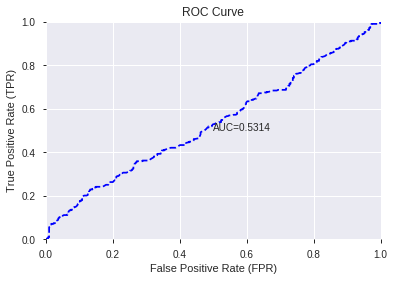

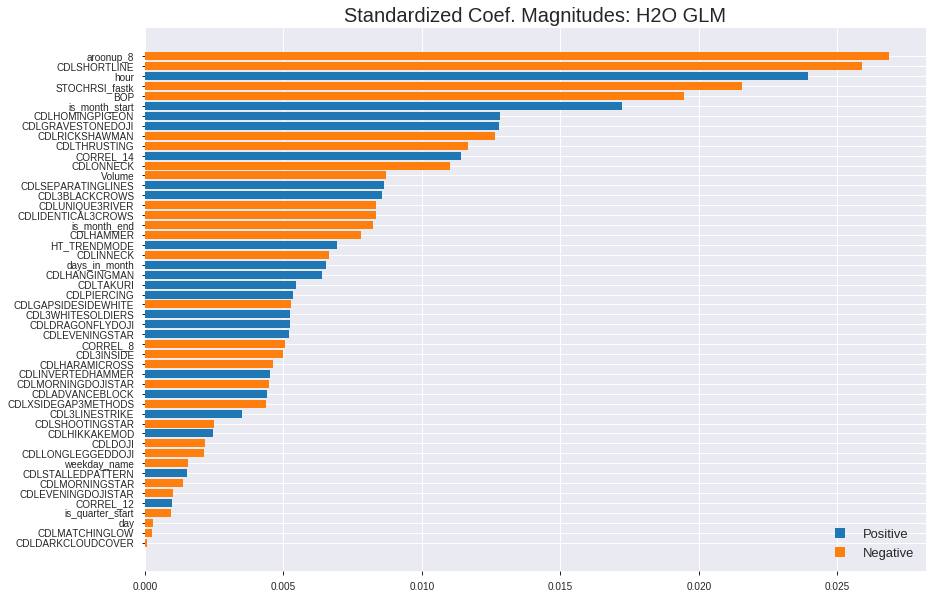

'log_likelihood'
--2019-12-08 07:20:39--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.163.115
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.163.115|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_072029_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_072029_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_12_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_12_s

['aroonup_8',
 'CDLSHORTLINE',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'is_month_start',
 'CDLHOMINGPIGEON',
 'CDLGRAVESTONEDOJI',
 'CDLRICKSHAWMAN',
 'CDLTHRUSTING',
 'CORREL_14',
 'CDLONNECK',
 'Volume',
 'CDLSEPARATINGLINES',
 'CDL3BLACKCROWS',
 'CDLUNIQUE3RIVER',
 'CDLIDENTICAL3CROWS',
 'is_month_end',
 'CDLHAMMER',
 'HT_TRENDMODE',
 'CDLINNECK',
 'days_in_month',
 'CDLHANGINGMAN',
 'CDLTAKURI',
 'CDLPIERCING',
 'CDLGAPSIDESIDEWHITE',
 'CDL3WHITESOLDIERS',
 'CDLDRAGONFLYDOJI',
 'CDLEVENINGSTAR',
 'CORREL_8',
 'CDL3INSIDE',
 'CDLHARAMICROSS',
 'CDLINVERTEDHAMMER',
 'CDLMORNINGDOJISTAR',
 'CDLADVANCEBLOCK',
 'CDLXSIDEGAP3METHODS',
 'CDL3LINESTRIKE',
 'CDLSHOOTINGSTAR',
 'CDLHIKKAKEMOD',
 'CDLDOJI',
 'CDLLONGLEGGEDDOJI',
 'weekday_name',
 'CDLSTALLEDPATTERN',
 'CDLMORNINGSTAR',
 'CDLEVENINGDOJISTAR',
 'CORREL_12',
 'is_quarter_start',
 'day',
 'CDLMATCHINGLOW',
 'CDLDARKCLOUDCOVER']

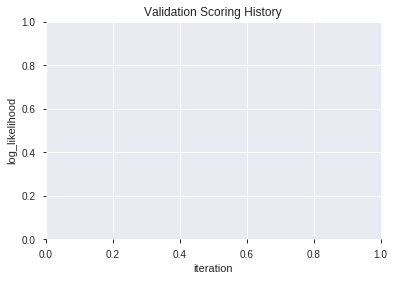

In [13]:
# GLM with top DeepLearning features
model_train(feature_name='DLF',model_algo="GLM",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_3_AutoML_20191208_072137,0.535188,0.692134,0.500000,0.499522,0.249523
1,XGBoost_grid_1_AutoML_20191208_072137_model_1,0.532345,0.692670,0.500000,0.499782,0.249782
2,XGBoost_grid_1_AutoML_20191208_072137_model_2,0.528411,0.694198,0.492739,0.500509,0.250509
3,XGBoost_grid_1_AutoML_20191208_072137_model_4,0.527390,0.692044,0.493197,0.499488,0.249488
4,XGBoost_grid_1_AutoML_20191208_072137_model_7,0.526358,0.700475,0.500000,0.503471,0.253483
5,XGBoost_1_AutoML_20191208_072137,0.524894,0.698256,0.498147,0.502469,0.252475
6,XGBoost_grid_1_AutoML_20191208_072137_model_3,0.522093,0.694942,0.494745,0.500895,0.250896
7,XGBoost_grid_1_AutoML_20191208_072137_model_6,0.507703,0.696349,0.500000,0.501625,0.251627
8,XGBoost_2_AutoML_20191208_072137,0.504539,0.702799,0.492739,0.504655,0.254677
9,XGBoost_grid_1_AutoML_20191208_072137_model_5,0.497441,0.721068,0.500000,0.512800,0.262964


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,653.440186,1.000000,0.159854
1,BOP,583.395203,0.892806,0.142719
2,Volume,562.391174,0.860662,0.137580
3,hour,502.869110,0.769572,0.123019
4,day,374.985626,0.573864,0.091734
5,aroonup_8,297.273956,0.454937,0.072724
6,weekday_name,267.403198,0.409224,0.065416
7,CORREL_14,251.031937,0.384170,0.061411
8,CDLSHORTLINE,159.929047,0.244749,0.039124
9,CORREL_12,87.432434,0.133803,0.021389


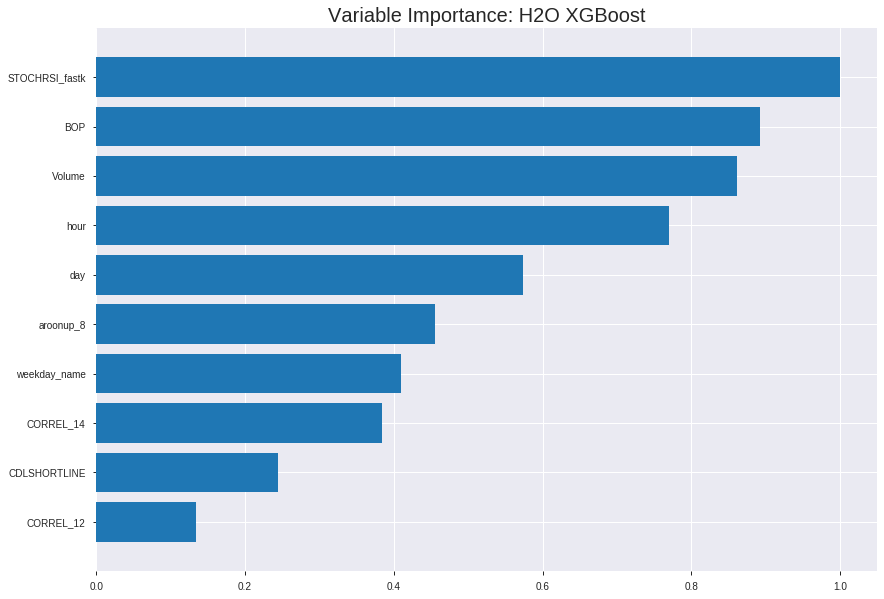

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_3_AutoML_20191208_072137


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.22825796410019428
RMSE: 0.4777635022688467
LogLoss: 0.6489716384469835
Mean Per-Class Error: 0.3261413143951044
AUC: 0.739841269228509
pr_auc: 0.7330221130613521
Gini: 0.479682538457018
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.46485976989452654: 


,0,1,Error,Rate
0,956.0,1230.0,0.5627,(1230.0/2186.0)
1,296.0,1837.0,0.1388,(296.0/2133.0)
Total,1252.0,3067.0,0.3533,(1526.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4648598,0.7065385,261.0
max f2,0.4075583,0.8361897,341.0
max f0point5,0.5055858,0.6750358,188.0
max accuracy,0.4845427,0.6730725,225.0
max precision,0.8110829,1.0,0.0
max recall,0.3521718,1.0,386.0
max specificity,0.8110829,1.0,0.0
max absolute_mcc,0.4821282,0.3504947,229.0
max min_per_class_accuracy,0.4927168,0.6633849,210.0
max mean_per_class_accuracy,0.4845427,0.6738587,225.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.52 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6776617,1.9788284,1.9788284,0.9772727,0.7171730,0.9772727,0.7171730,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.6430771,1.8835792,1.9317512,0.9302326,0.6563612,0.9540230,0.6871166,0.0187529,0.0389123,88.3579193,93.1751190
,3,0.0300996,0.6276608,1.8364897,1.9002416,0.9069767,0.6333058,0.9384615,0.6693176,0.0182841,0.0571964,83.6489713,90.0241624
,4,0.0400556,0.6155918,1.6481318,1.8375785,0.8139535,0.6211421,0.9075145,0.6573434,0.0164088,0.0736053,64.8131794,83.7578487
,5,0.0500116,0.6055780,1.7423108,1.8186132,0.8604651,0.6096738,0.8981481,0.6478536,0.0173465,0.0909517,74.2310753,81.8613151
,6,0.1000232,0.5744374,1.6779987,1.7483059,0.8287037,0.5882530,0.8634259,0.6180533,0.0839194,0.1748711,67.7998732,74.8305942
,7,0.1500347,0.5533785,1.5092614,1.6686244,0.7453704,0.5632526,0.8240741,0.5997864,0.0754805,0.2503516,50.9261430,66.8624438
,8,0.2000463,0.5378603,1.4436414,1.6123787,0.7129630,0.5455443,0.7962963,0.5862259,0.0721988,0.3225504,44.3641368,61.2378670
,9,0.3000695,0.5186356,1.2749041,1.4998871,0.6296296,0.5276854,0.7407407,0.5667124,0.1275199,0.4500703,27.4904065,49.9887135
,10,0.4000926,0.5056055,1.2139712,1.4284081,0.5995370,0.5116826,0.7054398,0.5529549,0.1214252,0.5714955,21.3971150,42.8408139




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.24881089091469086
RMSE: 0.4988094735614901
LogLoss: 0.690854038447428
Mean Per-Class Error: 0.458344827586207
AUC: 0.5425366174055829
pr_auc: 0.5372228678263891
Gini: 0.0850732348111658
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.32455024123191833: 


,0,1,Error,Rate
0,1.0,624.0,0.9984,(624.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,1.0,1233.0,0.5057,(624.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3245502,0.6612378,398.0
max f2,0.3245502,0.8299264,398.0
max f0point5,0.4367497,0.5544041,315.0
max accuracy,0.5352823,0.5453809,118.0
max precision,0.6073412,0.6808511,34.0
max recall,0.3245502,1.0,398.0
max specificity,0.7193168,0.9984,0.0
max absolute_mcc,0.5352823,0.1035796,118.0
max min_per_class_accuracy,0.4911857,0.5303777,209.0
max mean_per_class_accuracy,0.5136750,0.5416552,161.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6481487,1.0910698,1.0910698,0.5384615,0.6751642,0.5384615,0.6751642,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.6277447,1.3508484,1.2157635,0.6666667,0.6348120,0.6,0.6557952,0.0131363,0.0246305,35.0848385,21.5763547
,3,0.0299838,0.6140781,1.5197044,1.3143390,0.75,0.6217489,0.6486486,0.6447531,0.0147783,0.0394089,51.9704433,31.4338970
,4,0.0405186,0.6040227,1.4028041,1.3373399,0.6923077,0.6093502,0.66,0.6355484,0.0147783,0.0541872,40.2804092,33.7339901
,5,0.0502431,0.5970138,1.1819923,1.3072726,0.5833333,0.6000173,0.6451613,0.6286714,0.0114943,0.0656814,18.1992337,30.7272631
,6,0.1004862,0.5751069,1.0458181,1.1765454,0.5161290,0.5852946,0.5806452,0.6069830,0.0525452,0.1182266,4.5818105,17.6545368
,7,0.1499190,0.5530318,1.1626154,1.1719522,0.5737705,0.5627461,0.5783784,0.5923968,0.0574713,0.1756979,16.2615414,17.1952248
,8,0.2001621,0.5351751,1.3399544,1.2141228,0.6612903,0.5415855,0.5991903,0.5796425,0.0673235,0.2430213,33.9954447,21.4122840
,9,0.2998379,0.5187735,0.8731093,1.1007589,0.4308943,0.5258728,0.5432432,0.5617677,0.0870279,0.3300493,-12.6890678,10.0758887
,10,0.4003241,0.5040536,1.0784999,1.0951716,0.5322581,0.5112093,0.5404858,0.5490770,0.1083744,0.4384236,7.8499921,9.5171616



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:21:42,0.003 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 07:21:42,0.089 sec,5.0,0.4964706,0.6861052,0.6415324,0.6348563,1.9788284,0.4619125,0.4996508,0.6924490,0.5223567,0.5095042,1.0910698,0.5
,2019-12-08 07:21:42,0.137 sec,10.0,0.4936117,0.6804133,0.6638877,0.6503647,1.9328091,0.4387590,0.4990701,0.6912854,0.5294910,0.5236790,1.0910698,0.5064830
,2019-12-08 07:21:42,0.192 sec,15.0,0.4911364,0.6754822,0.6751418,0.6607607,1.8407706,0.4033341,0.4990733,0.6912925,0.5300020,0.5241220,1.0910698,0.5064830
,2019-12-08 07:21:42,0.244 sec,20.0,0.4885271,0.6702989,0.6898323,0.6783942,1.8867898,0.3945358,0.4989977,0.6911484,0.5353550,0.5264665,1.0910698,0.5056726
,2019-12-08 07:21:42,0.299 sec,25.0,0.4867122,0.6666782,0.6975241,0.6873153,1.9328091,0.3940727,0.4990176,0.6911990,0.5355048,0.5260661,0.9352027,0.5064830
,2019-12-08 07:21:42,0.359 sec,30.0,0.4845028,0.6622946,0.7090377,0.7008472,1.9328091,0.3820329,0.4988064,0.6907824,0.5387166,0.5316595,1.0910698,0.5064830
,2019-12-08 07:21:42,0.420 sec,35.0,0.4825672,0.6584377,0.7172065,0.7105889,1.8867898,0.3676777,0.4984130,0.6899946,0.5419087,0.5379639,1.4028041,0.5064830
,2019-12-08 07:21:42,0.485 sec,40.0,0.4808089,0.6549763,0.7251107,0.7184557,1.9328091,0.3769391,0.4984651,0.6901092,0.5421530,0.5377567,1.2469370,0.5064830
,2019-12-08 07:21:42,0.543 sec,45.0,0.4794960,0.6523773,0.7309675,0.7241115,1.9328091,0.3605001,0.4984990,0.6901956,0.5439934,0.5382566,1.0910698,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
STOCHRSI_fastk,653.4401855,1.0,0.1598541
BOP,583.3952026,0.8928058,0.1427187
Volume,562.3911743,0.8606621,0.1375804
hour,502.8691101,0.7695718,0.1230192
day,374.9856262,0.5738637,0.0917345
---,---,---,---
CDLXSIDEGAP3METHODS,6.6947079,0.0102453,0.0016378
CDLMATCHINGLOW,6.0649567,0.0092816,0.0014837
CDL3INSIDE,5.9835496,0.0091570,0.0014638
CDLADVANCEBLOCK,3.3695984,0.0051567,0.0008243



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5542949756888168)

('F1', 0.6872340425531915)

('auc', 0.535187759314252)

('logloss', 0.6921339619793213)

('mean_per_class_error', 0.4486004928287104)

('rmse', 0.49952228221568235)

('mse', 0.2495225104299638)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


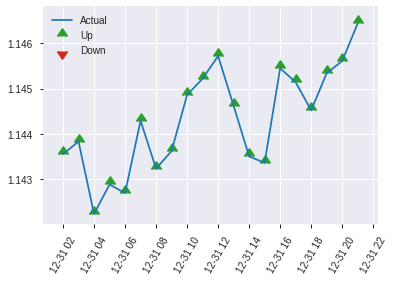


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.2495225104299638
RMSE: 0.49952228221568235
LogLoss: 0.6921339619793213
Mean Per-Class Error: 0.4486004928287104
AUC: 0.535187759314252
pr_auc: 0.5697318835242969
Gini: 0.070375518628504
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3561875820159912: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3561876,0.6872340,399.0
max f2,0.3561876,0.8459927,399.0
max f0point5,0.3879456,0.5789474,391.0
max accuracy,0.4866892,0.5542950,228.0
max precision,0.7349759,1.0,0.0
max recall,0.3561876,1.0,399.0
max specificity,0.7349759,1.0,0.0
max absolute_mcc,0.6080737,0.1354999,24.0
max min_per_class_accuracy,0.4937555,0.5386997,208.0
max mean_per_class_accuracy,0.4866892,0.5513995,228.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.69 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6438288,1.3644405,1.3644405,0.7142857,0.6744145,0.7142857,0.6744145,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.6242434,1.5918473,1.4693975,0.8333333,0.6318598,0.7692308,0.6547739,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.6167518,1.9102167,1.6086036,1.0,0.6210145,0.8421053,0.6441130,0.0185759,0.0495356,91.0216718,60.8603552
,4,0.0405186,0.6085430,1.5918473,1.6045820,0.8333333,0.6131198,0.84,0.6366747,0.0154799,0.0650155,59.1847265,60.4582043
,5,0.0502431,0.6024273,0.6367389,1.4172576,0.3333333,0.6053307,0.7419355,0.6306081,0.0061920,0.0712074,-36.3261094,41.7257565
,6,0.1004862,0.5731129,0.8010586,1.1091581,0.4193548,0.5872515,0.5806452,0.6089298,0.0402477,0.1114551,-19.8941376,10.9158094
,7,0.1507293,0.5527557,1.2323979,1.1502380,0.6451613,0.5610990,0.6021505,0.5929862,0.0619195,0.1733746,23.2397883,15.0238024
,8,0.2009724,0.5367337,0.8626785,1.0783481,0.4516129,0.5442567,0.5645161,0.5808038,0.0433437,0.2167183,-13.7321482,7.8348147
,9,0.2998379,0.5192420,0.9707659,1.0428751,0.5081967,0.5271786,0.5459459,0.5631220,0.0959752,0.3126935,-2.9234127,4.2875073
,10,0.4003241,0.5057064,1.1091581,1.0595129,0.5806452,0.5128896,0.5546559,0.5505131,0.1114551,0.4241486,10.9158094,5.9512917


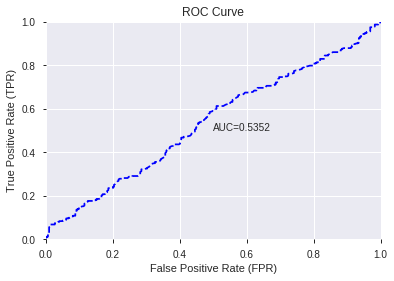

This function is available for GLM models only


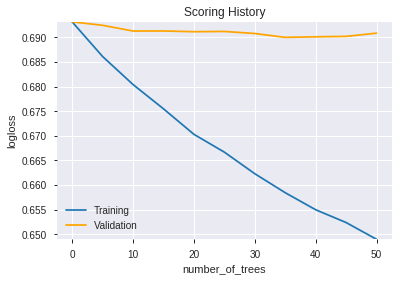

--2019-12-08 07:22:02--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.131.131
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.131.131|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
Exception in thread "main" java.lang.StackOverflowError
	at java.base/java.lang.String.indexOf(String.java:1578)
	at java.base/java.lang.String.indexOf(String.java:1535)
	at java.base/java.lang.String.split(String.java:2274)
	at java.base/java.lang.String.split(String.java:2364)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:101)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:106)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_3_AutoML_20191208_072137',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_3_AutoML_20191208_072137',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_17_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_17_sid_887f',
   'type

['STOCHRSI_fastk',
 'BOP',
 'Volume',
 'hour',
 'day',
 'aroonup_8',
 'weekday_name',
 'CORREL_14',
 'CDLSHORTLINE',
 'CORREL_12',
 'days_in_month',
 'HT_TRENDMODE',
 'CDLRICKSHAWMAN',
 'CDLDOJI',
 'is_month_start',
 'CDLHAMMER',
 'is_month_end',
 'CDLDRAGONFLYDOJI',
 'CDLGRAVESTONEDOJI',
 'CDLHARAMICROSS',
 'CDLHANGINGMAN',
 'CDLHIKKAKEMOD',
 'CDLXSIDEGAP3METHODS',
 'CDLMATCHINGLOW',
 'CDL3INSIDE',
 'CDLADVANCEBLOCK',
 'CDLLONGLEGGEDDOJI']

In [14]:
# XGBoost with top DeepLearning features
model_train(feature_name='DLF',model_algo="XGBoost",features_list = features_list[:model_selected_features])

In [15]:
# DRF with top DeepLearning features
model_train(feature_name='DLF',model_algo="DRF",features_list = features_list[:model_selected_features])

Output hidden; open in https://colab.research.google.com to view.

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_grid_1_AutoML_20191208_072416_model_4,0.558755,0.692005,0.500000,0.499428,0.249429
1,GBM_grid_1_AutoML_20191208_072416_model_2,0.545334,0.691583,0.493197,0.499219,0.249219
2,GBM_grid_1_AutoML_20191208_072416_model_1,0.537152,0.691730,0.487332,0.499292,0.249292
3,GBM_1_AutoML_20191208_072416,0.520040,0.697241,0.494898,0.502036,0.252041
4,GBM_2_AutoML_20191208_072416,0.519892,0.697264,0.487943,0.502094,0.252098
5,GBM_grid_1_AutoML_20191208_072416_model_5,0.518360,0.693595,0.500000,0.500224,0.250224
6,GBM_5_AutoML_20191208_072416,0.518118,0.698576,0.496293,0.502626,0.252633
7,GBM_3_AutoML_20191208_072416,0.508530,0.704914,0.494593,0.505648,0.255680
8,GBM_4_AutoML_20191208_072416,0.496172,0.717568,0.498299,0.511438,0.261569
9,GBM_grid_1_AutoML_20191208_072416_model_3,0.492792,0.932030,0.498299,0.566834,0.321301


,variable,relative_importance,scaled_importance,percentage
0,BOP,461.771545,1.000000,0.157045
1,day,418.045288,0.905308,0.142174
2,hour,400.667969,0.867676,0.136264
3,Volume,384.878845,0.833483,0.130895
4,STOCHRSI_fastk,341.596191,0.739751,0.116175
5,aroonup_8,292.985687,0.634482,0.099642
6,weekday_name,175.922699,0.380973,0.059830
7,CDLSHORTLINE,80.206192,0.173692,0.027278
8,days_in_month,72.579147,0.157175,0.024684
9,HT_TRENDMODE,62.845715,0.136097,0.021373


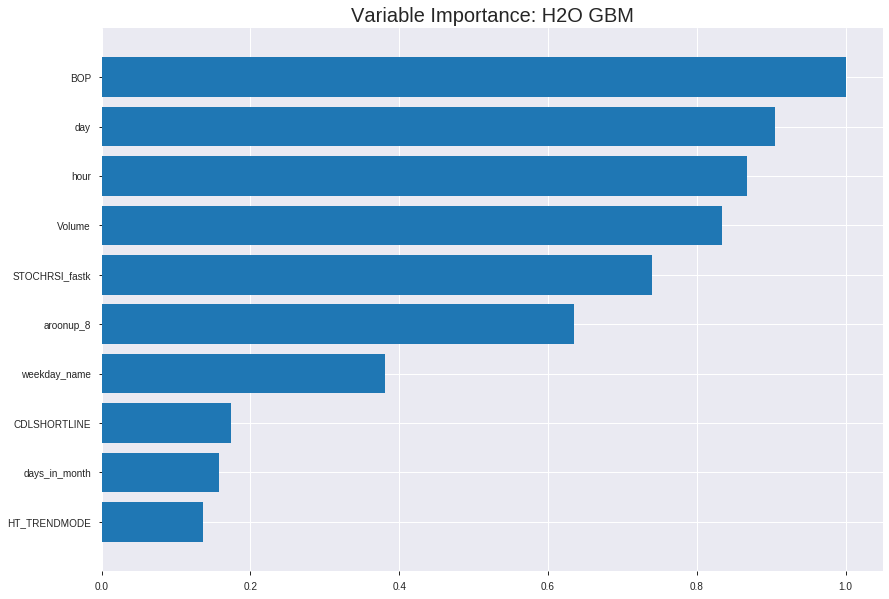

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_grid_1_AutoML_20191208_072416_model_4


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.2431508640301932
RMSE: 0.4931032995531395
LogLoss: 0.6794405114263955
Mean Per-Class Error: 0.2167139779245585
AUC: 0.8704518675507824
pr_auc: 0.8698029341702276
Gini: 0.7409037351015648
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4921011428071422: 


,0,1,Error,Rate
0,1534.0,652.0,0.2983,(652.0/2186.0)
1,328.0,1805.0,0.1538,(328.0/2133.0)
Total,1862.0,2457.0,0.2269,(980.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4921011,0.7864924,220.0
max f2,0.4863222,0.8684477,271.0
max f0point5,0.4971618,0.8031215,173.0
max accuracy,0.4942865,0.7835147,200.0
max precision,0.5431133,1.0,0.0
max recall,0.4725445,1.0,359.0
max specificity,0.5431133,1.0,0.0
max absolute_mcc,0.4942865,0.5670842,200.0
max min_per_class_accuracy,0.4938214,0.7817932,205.0
max mean_per_class_accuracy,0.4942865,0.7832860,200.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.38 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5256961,2.0248476,2.0248476,1.0,0.5317020,1.0,0.5317020,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.5203924,2.0248476,2.0248476,1.0,0.5225474,1.0,0.5271773,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.5176010,1.9777582,2.0092719,0.9767442,0.5188555,0.9923077,0.5244247,0.0196906,0.0604782,97.7758153,100.9271881
,4,0.0400556,0.5154295,2.0248476,2.0131433,1.0,0.5162260,0.9942197,0.5223869,0.0201594,0.0806376,102.4847632,101.3143311
,5,0.0500116,0.5140778,2.0248476,2.0154733,1.0,0.5147663,0.9953704,0.5208698,0.0201594,0.1007970,102.4847632,101.5473338
,6,0.1000232,0.5081760,1.9123561,1.9639147,0.9444444,0.5107486,0.9699074,0.5158092,0.0956399,0.1964369,91.2356097,96.3914718
,7,0.1500347,0.5046328,1.8748589,1.9342295,0.9259259,0.5063359,0.9552469,0.5126514,0.0937647,0.2902016,87.4858919,93.4229451
,8,0.2000463,0.5018076,1.7904903,1.8982947,0.8842593,0.5031348,0.9375,0.5102723,0.0895452,0.3797468,79.0490268,89.8294655
,9,0.3000695,0.4984048,1.6545630,1.8170508,0.8171296,0.4999866,0.8973765,0.5068437,0.1654946,0.5452414,65.4562996,81.7050769
,10,0.4000926,0.4958214,1.2936527,1.6862012,0.6388889,0.4970248,0.8327546,0.5043890,0.1293952,0.6746367,29.3652654,68.6201240




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.24937003650637246
RMSE: 0.49936963915157323
LogLoss: 0.6918871007197719
Mean Per-Class Error: 0.4634193760262726
AUC: 0.5413517241379311
pr_auc: 0.5355888536220421
Gini: 0.08270344827586218
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4618087929098892: 


,0,1,Error,Rate
0,0.0,625.0,1.0,(625.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,0.0,1234.0,0.5065,(625.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4618088,0.6608790,399.0
max f2,0.4618088,0.8297003,399.0
max f0point5,0.4847880,0.5530098,310.0
max accuracy,0.4972081,0.5388979,157.0
max precision,0.5187529,0.7142857,10.0
max recall,0.4618088,1.0,399.0
max specificity,0.5328993,0.9984,0.0
max absolute_mcc,0.5066919,0.0858323,62.0
max min_per_class_accuracy,0.4938991,0.5221675,202.0
max mean_per_class_accuracy,0.4960193,0.5365806,174.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5192178,1.4028041,1.4028041,0.6923077,0.5229244,0.6923077,0.5229244,0.0147783,0.0147783,40.2804092,40.2804092
,2,0.0202593,0.5152369,1.0131363,1.2157635,0.5,0.5166694,0.6,0.5199220,0.0098522,0.0246305,1.3136289,21.5763547
,3,0.0299838,0.5135709,1.1819923,1.2048107,0.5833333,0.5143997,0.5945946,0.5181310,0.0114943,0.0361248,18.1992337,20.4810722
,4,0.0405186,0.5119993,1.5586712,1.2968144,0.7692308,0.5126604,0.64,0.5167087,0.0164204,0.0525452,55.8671214,29.6814450
,5,0.0502431,0.5102838,1.3508484,1.3072726,0.6666667,0.5111503,0.6451613,0.5156328,0.0131363,0.0656814,35.0848385,30.7272631
,6,0.1004862,0.5052179,1.1111817,1.2092272,0.5483871,0.5072058,0.5967742,0.5114193,0.0558292,0.1215107,11.1181736,20.9227184
,7,0.1499190,0.5023780,1.0961802,1.1719522,0.5409836,0.5037261,0.5783784,0.5088826,0.0541872,0.1756979,9.6180247,17.1952248
,8,0.2001621,0.5005874,1.0458181,1.1402910,0.5161290,0.5014130,0.5627530,0.5070077,0.0525452,0.2282430,4.5818105,14.0291046
,9,0.2998379,0.4976133,1.0213732,1.1007589,0.5040650,0.4989492,0.5432432,0.5043288,0.1018062,0.3300493,2.1373169,10.0758887
,10,0.4003241,0.4957189,1.0294772,1.0828663,0.5080645,0.4965987,0.5344130,0.5023884,0.1034483,0.4334975,2.9477197,8.2866317



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:24:24,1.812 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 07:24:24,1.926 sec,5.0,0.4988585,0.6908663,0.7807861,0.7790206,1.9788284,0.3204445,0.4998819,0.6929109,0.5188782,0.5017368,0.9352027,0.5032415
,2019-12-08 07:24:24,2.071 sec,10.0,0.4974971,0.6881529,0.8291885,0.8308730,2.0248476,0.2593193,0.4997978,0.6927428,0.5279488,0.5177994,0.9352027,0.5064830
,2019-12-08 07:24:24,2.177 sec,15.0,0.4965017,0.6861730,0.8417913,0.8410281,2.0248476,0.2502894,0.4997570,0.6926612,0.5279461,0.5199277,1.2469370,0.5064830
,2019-12-08 07:24:24,2.298 sec,20.0,0.4953449,0.6838770,0.8557472,0.8555880,2.0248476,0.2368604,0.4995873,0.6923220,0.5388085,0.5293286,1.4028041,0.5064830
,2019-12-08 07:24:24,2.407 sec,25.0,0.4941692,0.6815479,0.8614204,0.8613363,2.0248476,0.2243575,0.4994842,0.6921160,0.5392250,0.5315447,1.2469370,0.5064830
,2019-12-08 07:24:24,2.521 sec,30.0,0.4931033,0.6794405,0.8704519,0.8698029,2.0248476,0.2269044,0.4993696,0.6918871,0.5413517,0.5355889,1.4028041,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BOP,461.7715454,1.0,0.1570454
day,418.0452881,0.9053076,0.1421744
hour,400.6679688,0.8676757,0.1362645
Volume,384.8788452,0.8334832,0.1308947
STOCHRSI_fastk,341.5961914,0.7397515,0.1161746
---,---,---,---
CDLSHOOTINGSTAR,0.0,0.0,0.0
CDLSTALLEDPATTERN,0.0,0.0,0.0
CDLTHRUSTING,0.0,0.0,0.0
CDLUNIQUE3RIVER,0.0,0.0,0.0



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5559157212317666)

('F1', 0.6872340425531915)

('auc', 0.5587550809797603)

('logloss', 0.6920047008523914)

('mean_per_class_error', 0.4366009561719425)

('rmse', 0.4994284237639595)

('mse', 0.24942875046335314)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


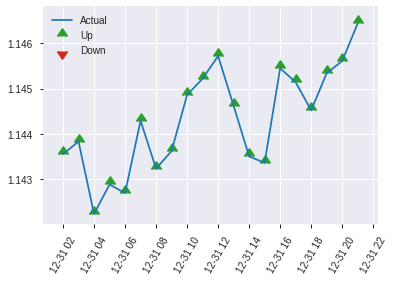


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.24942875046335314
RMSE: 0.4994284237639595
LogLoss: 0.6920047008523914
Mean Per-Class Error: 0.4366009561719425
AUC: 0.5587550809797603
pr_auc: 0.5905873667561758
Gini: 0.11751016195952069
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4657075295219627: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4657075,0.6872340,399.0
max f2,0.4657075,0.8459927,399.0
max f0point5,0.4849556,0.5826051,331.0
max accuracy,0.4954566,0.5559157,164.0
max precision,0.5334755,1.0,0.0
max recall,0.4657075,1.0,399.0
max specificity,0.5334755,1.0,0.0
max absolute_mcc,0.5029577,0.1611083,74.0
max min_per_class_accuracy,0.4930990,0.5170068,204.0
max mean_per_class_accuracy,0.4998066,0.5633990,104.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.36 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5211127,1.0915524,1.0915524,0.5714286,0.5245183,0.5714286,0.5245183,0.0123839,0.0123839,9.1552410,9.1552410
,2,0.0210697,0.5157716,1.2734778,1.1755180,0.6666667,0.5188133,0.6153846,0.5218852,0.0123839,0.0247678,27.3477812,17.5517980
,3,0.0307942,0.5141350,1.5918473,1.3069904,0.8333333,0.5150234,0.6842105,0.5197183,0.0154799,0.0402477,59.1847265,30.6990386
,4,0.0405186,0.5119391,1.2734778,1.2989474,0.6666667,0.5131854,0.68,0.5181504,0.0123839,0.0526316,27.3477812,29.8947368
,5,0.0502431,0.5100922,1.5918473,1.3556377,0.8333333,0.5109023,0.7096774,0.5167476,0.0154799,0.0681115,59.1847265,35.5637671
,6,0.1004862,0.5050349,1.4172576,1.3864476,0.7419355,0.5075087,0.7258065,0.5121282,0.0712074,0.1393189,41.7257565,38.6447618
,7,0.1507293,0.5021540,1.1707780,1.3145577,0.6129032,0.5033557,0.6881720,0.5092040,0.0588235,0.1981424,17.0777989,31.4557742
,8,0.2009724,0.4999200,1.1707780,1.2786128,0.6129032,0.5009242,0.6693548,0.5071341,0.0588235,0.2569659,17.0777989,27.8612803
,9,0.2998379,0.4969342,0.9081358,1.1564555,0.4754098,0.4981676,0.6054054,0.5041775,0.0897833,0.3467492,-9.1864183,15.6455527
,10,0.4003241,0.4947539,0.9859183,1.1136486,0.5161290,0.4958305,0.5829960,0.5020823,0.0990712,0.4458204,-1.4081694,11.3648613


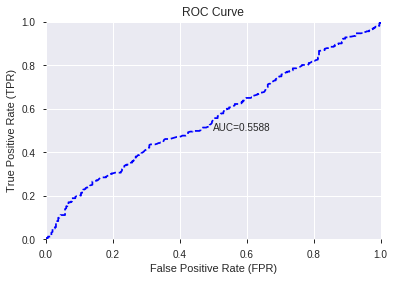

This function is available for GLM models only


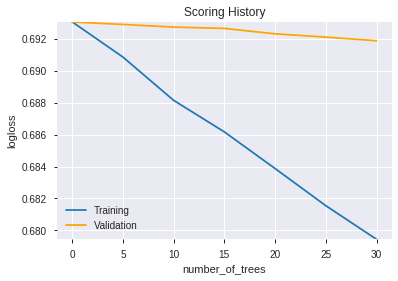

--2019-12-08 07:24:34--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.100.3
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.100.3|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      721.0
            depth:       1
            colId:       49
            colName:     CORREL_14
            leftward:    true
            naVsRest:    false
            splitVal:    0.75390625
            isBitset:    false
            predValue:   0.07201641
            squaredErr:  177.12068
            leftChild:   Node 5
            rightChi

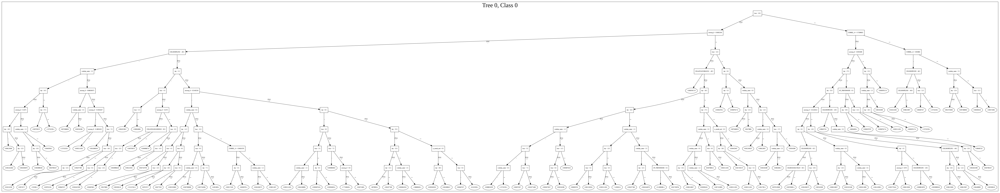

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_grid_1_AutoML_20191208_072416_model_4',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_grid_1_AutoML_20191208_072416_model_4',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_27_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_27_s

['BOP',
 'day',
 'hour',
 'Volume',
 'STOCHRSI_fastk',
 'aroonup_8',
 'weekday_name',
 'CDLSHORTLINE',
 'days_in_month',
 'HT_TRENDMODE',
 'CORREL_14',
 'CDLRICKSHAWMAN',
 'CORREL_12',
 'CDLDOJI',
 'CDLLONGLEGGEDDOJI',
 'is_month_end',
 'is_month_start',
 'CDLGRAVESTONEDOJI',
 'CDLHANGINGMAN',
 'CDLHAMMER',
 'CDLDRAGONFLYDOJI',
 'CORREL_8',
 'CDLINVERTEDHAMMER',
 'CDLTAKURI',
 'CDLADVANCEBLOCK',
 'CDL3INSIDE',
 'CDLMATCHINGLOW',
 'is_quarter_start',
 'CDL3BLACKCROWS',
 'CDL3LINESTRIKE',
 'CDL3WHITESOLDIERS',
 'CDLDARKCLOUDCOVER',
 'CDLEVENINGDOJISTAR',
 'CDLEVENINGSTAR',
 'CDLGAPSIDESIDEWHITE',
 'CDLHARAMICROSS',
 'CDLHIKKAKEMOD',
 'CDLHOMINGPIGEON',
 'CDLIDENTICAL3CROWS',
 'CDLINNECK',
 'CDLMORNINGDOJISTAR',
 'CDLMORNINGSTAR',
 'CDLONNECK',
 'CDLPIERCING',
 'CDLSEPARATINGLINES',
 'CDLSHOOTINGSTAR',
 'CDLSTALLEDPATTERN',
 'CDLTHRUSTING',
 'CDLUNIQUE3RIVER',
 'CDLXSIDEGAP3METHODS']

In [16]:
# GBM with top DeepLearning features
model_train(feature_name='DLF',model_algo="GBM",features_list = features_list[:model_selected_features])

In [17]:
# StackedEnsemble with top DeepLearning features
model_train(feature_name='DLF',model_algo="StackedEnsemble",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_3_AutoML_20191208_072534,0.535188,0.692134,0.500000,0.499522,0.249523
1,GLM_grid_1_AutoML_20191208_072534_model_1,0.531365,0.691863,0.491039,0.499366,0.249366
2,XGBoost_1_AutoML_20191208_072534,0.524894,0.698256,0.498147,0.502469,0.252475
3,GBM_1_AutoML_20191208_072534,0.520040,0.697241,0.494898,0.502036,0.252041
4,GBM_2_AutoML_20191208_072534,0.519892,0.697264,0.487943,0.502094,0.252098
5,GBM_5_AutoML_20191208_072534,0.518118,0.698576,0.496293,0.502626,0.252633
6,DRF_1_AutoML_20191208_072534,0.509888,0.729464,0.500000,0.515271,0.265505
7,GBM_3_AutoML_20191208_072534,0.508530,0.704914,0.494593,0.505648,0.255680
8,XGBoost_2_AutoML_20191208_072534,0.504539,0.702799,0.492739,0.504655,0.254677
9,GBM_4_AutoML_20191208_072534,0.496172,0.717568,0.498299,0.511438,0.261569


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,653.440186,1.000000,0.159854
1,BOP,583.395203,0.892806,0.142719
2,Volume,562.391174,0.860662,0.137580
3,hour,502.869110,0.769572,0.123019
4,day,374.985626,0.573864,0.091734
5,aroonup_8,297.273956,0.454937,0.072724
6,weekday_name,267.403198,0.409224,0.065416
7,CORREL_14,251.031937,0.384170,0.061411
8,CDLSHORTLINE,159.929047,0.244749,0.039124
9,CORREL_12,87.432434,0.133803,0.021389


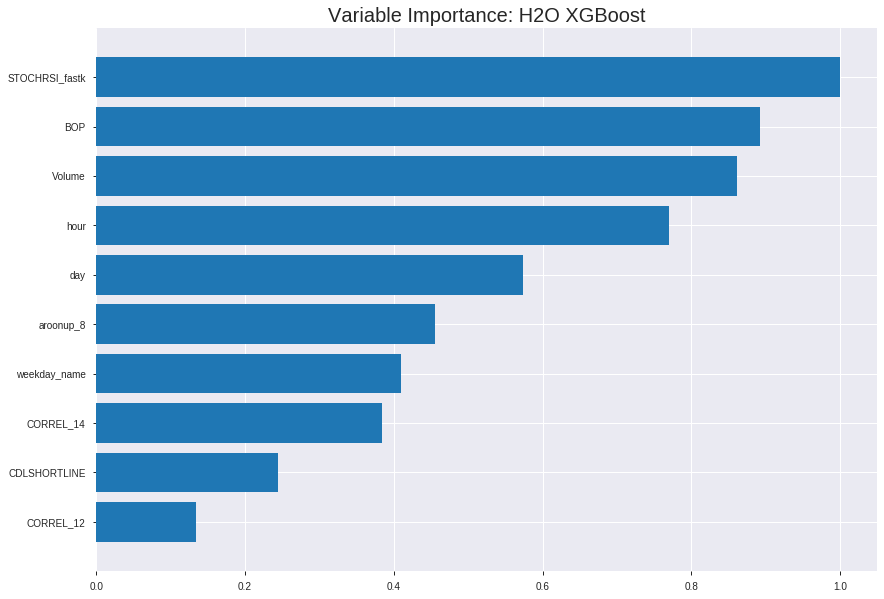

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_3_AutoML_20191208_072534


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.22825796410019428
RMSE: 0.4777635022688467
LogLoss: 0.6489716384469835
Mean Per-Class Error: 0.3261413143951044
AUC: 0.739841269228509
pr_auc: 0.7330221130613521
Gini: 0.479682538457018
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.46485976989452654: 


,0,1,Error,Rate
0,956.0,1230.0,0.5627,(1230.0/2186.0)
1,296.0,1837.0,0.1388,(296.0/2133.0)
Total,1252.0,3067.0,0.3533,(1526.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4648598,0.7065385,261.0
max f2,0.4075583,0.8361897,341.0
max f0point5,0.5055858,0.6750358,188.0
max accuracy,0.4845427,0.6730725,225.0
max precision,0.8110829,1.0,0.0
max recall,0.3521718,1.0,386.0
max specificity,0.8110829,1.0,0.0
max absolute_mcc,0.4821282,0.3504947,229.0
max min_per_class_accuracy,0.4927168,0.6633849,210.0
max mean_per_class_accuracy,0.4845427,0.6738587,225.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.52 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6776617,1.9788284,1.9788284,0.9772727,0.7171730,0.9772727,0.7171730,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.6430771,1.8835792,1.9317512,0.9302326,0.6563612,0.9540230,0.6871166,0.0187529,0.0389123,88.3579193,93.1751190
,3,0.0300996,0.6276608,1.8364897,1.9002416,0.9069767,0.6333058,0.9384615,0.6693176,0.0182841,0.0571964,83.6489713,90.0241624
,4,0.0400556,0.6155918,1.6481318,1.8375785,0.8139535,0.6211421,0.9075145,0.6573434,0.0164088,0.0736053,64.8131794,83.7578487
,5,0.0500116,0.6055780,1.7423108,1.8186132,0.8604651,0.6096738,0.8981481,0.6478536,0.0173465,0.0909517,74.2310753,81.8613151
,6,0.1000232,0.5744374,1.6779987,1.7483059,0.8287037,0.5882530,0.8634259,0.6180533,0.0839194,0.1748711,67.7998732,74.8305942
,7,0.1500347,0.5533785,1.5092614,1.6686244,0.7453704,0.5632526,0.8240741,0.5997864,0.0754805,0.2503516,50.9261430,66.8624438
,8,0.2000463,0.5378603,1.4436414,1.6123787,0.7129630,0.5455443,0.7962963,0.5862259,0.0721988,0.3225504,44.3641368,61.2378670
,9,0.3000695,0.5186356,1.2749041,1.4998871,0.6296296,0.5276854,0.7407407,0.5667124,0.1275199,0.4500703,27.4904065,49.9887135
,10,0.4000926,0.5056055,1.2139712,1.4284081,0.5995370,0.5116826,0.7054398,0.5529549,0.1214252,0.5714955,21.3971150,42.8408139




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.24881089091469086
RMSE: 0.4988094735614901
LogLoss: 0.690854038447428
Mean Per-Class Error: 0.458344827586207
AUC: 0.5425366174055829
pr_auc: 0.5372228678263891
Gini: 0.0850732348111658
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.32455024123191833: 


,0,1,Error,Rate
0,1.0,624.0,0.9984,(624.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,1.0,1233.0,0.5057,(624.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3245502,0.6612378,398.0
max f2,0.3245502,0.8299264,398.0
max f0point5,0.4367497,0.5544041,315.0
max accuracy,0.5352823,0.5453809,118.0
max precision,0.6073412,0.6808511,34.0
max recall,0.3245502,1.0,398.0
max specificity,0.7193168,0.9984,0.0
max absolute_mcc,0.5352823,0.1035796,118.0
max min_per_class_accuracy,0.4911857,0.5303777,209.0
max mean_per_class_accuracy,0.5136750,0.5416552,161.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6481487,1.0910698,1.0910698,0.5384615,0.6751642,0.5384615,0.6751642,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.6277447,1.3508484,1.2157635,0.6666667,0.6348120,0.6,0.6557952,0.0131363,0.0246305,35.0848385,21.5763547
,3,0.0299838,0.6140781,1.5197044,1.3143390,0.75,0.6217489,0.6486486,0.6447531,0.0147783,0.0394089,51.9704433,31.4338970
,4,0.0405186,0.6040227,1.4028041,1.3373399,0.6923077,0.6093502,0.66,0.6355484,0.0147783,0.0541872,40.2804092,33.7339901
,5,0.0502431,0.5970138,1.1819923,1.3072726,0.5833333,0.6000173,0.6451613,0.6286714,0.0114943,0.0656814,18.1992337,30.7272631
,6,0.1004862,0.5751069,1.0458181,1.1765454,0.5161290,0.5852946,0.5806452,0.6069830,0.0525452,0.1182266,4.5818105,17.6545368
,7,0.1499190,0.5530318,1.1626154,1.1719522,0.5737705,0.5627461,0.5783784,0.5923968,0.0574713,0.1756979,16.2615414,17.1952248
,8,0.2001621,0.5351751,1.3399544,1.2141228,0.6612903,0.5415855,0.5991903,0.5796425,0.0673235,0.2430213,33.9954447,21.4122840
,9,0.2998379,0.5187735,0.8731093,1.1007589,0.4308943,0.5258728,0.5432432,0.5617677,0.0870279,0.3300493,-12.6890678,10.0758887
,10,0.4003241,0.5040536,1.0784999,1.0951716,0.5322581,0.5112093,0.5404858,0.5490770,0.1083744,0.4384236,7.8499921,9.5171616



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:25:38,0.003 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 07:25:38,0.066 sec,5.0,0.4964706,0.6861052,0.6415324,0.6348563,1.9788284,0.4619125,0.4996508,0.6924490,0.5223567,0.5095042,1.0910698,0.5
,2019-12-08 07:25:38,0.126 sec,10.0,0.4936117,0.6804133,0.6638877,0.6503647,1.9328091,0.4387590,0.4990701,0.6912854,0.5294910,0.5236790,1.0910698,0.5064830
,2019-12-08 07:25:38,0.179 sec,15.0,0.4911364,0.6754822,0.6751418,0.6607607,1.8407706,0.4033341,0.4990733,0.6912925,0.5300020,0.5241220,1.0910698,0.5064830
,2019-12-08 07:25:38,0.235 sec,20.0,0.4885271,0.6702989,0.6898323,0.6783942,1.8867898,0.3945358,0.4989977,0.6911484,0.5353550,0.5264665,1.0910698,0.5056726
,2019-12-08 07:25:38,0.289 sec,25.0,0.4867122,0.6666782,0.6975241,0.6873153,1.9328091,0.3940727,0.4990176,0.6911990,0.5355048,0.5260661,0.9352027,0.5064830
,2019-12-08 07:25:38,0.345 sec,30.0,0.4845028,0.6622946,0.7090377,0.7008472,1.9328091,0.3820329,0.4988064,0.6907824,0.5387166,0.5316595,1.0910698,0.5064830
,2019-12-08 07:25:38,0.401 sec,35.0,0.4825672,0.6584377,0.7172065,0.7105889,1.8867898,0.3676777,0.4984130,0.6899946,0.5419087,0.5379639,1.4028041,0.5064830
,2019-12-08 07:25:38,0.458 sec,40.0,0.4808089,0.6549763,0.7251107,0.7184557,1.9328091,0.3769391,0.4984651,0.6901092,0.5421530,0.5377567,1.2469370,0.5064830
,2019-12-08 07:25:38,0.518 sec,45.0,0.4794960,0.6523773,0.7309675,0.7241115,1.9328091,0.3605001,0.4984990,0.6901956,0.5439934,0.5382566,1.0910698,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
STOCHRSI_fastk,653.4401855,1.0,0.1598541
BOP,583.3952026,0.8928058,0.1427187
Volume,562.3911743,0.8606621,0.1375804
hour,502.8691101,0.7695718,0.1230192
day,374.9856262,0.5738637,0.0917345
---,---,---,---
CDLXSIDEGAP3METHODS,6.6947079,0.0102453,0.0016378
CDLMATCHINGLOW,6.0649567,0.0092816,0.0014837
CDL3INSIDE,5.9835496,0.0091570,0.0014638
CDLADVANCEBLOCK,3.3695984,0.0051567,0.0008243



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5542949756888168)

('F1', 0.6872340425531915)

('auc', 0.535187759314252)

('logloss', 0.6921339619793213)

('mean_per_class_error', 0.4486004928287104)

('rmse', 0.49952228221568235)

('mse', 0.2495225104299638)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


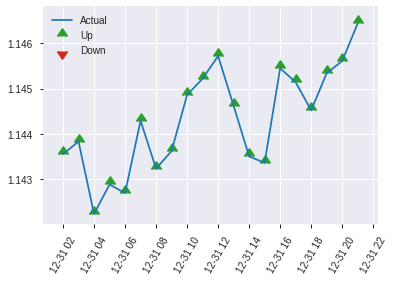


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.2495225104299638
RMSE: 0.49952228221568235
LogLoss: 0.6921339619793213
Mean Per-Class Error: 0.4486004928287104
AUC: 0.535187759314252
pr_auc: 0.5697318835242969
Gini: 0.070375518628504
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3561875820159912: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3561876,0.6872340,399.0
max f2,0.3561876,0.8459927,399.0
max f0point5,0.3879456,0.5789474,391.0
max accuracy,0.4866892,0.5542950,228.0
max precision,0.7349759,1.0,0.0
max recall,0.3561876,1.0,399.0
max specificity,0.7349759,1.0,0.0
max absolute_mcc,0.6080737,0.1354999,24.0
max min_per_class_accuracy,0.4937555,0.5386997,208.0
max mean_per_class_accuracy,0.4866892,0.5513995,228.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.69 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6438288,1.3644405,1.3644405,0.7142857,0.6744145,0.7142857,0.6744145,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.6242434,1.5918473,1.4693975,0.8333333,0.6318598,0.7692308,0.6547739,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.6167518,1.9102167,1.6086036,1.0,0.6210145,0.8421053,0.6441130,0.0185759,0.0495356,91.0216718,60.8603552
,4,0.0405186,0.6085430,1.5918473,1.6045820,0.8333333,0.6131198,0.84,0.6366747,0.0154799,0.0650155,59.1847265,60.4582043
,5,0.0502431,0.6024273,0.6367389,1.4172576,0.3333333,0.6053307,0.7419355,0.6306081,0.0061920,0.0712074,-36.3261094,41.7257565
,6,0.1004862,0.5731129,0.8010586,1.1091581,0.4193548,0.5872515,0.5806452,0.6089298,0.0402477,0.1114551,-19.8941376,10.9158094
,7,0.1507293,0.5527557,1.2323979,1.1502380,0.6451613,0.5610990,0.6021505,0.5929862,0.0619195,0.1733746,23.2397883,15.0238024
,8,0.2009724,0.5367337,0.8626785,1.0783481,0.4516129,0.5442567,0.5645161,0.5808038,0.0433437,0.2167183,-13.7321482,7.8348147
,9,0.2998379,0.5192420,0.9707659,1.0428751,0.5081967,0.5271786,0.5459459,0.5631220,0.0959752,0.3126935,-2.9234127,4.2875073
,10,0.4003241,0.5057064,1.1091581,1.0595129,0.5806452,0.5128896,0.5546559,0.5505131,0.1114551,0.4241486,10.9158094,5.9512917


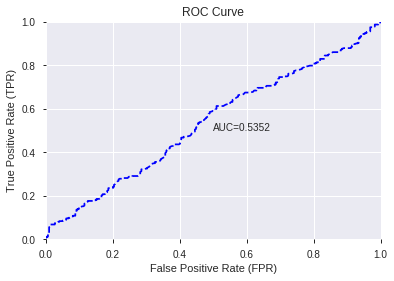

This function is available for GLM models only


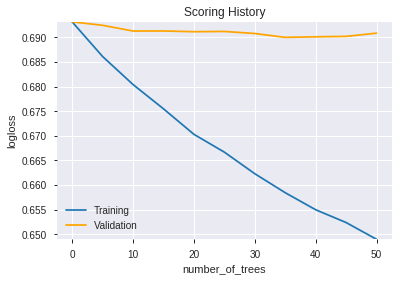

--2019-12-08 07:25:55--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.161.179
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.161.179|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
Exception in thread "main" java.lang.StackOverflowError
	at java.base/java.lang.String.substring(String.java:1874)
	at java.base/java.lang.String.split(String.java:2289)
	at java.base/java.lang.String.split(String.java:2364)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:101)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:106)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:112)
	at hex.genmodel.algos.xgboost.XGBoostMojoMo

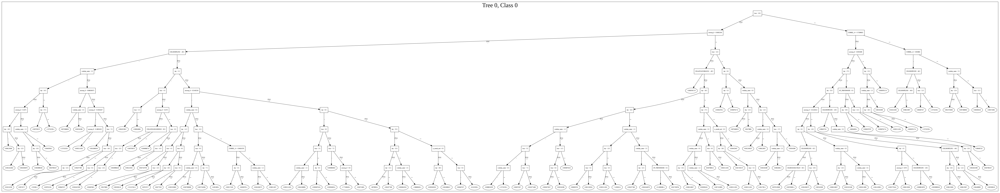

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_3_AutoML_20191208_072534',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_3_AutoML_20191208_072534',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_35_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_35_sid_887f',
   'type

['STOCHRSI_fastk',
 'BOP',
 'Volume',
 'hour',
 'day',
 'aroonup_8',
 'weekday_name',
 'CORREL_14',
 'CDLSHORTLINE',
 'CORREL_12',
 'days_in_month',
 'HT_TRENDMODE',
 'CDLRICKSHAWMAN',
 'CDLDOJI',
 'is_month_start',
 'CDLHAMMER',
 'is_month_end',
 'CDLDRAGONFLYDOJI',
 'CDLGRAVESTONEDOJI',
 'CDLHARAMICROSS',
 'CDLHANGINGMAN',
 'CDLHIKKAKEMOD',
 'CDLXSIDEGAP3METHODS',
 'CDLMATCHINGLOW',
 'CDL3INSIDE',
 'CDLADVANCEBLOCK',
 'CDLLONGLEGGEDDOJI']

In [18]:
# All algos with top DeepLearning features
model_train(feature_name='DLF',model_algo=None,features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_072653_model_1,0.529975,0.694103,0.498299,0.500476,0.250476


,variable,relative_importance,scaled_importance,percentage
0,CDLSHORTLINE,0.008538,1.000000,0.019061
1,aroonup_8,0.007059,0.826744,0.015758
2,hour,0.006835,0.800495,0.015258
3,STOCHRSI_fastk,0.006258,0.732887,0.013969
4,BOP,0.006248,0.731811,0.013949
...,...,...,...,...
947,BBANDS_middleband_24_2_3,0.000000,0.000000,0.000000
948,BBANDS_middleband_30_2_3,0.000000,0.000000,0.000000
949,BBANDS_middleband_30_5_2,0.000000,0.000000,0.000000
950,BBANDS_middleband_30_6_2,0.000000,0.000000,0.000000


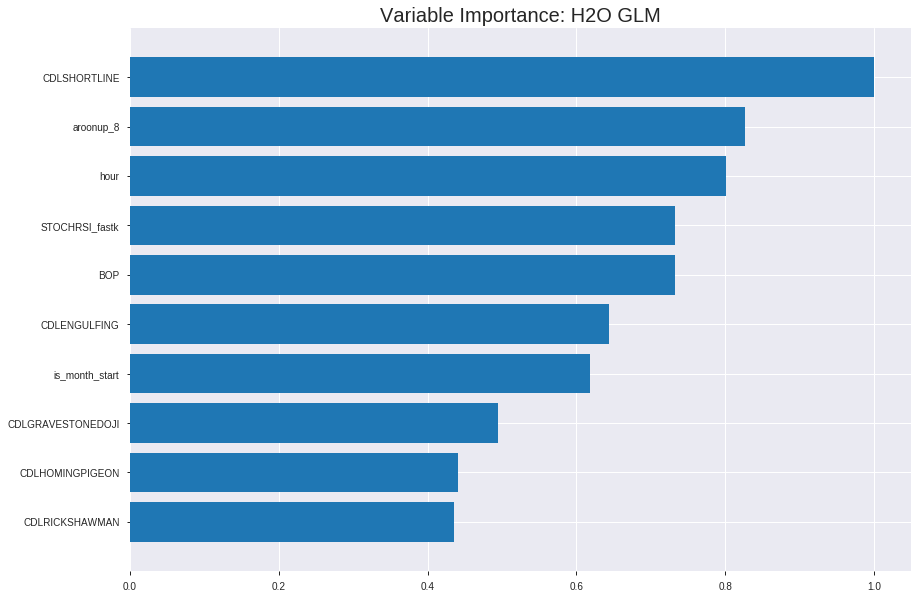

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_072653_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24836982429218807
RMSE: 0.4983671581195816
LogLoss: 0.6898824805369406
Null degrees of freedom: 4318
Residual degrees of freedom: 3385
Null deviance: 5986.754947319863
Residual deviance: 5959.204866878093
AIC: 7827.204866878093
AUC: 0.5583693529424129
pr_auc: 0.5509099632254683
Gini: 0.11673870588482571
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.45118675135706754: 


,0,1,Error,Rate
0,7.0,2179.0,0.9968,(2179.0/2186.0)
1,1.0,2132.0,0.0005,(1.0/2133.0)
Total,8.0,4311.0,0.5047,(2180.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4511868,0.6617008,393.0
max f2,0.4483516,0.8300903,396.0
max f0point5,0.4695589,0.5560161,340.0
max accuracy,0.4933300,0.5445705,209.0
max precision,0.5828778,1.0,0.0
max recall,0.4483516,1.0,396.0
max specificity,0.5828778,1.0,0.0
max absolute_mcc,0.5108556,0.0960796,111.0
max min_per_class_accuracy,0.4936412,0.5425435,207.0
max mean_per_class_accuracy,0.4933300,0.5446582,209.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5379126,1.3345587,1.3345587,0.6590909,0.5466020,0.6590909,0.5466020,0.0135959,0.0135959,33.4558667,33.4558667
,2,0.0201436,0.5316129,1.3185054,1.3266243,0.6511628,0.5341298,0.6551724,0.5404376,0.0131271,0.0267229,31.8505435,32.6624311
,3,0.0300996,0.5279928,1.4126844,1.3550903,0.6976744,0.5299427,0.6692308,0.5369662,0.0140647,0.0407876,41.2684395,35.5090339
,4,0.0400556,0.5246799,1.2714160,1.3342927,0.6279070,0.5263339,0.6589595,0.5343235,0.0126582,0.0534459,27.1415955,33.4292660
,5,0.0500116,0.5229627,1.0359686,1.2749041,0.5116279,0.5237463,0.6296296,0.5322178,0.0103141,0.0637600,3.5968556,27.4904065
,6,0.1000232,0.5163472,1.2092840,1.2420940,0.5972222,0.5194346,0.6134259,0.5258262,0.0604782,0.1242382,20.9284003,24.2094034
,7,0.1500347,0.5118006,1.1342896,1.2061592,0.5601852,0.5141359,0.5956790,0.5219294,0.0567276,0.1809658,13.4289646,20.6159238
,8,0.2000463,0.5083508,1.1061668,1.1811611,0.5462963,0.5099970,0.5833333,0.5189463,0.0553211,0.2362869,10.6166762,18.1161119
,9,0.3000695,0.5027993,1.0171110,1.1264777,0.5023148,0.5056126,0.5563272,0.5145018,0.1017346,0.3380216,1.7110964,12.6477734
,10,0.4000926,0.4979136,1.0030495,1.0956207,0.4953704,0.5002923,0.5410880,0.5109494,0.1003282,0.4383497,0.3049522,9.5620681




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.24959235610544206
RMSE: 0.4995921897962798
LogLoss: 0.6923317296383404
Null degrees of freedom: 1233
Residual degrees of freedom: 300
Null deviance: 1710.4803758483042
Residual deviance: 1708.6747087474241
AIC: 3576.674708747424
AUC: 0.520543842364532
pr_auc: 0.5215931665876472
Gini: 0.04108768472906399
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.44875101181618093: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4487510,0.6615970,397.0
max f2,0.4487510,0.8301527,397.0
max f0point5,0.4487510,0.5499368,397.0
max accuracy,0.4963162,0.5291734,135.0
max precision,0.5593444,1.0,0.0
max recall,0.4487510,1.0,397.0
max specificity,0.5593444,1.0,0.0
max absolute_mcc,0.5161880,0.0848711,33.0
max min_per_class_accuracy,0.4872976,0.5088,201.0
max mean_per_class_accuracy,0.4963162,0.5263934,135.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 48.71 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5241509,1.2469370,1.2469370,0.6153846,0.5336905,0.6153846,0.5336905,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.5202396,1.5197044,1.3778654,0.75,0.5214643,0.68,0.5278220,0.0147783,0.0279146,51.9704433,37.7865353
,3,0.0299838,0.5170764,1.1819923,1.3143390,0.5833333,0.5183830,0.6486486,0.5247607,0.0114943,0.0394089,18.1992337,31.4338970
,4,0.0405186,0.5159044,1.7145383,1.4183908,0.8461538,0.5165524,0.7,0.5226265,0.0180624,0.0574713,71.4538335,41.8390805
,5,0.0502431,0.5140609,0.8442802,1.3072726,0.4166667,0.5149452,0.6451613,0.5211398,0.0082102,0.0656814,-15.5719759,30.7272631
,6,0.1004862,0.5088829,0.8170454,1.0621590,0.4032258,0.5112501,0.5241935,0.5161950,0.0410509,0.1067323,-18.2954606,6.2159013
,7,0.1499190,0.5047144,1.0961802,1.0733768,0.5409836,0.5066338,0.5297297,0.5130424,0.0541872,0.1609195,9.6180247,7.3376825
,8,0.2001621,0.5009059,1.1438636,1.0910698,0.5645161,0.5027055,0.5384615,0.5104477,0.0574713,0.2183908,14.3863552,9.1069850
,9,0.2998379,0.4956933,1.0543207,1.0788532,0.5203252,0.4980037,0.5324324,0.5063109,0.1050903,0.3234811,5.4320691,7.8853237
,10,0.4003241,0.4908081,0.8987499,1.0336451,0.4435484,0.4930211,0.5101215,0.5029750,0.0903120,0.4137931,-10.1250066,3.3645121



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 07:26:57,0.000 sec,2,.27E1,934,1.3797650,1.3846635
,2019-12-08 07:27:00,2.324 sec,4,.2E1,937,1.3783517,1.3847884
,2019-12-08 07:27:02,4.659 sec,6,.14E1,937,1.3766759,1.3849111
,2019-12-08 07:27:05,7.047 sec,8,.1E1,937,1.3747459,1.3851804
,2019-12-08 07:27:07,9.417 sec,10,.75E0,945,1.3725697,1.3857078
,2019-12-08 07:27:09,11.720 sec,12,.55E0,945,1.3701720,1.3865706


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5429497568881686)

('F1', 0.6879659211927582)

('auc', 0.5299751479539184)

('logloss', 0.6941030186152913)

('mean_per_class_error', 0.4557928434531707)

('rmse', 0.5004761139840862)

('mse', 0.2504763406686121)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


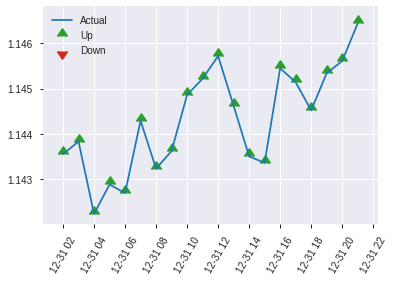


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.2504763406686121
RMSE: 0.5004761139840862
LogLoss: 0.6941030186152913
Null degrees of freedom: 616
Residual degrees of freedom: -317
Null deviance: 856.148314083962
Residual deviance: 856.5231249712696
AIC: 2724.5231249712697
AUC: 0.5299751479539184
pr_auc: 0.5543671007090404
Gini: 0.05995029590783685
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4483366774276998: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4483367,0.6879659,398.0
max f2,0.4483367,0.8464361,398.0
max f0point5,0.4483367,0.5794761,398.0
max accuracy,0.4740212,0.5429498,277.0
max precision,0.5420202,1.0,0.0
max recall,0.4483367,1.0,398.0
max specificity,0.5420202,1.0,0.0
max absolute_mcc,0.4861970,0.0889413,182.0
max min_per_class_accuracy,0.4830840,0.5068027,204.0
max mean_per_class_accuracy,0.4861970,0.5442072,182.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 48.35 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5223840,1.3644405,1.3644405,0.7142857,0.5277957,0.7142857,0.5277957,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.5170586,1.5918473,1.4693975,0.8333333,0.5202647,0.7692308,0.5243198,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.5140307,0.9551084,1.3069904,0.5,0.5152844,0.6842105,0.5214665,0.0092879,0.0402477,-4.4891641,30.6990386
,4,0.0405186,0.5118911,0.3183695,1.0697214,0.1666667,0.5127537,0.56,0.5193755,0.0030960,0.0433437,-68.1630547,6.9721362
,5,0.0502431,0.5102232,1.2734778,1.1091581,0.6666667,0.5108229,0.5806452,0.5177201,0.0123839,0.0557276,27.3477812,10.9158094
,6,0.1004862,0.5052854,1.1091581,1.1091581,0.5806452,0.5076844,0.5806452,0.5127022,0.0557276,0.1114551,10.9158094,10.9158094
,7,0.1507293,0.5012882,0.8626785,1.0269982,0.4516129,0.5031574,0.5376344,0.5095206,0.0433437,0.1547988,-13.7321482,2.6998236
,8,0.2009724,0.4968007,1.1707780,1.0629432,0.6129032,0.4988319,0.5564516,0.5068485,0.0588235,0.2136223,17.0777989,6.2943174
,9,0.2998379,0.4920355,1.0333959,1.0532006,0.5409836,0.4942409,0.5513514,0.5026914,0.1021672,0.3157895,3.3395930,5.3200569
,10,0.4003241,0.4879561,1.1091581,1.0672466,0.5806452,0.4898440,0.5587045,0.4994665,0.1114551,0.4272446,10.9158094,6.7246588


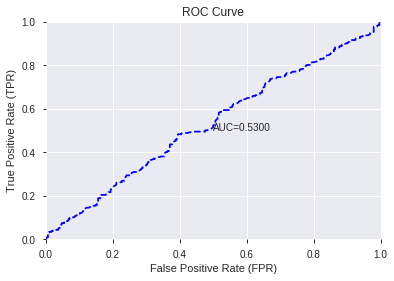

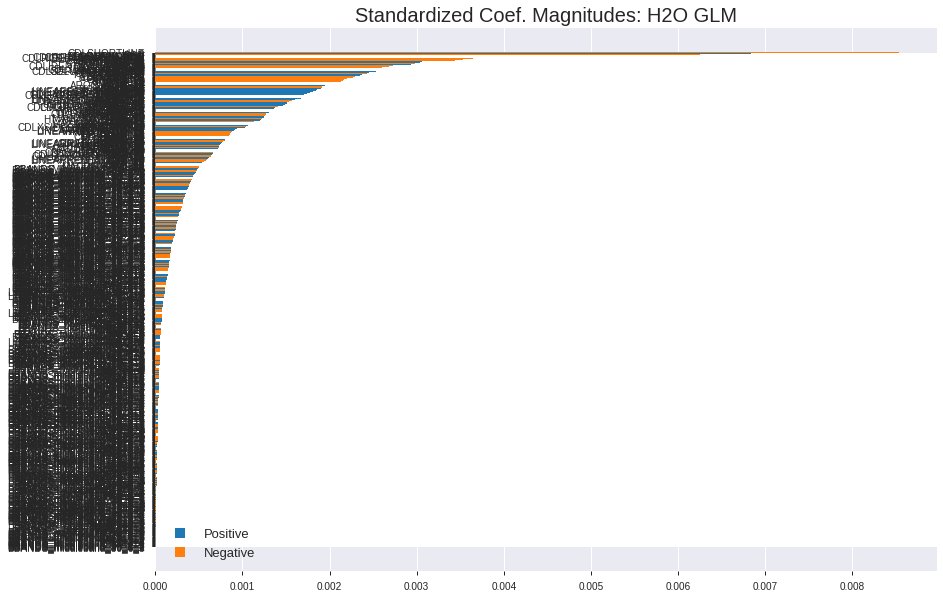

'log_likelihood'
--2019-12-08 07:27:33--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.244.132
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.244.132|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


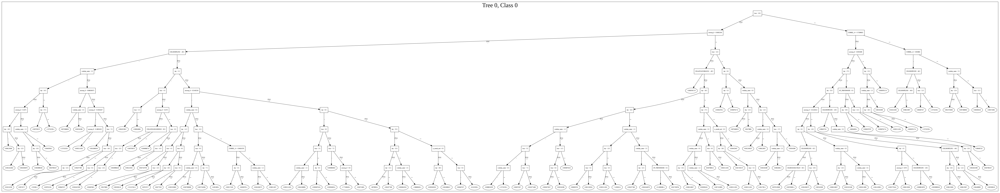

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_072653_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_072653_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_40_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_40_s

['CDLSHORTLINE',
 'aroonup_8',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'CDLENGULFING',
 'is_month_start',
 'CDLGRAVESTONEDOJI',
 'CDLHOMINGPIGEON',
 'CDLRICKSHAWMAN',
 'CDLRISEFALL3METHODS',
 'STOCHF_fastk',
 'CDLONNECK',
 'CDLTHRUSTING',
 'Volume',
 'AROONOSC_8',
 'DX_14',
 'CDLHARAMI',
 'DX_20',
 'STDDEV_24',
 'STOCHRSI_fastd',
 'ADOSC',
 'DX_12',
 'aroondown_20',
 'DX_24',
 'CDLIDENTICAL3CROWS',
 'BETA_30',
 'is_month_end',
 'CDLDOJISTAR',
 'ULTOSC',
 'CDL3BLACKCROWS',
 'quarter',
 'days_in_month',
 'CORREL_20',
 'CDLSEPARATINGLINES',
 'CDLUNIQUE3RIVER',
 'SAREXT',
 'STDDEV_30',
 'CDL3OUTSIDE',
 'HT_DCPERIOD',
 'SUB',
 'DIV',
 'STDDEV_20',
 'CDLINNECK',
 'aroondown_30',
 'MFI_20',
 'CDLHAMMER',
 'ADXR_8',
 'TRANGE',
 'CORREL_24']

952

['CDLSHORTLINE',
 'aroonup_8',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'CDLENGULFING',
 'is_month_start',
 'CDLGRAVESTONEDOJI',
 'CDLHOMINGPIGEON',
 'CDLRICKSHAWMAN',
 'CDLRISEFALL3METHODS',
 'STOCHF_fastk',
 'CDLONNECK',
 'CDLTHRUSTING',
 'Volume',
 'AROONOSC_8',
 'DX_14',
 'CDLHARAMI',
 'DX_20',
 'STDDEV_24',
 'STOCHRSI_fastd',
 'ADOSC',
 'DX_12',
 'aroondown_20',
 'DX_24',
 'CDLIDENTICAL3CROWS',
 'BETA_30',
 'is_month_end',
 'CDLDOJISTAR',
 'ULTOSC',
 'CDL3BLACKCROWS',
 'quarter',
 'days_in_month',
 'CORREL_20',
 'CDLSEPARATINGLINES',
 'CDLUNIQUE3RIVER',
 'SAREXT',
 'STDDEV_30',
 'CDL3OUTSIDE',
 'HT_DCPERIOD',
 'SUB',
 'DIV',
 'STDDEV_20',
 'CDLINNECK',
 'aroondown_30',
 'MFI_20',
 'CDLHAMMER',
 'ADXR_8',
 'TRANGE',
 'CORREL_24']

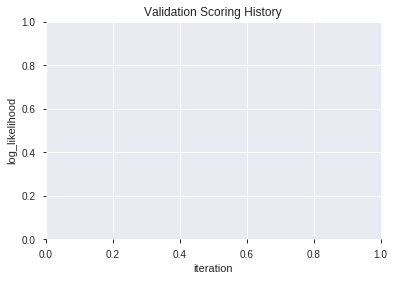

In [19]:
# GLM
features_list = model_train(feature_name='All',model_algo="GLM")
display(features_list[:model_selected_features])
display(len(features_list),features_list[:model_selected_features])

In [20]:
# DeepLearning with top GLM features
model_train(feature_name='GLMF',model_algo="DeepLearning",features_list = features_list[:model_selected_features])

[]

In [21]:
# GLM with top GLM features
model_train(feature_name='GLMF',model_algo="GLM",features_list = features_list[:model_selected_features])

[]

In [22]:
# XGBoost with top GLM features
model_train(feature_name='GLMF',model_algo="XGBoost",features_list = features_list[:model_selected_features])

[]

In [23]:
# DRF with top GLM features
model_train(feature_name='GLMF',model_algo="DRF",features_list = features_list[:model_selected_features])

[]

In [24]:
# GBM with top GLM features
model_train(feature_name='GLMF',model_algo="GBM",features_list = features_list[:model_selected_features])

[]

In [25]:
# StackedEnsemble with top GLM features
model_train(feature_name='GLMF',model_algo="StackedEnsemble",features_list = features_list[:model_selected_features])

[]

In [26]:
# All algos with top GLM features
model_train(feature_name='GLMF',model_algo=None,features_list = features_list[:model_selected_features])

[]

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_grid_1_AutoML_20191208_072831_model_4,0.562304,0.686389,0.484083,0.496631,0.246642
1,XGBoost_grid_1_AutoML_20191208_072831_model_1,0.544707,0.696446,0.498299,0.501516,0.251518
2,XGBoost_1_AutoML_20191208_072831,0.527606,0.694173,0.491344,0.500521,0.250521
3,XGBoost_grid_1_AutoML_20191208_072831_model_6,0.524847,0.704269,0.482230,0.505061,0.255086
4,XGBoost_grid_1_AutoML_20191208_072831_model_3,0.521893,0.700792,0.489491,0.503585,0.253598
5,XGBoost_grid_1_AutoML_20191208_072831_model_7,0.514458,0.707073,0.494898,0.506466,0.256508
6,XGBoost_grid_1_AutoML_20191208_072831_model_2,0.513511,0.693095,0.492892,0.499996,0.249996
7,XGBoost_grid_1_AutoML_20191208_072831_model_5,0.513432,0.709251,0.477760,0.507604,0.257662
8,XGBoost_3_AutoML_20191208_072831,0.512647,0.702278,0.500000,0.504363,0.254382
9,XGBoost_2_AutoML_20191208_072831,0.508825,0.702240,0.498147,0.504327,0.254346


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,118.073410,1.000000,0.022544
1,hour,105.346878,0.892215,0.020114
2,BOP,90.738945,0.768496,0.017325
3,HT_DCPERIOD,86.851311,0.735570,0.016583
4,AROONOSC_8,85.249847,0.722007,0.016277
...,...,...,...,...
202,BBANDS_lowerband_8_3_5,5.380174,0.045566,0.001027
203,MINUS_DI_14,5.072889,0.042964,0.000969
204,PLUS_DM_30,4.735455,0.040106,0.000904
205,BBANDS_upperband_8_0_5,4.464686,0.037813,0.000852


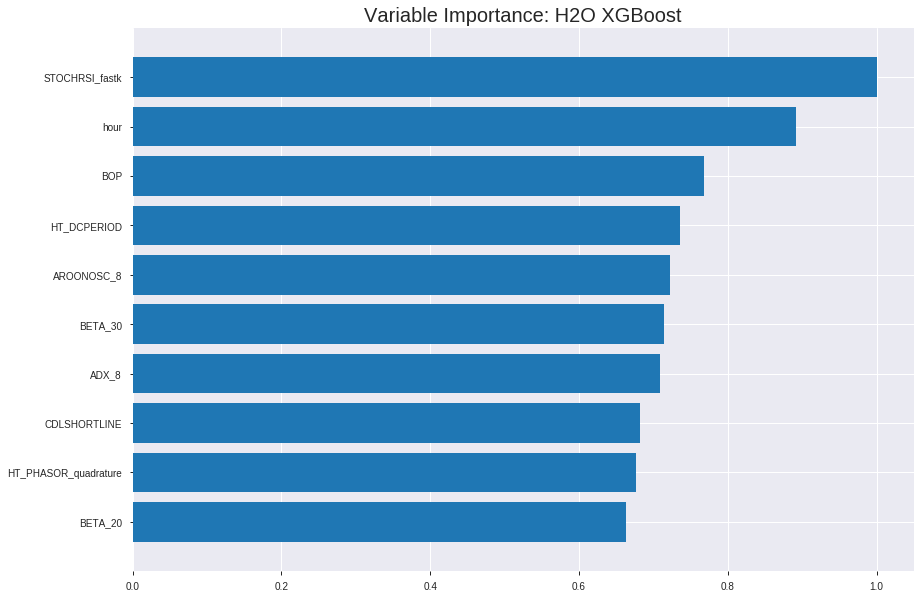

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_grid_1_AutoML_20191208_072831_model_4


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.22531173710216318
RMSE: 0.4746701350434459
LogLoss: 0.6431253469626521
Mean Per-Class Error: 0.30087472210533805
AUC: 0.7641618508267031
pr_auc: 0.7525032916769234
Gini: 0.5283237016534061
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4695351588726044: 


,0,1,Error,Rate
0,1124.0,1062.0,0.4858,(1062.0/2186.0)
1,347.0,1786.0,0.1627,(347.0/2133.0)
Total,1471.0,2848.0,0.3262,(1409.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4695352,0.7171251,243.0
max f2,0.4009261,0.8394452,339.0
max f0point5,0.5068059,0.7012741,180.0
max accuracy,0.4968321,0.6992359,197.0
max precision,0.7275871,1.0,0.0
max recall,0.3565138,1.0,380.0
max specificity,0.7275871,1.0,0.0
max absolute_mcc,0.4968321,0.3983252,197.0
max min_per_class_accuracy,0.4955062,0.6952649,199.0
max mean_per_class_accuracy,0.4968321,0.6991253,197.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.47 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6423986,2.0248476,2.0248476,1.0,0.6638371,1.0,0.6638371,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.6270162,1.8364897,1.9317512,0.9069767,0.6342448,0.9540230,0.6492110,0.0182841,0.0389123,83.6489713,93.1751190
,3,0.0300996,0.6141754,1.8364897,1.9002416,0.9069767,0.6198575,0.9384615,0.6395017,0.0182841,0.0571964,83.6489713,90.0241624
,4,0.0400556,0.6058150,1.6952213,1.8492828,0.8372093,0.6101122,0.9132948,0.6321968,0.0168776,0.0740741,69.5221274,84.9282809
,5,0.0500116,0.5973805,1.7423108,1.8279874,0.8604651,0.6014209,0.9027778,0.6260701,0.0173465,0.0914205,74.2310753,82.7987446
,6,0.1000232,0.5747529,1.6217530,1.7248702,0.8009259,0.5853657,0.8518519,0.6057179,0.0811064,0.1725270,62.1752965,72.4870205
,7,0.1500347,0.5596653,1.5842558,1.6779987,0.7824074,0.5665283,0.8287037,0.5926547,0.0792311,0.2517581,58.4255786,67.7998732
,8,0.2000463,0.5475433,1.5467586,1.6451887,0.7638889,0.5534388,0.8125,0.5828507,0.0773558,0.3291139,54.6758608,64.5188701
,9,0.3000695,0.5282412,1.4155185,1.5686320,0.6990741,0.5376204,0.7746914,0.5677739,0.1415846,0.4706985,41.5518484,56.8631962
,10,0.4000926,0.5108152,1.2186583,1.4811385,0.6018519,0.5190244,0.7314815,0.5555866,0.1218940,0.5925926,21.8658297,48.1138546




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.2522360489626114
RMSE: 0.5022310712835392
LogLoss: 0.6976789681308946
Mean Per-Class Error: 0.48088669950738916
AUC: 0.5133753694581281
pr_auc: 0.5158327898828068
Gini: 0.026750738916256234
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3723944425582886: 


,0,1,Error,Rate
0,8.0,617.0,0.9872,(617.0/625.0)
1,3.0,606.0,0.0049,(3.0/609.0)
Total,11.0,1223.0,0.5024,(620.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3723944,0.6615721,389.0
max f2,0.2977048,0.8297003,399.0
max f0point5,0.3826942,0.5513968,383.0
max accuracy,0.5938721,0.5243112,55.0
max precision,0.6978703,1.0,0.0
max recall,0.2977048,1.0,399.0
max specificity,0.6978703,1.0,0.0
max absolute_mcc,0.6337682,0.0740258,14.0
max min_per_class_accuracy,0.5305458,0.5136,182.0
max mean_per_class_accuracy,0.5930463,0.5191133,56.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 52.62 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6499347,1.4028041,1.4028041,0.6923077,0.6656924,0.6923077,0.6656924,0.0147783,0.0147783,40.2804092,40.2804092
,2,0.0202593,0.6281931,1.3508484,1.3778654,0.6666667,0.6349875,0.68,0.6509540,0.0131363,0.0279146,35.0848385,37.7865353
,3,0.0299838,0.6231438,1.1819923,1.3143390,0.5833333,0.6260683,0.6486486,0.6428830,0.0114943,0.0394089,18.1992337,31.4338970
,4,0.0405186,0.6134313,0.9352027,1.2157635,0.4615385,0.6174375,0.6,0.6362672,0.0098522,0.0492611,-6.4797272,21.5763547
,5,0.0502431,0.6092473,1.3508484,1.2419090,0.6666667,0.6111984,0.6129032,0.6314151,0.0131363,0.0623974,35.0848385,24.1908999
,6,0.1004862,0.5923358,1.1111817,1.1765454,0.5483871,0.6000774,0.5806452,0.6157463,0.0558292,0.1182266,11.1181736,17.6545368
,7,0.1499190,0.5807315,1.0297451,1.1281409,0.5081967,0.5862162,0.5567568,0.6060093,0.0509031,0.1691297,2.9745081,12.8140949
,8,0.2001621,0.5717204,0.7189999,1.0254416,0.3548387,0.5762641,0.5060729,0.5985429,0.0361248,0.2052545,-28.1000053,2.5441588
,9,0.2998379,0.5573176,1.1037420,1.0514712,0.5447154,0.5638426,0.5189189,0.5870074,0.1100164,0.3152709,10.3741973,5.1471176
,10,0.4003241,0.5427999,0.8497272,1.0008310,0.4193548,0.5494377,0.4939271,0.5775769,0.0853859,0.4006568,-15.0272790,0.0830990



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:29:05,12.530 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 07:29:06,13.557 sec,5.0,0.4968762,0.6869141,0.6390044,0.6285906,1.8867898,0.4494096,0.5000763,0.6933000,0.5045084,0.4942566,1.0910698,0.5064830
,2019-12-08 07:29:06,14.011 sec,10.0,0.4937473,0.6806956,0.6719492,0.6586741,1.8867898,0.4230146,0.4999678,0.6930820,0.5120972,0.5099762,1.4028041,0.5056726
,2019-12-08 07:29:07,14.419 sec,15.0,0.4909009,0.6750600,0.6973944,0.6862970,1.7947513,0.4225515,0.4999542,0.6930541,0.5157320,0.5181760,1.5586712,0.5064830
,2019-12-08 07:29:07,14.829 sec,20.0,0.4884395,0.6701964,0.7116884,0.6976353,1.7947513,0.3697615,0.5002830,0.6937144,0.5127278,0.5154451,1.2469370,0.5008104
,2019-12-08 07:29:08,15.230 sec,25.0,0.4854146,0.6642362,0.7269142,0.7164223,1.8867898,0.3790229,0.5006022,0.6943581,0.5114627,0.5132488,1.2469370,0.5064830
,2019-12-08 07:29:08,15.696 sec,30.0,0.4832485,0.6599635,0.7329285,0.7237038,1.9788284,0.3834221,0.5007912,0.6947468,0.5145603,0.5128431,0.9352027,0.5064830
,2019-12-08 07:29:09,16.124 sec,35.0,0.4806845,0.6549269,0.7445369,0.7337983,1.8867898,0.3417458,0.5009015,0.6949590,0.5143199,0.5198664,1.4028041,0.5064830
,2019-12-08 07:29:09,16.561 sec,40.0,0.4783505,0.6503338,0.7508186,0.7399560,1.9328091,0.3540171,0.5013913,0.6959461,0.5139284,0.5214719,1.7145383,0.5064830
,2019-12-08 07:29:09,16.980 sec,45.0,0.4760838,0.6458958,0.7607502,0.7498847,2.0248476,0.3338736,0.5021460,0.6974929,0.5126358,0.5179409,1.5586712,0.5056726


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
STOCHRSI_fastk,118.0734100,1.0,0.0225442
hour,105.3468781,0.8922151,0.0201143
BOP,90.7389450,0.7684960,0.0173252
HT_DCPERIOD,86.8513107,0.7355704,0.0165829
AROONOSC_8,85.2498474,0.7220072,0.0162771
---,---,---,---
BBANDS_lowerband_8_3_5,5.3801737,0.0455663,0.0010273
MINUS_DI_14,5.0728893,0.0429639,0.0009686
PLUS_DM_30,4.7354546,0.0401060,0.0009042
BBANDS_upperband_8_0_5,4.4646864,0.0378128,0.0008525



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5623987034035657)

('F1', 0.6912242686890573)

('auc', 0.5623038689159874)

('logloss', 0.686388636044166)

('mean_per_class_error', 0.43139361007560917)

('rmse', 0.49663098543927786)

('mse', 0.24664233569838823)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


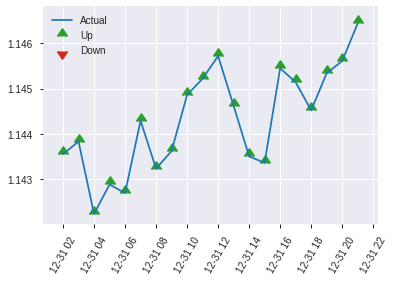


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.24664233569838823
RMSE: 0.49663098543927786
LogLoss: 0.686388636044166
Mean Per-Class Error: 0.43139361007560917
AUC: 0.5623038689159874
pr_auc: 0.5755633653399207
Gini: 0.12460773783197476
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4404434263706207: 


,0,1,Error,Rate
0,13.0,281.0,0.9558,(281.0/294.0)
1,4.0,319.0,0.0124,(4.0/323.0)
Total,17.0,600.0,0.4619,(285.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4404434,0.6912243,382.0
max f2,0.4165836,0.8482143,394.0
max f0point5,0.4404434,0.5857510,382.0
max accuracy,0.5430561,0.5623987,156.0
max precision,0.6417733,0.6666667,2.0
max recall,0.4165836,1.0,394.0
max specificity,0.6757681,0.9965986,0.0
max absolute_mcc,0.5430561,0.1418521,156.0
max min_per_class_accuracy,0.5285821,0.5479876,197.0
max mean_per_class_accuracy,0.5430561,0.5686064,156.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 52.88 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6213801,1.0915524,1.0915524,0.5714286,0.6406545,0.5714286,0.6406545,0.0123839,0.0123839,9.1552410,9.1552410
,2,0.0210697,0.6155095,0.9551084,1.0285782,0.5,0.6182769,0.5384615,0.6303264,0.0092879,0.0216718,-4.4891641,2.8578233
,3,0.0307942,0.6112445,1.5918473,1.2064527,0.8333333,0.6135690,0.6315789,0.6250346,0.0154799,0.0371517,59.1847265,20.6452664
,4,0.0405186,0.6060130,0.9551084,1.1461300,0.5,0.6087303,0.6,0.6211215,0.0092879,0.0464396,-4.4891641,14.6130031
,5,0.0502431,0.6021202,1.2734778,1.1707780,0.6666667,0.6047493,0.6129032,0.6179527,0.0123839,0.0588235,27.3477812,17.0777989
,6,0.1004862,0.5862076,1.1707780,1.1707780,0.6129032,0.5945990,0.6129032,0.6062759,0.0588235,0.1176471,17.0777989,17.0777989
,7,0.1507293,0.5767541,1.2323979,1.1913180,0.6451613,0.5814273,0.6236559,0.5979930,0.0619195,0.1795666,23.2397883,19.1317953
,8,0.2009724,0.5681405,1.2323979,1.2015879,0.6451613,0.5717329,0.6290323,0.5914280,0.0619195,0.2414861,23.2397883,20.1587936
,9,0.2998379,0.5505817,1.0960260,1.1667810,0.5737705,0.5587671,0.6108108,0.5806587,0.1083591,0.3498452,9.6025986,16.6781023
,10,0.4003241,0.5402625,1.0783481,1.1445833,0.5645161,0.5453884,0.5991903,0.5718054,0.1083591,0.4582043,7.8348147,14.4583297


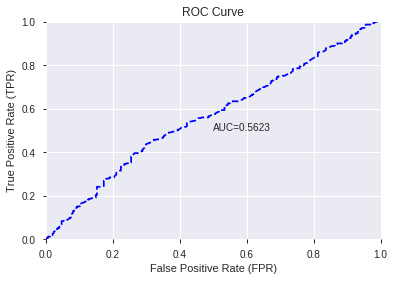

This function is available for GLM models only


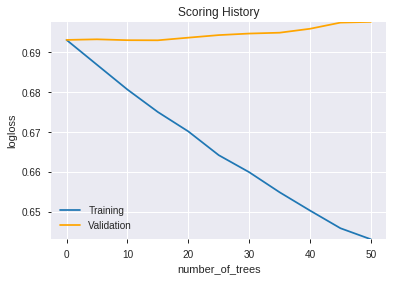

--2019-12-08 07:29:37--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 54.231.88.35
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|54.231.88.35|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
log4j:WARN No appenders could be found for logger (ml.dmlc.xgboost4j.java.Booster).
log4j:WARN Please initialize the log4j system properly.
log4j:WARN See http://logging.apache.org/log4j/1.2/faq.html#noconfig for more info.
Exception in thread "main" java.lang.StackOverflowError
	at hex.genmodel.algos.tree.SharedTreeNode.findInclusiveNa(SharedTreeNode.java:129)
	at hex.genmodel.algos.tree.SharedTreeNode.findInclusiveNa(SharedTreeNode.java:129)
	at hex.genmodel.algos.tree.SharedTreeNode.calculateChildInclusiveNa(SharedTreeNode.java:133)
	at hex.ge

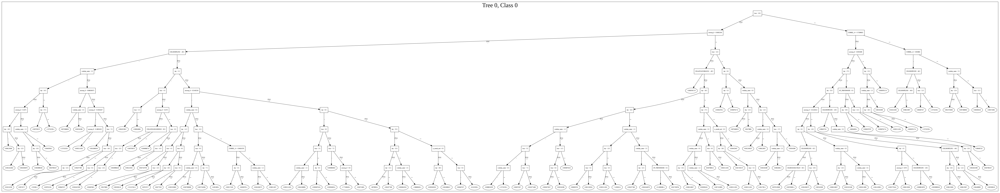

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_grid_1_AutoML_20191208_072831_model_4',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_grid_1_AutoML_20191208_072831_model_4',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_45_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training

207

['STOCHRSI_fastk',
 'hour',
 'BOP',
 'HT_DCPERIOD',
 'AROONOSC_8',
 'BETA_30',
 'ADX_8',
 'CDLSHORTLINE',
 'HT_PHASOR_quadrature',
 'BETA_20',
 'TRIX_8',
 'ADOSC',
 'STOCH_slowd',
 'Volume',
 'MFI_8',
 'WILLR_20',
 'ULTOSC',
 'SAREXT',
 'STDDEV_14',
 'CCI_8',
 'WILLR_12',
 'MFI_24',
 'HT_PHASOR_inphase',
 'MFI_20',
 'STDDEV_8',
 'MFI_14',
 'MOM_8',
 'AROONOSC_24',
 'STOCHRSI_fastd',
 'AROONOSC_20',
 'MFI_12',
 'ADXR_8',
 'BETA_12',
 'BBANDS_lowerband_24_2_5',
 'STDDEV_20',
 'CCI_12',
 'BETA_14',
 'STDDEV_30',
 'BETA_8',
 'MINUS_DM_8',
 'DX_12',
 'day',
 'MACDFIX_hist_24',
 'STOCHF_fastk',
 'ADX_12',
 'CMO_20',
 'DX_14',
 'dayofweek',
 'aroondown_20',
 'ATR_8']

In [27]:
# XGBoost
features_list = model_train(feature_name='All',model_algo="XGBoost")
display(len(features_list),features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,DeepLearning_grid_1_AutoML_20191208_073035_model_7,0.570686,0.782594,0.498299,0.526045,0.276724
1,DeepLearning_grid_1_AutoML_20191208_073035_model_8,0.562625,0.688644,0.500000,0.497781,0.247785
2,DeepLearning_grid_1_AutoML_20191208_073035_model_6,0.561714,0.686901,0.498299,0.496901,0.246911
3,DeepLearning_grid_1_AutoML_20191208_073035_model_1,0.554474,0.962406,0.498147,0.559406,0.312935
4,DeepLearning_grid_1_AutoML_20191208_073035_model_9,0.553469,0.690452,0.496446,0.498661,0.248662
5,DeepLearning_grid_1_AutoML_20191208_073035_model_5,0.552805,0.692847,0.483930,0.499646,0.249646
6,DeepLearning_grid_1_AutoML_20191208_073035_model_3,0.551336,0.801432,0.468777,0.534374,0.285556
7,DeepLearning_grid_1_AutoML_20191208_073035_model_4,0.544913,0.730228,0.498299,0.512356,0.262509
8,DeepLearning_1_AutoML_20191208_073035,0.542780,0.751764,0.485784,0.523300,0.273843
9,DeepLearning_grid_1_AutoML_20191208_073035_model_2,0.539442,0.879645,0.496599,0.550574,0.303132


,variable,relative_importance,scaled_importance,percentage
0,BOP,1.000000,1.000000,0.025189
1,CDLSHORTLINE,0.903877,0.903877,0.022768
2,BETA_14,0.884071,0.884071,0.022269
3,HT_DCPERIOD,0.867672,0.867672,0.021856
4,HT_PHASOR_quadrature,0.857187,0.857187,0.021591
5,STDDEV_20,0.855698,0.855698,0.021554
6,STOCHRSI_fastk,0.851102,0.851102,0.021438
7,dayofweek,0.849888,0.849888,0.021408
8,hour,0.842466,0.842466,0.021221
9,ULTOSC,0.831635,0.831635,0.020948


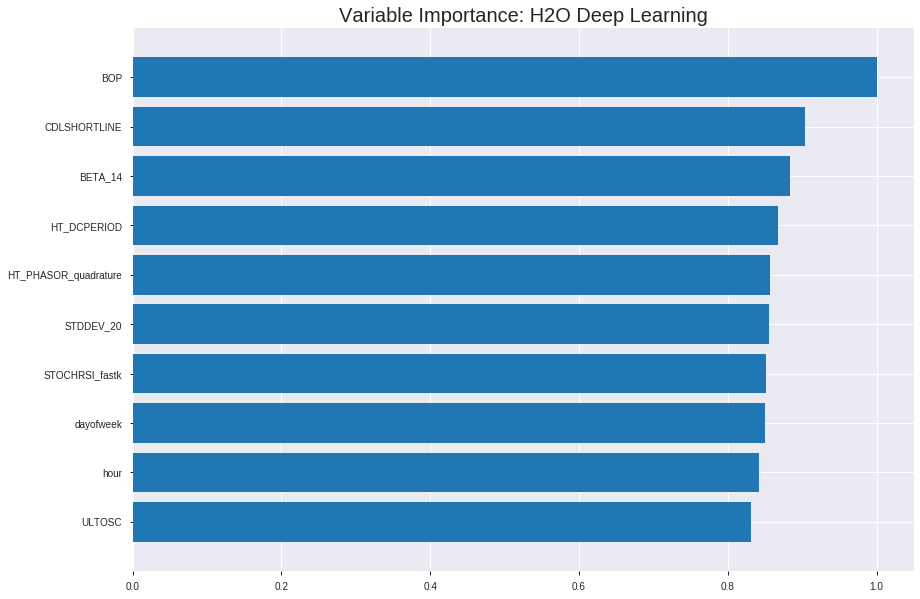

Model Details
H2ODeepLearningEstimator :  Deep Learning
Model Key:  DeepLearning_grid_1_AutoML_20191208_073035_model_7


ModelMetricsBinomial: deeplearning
** Reported on train data. **

MSE: 0.23926512905987124
RMSE: 0.48914734902672347
LogLoss: 0.6772222884886547
Mean Per-Class Error: 0.3914000743769004
AUC: 0.6605003326371758
pr_auc: 0.6607055219350775
Gini: 0.32100066527435156
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.13566273403680676: 


,0,1,Error,Rate
0,312.0,1874.0,0.8573,(1874.0/2186.0)
1,77.0,2056.0,0.0361,(77.0/2133.0)
Total,389.0,3930.0,0.4517,(1951.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.1356627,0.6782121,351.0
max f2,0.0490929,0.8331373,385.0
max f0point5,0.4273339,0.6041190,214.0
max accuracy,0.4975374,0.6091688,180.0
max precision,0.9969960,1.0,0.0
max recall,0.0154907,1.0,396.0
max specificity,0.9969960,1.0,0.0
max absolute_mcc,0.6698115,0.2291639,106.0
max min_per_class_accuracy,0.4347164,0.6075949,211.0
max mean_per_class_accuracy,0.4273339,0.6085999,214.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 45.18 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.9812264,1.9788284,1.9788284,0.9772727,0.9909839,0.9772727,0.9909839,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.9579756,2.0248476,2.0015735,1.0,0.9698798,0.9885057,0.9805531,0.0201594,0.0403188,102.4847632,100.1573522
,3,0.0300996,0.9312949,1.5539528,1.8535144,0.7674419,0.9436983,0.9153846,0.9683627,0.0154712,0.0557900,55.3952834,85.3514371
,4,0.0400556,0.9089553,1.6010423,1.7907612,0.7906977,0.9199119,0.8843931,0.9563200,0.0159400,0.0717300,60.1042314,79.0761201
,5,0.0500116,0.8840782,1.7423108,1.7811160,0.8604651,0.8973248,0.8796296,0.9445756,0.0173465,0.0890764,74.2310753,78.1115973
,6,0.1000232,0.8039646,1.4248928,1.6030044,0.7037037,0.8427759,0.7916667,0.8936757,0.0712611,0.1603376,42.4892778,60.3004376
,7,0.1500347,0.7314603,1.3124012,1.5061367,0.6481481,0.7652222,0.7438272,0.8508579,0.0656353,0.2259728,31.2401243,50.6136665
,8,0.2000463,0.6741958,1.3124012,1.4577028,0.6481481,0.6996552,0.7199074,0.8130572,0.0656353,0.2916081,31.2401243,45.7702809
,9,0.3000695,0.5690712,1.0874182,1.3342746,0.5370370,0.6196098,0.6589506,0.7485748,0.1087670,0.4003751,8.7418173,33.4274597
,10,0.4000926,0.4879860,1.0546081,1.2643580,0.5208333,0.5250299,0.6244213,0.6926885,0.1054852,0.5058603,5.4608142,26.4357983




ModelMetricsBinomial: deeplearning
** Reported on validation data. **

MSE: 0.29664818865285436
RMSE: 0.5446541918069248
LogLoss: 0.8455182728411752
Mean Per-Class Error: 0.4739901477832512
AUC: 0.5175711001642036
pr_auc: 0.5006759680676253
Gini: 0.0351422003284072
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.061210664618152: 


,0,1,Error,Rate
0,9.0,616.0,0.9856,(616.0/625.0)
1,3.0,606.0,0.0049,(3.0/609.0)
Total,12.0,1222.0,0.5016,(619.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0612107,0.6619334,391.0
max f2,0.0287945,0.8301527,398.0
max f0point5,0.2306177,0.5519950,329.0
max accuracy,0.4461000,0.5259319,216.0
max precision,0.9938307,0.6666667,2.0
max recall,0.0287945,1.0,398.0
max specificity,0.9985069,0.9984,0.0
max absolute_mcc,0.2815205,0.0587739,307.0
max min_per_class_accuracy,0.4461000,0.52,216.0
max mean_per_class_accuracy,0.4461000,0.5260099,216.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 47.20 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.9835738,1.0910698,1.0910698,0.5384615,0.9909716,0.5384615,0.9909716,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.9655242,0.5065681,0.8105090,0.25,0.9758704,0.4,0.9837231,0.0049261,0.0164204,-49.3431856,-18.9490969
,3,0.0299838,0.9514986,0.8442802,0.8214619,0.4166667,0.9576083,0.4054054,0.9752534,0.0082102,0.0246305,-15.5719759,-17.8538144
,4,0.0405186,0.9283917,1.0910698,0.8915599,0.5384615,0.9389907,0.44,0.9658251,0.0114943,0.0361248,9.1069850,-10.8440066
,5,0.0502431,0.9134039,1.0131363,0.9150908,0.5,0.9220727,0.4516129,0.9573569,0.0098522,0.0459770,1.3136289,-8.4909158
,6,0.1004862,0.8122996,1.1111817,1.0131363,0.5483871,0.8591819,0.5,0.9082694,0.0558292,0.1018062,11.1181736,1.3136289
,7,0.1499190,0.7357961,1.1958330,1.0733768,0.5901639,0.7759677,0.5297297,0.8646456,0.0591133,0.1609195,19.5832997,7.3376825
,8,0.2001621,0.6757696,0.7843636,1.0008310,0.3870968,0.7120660,0.4939271,0.8263463,0.0394089,0.2003284,-21.5636421,0.0830990
,9,0.2998379,0.5781586,1.0872682,1.0295655,0.5365854,0.6226812,0.5081081,0.7586414,0.1083744,0.3087028,8.7268213,2.9565526
,10,0.4003241,0.4950201,0.9314317,1.0049328,0.4596774,0.5336718,0.4959514,0.7021713,0.0935961,0.4022989,-6.8568250,0.4932756



Scoring History: 


,timestamp,duration,training_speed,epochs,iterations,samples,training_rmse,training_logloss,training_r2,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_r2,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:34:53,0.000 sec,None,0.0,0,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
,2019-12-08 07:34:58,6.230 sec,857 obs/sec,1.0,1,4319.0,0.5468955,0.8691343,-0.1965589,0.5454077,0.5282623,1.1965009,0.5059041,0.5543505,0.9227080,-0.2294247,0.5362982,0.5117067,0.9352027,0.5064830
,2019-12-08 07:35:11,19.167 sec,1284 obs/sec,5.0,5,21595.0,0.5531233,0.8842868,-0.2239659,0.5649878,0.5620315,1.7027128,0.5033573,0.5605344,0.9227864,-0.2570068,0.5387363,0.5147910,0.7793356,0.5056726
,2019-12-08 07:35:23,31.248 sec,1401 obs/sec,9.0,9,38871.0,0.5226407,0.7801800,-0.0927776,0.5999470,0.5825888,1.6106743,0.4572818,0.5547893,0.9281581,-0.2313716,0.5260650,0.5038830,0.7793356,0.5048622
,2019-12-08 07:35:35,42.954 sec,1467 obs/sec,13.0,13,56147.0,0.4891473,0.6772223,0.0427953,0.6605003,0.6607055,1.9788284,0.4517249,0.5446542,0.8455183,-0.1867923,0.5175711,0.5006760,1.0910698,0.5016207
,2019-12-08 07:35:48,56.473 sec,1535 obs/sec,18.0,18,77742.0,0.5102095,0.7549098,-0.0414120,0.7040021,0.6914206,1.9328091,0.3905997,0.5838727,1.0188881,-0.3638584,0.5063330,0.4940761,0.7793356,0.5016207
,2019-12-08 07:36:02,1 min 9.662 sec,1586 obs/sec,23.0,23,99337.0,0.4482277,0.5905920,0.1962468,0.7661160,0.7572796,2.0248476,0.3403566,0.5648413,0.9843152,-0.2763974,0.5061688,0.4871380,1.0910698,0.4975689
,2019-12-08 07:36:14,1 min 22.231 sec,1634 obs/sec,28.0,28,120932.0,0.4107237,0.5010658,0.3251224,0.8335490,0.8268254,2.0248476,0.2783052,0.5762205,0.9995964,-0.3283434,0.5008499,0.4861294,0.9352027,0.5048622
,2019-12-08 07:36:15,1 min 23.439 sec,1633 obs/sec,28.0,28,120932.0,0.4891473,0.6772223,0.0427953,0.6605003,0.6607055,1.9788284,0.4517249,0.5446542,0.8455183,-0.1867923,0.5175711,0.5006760,1.0910698,0.5016207


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BOP,1.0,1.0,0.0251888
CDLSHORTLINE,0.9038770,0.9038770,0.0227675
BETA_14,0.8840712,0.8840712,0.0222687
HT_DCPERIOD,0.8676716,0.8676716,0.0218556
HT_PHASOR_quadrature,0.8571869,0.8571869,0.0215915
---,---,---,---
CCI_12,0.7296100,0.7296100,0.0183780
MFI_14,0.7275540,0.7275540,0.0183262
MACDFIX_hist_24,0.7217461,0.7217461,0.0181799
AROONOSC_20,0.7162711,0.7162711,0.0180420



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5737439222042139)

('F1', 0.6879659211927582)

('auc', 0.570686169204524)

('logloss', 0.7825938202674194)

('mean_per_class_error', 0.4307881047155704)

('rmse', 0.5260453728230138)

('mse', 0.2767237342685036)

deeplearning prediction progress: |███████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


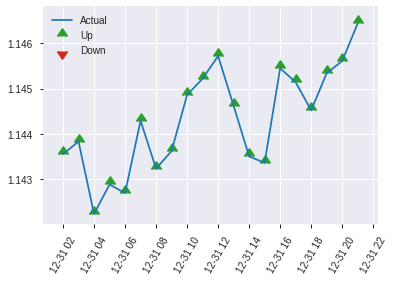


ModelMetricsBinomial: deeplearning
** Reported on test data. **

MSE: 0.2767237342685036
RMSE: 0.5260453728230138
LogLoss: 0.7825938202674194
Mean Per-Class Error: 0.4307881047155704
AUC: 0.570686169204524
pr_auc: 0.6026802621925549
Gini: 0.14137233840904795
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.01660799928249042: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0166080,0.6879659,398.0
max f2,0.0166080,0.8464361,398.0
max f0point5,0.3540870,0.5966065,241.0
max accuracy,0.3608490,0.5737439,236.0
max precision,0.9967134,1.0,0.0
max recall,0.0166080,1.0,398.0
max specificity,0.9967134,1.0,0.0
max absolute_mcc,0.3608490,0.1411030,236.0
max min_per_class_accuracy,0.4083624,0.5408163,202.0
max mean_per_class_accuracy,0.3608490,0.5692119,236.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 43.09 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.9731158,1.6373286,1.6373286,0.8571429,0.9858665,0.8571429,0.9858665,0.0185759,0.0185759,63.7328616,63.7328616
,2,0.0210697,0.9614856,1.5918473,1.6163372,0.8333333,0.9675435,0.8461538,0.9774098,0.0154799,0.0340557,59.1847265,61.6337223
,3,0.0307942,0.9254295,0.9551084,1.4075281,0.5,0.9467266,0.7368421,0.9677204,0.0092879,0.0433437,-4.4891641,40.7528108
,4,0.0405186,0.9064955,1.2734778,1.3753560,0.6666667,0.9165821,0.72,0.9554472,0.0123839,0.0557276,27.3477812,37.5356037
,5,0.0502431,0.8733075,1.5918473,1.4172576,0.8333333,0.8881664,0.7419355,0.9424251,0.0154799,0.0712074,59.1847265,41.7257565
,6,0.1004862,0.7489804,1.2323979,1.3248277,0.6451613,0.8175500,0.6935484,0.8799875,0.0619195,0.1331269,23.2397883,32.4827724
,7,0.1507293,0.6516832,1.1707780,1.2734778,0.6129032,0.6966810,0.6666667,0.8188853,0.0588235,0.1919505,17.0777989,27.3477812
,8,0.2009724,0.5909006,1.0475382,1.2169929,0.5483871,0.6166694,0.6370968,0.7683314,0.0526316,0.2445820,4.7538200,21.6992909
,9,0.2998379,0.5138448,0.9081358,1.1151535,0.4754098,0.5489544,0.5837838,0.6959963,0.0897833,0.3343653,-9.1864183,11.5153544
,10,0.4003241,0.4521996,1.0783481,1.1059149,0.5645161,0.4814463,0.5789474,0.6421416,0.1083591,0.4427245,7.8348147,10.5914942


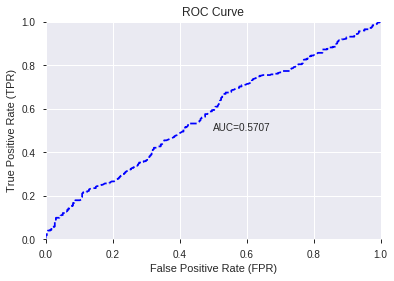

This function is available for GLM models only


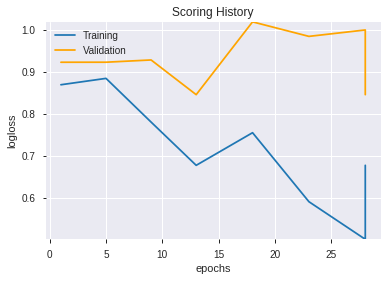

--2019-12-08 07:38:40--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.186.35
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.186.35|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


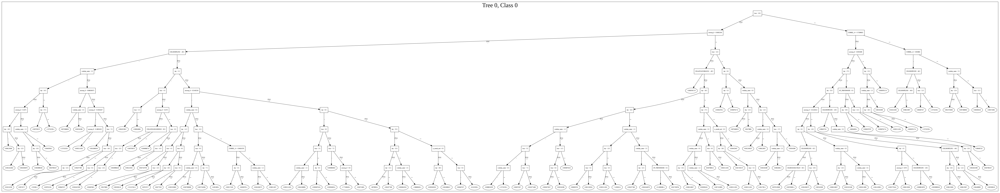

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/DeepLearning_grid_1_AutoML_20191208_073035_model_7',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'DeepLearning_grid_1_AutoML_20191208_073035_model_7',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_50_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'autom

['BOP',
 'CDLSHORTLINE',
 'BETA_14',
 'HT_DCPERIOD',
 'HT_PHASOR_quadrature',
 'STDDEV_20',
 'STOCHRSI_fastk',
 'dayofweek',
 'hour',
 'ULTOSC',
 'Volume',
 'AROONOSC_8',
 'DX_14',
 'BETA_20',
 'STOCH_slowd',
 'ATR_8',
 'STDDEV_30',
 'MFI_8',
 'DX_12',
 'BBANDS_lowerband_24_2_5',
 'HT_PHASOR_inphase',
 'STOCHRSI_fastd',
 'BETA_30',
 'day',
 'STOCHF_fastk',
 'SAREXT',
 'ADOSC',
 'BETA_8',
 'MFI_24',
 'ADXR_8',
 'AROONOSC_24',
 'WILLR_12',
 'MINUS_DM_8',
 'ADX_8',
 'BETA_12',
 'aroondown_20',
 'TRIX_8',
 'STDDEV_8',
 'WILLR_20',
 'MFI_12',
 'ADX_12',
 'CCI_8',
 'MOM_8',
 'STDDEV_14',
 'CMO_20',
 'CCI_12',
 'MFI_14',
 'MACDFIX_hist_24',
 'AROONOSC_20',
 'MFI_20']

In [28]:
# DeepLearning with top XGBoost features
model_train(feature_name='XGBF',model_algo="DeepLearning",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_073938_model_1,0.53265,0.692737,0.496446,0.499795,0.249795


,variable,relative_importance,scaled_importance,percentage
0,CDLSHORTLINE,0.013101,1.000000,0.073474
1,hour,0.011370,0.867822,0.063763
2,STOCHRSI_fastk,0.009974,0.761295,0.055936
3,BOP,0.009719,0.741861,0.054508
4,STDDEV_30,0.006383,0.487176,0.035795
5,STDDEV_20,0.006320,0.482398,0.035444
6,DX_14,0.005984,0.456762,0.033560
7,AROONOSC_8,0.005917,0.451620,0.033183
8,Volume,0.005901,0.450379,0.033091
9,STOCHF_fastk,0.005474,0.417789,0.030697


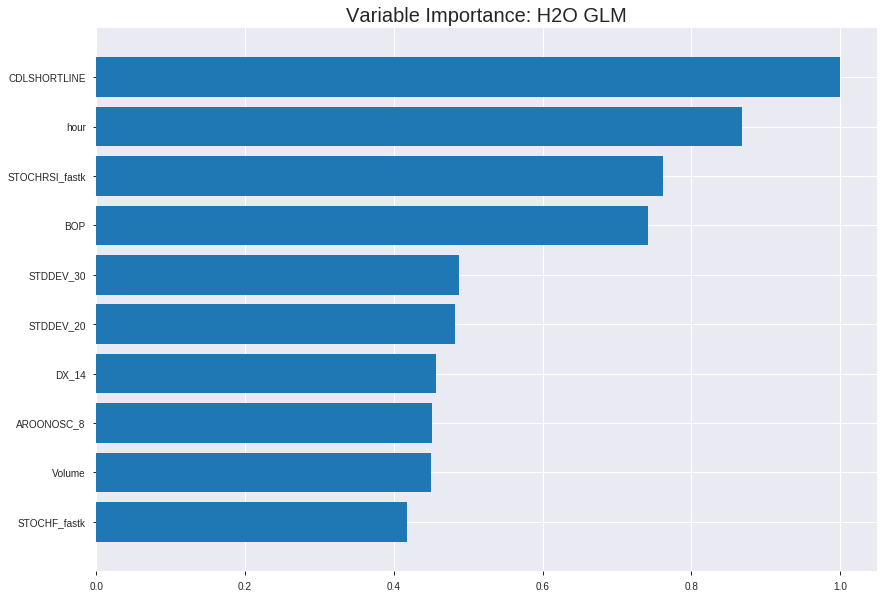

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_073938_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24889792613489836
RMSE: 0.4988967088836109
LogLoss: 0.6909411276821813
Null degrees of freedom: 4318
Residual degrees of freedom: 4268
Null deviance: 5986.754947319863
Residual deviance: 5968.349460918682
AIC: 6070.349460918682
AUC: 0.5481017805418189
pr_auc: 0.5359158740463539
Gini: 0.09620356108363781
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4653115636030117: 


,0,1,Error,Rate
0,27.0,2159.0,0.9876,(2159.0/2186.0)
1,4.0,2129.0,0.0019,(4.0/2133.0)
Total,31.0,4288.0,0.5008,(2163.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4653116,0.6631366,385.0
max f2,0.4653116,0.8303432,385.0
max f0point5,0.4752715,0.5541448,337.0
max accuracy,0.4932981,0.5408659,211.0
max precision,0.5645776,1.0,0.0
max recall,0.4565641,1.0,398.0
max specificity,0.5645776,1.0,0.0
max absolute_mcc,0.4932981,0.0816521,211.0
max min_per_class_accuracy,0.4931512,0.5402562,212.0
max mean_per_class_accuracy,0.4932981,0.5408280,211.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5311802,1.2885394,1.2885394,0.6363636,0.5384473,0.6363636,0.5384473,0.0131271,0.0131271,28.8539402,28.8539402
,2,0.0201436,0.5250576,1.2243265,1.2568020,0.6046512,0.5275415,0.6206897,0.5330570,0.0121894,0.0253165,22.4326475,25.6801979
,3,0.0300996,0.5221209,1.0359686,1.1837571,0.5116279,0.5234755,0.5846154,0.5298878,0.0103141,0.0356306,3.5968556,18.3757077
,4,0.0400556,0.5203330,0.9888791,1.1353192,0.4883721,0.5212045,0.5606936,0.5277295,0.0098453,0.0454759,-1.1120924,13.5319193
,5,0.0500116,0.5189171,1.1772370,1.1436639,0.5813953,0.5195971,0.5648148,0.5261105,0.0117206,0.0571964,17.7236996,14.3663941
,6,0.1000232,0.5128055,1.2374069,1.1905354,0.6111111,0.5155528,0.5879630,0.5208317,0.0618847,0.1190811,23.7406886,19.0535414
,7,0.1500347,0.5093503,1.0499210,1.1436639,0.5185185,0.5109850,0.5648148,0.5175494,0.0525082,0.1715893,4.9920995,14.3663941
,8,0.2000463,0.5062453,1.0405467,1.1178846,0.5138889,0.5077619,0.5520833,0.5151026,0.0520394,0.2236287,4.0546700,11.7884630
,9,0.3000695,0.5014177,1.1014796,1.1124163,0.5439815,0.5038798,0.5493827,0.5113616,0.1101735,0.3338022,10.1479615,11.2416292
,10,0.4000926,0.4972685,0.9936752,1.0827310,0.4907407,0.4992676,0.5347222,0.5083381,0.0993905,0.4331927,-0.6324773,8.2731026




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.2495751808327097
RMSE: 0.49957500020788637
LogLoss: 0.6922972370678478
Null degrees of freedom: 1233
Residual degrees of freedom: 1183
Null deviance: 1710.4803758483042
Residual deviance: 1708.5895810834484
AIC: 1810.5895810834484
AUC: 0.5232775041050903
pr_auc: 0.513105029716564
Gini: 0.04655500821018066
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.45986731335732706: 


,0,1,Error,Rate
0,0.0,625.0,1.0,(625.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,0.0,1234.0,0.5065,(625.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4598673,0.6608790,399.0
max f2,0.4598673,0.8297003,399.0
max f0point5,0.4693622,0.5518580,377.0
max accuracy,0.4928712,0.5283630,213.0
max precision,0.5434880,1.0,0.0
max recall,0.4598673,1.0,399.0
max specificity,0.5434880,1.0,0.0
max absolute_mcc,0.5221572,0.0611890,28.0
max min_per_class_accuracy,0.4938370,0.52,206.0
max mean_per_class_accuracy,0.4926783,0.5286621,214.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.40 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5281091,0.7793356,0.7793356,0.3846154,0.5344032,0.3846154,0.5344032,0.0082102,0.0082102,-22.0664393,-22.0664393
,2,0.0202593,0.5239451,1.6885605,1.2157635,0.8333333,0.5256194,0.6,0.5301870,0.0164204,0.0246305,68.8560482,21.5763547
,3,0.0299838,0.5223994,1.3508484,1.2595748,0.6666667,0.5231798,0.6216216,0.5279144,0.0131363,0.0377668,35.0848385,25.9574846
,4,0.0405186,0.5214665,0.9352027,1.1752381,0.4615385,0.5219856,0.58,0.5263729,0.0098522,0.0476190,-6.4797272,17.5238095
,5,0.0502431,0.5196894,0.8442802,1.1111817,0.4166667,0.5205301,0.5483871,0.5252420,0.0082102,0.0558292,-15.5719759,11.1181736
,6,0.1004862,0.5135909,1.1765454,1.1438636,0.5806452,0.5162743,0.5645161,0.5207582,0.0591133,0.1149425,17.6545368,14.3863552
,7,0.1499190,0.5095680,0.9633099,1.0843296,0.4754098,0.5114660,0.5351351,0.5176942,0.0476190,0.1625616,-3.6690086,8.4329650
,8,0.2001621,0.5068276,1.1111817,1.0910698,0.5483871,0.5080713,0.5384615,0.5152788,0.0558292,0.2183908,11.1181736,9.1069850
,9,0.2998379,0.5012519,0.8895831,1.0240891,0.4390244,0.5037093,0.5054054,0.5114327,0.0886700,0.3070608,-11.0416917,2.4089114
,10,0.4003241,0.4972115,0.9804545,1.0131363,0.4838710,0.4992826,0.5,0.5083829,0.0985222,0.4055829,-1.9545527,1.3136289



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 07:39:39,0.000 sec,2,.26E1,51,1.3829762,1.3846559
,2019-12-08 07:39:39,0.017 sec,4,.16E1,51,1.3818823,1.3845945
,2019-12-08 07:39:39,0.034 sec,6,.1E1,51,1.3805655,1.3847311
,2019-12-08 07:39:39,0.047 sec,8,.62E0,51,1.3790419,1.3851276
,2019-12-08 07:39:39,0.062 sec,10,.39E0,51,1.3773546,1.3858158
,2019-12-08 07:39:39,0.075 sec,12,.24E0,51,1.3755839,1.3868054
,2019-12-08 07:39:39,0.090 sec,14,.15E0,51,1.3738201,1.3880744


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5413290113452188)

('F1', 0.688034188034188)

('auc', 0.5326499020660896)

('logloss', 0.6927370685885547)

('mean_per_class_error', 0.46451212063772873)

('rmse', 0.4997951136827482)

('mse', 0.2497951556611512)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


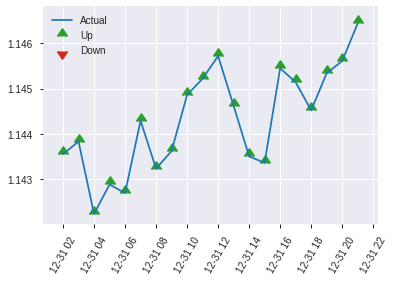


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.2497951556611512
RMSE: 0.4997951136827482
LogLoss: 0.6927370685885547
Null degrees of freedom: 616
Residual degrees of freedom: 566
Null deviance: 856.148314083962
Residual deviance: 854.8375426382764
AIC: 956.8375426382764
AUC: 0.5326499020660896
pr_auc: 0.5589959014339608
Gini: 0.06529980413217928
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4640428629592147: 


,0,1,Error,Rate
0,3.0,291.0,0.9898,(291.0/294.0)
1,1.0,322.0,0.0031,(1.0/323.0)
Total,4.0,613.0,0.4733,(292.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4640429,0.6880342,395.0
max f2,0.4626861,0.8459927,399.0
max f0point5,0.4741262,0.5834353,339.0
max accuracy,0.4741262,0.5413290,339.0
max precision,0.5295604,0.875,7.0
max recall,0.4626861,1.0,399.0
max specificity,0.5418753,0.9965986,0.0
max absolute_mcc,0.5204338,0.0812916,15.0
max min_per_class_accuracy,0.4895994,0.5170068,212.0
max mean_per_class_accuracy,0.4957162,0.5354879,155.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.10 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5298732,1.6373286,1.6373286,0.8571429,0.5344598,0.8571429,0.5344598,0.0185759,0.0185759,63.7328616,63.7328616
,2,0.0210697,0.5224576,1.2734778,1.4693975,0.6666667,0.5256425,0.7692308,0.5303903,0.0123839,0.0309598,27.3477812,46.9397476
,3,0.0307942,0.5199656,0.9551084,1.3069904,0.5,0.5209972,0.6842105,0.5274240,0.0092879,0.0402477,-4.4891641,30.6990386
,4,0.0405186,0.5182634,1.2734778,1.2989474,0.6666667,0.5189539,0.68,0.5253912,0.0123839,0.0526316,27.3477812,29.8947368
,5,0.0502431,0.5163482,1.2734778,1.2940178,0.6666667,0.5174787,0.6774194,0.5238598,0.0123839,0.0650155,27.3477812,29.4017777
,6,0.1004862,0.5107338,0.8010586,1.0475382,0.4193548,0.5133569,0.5483871,0.5186083,0.0402477,0.1052632,-19.8941376,4.7538200
,7,0.1507293,0.5063067,0.9859183,1.0269982,0.5161290,0.5087090,0.5376344,0.5153086,0.0495356,0.1547988,-1.4081694,2.6998236
,8,0.2009724,0.5036854,1.4788775,1.1399680,0.7741935,0.5050776,0.5967742,0.5127508,0.0743034,0.2291022,47.8877459,13.9968042
,9,0.2998379,0.4982207,0.9081358,1.0635261,0.4754098,0.5005187,0.5567568,0.5087175,0.0897833,0.3188854,-9.1864183,6.3526065
,10,0.4003241,0.4937515,1.1091581,1.0749803,0.5806452,0.4958448,0.5627530,0.5054863,0.1114551,0.4303406,10.9158094,7.4980258


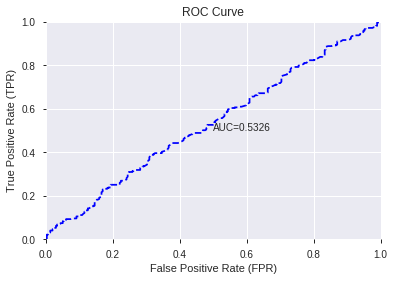

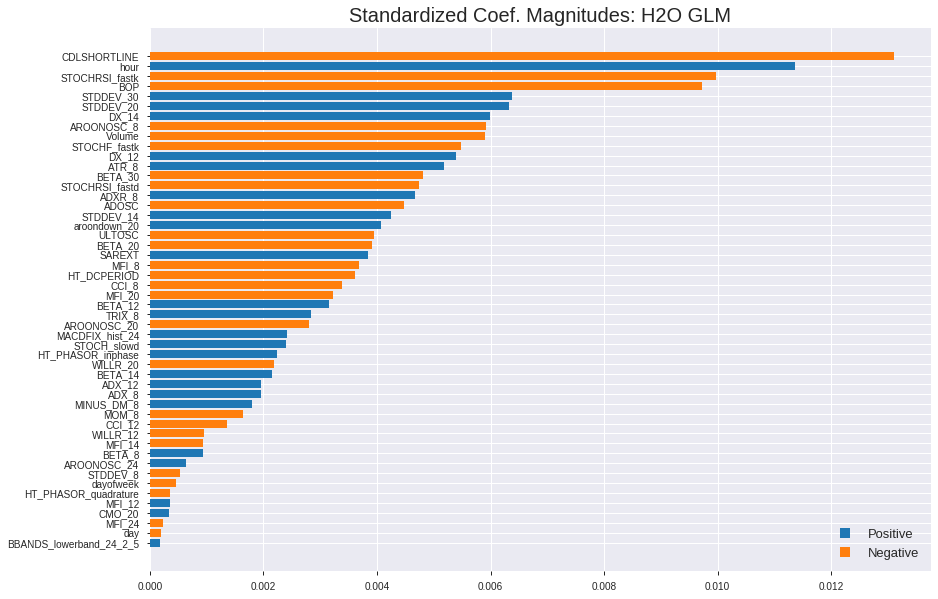

'log_likelihood'
--2019-12-08 07:39:48--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.83.32
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.83.32|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


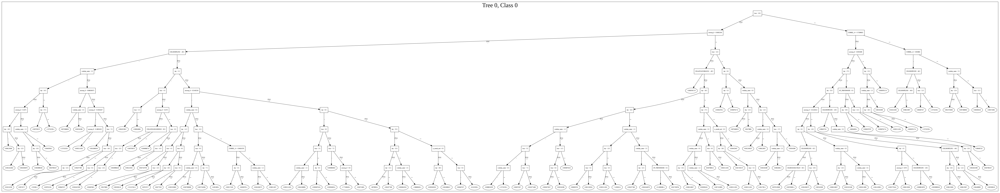

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_073938_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_073938_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_55_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_55_s

['CDLSHORTLINE',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'STDDEV_30',
 'STDDEV_20',
 'DX_14',
 'AROONOSC_8',
 'Volume',
 'STOCHF_fastk',
 'DX_12',
 'ATR_8',
 'BETA_30',
 'STOCHRSI_fastd',
 'ADXR_8',
 'ADOSC',
 'STDDEV_14',
 'aroondown_20',
 'ULTOSC',
 'BETA_20',
 'SAREXT',
 'MFI_8',
 'HT_DCPERIOD',
 'CCI_8',
 'MFI_20',
 'BETA_12',
 'TRIX_8',
 'AROONOSC_20',
 'MACDFIX_hist_24',
 'STOCH_slowd',
 'HT_PHASOR_inphase',
 'WILLR_20',
 'BETA_14',
 'ADX_12',
 'ADX_8',
 'MINUS_DM_8',
 'MOM_8',
 'CCI_12',
 'WILLR_12',
 'MFI_14',
 'BETA_8',
 'AROONOSC_24',
 'STDDEV_8',
 'dayofweek',
 'HT_PHASOR_quadrature',
 'MFI_12',
 'CMO_20',
 'MFI_24',
 'day',
 'BBANDS_lowerband_24_2_5']

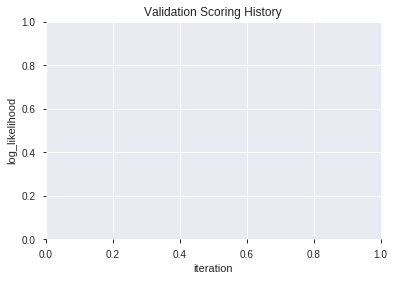

In [29]:
# GLM with top XGBoost features
model_train(feature_name='XGBF',model_algo="GLM",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_grid_1_AutoML_20191208_074046_model_4,0.569407,0.684076,0.494898,0.495495,0.245515
1,XGBoost_grid_1_AutoML_20191208_074046_model_5,0.568464,0.696241,0.494898,0.501037,0.251038
2,XGBoost_grid_1_AutoML_20191208_074046_model_7,0.563883,0.689498,0.500000,0.498062,0.248065
3,XGBoost_grid_1_AutoML_20191208_074046_model_2,0.552726,0.686838,0.498299,0.496905,0.246914
4,XGBoost_1_AutoML_20191208_074046,0.547308,0.692673,0.491191,0.499669,0.249669
5,XGBoost_2_AutoML_20191208_074046,0.542659,0.695032,0.491497,0.500788,0.250789
6,XGBoost_3_AutoML_20191208_074046,0.529680,0.693564,0.494745,0.500191,0.250191
7,XGBoost_grid_1_AutoML_20191208_074046_model_3,0.526948,0.693038,0.496446,0.499922,0.249922
8,XGBoost_grid_1_AutoML_20191208_074046_model_1,0.524768,0.693600,0.494898,0.500219,0.250219
9,XGBoost_grid_1_AutoML_20191208_074046_model_6,0.519824,0.696885,0.500000,0.501769,0.251772


,variable,relative_importance,scaled_importance,percentage
0,BBANDS_lowerband_24_2_5,317.424255,1.000000,0.062858
1,HT_PHASOR_quadrature,181.177811,0.570775,0.035878
2,HT_DCPERIOD,180.489532,0.568607,0.035742
3,WILLR_12,156.176041,0.492010,0.030927
4,MFI_8,153.302994,0.482959,0.030358
5,hour,149.407883,0.470688,0.029587
6,HT_PHASOR_inphase,147.896118,0.465926,0.029287
7,BOP,144.616058,0.455592,0.028638
8,BETA_30,144.250885,0.454442,0.028566
9,BETA_12,133.744324,0.421342,0.026485


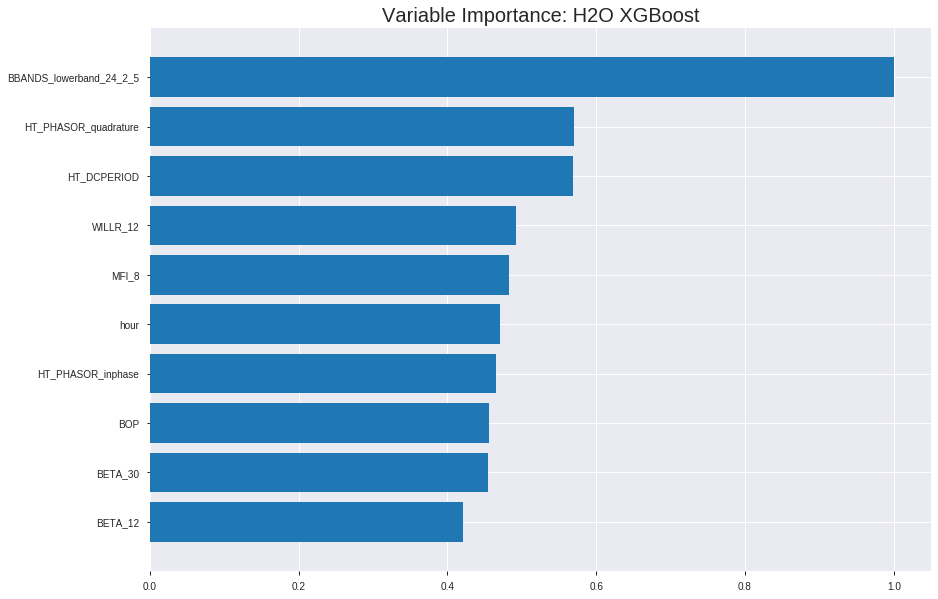

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_grid_1_AutoML_20191208_074046_model_4


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.22570010706618787
RMSE: 0.4750790534912983
LogLoss: 0.6438958024002187
Mean Per-Class Error: 0.30645652833163695
AUC: 0.7601823220605576
pr_auc: 0.7505105647278558
Gini: 0.5203646441211152
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4705384951084852: 


,0,1,Error,Rate
0,1154.0,1032.0,0.4721,(1032.0/2186.0)
1,358.0,1775.0,0.1678,(358.0/2133.0)
Total,1512.0,2807.0,0.3218,(1390.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4705385,0.7186235,243.0
max f2,0.4177752,0.8406687,320.0
max f0point5,0.4964511,0.6901128,201.0
max accuracy,0.4956247,0.6934476,202.0
max precision,0.7110789,1.0,0.0
max recall,0.3513153,1.0,381.0
max specificity,0.7110789,1.0,0.0
max absolute_mcc,0.4935847,0.3870807,205.0
max min_per_class_accuracy,0.4950046,0.6910455,203.0
max mean_per_class_accuracy,0.4935847,0.6935435,205.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.48 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6486546,1.9788284,1.9788284,0.9772727,0.6711746,0.9772727,0.6711746,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.6287466,1.9306687,1.9550253,0.9534884,0.6372865,0.9655172,0.6544253,0.0192218,0.0393812,93.0668673,95.5025300
,3,0.0300996,0.6155003,1.6481318,1.8535144,0.8139535,0.6213632,0.9153846,0.6434894,0.0164088,0.0557900,64.8131794,85.3514371
,4,0.0400556,0.6083951,1.8364897,1.8492828,0.9069767,0.6118041,0.9132948,0.6356139,0.0182841,0.0740741,83.6489713,84.9282809
,5,0.0500116,0.6000731,1.9777582,1.8748589,0.9767442,0.6037952,0.9259259,0.6292796,0.0196906,0.0937647,97.7758153,87.4858919
,6,0.1000232,0.5750867,1.6779987,1.7764288,0.8287037,0.5865652,0.8773148,0.6079224,0.0839194,0.1776840,67.7998732,77.6428826
,7,0.1500347,0.5584940,1.5561329,1.7029969,0.7685185,0.5659542,0.8410494,0.5939330,0.0778247,0.2555087,55.6132903,70.2996851
,8,0.2000463,0.5464216,1.4436414,1.6381580,0.7129630,0.5523449,0.8090278,0.5835360,0.0721988,0.3277075,44.3641368,63.8157980
,9,0.3000695,0.5274066,1.3498984,1.5420715,0.6666667,0.5364781,0.7615741,0.5678500,0.1350211,0.4627286,34.9898422,54.2071461
,10,0.4000926,0.5096887,1.1389768,1.4412978,0.5625,0.5183244,0.7118056,0.5554686,0.1139241,0.5766526,13.8976793,44.1297794




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.2519074751087356
RMSE: 0.5019038504621534
LogLoss: 0.6970323381059192
Mean Per-Class Error: 0.4735894909688012
AUC: 0.5158988505747126
pr_auc: 0.5120043406618296
Gini: 0.03179770114942526
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3267871141433716: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3267871,0.6615970,398.0
max f2,0.3267871,0.8301527,398.0
max f0point5,0.4209521,0.5518427,349.0
max accuracy,0.5178156,0.5267423,186.0
max precision,0.7118471,1.0,0.0
max recall,0.3267871,1.0,398.0
max specificity,0.7118471,1.0,0.0
max absolute_mcc,0.5178156,0.0528878,186.0
max min_per_class_accuracy,0.5137937,0.5155993,195.0
max mean_per_class_accuracy,0.5178156,0.5264105,186.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 51.11 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6506119,1.2469370,1.2469370,0.6153846,0.6647518,0.6153846,0.6647518,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.6374930,1.1819923,1.2157635,0.5833333,0.6433466,0.6,0.6544773,0.0114943,0.0246305,18.1992337,21.5763547
,3,0.0299838,0.6231693,1.1819923,1.2048107,0.5833333,0.6284134,0.5945946,0.6460241,0.0114943,0.0361248,18.1992337,20.4810722
,4,0.0405186,0.6156424,1.2469370,1.2157635,0.6153846,0.6191998,0.6,0.6390498,0.0131363,0.0492611,24.6936971,21.5763547
,5,0.0502431,0.6084129,0.8442802,1.1438636,0.4166667,0.6119136,0.5645161,0.6337976,0.0082102,0.0574713,-15.5719759,14.3863552
,6,0.1004862,0.5841804,1.1111817,1.1275226,0.5483871,0.5949264,0.5564516,0.6143620,0.0558292,0.1133005,11.1181736,12.7522644
,7,0.1499190,0.5675916,0.9633099,1.0733768,0.4754098,0.5758989,0.5297297,0.6016796,0.0476190,0.1609195,-3.6690086,7.3376825
,8,0.2001621,0.5574448,0.8497272,1.0172381,0.4193548,0.5622775,0.5020243,0.5917892,0.0426929,0.2036125,-15.0272790,1.7238055
,9,0.2998379,0.5408878,1.1202157,1.0514712,0.5528455,0.5485209,0.5189189,0.5774054,0.1116585,0.3152709,12.0215734,5.1471176
,10,0.4003241,0.5267741,1.0131363,1.0418487,0.5,0.5338443,0.5141700,0.5664710,0.1018062,0.4170772,1.3136289,4.1848653



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:40:54,2.404 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 07:40:54,2.471 sec,5.0,0.4968268,0.6868150,0.6340846,0.6248434,1.8407706,0.4700162,0.4999623,0.6930721,0.5087987,0.5016589,1.0131363,0.5064830
,2019-12-08 07:40:54,2.527 sec,10.0,0.4936268,0.6804565,0.6730884,0.6660609,1.8867898,0.4239407,0.4999873,0.6931235,0.5153787,0.5066019,0.9352027,0.5064830
,2019-12-08 07:40:54,2.592 sec,15.0,0.4907529,0.6747660,0.6951571,0.6834536,1.8407706,0.3892105,0.5004216,0.6939964,0.5086581,0.5042665,1.0910698,0.5056726
,2019-12-08 07:40:54,2.657 sec,20.0,0.4883622,0.6700379,0.7085706,0.6998356,1.9788284,0.3970827,0.5002103,0.6935761,0.5158581,0.5101839,0.9352027,0.5056726
,2019-12-08 07:40:54,2.719 sec,25.0,0.4860611,0.6654841,0.7140419,0.7043162,1.9788284,0.3862005,0.5005150,0.6941955,0.5168920,0.5094180,0.9352027,0.5056726
,2019-12-08 07:40:54,2.784 sec,30.0,0.4841479,0.6617036,0.7203440,0.7107466,1.9788284,0.3818013,0.5004319,0.6940381,0.5218430,0.5134658,1.0910698,0.5032415
,2019-12-08 07:40:54,2.862 sec,35.0,0.4816059,0.6567070,0.7342160,0.7241991,1.9328091,0.3697615,0.5004635,0.6940967,0.5210903,0.5170515,1.2469370,0.5024311
,2019-12-08 07:40:54,2.937 sec,40.0,0.4789216,0.6514372,0.7460986,0.7357231,1.9788284,0.3607317,0.5008058,0.6947910,0.5197557,0.5146608,1.2469370,0.5040519
,2019-12-08 07:40:55,3.013 sec,45.0,0.4768700,0.6474155,0.7557266,0.7469312,1.9788284,0.3283167,0.5012490,0.6956963,0.5177445,0.5136569,1.2469370,0.5032415


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BBANDS_lowerband_24_2_5,317.4242554,1.0,0.0628585
HT_PHASOR_quadrature,181.1778107,0.5707749,0.0358781
HT_DCPERIOD,180.4895325,0.5686066,0.0357418
WILLR_12,156.1760406,0.4920104,0.0309270
MFI_8,153.3029938,0.4829593,0.0303581
---,---,---,---
CMO_20,47.2876205,0.1489729,0.0093642
dayofweek,44.3596191,0.1397487,0.0087844
STOCHF_fastk,35.4940720,0.1118190,0.0070288
DX_12,20.7070332,0.0652346,0.0041005



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5672609400324149)

('F1', 0.6894343649946638)

('auc', 0.569406710052442)

('logloss', 0.6840764452172742)

('mean_per_class_error', 0.4246119500431751)

('rmse', 0.4954946617640321)

('mse', 0.2455149598366526)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


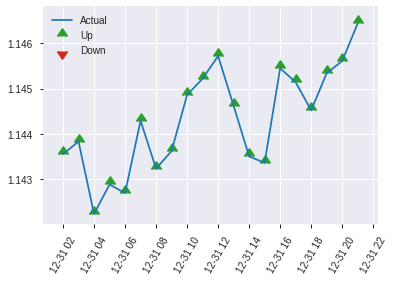


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.2455149598366526
RMSE: 0.4954946617640321
LogLoss: 0.6840764452172742
Mean Per-Class Error: 0.4246119500431751
AUC: 0.569406710052442
pr_auc: 0.5953569997119585
Gini: 0.13881342010488407
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3762572109699249: 


,0,1,Error,Rate
0,3.0,291.0,0.9898,(291.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,3.0,614.0,0.4716,(291.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3762572,0.6894344,396.0
max f2,0.3762572,0.8473242,396.0
max f0point5,0.4304661,0.5846850,365.0
max accuracy,0.5381927,0.5672609,139.0
max precision,0.5909411,0.7321429,45.0
max recall,0.3762572,1.0,396.0
max specificity,0.6804363,0.9965986,0.0
max absolute_mcc,0.5381927,0.1600727,139.0
max min_per_class_accuracy,0.5142311,0.5479876,195.0
max mean_per_class_accuracy,0.5381927,0.5753880,139.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 51.55 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6477636,0.8186643,0.8186643,0.4285714,0.6602033,0.4285714,0.6602033,0.0092879,0.0092879,-18.1335692,-18.1335692
,2,0.0210697,0.6357955,1.9102167,1.3224577,1.0,0.6398093,0.6923077,0.6507907,0.0185759,0.0278638,91.0216718,32.2457728
,3,0.0307942,0.6278469,1.2734778,1.3069904,0.6666667,0.6315669,0.6842105,0.6447200,0.0123839,0.0402477,27.3477812,30.6990386
,4,0.0405186,0.6188490,1.2734778,1.2989474,0.6666667,0.6222058,0.68,0.6393166,0.0123839,0.0526316,27.3477812,29.8947368
,5,0.0502431,0.6141622,1.2734778,1.2940178,0.6666667,0.6166981,0.6774194,0.6349388,0.0123839,0.0650155,27.3477812,29.4017777
,6,0.1004862,0.5873348,1.3556377,1.3248277,0.7096774,0.5978139,0.6935484,0.6163763,0.0681115,0.1331269,35.5637671,32.4827724
,7,0.1507293,0.5708147,1.2940178,1.3145577,0.6774194,0.5786759,0.6881720,0.6038095,0.0650155,0.1981424,29.4017777,31.4557742
,8,0.2009724,0.5585613,1.1091581,1.2632078,0.5806452,0.5643529,0.6612903,0.5939454,0.0557276,0.2538700,10.9158094,26.3207830
,9,0.2998379,0.5425986,1.0960260,1.2080830,0.5737705,0.5520314,0.6324324,0.5801251,0.1083591,0.3622291,9.6025986,20.8083006
,10,0.4003241,0.5276821,0.8626785,1.1213823,0.4516129,0.5347201,0.5870445,0.5687279,0.0866873,0.4489164,-13.7321482,12.1382284


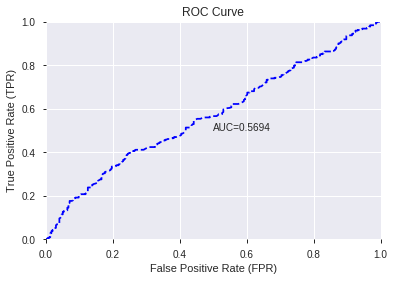

This function is available for GLM models only


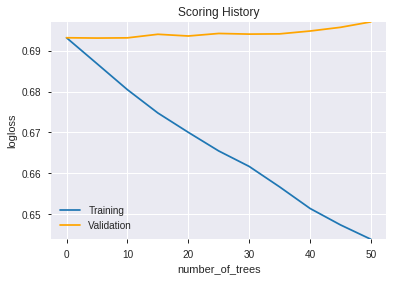

--2019-12-08 07:41:09--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.134.19
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.134.19|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
log4j:WARN No appenders could be found for logger (ml.dmlc.xgboost4j.java.Booster).
log4j:WARN Please initialize the log4j system properly.
log4j:WARN See http://logging.apache.org/log4j/1.2/faq.html#noconfig for more info.
Exception in thread "main" java.lang.StackOverflowError
	at java.base/java.lang.String.substring(String.java:1874)
	at java.base/java.lang.String.split(String.java:2289)
	at java.base/java.lang.String.split(String.java:2364)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:101)
	at hex.

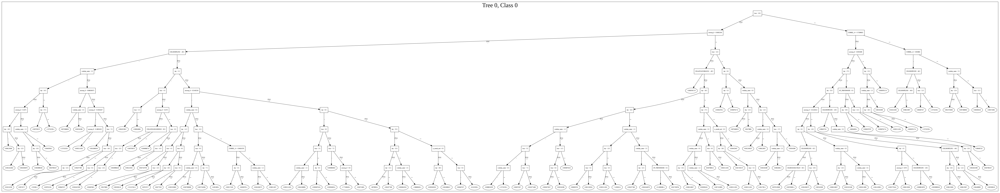

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_grid_1_AutoML_20191208_074046_model_4',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_grid_1_AutoML_20191208_074046_model_4',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_60_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training

['BBANDS_lowerband_24_2_5',
 'HT_PHASOR_quadrature',
 'HT_DCPERIOD',
 'WILLR_12',
 'MFI_8',
 'hour',
 'HT_PHASOR_inphase',
 'BOP',
 'BETA_30',
 'BETA_12',
 'STOCHRSI_fastk',
 'CCI_8',
 'MACDFIX_hist_24',
 'SAREXT',
 'STOCHRSI_fastd',
 'MFI_20',
 'BETA_8',
 'MFI_14',
 'CDLSHORTLINE',
 'MFI_12',
 'BETA_20',
 'ULTOSC',
 'STDDEV_8',
 'CCI_12',
 'ADOSC',
 'AROONOSC_8',
 'MFI_24',
 'day',
 'STDDEV_20',
 'TRIX_8',
 'STOCH_slowd',
 'ATR_8',
 'MOM_8',
 'WILLR_20',
 'STDDEV_14',
 'ADX_8',
 'DX_14',
 'ADXR_8',
 'STDDEV_30',
 'Volume',
 'BETA_14',
 'AROONOSC_24',
 'AROONOSC_20',
 'aroondown_20',
 'MINUS_DM_8',
 'CMO_20',
 'dayofweek',
 'STOCHF_fastk',
 'DX_12',
 'ADX_12']

In [30]:
# XGBoost with top XGBoost features
model_train(feature_name='XGBF',model_algo="XGBoost",features_list = features_list[:model_selected_features])

In [31]:
# DRF with top XGBoost features
model_train(feature_name='XGBF',model_algo="DRF",features_list = features_list[:model_selected_features])

Output hidden; open in https://colab.research.google.com to view.

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_5_AutoML_20191208_074319,0.560661,0.687811,0.494898,0.497322,0.247329
1,GBM_3_AutoML_20191208_074319,0.552463,0.698913,0.500000,0.502257,0.252263
2,GBM_2_AutoML_20191208_074319,0.538305,0.696229,0.487943,0.501323,0.251325
3,GBM_grid_1_AutoML_20191208_074319_model_5,0.537752,0.693329,0.493045,0.500091,0.250091
4,GBM_1_AutoML_20191208_074319,0.535677,0.695343,0.492892,0.501026,0.251027
5,GBM_grid_1_AutoML_20191208_074319_model_4,0.532713,0.692376,0.498299,0.499614,0.249614
6,GBM_grid_1_AutoML_20191208_074319_model_3,0.529422,0.938123,0.477607,0.565714,0.320033
7,GBM_4_AutoML_20191208_074319,0.527206,0.710857,0.496446,0.507830,0.257891
8,GBM_grid_1_AutoML_20191208_074319_model_2,0.524225,0.692620,0.500000,0.499736,0.249736
9,GBM_grid_1_AutoML_20191208_074319_model_1,0.523057,0.692501,0.498299,0.499677,0.249677


,variable,relative_importance,scaled_importance,percentage
0,BBANDS_lowerband_24_2_5,58.232788,1.000000,0.055651
1,hour,42.796371,0.734919,0.040899
2,STOCHRSI_fastk,41.347095,0.710031,0.039514
3,BETA_30,36.940090,0.634352,0.035302
4,AROONOSC_8,36.691219,0.630078,0.035065
5,MFI_12,30.118332,0.517206,0.028783
6,day,30.109974,0.517062,0.028775
7,STOCH_slowd,29.706413,0.510132,0.028389
8,WILLR_12,29.093256,0.499603,0.027803
9,AROONOSC_24,28.706617,0.492963,0.027434


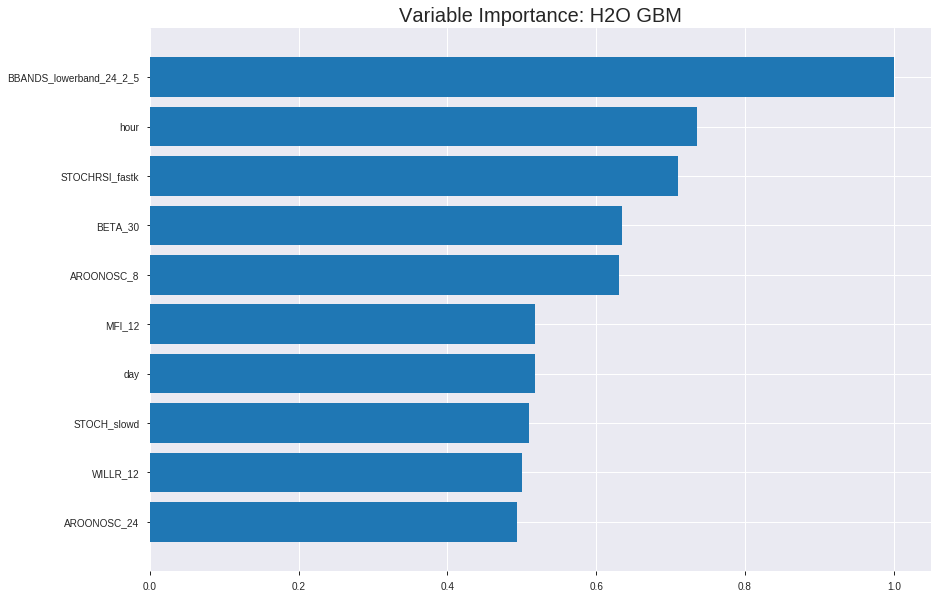

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_5_AutoML_20191208_074319


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.20649026654711974
RMSE: 0.45441200088369116
LogLoss: 0.6040187131307669
Mean Per-Class Error: 0.2514821763521776
AUC: 0.8259039002405882
pr_auc: 0.823017341831294
Gini: 0.6518078004811765
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.47800481668896255: 


,0,1,Error,Rate
0,1484.0,702.0,0.3211,(702.0/2186.0)
1,408.0,1725.0,0.1913,(408.0/2133.0)
Total,1892.0,2427.0,0.257,(1110.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4780048,0.7565789,222.0
max f2,0.3936076,0.8526273,310.0
max f0point5,0.5241387,0.7612042,169.0
max accuracy,0.5083219,0.7490160,188.0
max precision,0.7547665,1.0,0.0
max recall,0.2579183,1.0,397.0
max specificity,0.7547665,1.0,0.0
max absolute_mcc,0.5088711,0.4997082,187.0
max min_per_class_accuracy,0.4952092,0.7442818,204.0
max mean_per_class_accuracy,0.5052980,0.7485178,192.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.36 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6944248,1.9788284,1.9788284,0.9772727,0.7139879,0.9772727,0.7139879,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.6804714,1.9777582,1.9782994,0.9767442,0.6866355,0.9770115,0.7004689,0.0196906,0.0398500,97.7758153,97.8299411
,3,0.0300996,0.6654282,1.9306687,1.9625446,0.9534884,0.6720867,0.9692308,0.6910809,0.0192218,0.0590717,93.0668673,96.2544628
,4,0.0400556,0.6562693,2.0248476,1.9780303,1.0,0.6608679,0.9768786,0.6835713,0.0201594,0.0792311,102.4847632,97.8030346
,5,0.0500116,0.6485952,1.9306687,1.9686019,0.9534884,0.6524475,0.9722222,0.6773754,0.0192218,0.0984529,93.0668673,96.8601865
,6,0.1000232,0.6159347,1.8561103,1.9123561,0.9166667,0.6306397,0.9444444,0.6540075,0.0928270,0.1912799,85.6110330,91.2356097
,7,0.1500347,0.5952053,1.7154959,1.8467360,0.8472222,0.6056605,0.9120370,0.6378918,0.0857947,0.2770745,71.5495911,84.6736035
,8,0.2000463,0.5776887,1.6405016,1.7951774,0.8101852,0.5853079,0.8865741,0.6247458,0.0820441,0.3591186,64.0501554,79.5177415
,9,0.3000695,0.5467133,1.5045743,1.6983097,0.7430556,0.5619679,0.8387346,0.6038199,0.1504923,0.5096109,50.4574282,69.8309704
,10,0.4000926,0.5193939,1.3498984,1.6112069,0.6666667,0.5334796,0.7957176,0.5862348,0.1350211,0.6446320,34.9898422,61.1206883




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.25009877800905556
RMSE: 0.5000987682538875
LogLoss: 0.6935442144151573
Mean Per-Class Error: 0.45755008210180625
AUC: 0.5466141215106732
pr_auc: 0.5314386748074295
Gini: 0.09322824302134647
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.27985078558388143: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2798508,0.6615970,397.0
max f2,0.2798508,0.8301527,397.0
max f0point5,0.3810462,0.5577035,348.0
max accuracy,0.4893729,0.5413290,228.0
max precision,0.6445135,0.6296296,34.0
max recall,0.2798508,1.0,397.0
max specificity,0.7350514,0.9984,0.0
max absolute_mcc,0.4888933,0.0861739,229.0
max min_per_class_accuracy,0.5065471,0.5303777,202.0
max mean_per_class_accuracy,0.4888933,0.5424499,229.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 50.51 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6949053,1.0910698,1.0910698,0.5384615,0.7093901,0.5384615,0.7093901,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.6713867,1.1819923,1.1347126,0.5833333,0.6836363,0.56,0.6970282,0.0114943,0.0229885,18.1992337,13.4712644
,3,0.0299838,0.6543575,1.1819923,1.1500466,0.5833333,0.6626599,0.5675676,0.6858817,0.0114943,0.0344828,18.1992337,15.0046598
,4,0.0405186,0.6475776,1.4028041,1.2157635,0.6923077,0.6513437,0.6,0.6769019,0.0147783,0.0492611,40.2804092,21.5763547
,5,0.0502431,0.6393438,1.1819923,1.2092272,0.5833333,0.6427538,0.5967742,0.6702926,0.0114943,0.0607553,18.1992337,20.9227184
,6,0.1004862,0.6138202,1.1438636,1.1765454,0.5645161,0.6269853,0.5806452,0.6486389,0.0574713,0.1182266,14.3863552,17.6545368
,7,0.1499190,0.5947278,1.1293978,1.1609994,0.5573770,0.6046817,0.5729730,0.6341449,0.0558292,0.1740558,12.9397830,16.0999423
,8,0.2001621,0.5775779,1.1438636,1.1566981,0.5645161,0.5862338,0.5708502,0.6221186,0.0574713,0.2315271,14.3863552,15.6698111
,9,0.2998379,0.5527406,0.9060568,1.0733768,0.4471545,0.5648730,0.5297297,0.6030883,0.0903120,0.3218391,-9.3943156,7.3376825
,10,0.4003241,0.5302074,0.9314317,1.0377469,0.4596774,0.5413648,0.5121457,0.5875950,0.0935961,0.4154351,-6.8568250,3.7746887



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:43:24,0.005 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 07:43:24,0.109 sec,5.0,0.4900852,0.6734517,0.6982331,0.6845397,1.7027128,0.3878213,0.4982467,0.6896397,0.5506877,0.5367583,1.2469370,0.5016207
,2019-12-08 07:43:24,0.358 sec,10.0,0.4820555,0.6576223,0.7334740,0.7185731,1.8407706,0.3373466,0.4982732,0.6896816,0.5467271,0.5356327,1.4028041,0.5064830
,2019-12-08 07:43:24,0.478 sec,15.0,0.4746641,0.6431801,0.7642810,0.7547973,1.9788284,0.3169715,0.4981738,0.6894938,0.5506430,0.5366109,1.0910698,0.5056726
,2019-12-08 07:43:24,0.591 sec,20.0,0.4675481,0.6293311,0.7865349,0.7816712,2.0248476,0.3190553,0.4987050,0.6905995,0.5496171,0.5349797,1.1578700,0.5056726
,2019-12-08 07:43:24,0.707 sec,25.0,0.4608642,0.6164461,0.8105177,0.8064963,2.0248476,0.2752952,0.4997167,0.6927155,0.5450824,0.5268555,1.2469370,0.5056726
,2019-12-08 07:43:24,0.820 sec,30.0,0.4544120,0.6040187,0.8259039,0.8230173,1.9788284,0.2570039,0.5000988,0.6935442,0.5466141,0.5314387,1.0910698,0.5048622


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BBANDS_lowerband_24_2_5,58.2327881,1.0,0.0556511
hour,42.7963715,0.7349188,0.0408991
STOCHRSI_fastk,41.3470955,0.7100312,0.0395140
BETA_30,36.9400902,0.6343521,0.0353024
AROONOSC_8,36.6912193,0.6300784,0.0350646
---,---,---,---
MOM_8,9.7735186,0.1678353,0.0093402
BETA_8,9.1477413,0.1570892,0.0087422
CMO_20,8.6372566,0.1483229,0.0082543
HT_PHASOR_quadrature,8.0877018,0.1388857,0.0077291



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5575364667747164)

('F1', 0.6894343649946638)

('auc', 0.5606611065478823)

('logloss', 0.6878105447444273)

('mean_per_class_error', 0.44604157452454674)

('rmse', 0.497321564406002)

('mse', 0.24732873842323322)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


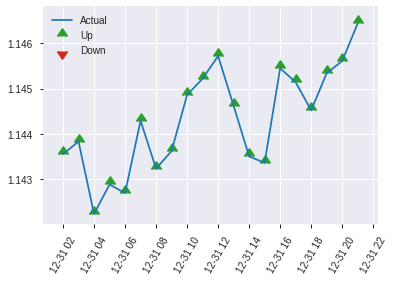


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.24732873842323322
RMSE: 0.497321564406002
LogLoss: 0.6878105447444273
Mean Per-Class Error: 0.44604157452454674
AUC: 0.5606611065478823
pr_auc: 0.5701340589970764
Gini: 0.12132221309576452
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3127895572513702: 


,0,1,Error,Rate
0,3.0,291.0,0.9898,(291.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,3.0,614.0,0.4716,(291.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3127896,0.6894344,396.0
max f2,0.3127896,0.8473242,396.0
max f0point5,0.4124559,0.5943359,342.0
max accuracy,0.4124559,0.5575365,342.0
max precision,0.7285922,1.0,0.0
max recall,0.3127896,1.0,396.0
max specificity,0.7285922,1.0,0.0
max absolute_mcc,0.5760678,0.1349112,90.0
max min_per_class_accuracy,0.5005358,0.5306122,209.0
max mean_per_class_accuracy,0.5760678,0.5539584,90.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 50.37 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6758499,0.5457762,0.5457762,0.2857143,0.6938394,0.2857143,0.6938394,0.0061920,0.0061920,-45.4223795,-45.4223795
,2,0.0210697,0.6570548,1.2734778,0.8816385,0.6666667,0.6640269,0.4615385,0.6800798,0.0123839,0.0185759,27.3477812,-11.8361515
,3,0.0307942,0.6457291,1.2734778,1.0053772,0.6666667,0.6521030,0.5263158,0.6712450,0.0123839,0.0309598,27.3477812,0.5377220
,4,0.0405186,0.6395777,1.2734778,1.0697214,0.6666667,0.6419452,0.56,0.6642131,0.0123839,0.0433437,27.3477812,6.9721362
,5,0.0502431,0.6297865,1.5918473,1.1707780,0.8333333,0.6353824,0.6129032,0.6586329,0.0154799,0.0588235,59.1847265,17.0777989
,6,0.1004862,0.6050278,1.3556377,1.2632078,0.7096774,0.6186438,0.6612903,0.6386384,0.0681115,0.1269350,35.5637671,26.3207830
,7,0.1507293,0.5883226,1.1091581,1.2118579,0.5806452,0.5964926,0.6344086,0.6245898,0.0557276,0.1826625,10.9158094,21.1857918
,8,0.2009724,0.5756105,1.4172576,1.2632078,0.7419355,0.5814576,0.6612903,0.6138067,0.0712074,0.2538700,41.7257565,26.3207830
,9,0.2998379,0.5495022,0.9081358,1.1461300,0.4754098,0.5595414,0.6,0.5959138,0.0897833,0.3436533,-9.1864183,14.6130031
,10,0.4003241,0.5229304,0.8934885,1.0827139,0.4677419,0.5361547,0.5668016,0.5809136,0.0897833,0.4334365,-10.6511535,8.2713929


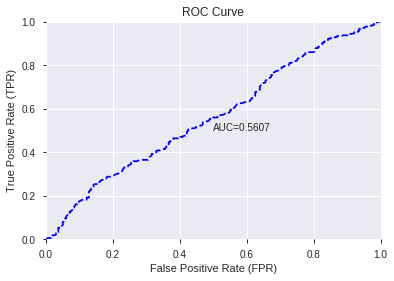

This function is available for GLM models only


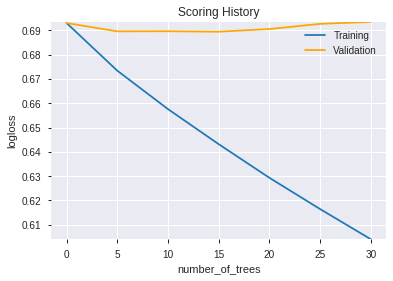

--2019-12-08 07:43:38--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.141.188
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.141.188|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      1378.0
            depth:       1
            colId:       14
            colName:     TRIX_8
            leftward:    false
            naVsRest:    false
            splitVal:    0.515625
            isBitset:    false
            predValue:   -0.049742397
            squaredErr:  340.19742
            leftChild:   Node 54
            righ

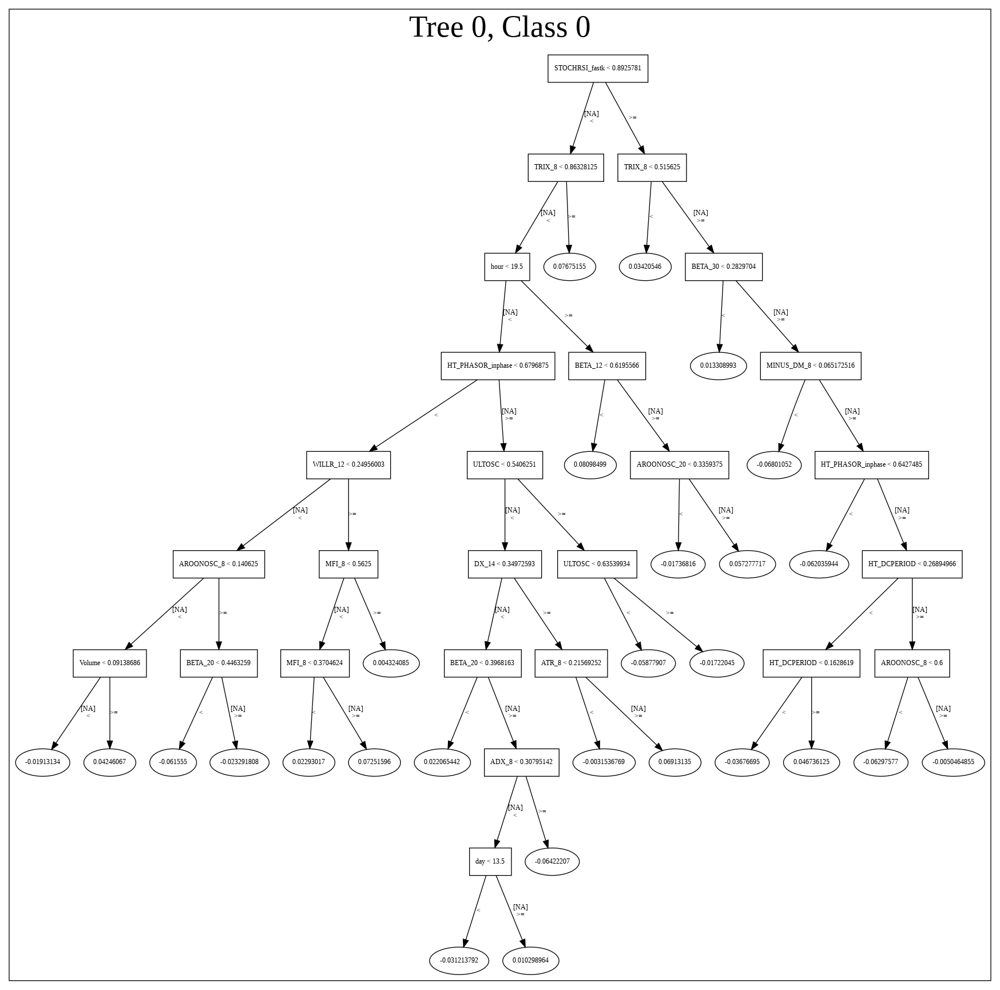

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_5_AutoML_20191208_074319',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_5_AutoML_20191208_074319',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_70_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_70_sid_887f',
   'type': 'Key<

['BBANDS_lowerband_24_2_5',
 'hour',
 'STOCHRSI_fastk',
 'BETA_30',
 'AROONOSC_8',
 'MFI_12',
 'day',
 'STOCH_slowd',
 'WILLR_12',
 'AROONOSC_24',
 'ULTOSC',
 'MFI_8',
 'STOCHF_fastk',
 'BOP',
 'HT_DCPERIOD',
 'BETA_12',
 'CCI_8',
 'DX_14',
 'dayofweek',
 'ADOSC',
 'STDDEV_8',
 'ATR_8',
 'STDDEV_14',
 'CDLSHORTLINE',
 'STOCHRSI_fastd',
 'WILLR_20',
 'ADX_12',
 'AROONOSC_20',
 'TRIX_8',
 'Volume',
 'aroondown_20',
 'MFI_24',
 'MFI_20',
 'BETA_14',
 'HT_PHASOR_inphase',
 'MFI_14',
 'DX_12',
 'CCI_12',
 'BETA_20',
 'ADX_8',
 'STDDEV_20',
 'MACDFIX_hist_24',
 'ADXR_8',
 'STDDEV_30',
 'MINUS_DM_8',
 'MOM_8',
 'BETA_8',
 'CMO_20',
 'HT_PHASOR_quadrature',
 'SAREXT']

In [32]:
# GBM with top XGBoost features
model_train(feature_name='XGBF',model_algo="GBM",features_list = features_list[:model_selected_features])

In [33]:
# StackedEnsemble with top XGBoost features
model_train(feature_name='XGBF',model_algo="StackedEnsemble",features_list = features_list[:model_selected_features])

AutoML progress: |████████████████████████████████████████████████████████| 100%


AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_5_AutoML_20191208_074436,0.560661,0.687811,0.494898,0.497322,0.247329
1,GBM_3_AutoML_20191208_074436,0.552463,0.698913,0.500000,0.502257,0.252263
2,XGBoost_1_AutoML_20191208_074436,0.547308,0.692673,0.491191,0.499669,0.249669
3,XGBoost_2_AutoML_20191208_074436,0.542659,0.695032,0.491497,0.500788,0.250789
4,GBM_2_AutoML_20191208_074436,0.538305,0.696229,0.487943,0.501323,0.251325
5,GBM_1_AutoML_20191208_074436,0.535677,0.695343,0.492892,0.501026,0.251027
6,GLM_grid_1_AutoML_20191208_074436_model_1,0.532650,0.692737,0.496446,0.499795,0.249795
7,XGBoost_3_AutoML_20191208_074436,0.529680,0.693564,0.494745,0.500191,0.250191
8,DRF_1_AutoML_20191208_074436,0.528659,0.711305,0.492892,0.508179,0.258246
9,GBM_4_AutoML_20191208_074436,0.527206,0.710857,0.496446,0.507830,0.257891


,variable,relative_importance,scaled_importance,percentage
0,BBANDS_lowerband_24_2_5,58.232788,1.000000,0.055651
1,hour,42.796371,0.734919,0.040899
2,STOCHRSI_fastk,41.347095,0.710031,0.039514
3,BETA_30,36.940090,0.634352,0.035302
4,AROONOSC_8,36.691219,0.630078,0.035065
5,MFI_12,30.118332,0.517206,0.028783
6,day,30.109974,0.517062,0.028775
7,STOCH_slowd,29.706413,0.510132,0.028389
8,WILLR_12,29.093256,0.499603,0.027803
9,AROONOSC_24,28.706617,0.492963,0.027434


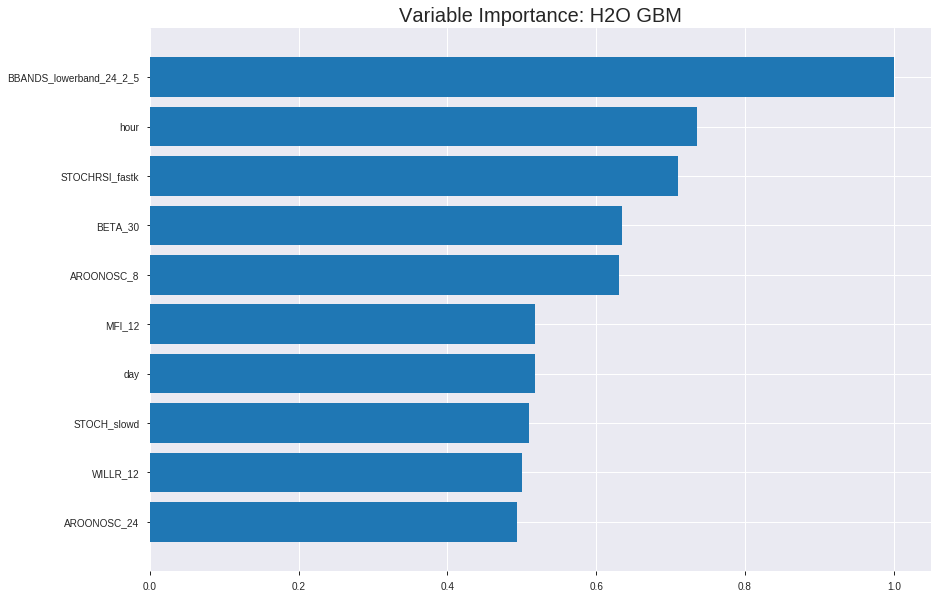

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_5_AutoML_20191208_074436


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.20649026654711974
RMSE: 0.45441200088369116
LogLoss: 0.6040187131307669
Mean Per-Class Error: 0.2514821763521776
AUC: 0.8259039002405882
pr_auc: 0.823017341831294
Gini: 0.6518078004811765
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.47800481668896255: 


,0,1,Error,Rate
0,1484.0,702.0,0.3211,(702.0/2186.0)
1,408.0,1725.0,0.1913,(408.0/2133.0)
Total,1892.0,2427.0,0.257,(1110.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4780048,0.7565789,222.0
max f2,0.3936076,0.8526273,310.0
max f0point5,0.5241387,0.7612042,169.0
max accuracy,0.5083219,0.7490160,188.0
max precision,0.7547665,1.0,0.0
max recall,0.2579183,1.0,397.0
max specificity,0.7547665,1.0,0.0
max absolute_mcc,0.5088711,0.4997082,187.0
max min_per_class_accuracy,0.4952092,0.7442818,204.0
max mean_per_class_accuracy,0.5052980,0.7485178,192.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.36 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6944248,1.9788284,1.9788284,0.9772727,0.7139879,0.9772727,0.7139879,0.0201594,0.0201594,97.8828368,97.8828368
,2,0.0201436,0.6804714,1.9777582,1.9782994,0.9767442,0.6866355,0.9770115,0.7004689,0.0196906,0.0398500,97.7758153,97.8299411
,3,0.0300996,0.6654282,1.9306687,1.9625446,0.9534884,0.6720867,0.9692308,0.6910809,0.0192218,0.0590717,93.0668673,96.2544628
,4,0.0400556,0.6562693,2.0248476,1.9780303,1.0,0.6608679,0.9768786,0.6835713,0.0201594,0.0792311,102.4847632,97.8030346
,5,0.0500116,0.6485952,1.9306687,1.9686019,0.9534884,0.6524475,0.9722222,0.6773754,0.0192218,0.0984529,93.0668673,96.8601865
,6,0.1000232,0.6159347,1.8561103,1.9123561,0.9166667,0.6306397,0.9444444,0.6540075,0.0928270,0.1912799,85.6110330,91.2356097
,7,0.1500347,0.5952053,1.7154959,1.8467360,0.8472222,0.6056605,0.9120370,0.6378918,0.0857947,0.2770745,71.5495911,84.6736035
,8,0.2000463,0.5776887,1.6405016,1.7951774,0.8101852,0.5853079,0.8865741,0.6247458,0.0820441,0.3591186,64.0501554,79.5177415
,9,0.3000695,0.5467133,1.5045743,1.6983097,0.7430556,0.5619679,0.8387346,0.6038199,0.1504923,0.5096109,50.4574282,69.8309704
,10,0.4000926,0.5193939,1.3498984,1.6112069,0.6666667,0.5334796,0.7957176,0.5862348,0.1350211,0.6446320,34.9898422,61.1206883




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.25009877800905556
RMSE: 0.5000987682538875
LogLoss: 0.6935442144151573
Mean Per-Class Error: 0.45755008210180625
AUC: 0.5466141215106732
pr_auc: 0.5314386748074295
Gini: 0.09322824302134647
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.27985078558388143: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2798508,0.6615970,397.0
max f2,0.2798508,0.8301527,397.0
max f0point5,0.3810462,0.5577035,348.0
max accuracy,0.4893729,0.5413290,228.0
max precision,0.6445135,0.6296296,34.0
max recall,0.2798508,1.0,397.0
max specificity,0.7350514,0.9984,0.0
max absolute_mcc,0.4888933,0.0861739,229.0
max min_per_class_accuracy,0.5065471,0.5303777,202.0
max mean_per_class_accuracy,0.4888933,0.5424499,229.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 50.51 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6949053,1.0910698,1.0910698,0.5384615,0.7093901,0.5384615,0.7093901,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.6713867,1.1819923,1.1347126,0.5833333,0.6836363,0.56,0.6970282,0.0114943,0.0229885,18.1992337,13.4712644
,3,0.0299838,0.6543575,1.1819923,1.1500466,0.5833333,0.6626599,0.5675676,0.6858817,0.0114943,0.0344828,18.1992337,15.0046598
,4,0.0405186,0.6475776,1.4028041,1.2157635,0.6923077,0.6513437,0.6,0.6769019,0.0147783,0.0492611,40.2804092,21.5763547
,5,0.0502431,0.6393438,1.1819923,1.2092272,0.5833333,0.6427538,0.5967742,0.6702926,0.0114943,0.0607553,18.1992337,20.9227184
,6,0.1004862,0.6138202,1.1438636,1.1765454,0.5645161,0.6269853,0.5806452,0.6486389,0.0574713,0.1182266,14.3863552,17.6545368
,7,0.1499190,0.5947278,1.1293978,1.1609994,0.5573770,0.6046817,0.5729730,0.6341449,0.0558292,0.1740558,12.9397830,16.0999423
,8,0.2001621,0.5775779,1.1438636,1.1566981,0.5645161,0.5862338,0.5708502,0.6221186,0.0574713,0.2315271,14.3863552,15.6698111
,9,0.2998379,0.5527406,0.9060568,1.0733768,0.4471545,0.5648730,0.5297297,0.6030883,0.0903120,0.3218391,-9.3943156,7.3376825
,10,0.4003241,0.5302074,0.9314317,1.0377469,0.4596774,0.5413648,0.5121457,0.5875950,0.0935961,0.4154351,-6.8568250,3.7746887



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:44:48,0.002 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 07:44:48,0.096 sec,5.0,0.4900852,0.6734517,0.6982331,0.6845397,1.7027128,0.3878213,0.4982467,0.6896397,0.5506877,0.5367583,1.2469370,0.5016207
,2019-12-08 07:44:48,0.203 sec,10.0,0.4820555,0.6576223,0.7334740,0.7185731,1.8407706,0.3373466,0.4982732,0.6896816,0.5467271,0.5356327,1.4028041,0.5064830
,2019-12-08 07:44:48,0.309 sec,15.0,0.4746641,0.6431801,0.7642810,0.7547973,1.9788284,0.3169715,0.4981738,0.6894938,0.5506430,0.5366109,1.0910698,0.5056726
,2019-12-08 07:44:48,0.411 sec,20.0,0.4675481,0.6293311,0.7865349,0.7816712,2.0248476,0.3190553,0.4987050,0.6905995,0.5496171,0.5349797,1.1578700,0.5056726
,2019-12-08 07:44:48,0.529 sec,25.0,0.4608642,0.6164461,0.8105177,0.8064963,2.0248476,0.2752952,0.4997167,0.6927155,0.5450824,0.5268555,1.2469370,0.5056726
,2019-12-08 07:44:48,0.638 sec,30.0,0.4544120,0.6040187,0.8259039,0.8230173,1.9788284,0.2570039,0.5000988,0.6935442,0.5466141,0.5314387,1.0910698,0.5048622


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BBANDS_lowerband_24_2_5,58.2327881,1.0,0.0556511
hour,42.7963715,0.7349188,0.0408991
STOCHRSI_fastk,41.3470955,0.7100312,0.0395140
BETA_30,36.9400902,0.6343521,0.0353024
AROONOSC_8,36.6912193,0.6300784,0.0350646
---,---,---,---
MOM_8,9.7735186,0.1678353,0.0093402
BETA_8,9.1477413,0.1570892,0.0087422
CMO_20,8.6372566,0.1483229,0.0082543
HT_PHASOR_quadrature,8.0877018,0.1388857,0.0077291



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5575364667747164)

('F1', 0.6894343649946638)

('auc', 0.5606611065478823)

('logloss', 0.6878105447444273)

('mean_per_class_error', 0.44604157452454674)

('rmse', 0.497321564406002)

('mse', 0.24732873842323322)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


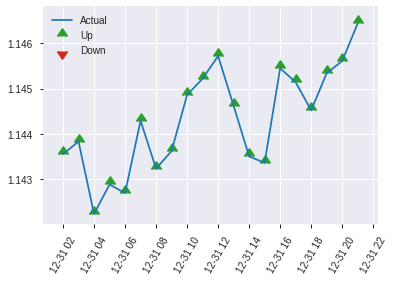


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.24732873842323322
RMSE: 0.497321564406002
LogLoss: 0.6878105447444273
Mean Per-Class Error: 0.44604157452454674
AUC: 0.5606611065478823
pr_auc: 0.5701340589970764
Gini: 0.12132221309576452
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3127895572513702: 


,0,1,Error,Rate
0,3.0,291.0,0.9898,(291.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,3.0,614.0,0.4716,(291.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3127896,0.6894344,396.0
max f2,0.3127896,0.8473242,396.0
max f0point5,0.4124559,0.5943359,342.0
max accuracy,0.4124559,0.5575365,342.0
max precision,0.7285922,1.0,0.0
max recall,0.3127896,1.0,396.0
max specificity,0.7285922,1.0,0.0
max absolute_mcc,0.5760678,0.1349112,90.0
max min_per_class_accuracy,0.5005358,0.5306122,209.0
max mean_per_class_accuracy,0.5760678,0.5539584,90.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 50.37 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6758499,0.5457762,0.5457762,0.2857143,0.6938394,0.2857143,0.6938394,0.0061920,0.0061920,-45.4223795,-45.4223795
,2,0.0210697,0.6570548,1.2734778,0.8816385,0.6666667,0.6640269,0.4615385,0.6800798,0.0123839,0.0185759,27.3477812,-11.8361515
,3,0.0307942,0.6457291,1.2734778,1.0053772,0.6666667,0.6521030,0.5263158,0.6712450,0.0123839,0.0309598,27.3477812,0.5377220
,4,0.0405186,0.6395777,1.2734778,1.0697214,0.6666667,0.6419452,0.56,0.6642131,0.0123839,0.0433437,27.3477812,6.9721362
,5,0.0502431,0.6297865,1.5918473,1.1707780,0.8333333,0.6353824,0.6129032,0.6586329,0.0154799,0.0588235,59.1847265,17.0777989
,6,0.1004862,0.6050278,1.3556377,1.2632078,0.7096774,0.6186438,0.6612903,0.6386384,0.0681115,0.1269350,35.5637671,26.3207830
,7,0.1507293,0.5883226,1.1091581,1.2118579,0.5806452,0.5964926,0.6344086,0.6245898,0.0557276,0.1826625,10.9158094,21.1857918
,8,0.2009724,0.5756105,1.4172576,1.2632078,0.7419355,0.5814576,0.6612903,0.6138067,0.0712074,0.2538700,41.7257565,26.3207830
,9,0.2998379,0.5495022,0.9081358,1.1461300,0.4754098,0.5595414,0.6,0.5959138,0.0897833,0.3436533,-9.1864183,14.6130031
,10,0.4003241,0.5229304,0.8934885,1.0827139,0.4677419,0.5361547,0.5668016,0.5809136,0.0897833,0.4334365,-10.6511535,8.2713929


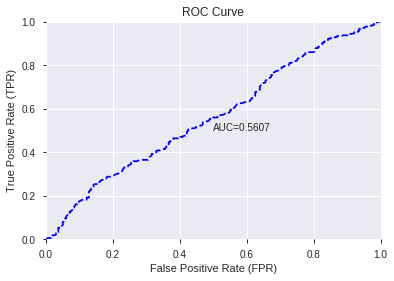

This function is available for GLM models only


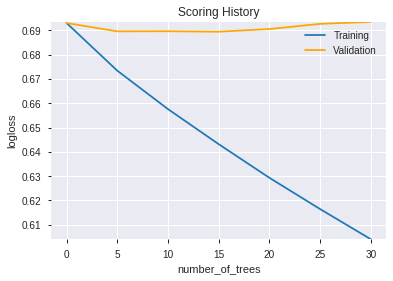

--2019-12-08 07:44:58--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.217.45.52
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.217.45.52|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      1378.0
            depth:       1
            colId:       14
            colName:     TRIX_8
            leftward:    false
            naVsRest:    false
            splitVal:    0.515625
            isBitset:    false
            predValue:   -0.049742397
            squaredErr:  340.19742
            leftChild:   Node 54
            rightChi

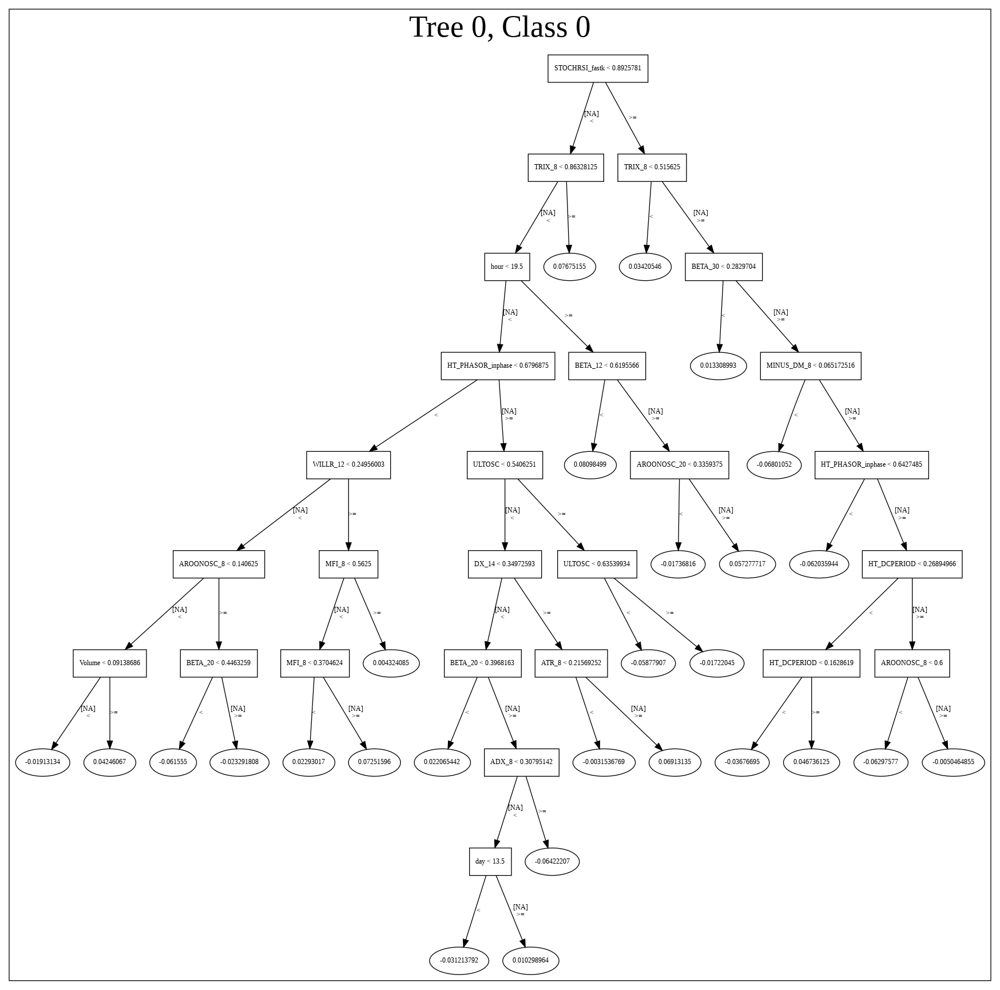

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_5_AutoML_20191208_074436',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_5_AutoML_20191208_074436',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_78_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_78_sid_887f',
   'type': 'Key<

['BBANDS_lowerband_24_2_5',
 'hour',
 'STOCHRSI_fastk',
 'BETA_30',
 'AROONOSC_8',
 'MFI_12',
 'day',
 'STOCH_slowd',
 'WILLR_12',
 'AROONOSC_24',
 'ULTOSC',
 'MFI_8',
 'STOCHF_fastk',
 'BOP',
 'HT_DCPERIOD',
 'BETA_12',
 'CCI_8',
 'DX_14',
 'dayofweek',
 'ADOSC',
 'STDDEV_8',
 'ATR_8',
 'STDDEV_14',
 'CDLSHORTLINE',
 'STOCHRSI_fastd',
 'WILLR_20',
 'ADX_12',
 'AROONOSC_20',
 'TRIX_8',
 'Volume',
 'aroondown_20',
 'MFI_24',
 'MFI_20',
 'BETA_14',
 'HT_PHASOR_inphase',
 'MFI_14',
 'DX_12',
 'CCI_12',
 'BETA_20',
 'ADX_8',
 'STDDEV_20',
 'MACDFIX_hist_24',
 'ADXR_8',
 'STDDEV_30',
 'MINUS_DM_8',
 'MOM_8',
 'BETA_8',
 'CMO_20',
 'HT_PHASOR_quadrature',
 'SAREXT']

In [34]:
# All algos with top XGBoost features
model_train(feature_name='XGBF',model_algo=None,features_list = features_list[:model_selected_features])

In [0]:
# PCA
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'PCA' in features_to_include:
  for _ in range(3):
    try:
      from h2o.estimators.pca import H2OPrincipalComponentAnalysisEstimator
      h2o_model = H2OPrincipalComponentAnalysisEstimator(seed=1, k=PCA_k, pca_method="GramSVD", max_iterations=10000)
      h2o_model.train(x=list(train_hf.columns[:-1]), training_frame=train_hf[:index_splits[0],:])

      display(h2o_model.varimp(use_pandas=True))
      display(h2o_model)

      training_frame = h2o_model.predict(train_hf)
      del h2o_model, H2OPrincipalComponentAnalysisEstimator
      gc.collect()

      training_frame = training_frame.cbind(train_hf[data_label_name])
      break
    except KeyboardInterrupt:
      break
    except Exception as e:
      print(e)
      load_h2o()
else:
  training_frame = []

In [36]:
# DeepLearning with PCA
model_train(feature_name='PCA',model_algo="DeepLearning",training_frame=training_frame)

[]

In [37]:
# GLM with PCA
model_train(feature_name='PCA',model_algo="GLM",training_frame=training_frame)

[]

In [38]:
# XGBoost with PCA
model_train(feature_name='PCA',model_algo="XGBoost",training_frame=training_frame)

[]

In [39]:
# DRF with top PCA features
model_train(feature_name='PCA',model_algo="DRF",training_frame=training_frame)

[]

In [40]:
# GBM with top PCA features
model_train(feature_name='PCA',model_algo="GBM",training_frame=training_frame)

[]

In [41]:
# StackedEnsemble with top PCA features
model_train(feature_name='PCA',model_algo="StackedEnsemble",training_frame=training_frame)

[]

In [42]:
# All algos with top PCA features
model_train(feature_name='PCA',model_algo=None,training_frame=training_frame)

[]

In [0]:
# Generalized Low Rank
try:
  del training_frame
except:
  pass
gc.collect()

if features_to_include is True or 'GLRM' in features_to_include:
  for _ in range(3):
    try:
      from h2o.estimators.glrm import H2OGeneralizedLowRankEstimator

      h2o_model = H2OGeneralizedLowRankEstimator(seed=1, k=GLRM_k)
      h2o_model.train(x=list(train_hf.columns[:-1]), training_frame=train_hf[:index_splits[0],:])

      display(h2o_model.varimp(use_pandas=True))
      display(h2o_model)

      training_frame = h2o_model.predict(train_hf)
      del h2o_model, H2OGeneralizedLowRankEstimator
      gc.collect()

      training_frame = training_frame.cbind(train_hf[data_label_name])
      break
    except KeyboardInterrupt:
      break
    except Exception as e:
      print(e)
      load_h2o()
else:
  training_frame = []

In [44]:
# DeepLearning with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="DeepLearning",training_frame=training_frame)

[]

In [45]:
# GLM with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="GLM",training_frame=training_frame)

[]

In [46]:
# XGBoost with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="XGBoost",training_frame=training_frame)

[]

In [47]:
# DRF with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="DRF",training_frame=training_frame)

[]

In [48]:
# GBM with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="GBM",training_frame=training_frame)

[]

In [49]:
# StackedEnsemble with Generalized Low Rank
model_train(feature_name='GLRM',model_algo="StackedEnsemble",training_frame=training_frame)

[]

In [50]:
# All algos with Generalized Low Rank
model_train(feature_name='GLRM',model_algo=None,training_frame=training_frame)

[]

In [0]:
# High Correlation Filter 
try:
  del training_frame
except:
  pass
gc.collect()

if features_to_include is True or 'HCF' in features_to_include:
  corr_matrix = pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1).corr().abs()

  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

  features_list = [column for column in upper.columns if not any(upper[column] > HCF_threshold)]

  del corr_matrix, upper
  gc.collect()

  display(len(features_list),features_list)
else:
  features_list = []

In [52]:
# DeepLearning with low correlation features
model_train(feature_name='HCF',model_algo="DeepLearning",features_list=features_list)

[]

In [53]:
# GLM with low correlation features
model_train(feature_name='HCF',model_algo="GLM",features_list=features_list)

[]

In [54]:
# XGBoost with low correlation features
model_train(feature_name='HCF',model_algo="XGBoost",features_list=features_list)

[]

In [55]:
# DRF with low correlation features
model_train(feature_name='HCF',model_algo="DRF",features_list=features_list)

[]

In [56]:
# GBM with low correlation features
model_train(feature_name='HCF',model_algo="GBM",features_list=features_list)

[]

In [57]:
# StackedEnsemble with low correlation features
model_train(feature_name='HCF',model_algo="StackedEnsemble",features_list=features_list)

[]

In [58]:
# All algos with low correlation features
model_train(feature_name='HCF',model_algo=None,features_list=features_list)

[]

In [0]:
#	Low Variance Filter  
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'LVF' in features_to_include:
  df_variance = pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1).var()
  features_list = [column for column in df_variance.index if df_variance[column]  > LVF_threshold]

  del df_variance
  gc.collect()

  display(len(features_list),features_list)
else:
  features_list = []

In [60]:
# DeepLearning with Low Variance features  
model_train(feature_name='LVF',model_algo="DeepLearning",features_list=features_list)

[]

In [61]:
# GLM with Low Variance features  
model_train(feature_name='LVF',model_algo="GLM",features_list=features_list)

[]

In [62]:
# XGBoost with Low Variance features  
model_train(feature_name='LVF',model_algo="XGBoost",features_list=features_list)

[]

In [63]:
# DRF with Low Variance features
model_train(feature_name='LVF',model_algo="DRF",features_list=features_list)

[]

In [64]:
# GBM with Low Variance features
model_train(feature_name='LVF',model_algo="GBM",features_list=features_list)

[]

In [65]:
# StackedEnsemble with Low Variance features
model_train(feature_name='LVF',model_algo="StackedEnsemble",features_list=features_list)

[]

In [66]:
# All algos with Low Variance features
model_train(feature_name='LVF',model_algo=None,features_list=features_list)

[]

In [0]:
# Select k best features
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'KBest' in features_to_include:
  from sklearn.feature_selection import SelectKBest
  from sklearn.feature_selection import f_classif

  bestfeatures = SelectKBest(score_func=f_classif, k=select_k).fit(pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1)
                                                              ,pd.read_pickle('scaled_df')[:index_splits[0]][data_label_name])

  features_list = list(np.array(train_hf.columns)[:-1][bestfeatures.get_support()])

  del bestfeatures, SelectKBest, f_classif
  gc.collect()
  display(len(features_list),features_list)
else:
  features_list=[]

In [68]:
# DeepLearning with Select k best features 
model_train(feature_name='KBest',model_algo="DeepLearning",features_list=features_list)

[]

In [69]:
# GLM with Select k best features
model_train(feature_name='KBest',model_algo="GLM",features_list=features_list)

[]

In [70]:
# XGBoost with Select k best features
model_train(feature_name='KBest',model_algo="XGBoost",features_list=features_list)

[]

In [71]:
# DRF with Select k best features
model_train(feature_name='KBest',model_algo="DRF",features_list=features_list)

[]

In [72]:
# GBM with Select k best features
model_train(feature_name='KBest',model_algo="GBM",features_list=features_list)

[]

In [73]:
# StackedEnsemble with Select k best features
model_train(feature_name='KBest',model_algo="StackedEnsemble",features_list=features_list)

[]

In [74]:
# All algos with Select k best features
model_train(feature_name='KBest',model_algo=None,features_list=features_list)

[]

In [0]:
# Select Percentile
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'Percentile' in features_to_include:
  from sklearn.feature_selection import SelectPercentile
  from sklearn.feature_selection import f_classif

  bestfeatures = SelectPercentile(score_func=f_classif, percentile=select_percentile).fit(pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1)
                                                              ,pd.read_pickle('scaled_df')[:index_splits[0]][data_label_name])

  features_list = list(np.array(train_hf.columns)[:-1][bestfeatures.get_support()])

  del bestfeatures, SelectPercentile, f_classif
  gc.collect()
  display(len(features_list),features_list)
else:
  features_list=[]

In [76]:
# DeepLearning with Select Percentile features  
model_train(feature_name='Percentile',model_algo="DeepLearning",features_list=features_list)

[]

In [77]:
# GLM with Select Percentile features  
model_train(feature_name='Percentile',model_algo="GLM",features_list=features_list)

[]

In [78]:
# XGBoost with Select Percentile features  
model_train(feature_name='Percentile',model_algo="XGBoost",features_list=features_list)

[]

In [79]:
# DRF with Select Percentile features
model_train(feature_name='Percentile',model_algo="DRF",features_list=features_list)

[]

In [80]:
# GBM with Select Percentile features
model_train(feature_name='Percentile',model_algo="GBM",features_list=features_list)

[]

In [81]:
# StackedEnsemble with Select Percentile features
model_train(feature_name='Percentile',model_algo="StackedEnsemble",features_list=features_list)

[]

In [82]:
# All algos with Select Percentile features
model_train(feature_name='Percentile',model_algo=None,features_list=features_list)

[]

In [83]:
# Select Family-wise error
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'Fwe' in features_to_include:
  from sklearn.feature_selection import SelectFwe
  from sklearn.feature_selection import f_classif

  bestfeatures = SelectFwe(score_func=f_classif, alpha=select_alpha).fit(pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1)
                                                              ,pd.read_pickle('scaled_df')[:index_splits[0]][data_label_name])

  features_list = list(np.array(train_hf.columns)[:-1][bestfeatures.get_support()])

  del bestfeatures, SelectFwe, f_classif
  gc.collect()
  display(len(features_list),features_list)
else:
  features_list=[]

/usr/local/lib/python3.6/dist-packages/sklearn/feature_selection/univariate_selection.py:114: UserWarning: Features [ 12 850] are constant.
  UserWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/feature_selection/univariate_selection.py:115: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
/usr/local/lib/python3.6/dist-packages/sklearn/feature_selection/univariate_selection.py:721: RuntimeWarning: invalid value encountered in less
  return (self.pvalues_ < self.alpha / len(self.pvalues_))


0

[]

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,DeepLearning_grid_1_AutoML_20191208_074557_model_3,0.541833,0.749338,0.500000,0.523804,0.274371
1,DeepLearning_grid_1_AutoML_20191208_074557_model_2,0.535093,0.887413,0.500000,0.569008,0.323770
2,DeepLearning_grid_1_AutoML_20191208_074557_model_1,0.534709,0.693950,0.498299,0.500506,0.250506
3,DeepLearning_grid_1_AutoML_20191208_074557_model_4,0.503096,0.692726,0.500000,0.499789,0.249789
4,DeepLearning_grid_1_AutoML_20191208_074557_model_5,0.500000,0.694071,0.500000,0.500461,0.250462
5,DeepLearning_1_AutoML_20191208_074557,0.500000,0.694765,0.500000,0.500808,0.250809
6,DeepLearning_grid_1_AutoML_20191208_074557_model_8,0.500000,0.693376,0.500000,0.500114,0.250114
7,DeepLearning_grid_1_AutoML_20191208_074557_model_6,0.500000,0.693440,0.500000,0.500147,0.250147
8,DeepLearning_grid_1_AutoML_20191208_074557_model_7,0.482841,0.694289,0.500000,0.500566,0.250566


,variable,relative_importance,scaled_importance,percentage
0,CDLSHOOTINGSTAR,1.000000,1.000000,0.003008
1,CDLGAPSIDESIDEWHITE,0.986744,0.986744,0.002968
2,CDLIDENTICAL3CROWS,0.985390,0.985390,0.002964
3,is_month_start,0.970986,0.970986,0.002921
4,CDLEVENINGSTAR,0.968274,0.968274,0.002913
...,...,...,...,...
947,LINEARREG_8,0.282320,0.282320,0.000849
948,CDL3OUTSIDE,0.280179,0.280179,0.000843
949,BBANDS_upperband_14_2_3,0.277693,0.277693,0.000835
950,CDLHARAMI,0.269817,0.269817,0.000812


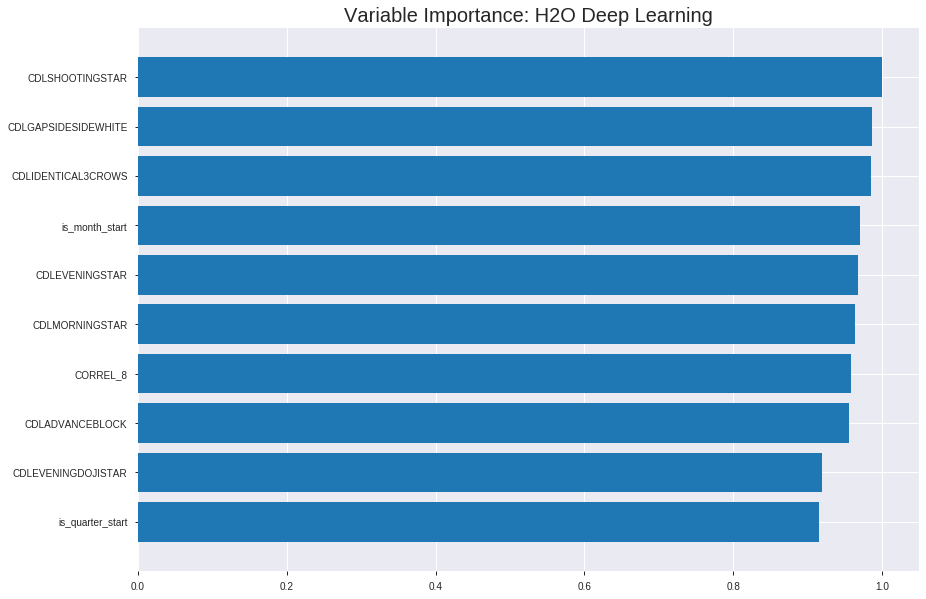

Model Details
H2ODeepLearningEstimator :  Deep Learning
Model Key:  DeepLearning_grid_1_AutoML_20191208_074557_model_3


ModelMetricsBinomial: deeplearning
** Reported on train data. **

MSE: 0.279462438415786
RMSE: 0.5286420702287948
LogLoss: 0.7662914991722957
Mean Per-Class Error: 0.484076737745076
AUC: 0.5108449155839337
pr_auc: 0.5099304727122208
Gini: 0.02168983116786749
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.07814396193905185: 


,0,1,Error,Rate
0,13.0,2173.0,0.9941,(2173.0/2186.0)
1,5.0,2128.0,0.0023,(5.0/2133.0)
Total,18.0,4301.0,0.5043,(2178.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0781440,0.6614859,389.0
max f2,0.0016875,0.8298965,399.0
max f0point5,0.1215851,0.5508895,376.0
max accuracy,0.5999427,0.5193332,106.0
max precision,0.8993069,1.0,0.0
max recall,0.0016875,1.0,399.0
max specificity,0.8993069,1.0,0.0
max absolute_mcc,0.6627412,0.0447032,74.0
max min_per_class_accuracy,0.4406984,0.5009149,202.0
max mean_per_class_accuracy,0.5764565,0.5159233,119.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 43.94 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.8301364,1.1044623,1.1044623,0.5454545,0.8561893,0.5454545,0.8561893,0.0112518,0.0112518,10.4462345,10.4462345
,2,0.0201436,0.7834668,0.9417896,1.0240609,0.4651163,0.8047764,0.5057471,0.8307783,0.0093765,0.0206282,-5.8210404,2.4060872
,3,0.0300996,0.7557018,1.1301475,1.0591511,0.5581395,0.7683497,0.5230769,0.8101288,0.0112518,0.0318800,13.0147516,5.9151069
,4,0.0400556,0.7385756,1.2714160,1.1119105,0.6279070,0.7467371,0.5491329,0.7943725,0.0126582,0.0445382,27.1415955,11.1910550
,5,0.0500116,0.7223029,1.2714160,1.1436639,0.6279070,0.7302473,0.5648148,0.7816069,0.0126582,0.0571964,27.1415955,14.3663941
,6,0.1000232,0.6703239,1.0967925,1.1202282,0.5416667,0.6954445,0.5532407,0.7385257,0.0548523,0.1120488,9.6792468,12.0228204
,7,0.1500347,0.6293961,0.9468038,1.0624201,0.4675926,0.6480087,0.5246914,0.7083533,0.0473511,0.1593999,-5.3196246,6.2420054
,8,0.2000463,0.5971954,1.1155411,1.0757003,0.5509259,0.6119326,0.53125,0.6842482,0.0557900,0.2151899,11.5541057,7.5700305
,9,0.3000695,0.5476533,0.9889881,1.0467962,0.4884259,0.5714042,0.5169753,0.6466335,0.0989217,0.3141116,-1.1011920,4.6796230
,10,0.4000926,0.4969794,0.9514909,1.0229699,0.4699074,0.5231102,0.5052083,0.6157527,0.0951711,0.4092827,-4.8509099,2.2969898




ModelMetricsBinomial: deeplearning
** Reported on validation data. **

MSE: 0.2750241380713076
RMSE: 0.5244274383280375
LogLoss: 0.7525796684293151
Mean Per-Class Error: 0.46786338259441707
AUC: 0.5325688013136288
pr_auc: 0.5257833474226998
Gini: 0.06513760262725765
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.34490804305964495: 


,0,1,Error,Rate
0,11.0,614.0,0.9824,(614.0/625.0)
1,1.0,608.0,0.0016,(1.0/609.0)
Total,12.0,1222.0,0.4984,(615.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3449080,0.6641180,388.0
max f2,0.3449080,0.8310552,388.0
max f0point5,0.3783350,0.5541261,378.0
max accuracy,0.6443927,0.5324149,183.0
max precision,0.9008554,1.0,0.0
max recall,0.0126513,1.0,399.0
max specificity,0.9008554,1.0,0.0
max absolute_mcc,0.3449080,0.0813018,388.0
max min_per_class_accuracy,0.6387256,0.5264,189.0
max mean_per_class_accuracy,0.6443927,0.5321366,183.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 63.10 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.8597264,1.2469370,1.2469370,0.6153846,0.8767079,0.6153846,0.8767079,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.8348874,1.1819923,1.2157635,0.5833333,0.8481154,0.6,0.8629835,0.0114943,0.0246305,18.1992337,21.5763547
,3,0.0299838,0.8267316,1.1819923,1.2048107,0.5833333,0.8308176,0.5945946,0.8525513,0.0114943,0.0361248,18.1992337,20.4810722
,4,0.0405186,0.8145547,1.0910698,1.1752381,0.5384615,0.8201406,0.58,0.8441245,0.0114943,0.0476190,9.1069850,17.5238095
,5,0.0502431,0.8074684,1.1819923,1.1765454,0.5833333,0.8102369,0.5806452,0.8375656,0.0114943,0.0591133,18.1992337,17.6545368
,6,0.1004862,0.7723819,1.1765454,1.1765454,0.5806452,0.7883199,0.5806452,0.8129427,0.0591133,0.1182266,17.6545368,17.6545368
,7,0.1499190,0.7469337,0.9300923,1.0952825,0.4590164,0.7597635,0.5405405,0.7954080,0.0459770,0.1642036,-6.9907669,9.5282475
,8,0.2001621,0.7323211,1.1438636,1.1074769,0.5645161,0.7390224,0.5465587,0.7812545,0.0574713,0.2216749,14.3863552,10.7476915
,9,0.2998379,0.6990621,1.0048994,1.0733768,0.4959350,0.7175029,0.5297297,0.7600614,0.1001642,0.3218391,0.4899409,7.3376825
,10,0.4003241,0.6685183,0.9804545,1.0500522,0.4838710,0.6833298,0.5182186,0.7408008,0.0985222,0.4203612,-1.9545527,5.0052186



Scoring History: 


,timestamp,duration,training_speed,epochs,iterations,samples,training_rmse,training_logloss,training_r2,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_r2,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 07:50:15,0.000 sec,None,0.0,0,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
,2019-12-08 07:50:18,4 min 19.434 sec,1245 obs/sec,0.7548044,1,3260.0,0.6533960,2.5020514,-0.7079624,0.5065310,0.4969275,1.0124238,0.5061357,0.6107766,1.3277652,-0.4924432,0.5215685,0.5045979,0.9352027,0.5032415
,2019-12-08 07:50:30,4 min 31.734 sec,1396 obs/sec,4.4723316,6,19316.0,0.5539875,0.9653672,-0.2277935,0.5448191,0.5222708,1.2425201,0.5061357,0.6136782,1.3468407,-0.5066569,0.4954154,0.4765318,1.2469370,0.5064830
,2019-12-08 07:50:42,4 min 44.071 sec,1415 obs/sec,8.2088446,11,35454.0,0.5394102,0.7962788,-0.1640289,0.5149407,0.5086349,1.1965009,0.5047465,0.5318822,0.7710458,-0.1317851,0.5186667,0.5077079,0.7793356,0.5016207
,2019-12-08 07:50:54,4 min 55.837 sec,1448 obs/sec,11.9571660,16,51643.0,0.5286421,0.7662915,-0.1180181,0.5108449,0.5099305,1.1044623,0.5042834,0.5244274,0.7525797,-0.1002815,0.5325688,0.5257833,1.2469370,0.4983793
,2019-12-08 07:51:07,5 min 9.199 sec,1481 obs/sec,16.4382959,22,70997.0,0.5518007,0.8393703,-0.2181195,0.5143081,0.5122731,1.0584431,0.5059041,0.5933151,1.0069251,-0.4083282,0.4665471,0.4687049,1.4028041,0.5064830
,2019-12-08 07:51:20,5 min 21.472 sec,1528 obs/sec,20.9004399,28,90269.0,0.5594070,0.8760076,-0.2519334,0.5110962,0.5031958,1.1504816,0.5061357,0.5559583,0.8416549,-0.2365665,0.5138719,0.5022343,0.7793356,0.4975689
,2019-12-08 07:51:32,5 min 34.042 sec,1553 obs/sec,25.3734661,34,109588.0,0.5116125,0.7234134,-0.0471471,0.5413912,0.5250587,1.1965009,0.5042834,0.5488245,0.8225129,-0.2050359,0.5130076,0.5031620,1.0910698,0.5040519
,2019-12-08 07:51:45,5 min 46.709 sec,1570 obs/sec,29.8198657,40,128792.0,0.5878240,1.0009733,-0.3823565,0.5129179,0.5074816,1.1504816,0.5047465,0.6220198,1.1553427,-0.5478947,0.4779205,0.4754282,0.7793356,0.5064830
,2019-12-08 07:51:46,5 min 47.820 sec,1569 obs/sec,29.8198657,40,128792.0,0.5286421,0.7662915,-0.1180181,0.5108449,0.5099305,1.1044623,0.5042834,0.5244274,0.7525797,-0.1002815,0.5325688,0.5257833,1.2469370,0.4983793


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
CDLSHOOTINGSTAR,1.0,1.0,0.0030081
CDLGAPSIDESIDEWHITE,0.9867442,0.9867442,0.0029683
CDLIDENTICAL3CROWS,0.9853904,0.9853904,0.0029642
is_month_start,0.9709861,0.9709861,0.0029209
CDLEVENINGSTAR,0.9682745,0.9682745,0.0029127
---,---,---,---
LINEARREG_8,0.2823195,0.2823195,0.0008493
CDL3OUTSIDE,0.2801794,0.2801794,0.0008428
BBANDS_upperband_14_2_3,0.2776929,0.2776929,0.0008353
CDLHARAMI,0.2698171,0.2698171,0.0008116



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5445705024311183)

('F1', 0.6872340425531915)

('auc', 0.5418325224826773)

('logloss', 0.7493383982227523)

('mean_per_class_error', 0.4548556264611108)

('rmse', 0.5238043414379295)

('mse', 0.27437098810922306)

deeplearning prediction progress: |███████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


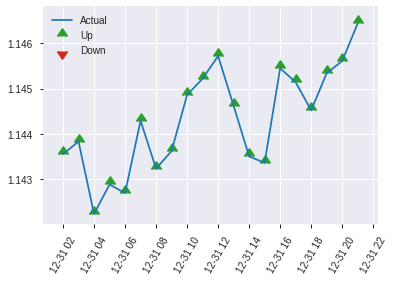


ModelMetricsBinomial: deeplearning
** Reported on test data. **

MSE: 0.27437098810922306
RMSE: 0.5238043414379295
LogLoss: 0.7493383982227523
Mean Per-Class Error: 0.4548556264611108
AUC: 0.5418325224826773
pr_auc: 0.5583160541399633
Gini: 0.08366504496535465
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.18083475852387415: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.1808348,0.6872340,399.0
max f2,0.1808348,0.8459927,399.0
max f0point5,0.5936035,0.5851703,337.0
max accuracy,0.6701761,0.5445705,206.0
max precision,0.8615053,1.0,0.0
max recall,0.1808348,1.0,399.0
max specificity,0.8615053,1.0,0.0
max absolute_mcc,0.6800867,0.0905494,189.0
max min_per_class_accuracy,0.6705234,0.5374150,205.0
max mean_per_class_accuracy,0.6800867,0.5451444,189.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 67.43 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.8389084,1.6373286,1.6373286,0.8571429,0.8467817,0.8571429,0.8467817,0.0185759,0.0185759,63.7328616,63.7328616
,2,0.0210697,0.8263434,0.6367389,1.1755180,0.3333333,0.8316490,0.6153846,0.8397974,0.0061920,0.0247678,-36.3261094,17.5517980
,3,0.0307942,0.8167984,1.2734778,1.2064527,0.6666667,0.8203873,0.6315789,0.8336679,0.0123839,0.0371517,27.3477812,20.6452664
,4,0.0405186,0.8098554,1.2734778,1.2225387,0.6666667,0.8135952,0.64,0.8288504,0.0123839,0.0495356,27.3477812,22.2538700
,5,0.0502431,0.8055336,1.2734778,1.2323979,0.6666667,0.8076685,0.6451613,0.8247507,0.0123839,0.0619195,27.3477812,23.2397883
,6,0.1004862,0.7764855,0.9242984,1.0783481,0.4838710,0.7912736,0.5645161,0.8080122,0.0464396,0.1083591,-7.5701588,7.8348147
,7,0.1507293,0.7540403,0.6778188,0.9448384,0.3548387,0.7649576,0.4946237,0.7936607,0.0340557,0.1424149,-32.2181164,-5.5161623
,8,0.2009724,0.7367634,1.6021172,1.1091581,0.8387097,0.7449575,0.5806452,0.7814849,0.0804954,0.2229102,60.2117248,10.9158094
,9,0.2998379,0.7110326,1.0647110,1.0945026,0.5573770,0.7227224,0.5729730,0.7621091,0.1052632,0.3281734,6.4710958,9.4502552
,10,0.4003241,0.6910652,1.0167283,1.0749803,0.5322581,0.7009382,0.5627530,0.7467545,0.1021672,0.4303406,1.6728253,7.4980258


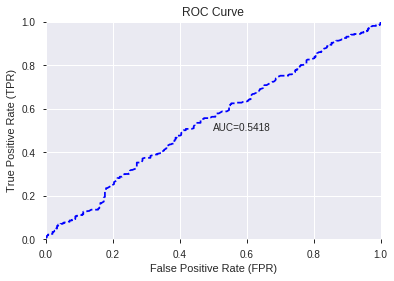

This function is available for GLM models only


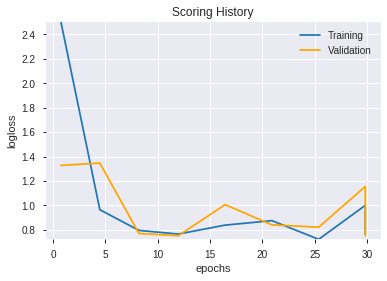

--2019-12-08 08:07:23--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.84.179
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.84.179|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


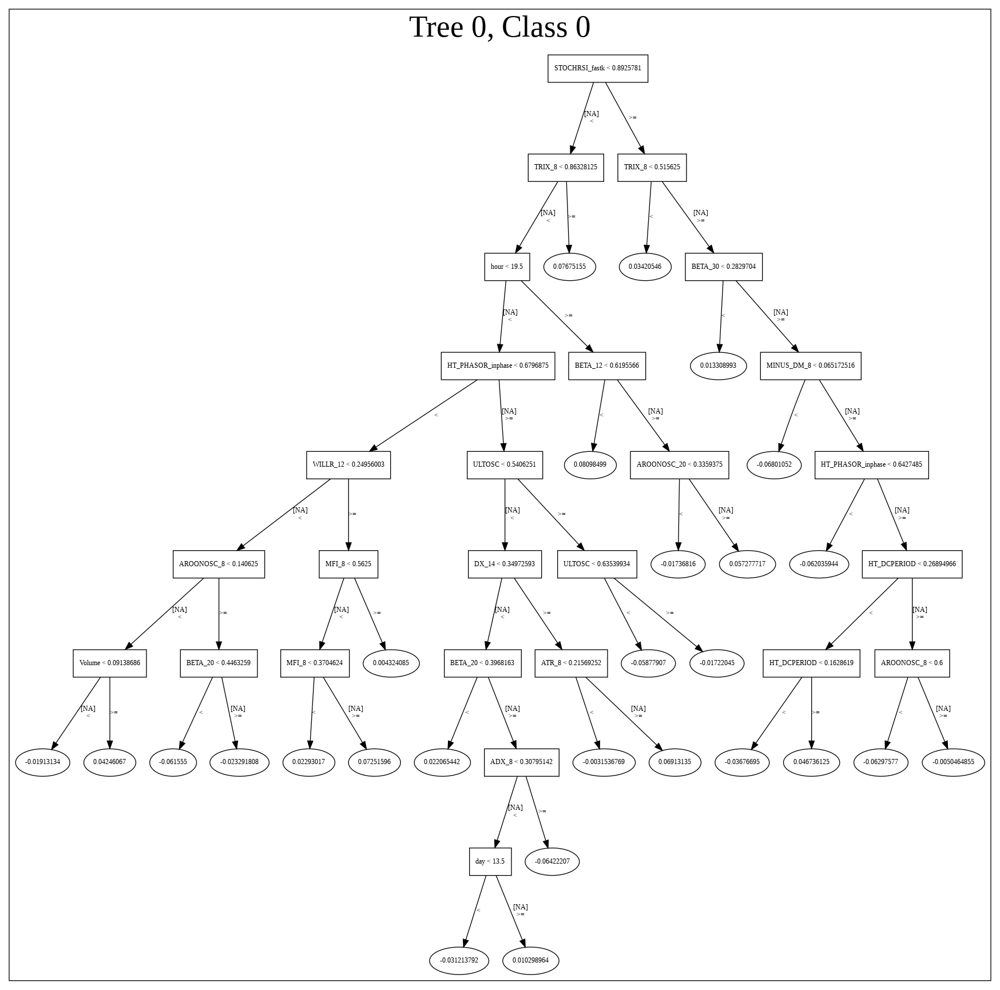

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/DeepLearning_grid_1_AutoML_20191208_074557_model_3',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'DeepLearning_grid_1_AutoML_20191208_074557_model_3',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_83_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'autom

['CDLSHOOTINGSTAR',
 'CDLGAPSIDESIDEWHITE',
 'CDLIDENTICAL3CROWS',
 'is_month_start',
 'CDLEVENINGSTAR',
 'CDLMORNINGSTAR',
 'CORREL_8',
 'CDLADVANCEBLOCK',
 'CDLEVENINGDOJISTAR',
 'is_quarter_start',
 'CDLSTALLEDPATTERN',
 'is_month_end',
 'CDLINVERTEDHAMMER',
 'CDLTHRUSTING',
 'CDLPIERCING',
 'CDLMORNINGDOJISTAR',
 'CDL3WHITESOLDIERS',
 'CDLHOMINGPIGEON',
 'CDLONNECK',
 'CDLMATCHINGLOW',
 'CDLHAMMER',
 'CDLSEPARATINGLINES',
 'CDLTAKURI',
 'CDLDRAGONFLYDOJI',
 'CDLDARKCLOUDCOVER',
 'CDLHANGINGMAN',
 'CDL3BLACKCROWS',
 'CDLGRAVESTONEDOJI',
 'CDLINNECK',
 'SAREXT',
 'CORREL_30',
 'CDLUNIQUE3RIVER',
 'HT_TRENDMODE',
 'STOCHRSI_fastk',
 'CORREL_12',
 'hour',
 'CDLRICKSHAWMAN',
 'aroonup_8',
 'days_in_month',
 'CORREL_14',
 'CDLXSIDEGAP3METHODS',
 'BOP',
 'CDLLONGLEGGEDDOJI',
 'day',
 'STOCHRSI_fastd',
 'aroondown_8',
 'aroonup_20',
 'CORREL_20',
 'CORREL_24',
 'CDLHIKKAKEMOD',
 'VAR_12',
 'CDLDOJI',
 'STOCHF_fastk',
 'Volume',
 'weekday_name',
 'aroondown_12',
 'VAR_30',
 'SUB',
 'STOCH_s

In [84]:
# DeepLearning with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="DeepLearning",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_080820_model_1,0.529975,0.694103,0.498299,0.500476,0.250476


,variable,relative_importance,scaled_importance,percentage
0,CDLSHORTLINE,0.008538,1.000000,0.019061
1,aroonup_8,0.007059,0.826744,0.015758
2,hour,0.006835,0.800495,0.015258
3,STOCHRSI_fastk,0.006258,0.732887,0.013969
4,BOP,0.006248,0.731811,0.013949
...,...,...,...,...
947,BBANDS_middleband_24_2_3,0.000000,0.000000,0.000000
948,BBANDS_middleband_30_2_3,0.000000,0.000000,0.000000
949,BBANDS_middleband_30_5_2,0.000000,0.000000,0.000000
950,BBANDS_middleband_30_6_2,0.000000,0.000000,0.000000


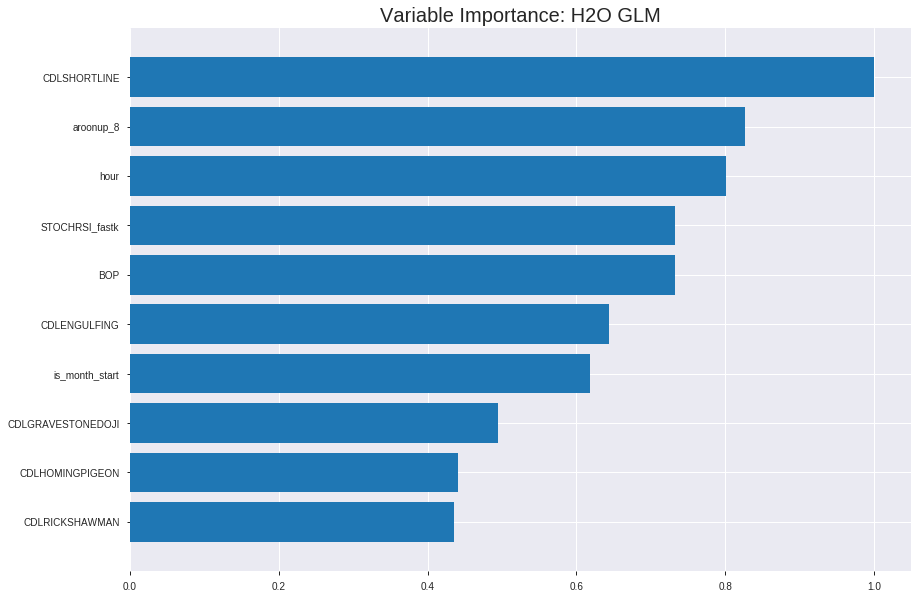

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_080820_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24836982429218807
RMSE: 0.4983671581195816
LogLoss: 0.6898824805369406
Null degrees of freedom: 4318
Residual degrees of freedom: 3385
Null deviance: 5986.754947319863
Residual deviance: 5959.204866878093
AIC: 7827.204866878093
AUC: 0.5583693529424129
pr_auc: 0.5509099632254683
Gini: 0.11673870588482571
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.45118675135706754: 


,0,1,Error,Rate
0,7.0,2179.0,0.9968,(2179.0/2186.0)
1,1.0,2132.0,0.0005,(1.0/2133.0)
Total,8.0,4311.0,0.5047,(2180.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4511868,0.6617008,393.0
max f2,0.4483516,0.8300903,396.0
max f0point5,0.4695589,0.5560161,340.0
max accuracy,0.4933300,0.5445705,209.0
max precision,0.5828778,1.0,0.0
max recall,0.4483516,1.0,396.0
max specificity,0.5828778,1.0,0.0
max absolute_mcc,0.5108556,0.0960796,111.0
max min_per_class_accuracy,0.4936412,0.5425435,207.0
max mean_per_class_accuracy,0.4933300,0.5446582,209.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5379126,1.3345587,1.3345587,0.6590909,0.5466020,0.6590909,0.5466020,0.0135959,0.0135959,33.4558667,33.4558667
,2,0.0201436,0.5316129,1.3185054,1.3266243,0.6511628,0.5341298,0.6551724,0.5404376,0.0131271,0.0267229,31.8505435,32.6624311
,3,0.0300996,0.5279928,1.4126844,1.3550903,0.6976744,0.5299427,0.6692308,0.5369662,0.0140647,0.0407876,41.2684395,35.5090339
,4,0.0400556,0.5246799,1.2714160,1.3342927,0.6279070,0.5263339,0.6589595,0.5343235,0.0126582,0.0534459,27.1415955,33.4292660
,5,0.0500116,0.5229627,1.0359686,1.2749041,0.5116279,0.5237463,0.6296296,0.5322178,0.0103141,0.0637600,3.5968556,27.4904065
,6,0.1000232,0.5163472,1.2092840,1.2420940,0.5972222,0.5194346,0.6134259,0.5258262,0.0604782,0.1242382,20.9284003,24.2094034
,7,0.1500347,0.5118006,1.1342896,1.2061592,0.5601852,0.5141359,0.5956790,0.5219294,0.0567276,0.1809658,13.4289646,20.6159238
,8,0.2000463,0.5083508,1.1061668,1.1811611,0.5462963,0.5099970,0.5833333,0.5189463,0.0553211,0.2362869,10.6166762,18.1161119
,9,0.3000695,0.5027993,1.0171110,1.1264777,0.5023148,0.5056126,0.5563272,0.5145018,0.1017346,0.3380216,1.7110964,12.6477734
,10,0.4000926,0.4979136,1.0030495,1.0956207,0.4953704,0.5002923,0.5410880,0.5109494,0.1003282,0.4383497,0.3049522,9.5620681




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.24959235610544206
RMSE: 0.4995921897962798
LogLoss: 0.6923317296383404
Null degrees of freedom: 1233
Residual degrees of freedom: 300
Null deviance: 1710.4803758483042
Residual deviance: 1708.6747087474241
AIC: 3576.674708747424
AUC: 0.520543842364532
pr_auc: 0.5215931665876472
Gini: 0.04108768472906399
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.44875101181618093: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4487510,0.6615970,397.0
max f2,0.4487510,0.8301527,397.0
max f0point5,0.4487510,0.5499368,397.0
max accuracy,0.4963162,0.5291734,135.0
max precision,0.5593444,1.0,0.0
max recall,0.4487510,1.0,397.0
max specificity,0.5593444,1.0,0.0
max absolute_mcc,0.5161880,0.0848711,33.0
max min_per_class_accuracy,0.4872976,0.5088,201.0
max mean_per_class_accuracy,0.4963162,0.5263934,135.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 48.71 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5241509,1.2469370,1.2469370,0.6153846,0.5336905,0.6153846,0.5336905,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.5202396,1.5197044,1.3778654,0.75,0.5214643,0.68,0.5278220,0.0147783,0.0279146,51.9704433,37.7865353
,3,0.0299838,0.5170764,1.1819923,1.3143390,0.5833333,0.5183830,0.6486486,0.5247607,0.0114943,0.0394089,18.1992337,31.4338970
,4,0.0405186,0.5159044,1.7145383,1.4183908,0.8461538,0.5165524,0.7,0.5226265,0.0180624,0.0574713,71.4538335,41.8390805
,5,0.0502431,0.5140609,0.8442802,1.3072726,0.4166667,0.5149452,0.6451613,0.5211398,0.0082102,0.0656814,-15.5719759,30.7272631
,6,0.1004862,0.5088829,0.8170454,1.0621590,0.4032258,0.5112501,0.5241935,0.5161950,0.0410509,0.1067323,-18.2954606,6.2159013
,7,0.1499190,0.5047144,1.0961802,1.0733768,0.5409836,0.5066338,0.5297297,0.5130424,0.0541872,0.1609195,9.6180247,7.3376825
,8,0.2001621,0.5009059,1.1438636,1.0910698,0.5645161,0.5027055,0.5384615,0.5104477,0.0574713,0.2183908,14.3863552,9.1069850
,9,0.2998379,0.4956933,1.0543207,1.0788532,0.5203252,0.4980037,0.5324324,0.5063109,0.1050903,0.3234811,5.4320691,7.8853237
,10,0.4003241,0.4908081,0.8987499,1.0336451,0.4435484,0.4930211,0.5101215,0.5029750,0.0903120,0.4137931,-10.1250066,3.3645121



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 08:08:24,0.000 sec,2,.27E1,934,1.3797650,1.3846635
,2019-12-08 08:08:26,2.308 sec,4,.2E1,937,1.3783517,1.3847884
,2019-12-08 08:08:29,4.610 sec,6,.14E1,937,1.3766759,1.3849111
,2019-12-08 08:08:31,6.929 sec,8,.1E1,937,1.3747459,1.3851804
,2019-12-08 08:08:33,9.230 sec,10,.75E0,945,1.3725697,1.3857078
,2019-12-08 08:08:36,11.542 sec,12,.55E0,945,1.3701720,1.3865706


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5429497568881686)

('F1', 0.6879659211927582)

('auc', 0.5299751479539184)

('logloss', 0.6941030186152913)

('mean_per_class_error', 0.4557928434531707)

('rmse', 0.5004761139840862)

('mse', 0.2504763406686121)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


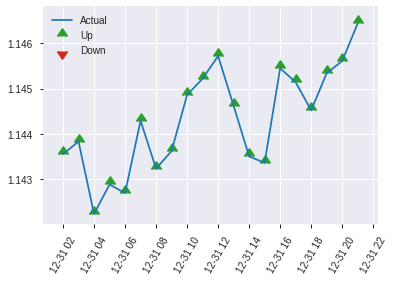


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.2504763406686121
RMSE: 0.5004761139840862
LogLoss: 0.6941030186152913
Null degrees of freedom: 616
Residual degrees of freedom: -317
Null deviance: 856.148314083962
Residual deviance: 856.5231249712696
AIC: 2724.5231249712697
AUC: 0.5299751479539184
pr_auc: 0.5543671007090404
Gini: 0.05995029590783685
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4483366774276998: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4483367,0.6879659,398.0
max f2,0.4483367,0.8464361,398.0
max f0point5,0.4483367,0.5794761,398.0
max accuracy,0.4740212,0.5429498,277.0
max precision,0.5420202,1.0,0.0
max recall,0.4483367,1.0,398.0
max specificity,0.5420202,1.0,0.0
max absolute_mcc,0.4861970,0.0889413,182.0
max min_per_class_accuracy,0.4830840,0.5068027,204.0
max mean_per_class_accuracy,0.4861970,0.5442072,182.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 48.35 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5223840,1.3644405,1.3644405,0.7142857,0.5277957,0.7142857,0.5277957,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.5170586,1.5918473,1.4693975,0.8333333,0.5202647,0.7692308,0.5243198,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.5140307,0.9551084,1.3069904,0.5,0.5152844,0.6842105,0.5214665,0.0092879,0.0402477,-4.4891641,30.6990386
,4,0.0405186,0.5118911,0.3183695,1.0697214,0.1666667,0.5127537,0.56,0.5193755,0.0030960,0.0433437,-68.1630547,6.9721362
,5,0.0502431,0.5102232,1.2734778,1.1091581,0.6666667,0.5108229,0.5806452,0.5177201,0.0123839,0.0557276,27.3477812,10.9158094
,6,0.1004862,0.5052854,1.1091581,1.1091581,0.5806452,0.5076844,0.5806452,0.5127022,0.0557276,0.1114551,10.9158094,10.9158094
,7,0.1507293,0.5012882,0.8626785,1.0269982,0.4516129,0.5031574,0.5376344,0.5095206,0.0433437,0.1547988,-13.7321482,2.6998236
,8,0.2009724,0.4968007,1.1707780,1.0629432,0.6129032,0.4988319,0.5564516,0.5068485,0.0588235,0.2136223,17.0777989,6.2943174
,9,0.2998379,0.4920355,1.0333959,1.0532006,0.5409836,0.4942409,0.5513514,0.5026914,0.1021672,0.3157895,3.3395930,5.3200569
,10,0.4003241,0.4879561,1.1091581,1.0672466,0.5806452,0.4898440,0.5587045,0.4994665,0.1114551,0.4272446,10.9158094,6.7246588


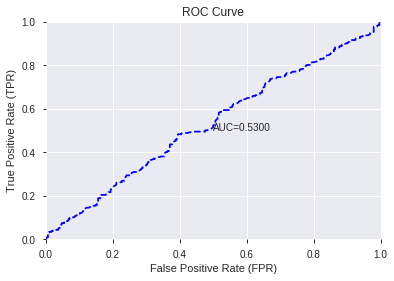

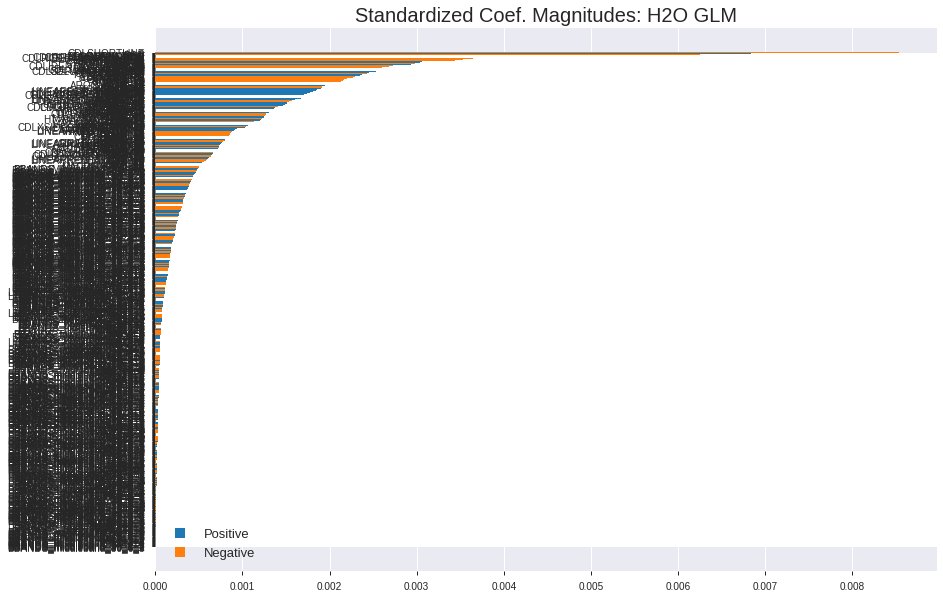

'log_likelihood'
--2019-12-08 08:09:00--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.137.108
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.137.108|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


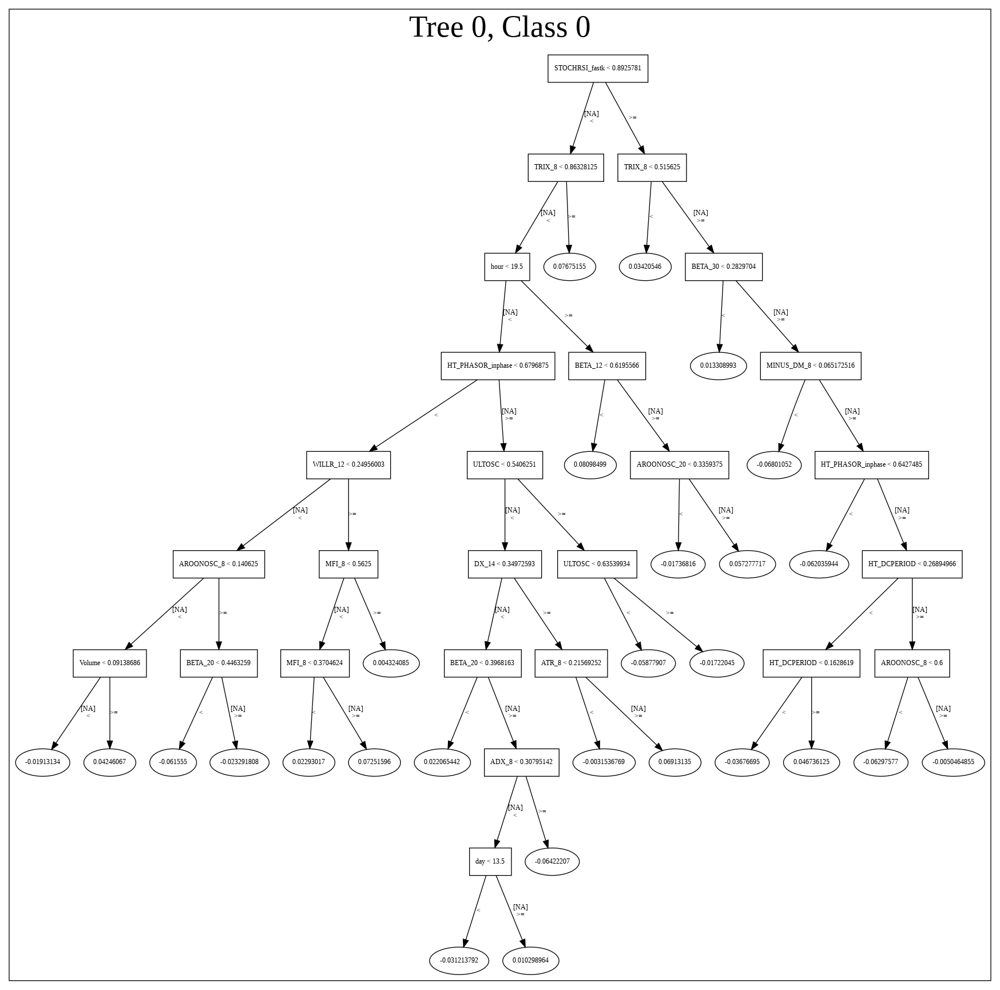

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_080820_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_080820_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_88_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_88_s

['CDLSHORTLINE',
 'aroonup_8',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'CDLENGULFING',
 'is_month_start',
 'CDLGRAVESTONEDOJI',
 'CDLHOMINGPIGEON',
 'CDLRICKSHAWMAN',
 'CDLRISEFALL3METHODS',
 'STOCHF_fastk',
 'CDLONNECK',
 'CDLTHRUSTING',
 'Volume',
 'AROONOSC_8',
 'DX_14',
 'CDLHARAMI',
 'DX_20',
 'STDDEV_24',
 'STOCHRSI_fastd',
 'ADOSC',
 'DX_12',
 'aroondown_20',
 'DX_24',
 'CDLIDENTICAL3CROWS',
 'BETA_30',
 'is_month_end',
 'CDLDOJISTAR',
 'ULTOSC',
 'CDL3BLACKCROWS',
 'quarter',
 'days_in_month',
 'CORREL_20',
 'CDLSEPARATINGLINES',
 'CDLUNIQUE3RIVER',
 'SAREXT',
 'STDDEV_30',
 'CDL3OUTSIDE',
 'HT_DCPERIOD',
 'SUB',
 'DIV',
 'STDDEV_20',
 'CDLINNECK',
 'aroondown_30',
 'MFI_20',
 'CDLHAMMER',
 'ADXR_8',
 'TRANGE',
 'CORREL_24',
 'BETA_20',
 'aroonup_14',
 'CORREL_8',
 'MFI_8',
 'aroonup_12',
 'DX_30',
 'CCI_8',
 'NATR_14',
 'NATR_12',
 'AROONOSC_20',
 'ATR_12',
 'ATR_14',
 'BETA_24',
 'BETA_12',
 'aroondown_12',
 'dayofyear',
 'weekofyear',
 'week',
 'WILLR_8',
 'aroondown_24',
 'aro

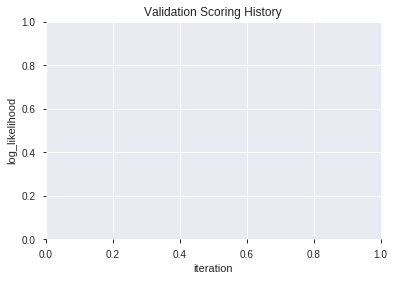

In [85]:
# GLM with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="GLM",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_grid_1_AutoML_20191208_080957_model_4,0.562304,0.686389,0.484083,0.496631,0.246642
1,XGBoost_grid_1_AutoML_20191208_080957_model_1,0.544707,0.696446,0.498299,0.501516,0.251518
2,XGBoost_1_AutoML_20191208_080957,0.527606,0.694173,0.491344,0.500521,0.250521
3,XGBoost_grid_1_AutoML_20191208_080957_model_6,0.524847,0.704269,0.482230,0.505061,0.255086
4,XGBoost_grid_1_AutoML_20191208_080957_model_3,0.521893,0.700792,0.489491,0.503585,0.253598
5,XGBoost_grid_1_AutoML_20191208_080957_model_7,0.514458,0.707073,0.494898,0.506466,0.256508
6,XGBoost_grid_1_AutoML_20191208_080957_model_2,0.513511,0.693095,0.492892,0.499996,0.249996
7,XGBoost_grid_1_AutoML_20191208_080957_model_5,0.513432,0.709251,0.477760,0.507604,0.257662
8,XGBoost_3_AutoML_20191208_080957,0.512647,0.702278,0.500000,0.504363,0.254382
9,XGBoost_2_AutoML_20191208_080957,0.508825,0.702240,0.498147,0.504327,0.254346


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,118.073410,1.000000,0.022544
1,hour,105.346878,0.892215,0.020114
2,BOP,90.738945,0.768496,0.017325
3,HT_DCPERIOD,86.851311,0.735570,0.016583
4,AROONOSC_8,85.249847,0.722007,0.016277
...,...,...,...,...
202,BBANDS_lowerband_8_3_5,5.380174,0.045566,0.001027
203,MINUS_DI_14,5.072889,0.042964,0.000969
204,PLUS_DM_30,4.735455,0.040106,0.000904
205,BBANDS_upperband_8_0_5,4.464686,0.037813,0.000852


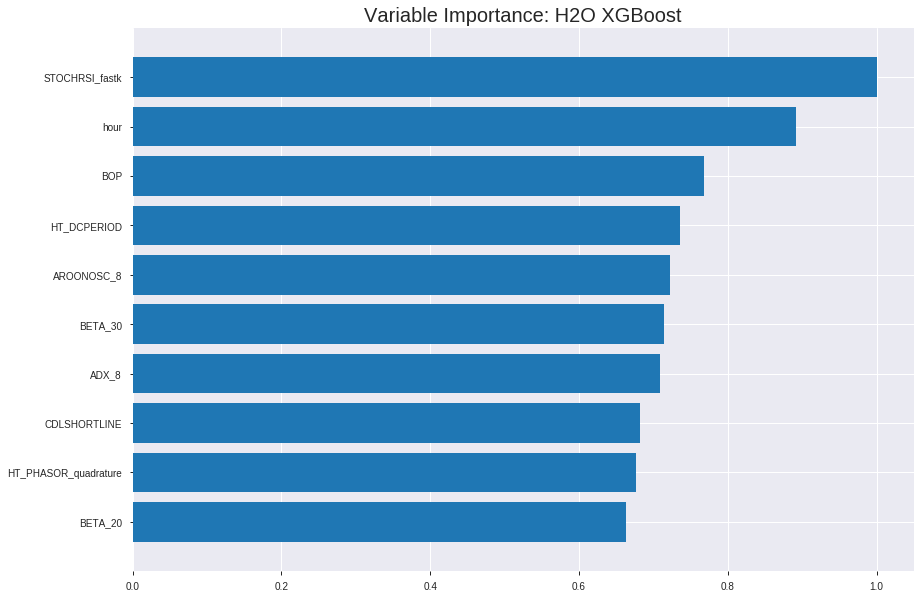

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_grid_1_AutoML_20191208_080957_model_4


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.2252395558207518
RMSE: 0.4745940958553444
LogLoss: 0.6429748111546745
Mean Per-Class Error: 0.302195941526202
AUC: 0.7644126691227344
pr_auc: 0.753008539550548
Gini: 0.5288253382454688
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.45894237690501744: 


,0,1,Error,Rate
0,963.0,1223.0,0.5595,(1223.0/2186.0)
1,261.0,1872.0,0.1224,(261.0/2133.0)
Total,1224.0,3095.0,0.3436,(1484.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4589424,0.7161438,262.0
max f2,0.4065999,0.8393372,333.0
max f0point5,0.5068247,0.7009788,181.0
max accuracy,0.5026740,0.6983098,188.0
max precision,0.7275871,1.0,0.0
max recall,0.3489195,1.0,382.0
max specificity,0.7275871,1.0,0.0
max absolute_mcc,0.5026740,0.3973086,188.0
max min_per_class_accuracy,0.4951749,0.6957914,200.0
max mean_per_class_accuracy,0.4960607,0.6978041,199.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.47 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6395280,2.0248476,2.0248476,1.0,0.6633746,1.0,0.6633746,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.6270030,1.8364897,1.9317512,0.9069767,0.6332365,0.9540230,0.6484788,0.0182841,0.0389123,83.6489713,93.1751190
,3,0.0300996,0.6155185,1.8364897,1.9002416,0.9069767,0.6207512,0.9384615,0.6393073,0.0182841,0.0571964,83.6489713,90.0241624
,4,0.0400556,0.6058150,1.7423108,1.8609871,0.8604651,0.6099662,0.9190751,0.6320145,0.0173465,0.0745429,74.2310753,86.0987130
,5,0.0500116,0.5966601,1.6481318,1.8186132,0.8139535,0.6016035,0.8981481,0.6259604,0.0164088,0.0909517,64.8131794,81.8613151
,6,0.1000232,0.5748190,1.6405016,1.7295574,0.8101852,0.5852553,0.8541667,0.6056078,0.0820441,0.1729958,64.0501554,72.9557353
,7,0.1500347,0.5597730,1.5936301,1.6842483,0.7870370,0.5666792,0.8317901,0.5926316,0.0797000,0.2526957,59.3630081,68.4248262
,8,0.2000463,0.5477694,1.5092614,1.6405016,0.7453704,0.5534184,0.8101852,0.5828283,0.0754805,0.3281763,50.9261430,64.0501554
,9,0.3000695,0.5285547,1.4202056,1.5670696,0.7013889,0.5377617,0.7739198,0.5678061,0.1420534,0.4702297,42.0205631,56.7069580
,10,0.4000926,0.5111682,1.2092840,1.4776232,0.5972222,0.5192386,0.7297454,0.5556642,0.1209564,0.5911861,20.9284003,47.7623185




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.2522470929424717
RMSE: 0.5022420660821549
LogLoss: 0.6977045799264388
Mean Per-Class Error: 0.48009064039408866
AUC: 0.5132545155993432
pr_auc: 0.5163146642500054
Gini: 0.026509031198686417
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3884676396846771: 


,0,1,Error,Rate
0,14.0,611.0,0.9776,(611.0/625.0)
1,6.0,603.0,0.0099,(6.0/609.0)
Total,20.0,1214.0,0.5,(617.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3884676,0.6615469,382.0
max f2,0.3003419,0.8297003,399.0
max f0point5,0.3884676,0.5516926,382.0
max accuracy,0.5812569,0.5235008,77.0
max precision,0.6433780,0.75,12.0
max recall,0.3003419,1.0,399.0
max specificity,0.6971281,0.9984,0.0
max absolute_mcc,0.6276668,0.0628782,18.0
max min_per_class_accuracy,0.5305201,0.504,182.0
max mean_per_class_accuracy,0.5586603,0.5199094,121.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 52.58 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6507249,1.4028041,1.4028041,0.6923077,0.6667302,0.6923077,0.6667302,0.0147783,0.0147783,40.2804092,40.2804092
,2,0.0202593,0.6276814,1.3508484,1.3778654,0.6666667,0.6361483,0.68,0.6520509,0.0131363,0.0279146,35.0848385,37.7865353
,3,0.0299838,0.6236921,1.0131363,1.2595748,0.5,0.6260743,0.6216216,0.6436260,0.0098522,0.0377668,1.3136289,25.9574846
,4,0.0405186,0.6152388,1.2469370,1.2562890,0.6153846,0.6207994,0.62,0.6376911,0.0131363,0.0509031,24.6936971,25.6288998
,5,0.0502431,0.6098112,1.0131363,1.2092272,0.5,0.6118431,0.5967742,0.6326883,0.0098522,0.0607553,1.3136289,20.9227184
,6,0.1004862,0.5923597,1.0131363,1.1111817,0.5,0.6001636,0.5483871,0.6164259,0.0509031,0.1116585,1.3136289,11.1181736
,7,0.1499190,0.5806001,1.1293978,1.1171881,0.5573770,0.5863578,0.5513514,0.6065116,0.0558292,0.1674877,12.9397830,11.7188124
,8,0.2001621,0.5716515,0.8824090,1.0582557,0.4354839,0.5759356,0.5222672,0.5988366,0.0443350,0.2118227,-11.7590974,5.8255719
,9,0.2998379,0.5555069,1.0213732,1.0459948,0.5040650,0.5639666,0.5162162,0.5872447,0.1018062,0.3136289,2.1373169,4.5994763
,10,0.4003241,0.5423283,0.8987499,1.0090345,0.4435484,0.5491142,0.4979757,0.5776735,0.0903120,0.4039409,-10.1250066,0.9034523



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:10:31,12.489 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 08:10:32,13.533 sec,5.0,0.4968762,0.6869141,0.6390044,0.6285906,1.8867898,0.4494096,0.5000763,0.6933000,0.5045084,0.4942566,1.0910698,0.5064830
,2019-12-08 08:10:32,13.951 sec,10.0,0.4937473,0.6806956,0.6719492,0.6586741,1.8867898,0.4230146,0.4999678,0.6930820,0.5120972,0.5099762,1.4028041,0.5056726
,2019-12-08 08:10:33,14.374 sec,15.0,0.4909009,0.6750600,0.6973944,0.6862970,1.7947513,0.4225515,0.4999542,0.6930541,0.5157320,0.5181760,1.5586712,0.5064830
,2019-12-08 08:10:33,14.788 sec,20.0,0.4884395,0.6701964,0.7116884,0.6976353,1.7947513,0.3697615,0.5002830,0.6937144,0.5127278,0.5154451,1.2469370,0.5008104
,2019-12-08 08:10:34,15.199 sec,25.0,0.4853119,0.6640329,0.7265583,0.7164758,1.8407706,0.3674462,0.5006438,0.6944432,0.5127028,0.5155989,1.2469370,0.5064830
,2019-12-08 08:10:34,15.616 sec,30.0,0.4831417,0.6597527,0.7332256,0.7241230,1.9788284,0.3730030,0.5007972,0.6947602,0.5156598,0.5131126,0.7793356,0.5064830
,2019-12-08 08:10:34,16.037 sec,35.0,0.4805073,0.6545826,0.7460181,0.7353514,1.8867898,0.3565640,0.5009977,0.6951562,0.5126437,0.5174550,1.2469370,0.5064830
,2019-12-08 08:10:35,16.450 sec,40.0,0.4783467,0.6503257,0.7503396,0.7395038,1.9328091,0.3618893,0.5015946,0.6963647,0.5124821,0.5184890,1.5586712,0.5064830
,2019-12-08 08:10:35,16.902 sec,45.0,0.4760171,0.6457622,0.7604713,0.7491245,2.0248476,0.3343367,0.5021098,0.6974203,0.5124401,0.5173325,1.5586712,0.5056726


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
STOCHRSI_fastk,118.0734100,1.0,0.0225442
hour,105.3468781,0.8922151,0.0201143
BOP,90.7389450,0.7684960,0.0173252
HT_DCPERIOD,86.8513107,0.7355704,0.0165829
AROONOSC_8,85.2498474,0.7220072,0.0162771
---,---,---,---
BBANDS_lowerband_8_3_5,5.3801737,0.0455663,0.0010273
MINUS_DI_14,5.0728893,0.0429639,0.0009686
PLUS_DM_30,4.7354546,0.0401060,0.0009042
BBANDS_upperband_8_0_5,4.4646864,0.0378128,0.0008525



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5623987034035657)

('F1', 0.6912242686890573)

('auc', 0.5623038689159874)

('logloss', 0.686388636044166)

('mean_per_class_error', 0.43139361007560917)

('rmse', 0.49663098543927786)

('mse', 0.24664233569838823)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


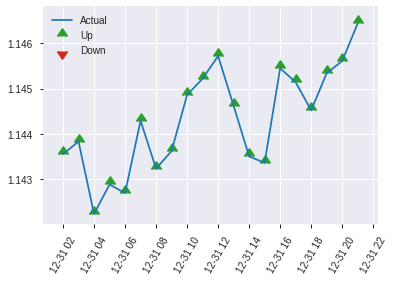


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.24664233569838823
RMSE: 0.49663098543927786
LogLoss: 0.686388636044166
Mean Per-Class Error: 0.43139361007560917
AUC: 0.5623038689159874
pr_auc: 0.5755633653399207
Gini: 0.12460773783197476
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4404434263706207: 


,0,1,Error,Rate
0,13.0,281.0,0.9558,(281.0/294.0)
1,4.0,319.0,0.0124,(4.0/323.0)
Total,17.0,600.0,0.4619,(285.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4404434,0.6912243,382.0
max f2,0.4165836,0.8482143,394.0
max f0point5,0.4404434,0.5857510,382.0
max accuracy,0.5430561,0.5623987,156.0
max precision,0.6417733,0.6666667,2.0
max recall,0.4165836,1.0,394.0
max specificity,0.6757681,0.9965986,0.0
max absolute_mcc,0.5430561,0.1418521,156.0
max min_per_class_accuracy,0.5285821,0.5479876,197.0
max mean_per_class_accuracy,0.5430561,0.5686064,156.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 52.88 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6213801,1.0915524,1.0915524,0.5714286,0.6406545,0.5714286,0.6406545,0.0123839,0.0123839,9.1552410,9.1552410
,2,0.0210697,0.6155095,0.9551084,1.0285782,0.5,0.6182769,0.5384615,0.6303264,0.0092879,0.0216718,-4.4891641,2.8578233
,3,0.0307942,0.6112445,1.5918473,1.2064527,0.8333333,0.6135690,0.6315789,0.6250346,0.0154799,0.0371517,59.1847265,20.6452664
,4,0.0405186,0.6060130,0.9551084,1.1461300,0.5,0.6087303,0.6,0.6211215,0.0092879,0.0464396,-4.4891641,14.6130031
,5,0.0502431,0.6021202,1.2734778,1.1707780,0.6666667,0.6047493,0.6129032,0.6179527,0.0123839,0.0588235,27.3477812,17.0777989
,6,0.1004862,0.5862076,1.1707780,1.1707780,0.6129032,0.5945990,0.6129032,0.6062759,0.0588235,0.1176471,17.0777989,17.0777989
,7,0.1507293,0.5767541,1.2323979,1.1913180,0.6451613,0.5814273,0.6236559,0.5979930,0.0619195,0.1795666,23.2397883,19.1317953
,8,0.2009724,0.5681405,1.2323979,1.2015879,0.6451613,0.5717329,0.6290323,0.5914280,0.0619195,0.2414861,23.2397883,20.1587936
,9,0.2998379,0.5505817,1.0960260,1.1667810,0.5737705,0.5587671,0.6108108,0.5806587,0.1083591,0.3498452,9.6025986,16.6781023
,10,0.4003241,0.5402625,1.0783481,1.1445833,0.5645161,0.5453884,0.5991903,0.5718054,0.1083591,0.4582043,7.8348147,14.4583297


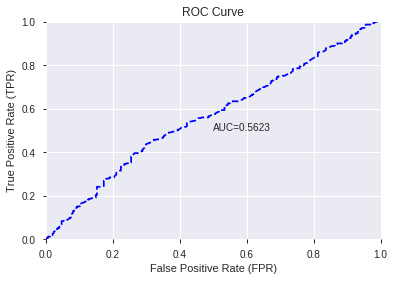

This function is available for GLM models only


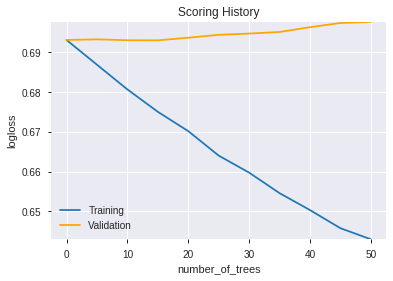

--2019-12-08 08:11:02--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.82.160
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.82.160|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
log4j:WARN No appenders could be found for logger (ml.dmlc.xgboost4j.java.Booster).
log4j:WARN Please initialize the log4j system properly.
log4j:WARN See http://logging.apache.org/log4j/1.2/faq.html#noconfig for more info.
Exception in thread "main" java.lang.StackOverflowError
	at java.base/java.lang.String.substring(String.java:1874)
	at java.base/java.lang.String.split(String.java:2289)
	at java.base/java.lang.String.split(String.java:2364)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:101)
	at hex.

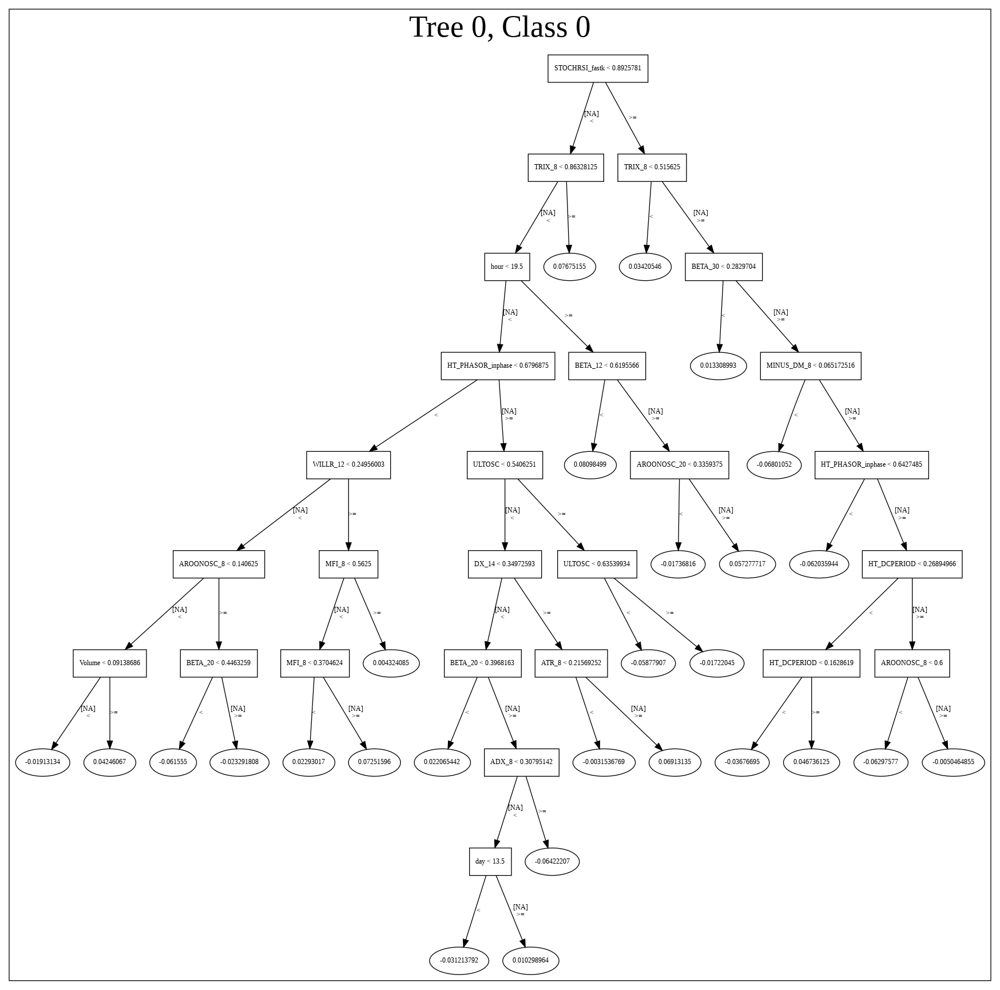

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_grid_1_AutoML_20191208_080957_model_4',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_grid_1_AutoML_20191208_080957_model_4',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_93_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training

['STOCHRSI_fastk',
 'hour',
 'BOP',
 'HT_DCPERIOD',
 'AROONOSC_8',
 'BETA_30',
 'ADX_8',
 'CDLSHORTLINE',
 'HT_PHASOR_quadrature',
 'BETA_20',
 'TRIX_8',
 'ADOSC',
 'STOCH_slowd',
 'Volume',
 'MFI_8',
 'WILLR_20',
 'ULTOSC',
 'SAREXT',
 'STDDEV_14',
 'CCI_8',
 'WILLR_12',
 'MFI_24',
 'HT_PHASOR_inphase',
 'MFI_20',
 'STDDEV_8',
 'MFI_14',
 'MOM_8',
 'AROONOSC_24',
 'STOCHRSI_fastd',
 'AROONOSC_20',
 'MFI_12',
 'ADXR_8',
 'BETA_12',
 'BBANDS_lowerband_24_2_5',
 'STDDEV_20',
 'CCI_12',
 'BETA_14',
 'STDDEV_30',
 'BETA_8',
 'MINUS_DM_8',
 'DX_12',
 'day',
 'MACDFIX_hist_24',
 'STOCHF_fastk',
 'ADX_12',
 'CMO_20',
 'DX_14',
 'dayofweek',
 'aroondown_20',
 'ATR_8',
 'PLUS_DM_24',
 'MACDFIX_signal_24',
 'DX_8',
 'STDDEV_24',
 'aroonup_24',
 'ROC_8',
 'BETA_24',
 'MACDFIX_hist_20',
 'STOCH_slowk',
 'ADXR_12',
 'MINUS_DI_24',
 'CCI_24',
 'ADX_20',
 'DX_24',
 'BBANDS_lowerband_14_3_5',
 'DX_20',
 'WILLR_24',
 'BBANDS_upperband_12_1_5',
 'PLUS_DI_24',
 'MACDFIX_signal_14',
 'MOM_12',
 'BBANDS_lo

In [86]:
# XGBoost with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="XGBoost",features_list=features_list)

In [87]:
# DRF with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="DRF",features_list=features_list)

Output hidden; open in https://colab.research.google.com to view.

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_grid_1_AutoML_20191208_081343_model_1,0.516696,0.692274,0.493197,0.499564,0.249565
1,GBM_4_AutoML_20191208_081343,0.516428,0.762237,0.500000,0.528467,0.279277
2,GBM_grid_1_AutoML_20191208_081343_model_2,0.514990,0.692208,0.484236,0.499532,0.249532
3,GBM_1_AutoML_20191208_081343,0.510494,0.767097,0.498299,0.529938,0.280834
4,GBM_grid_1_AutoML_20191208_081343_model_4,0.504549,0.693308,0.493197,0.500080,0.250080
5,GBM_grid_1_AutoML_20191208_081343_model_3,0.503944,1.101783,0.500000,0.593352,0.352067
6,GBM_2_AutoML_20191208_081343,0.502643,0.767495,0.498299,0.530426,0.281352
7,GBM_grid_1_AutoML_20191208_081343_model_5,0.500642,0.693583,0.493197,0.500218,0.250218
8,GBM_3_AutoML_20191208_081343,0.493840,0.797265,0.500000,0.541310,0.293017
9,GBM_5_AutoML_20191208_081343,0.486158,0.702391,0.491497,0.504555,0.254576


,variable,relative_importance,scaled_importance,percentage
0,BOP,78.198097,1.000000,0.018728
1,hour,76.437012,0.977479,0.018306
2,STOCHRSI_fastk,69.290237,0.886086,0.016595
3,BETA_12,53.495007,0.684096,0.012812
4,BETA_30,50.721088,0.648623,0.012147
...,...,...,...,...
947,SUM_12,0.000000,0.000000,0.000000
948,MIN_20,0.000000,0.000000,0.000000
949,MINMAX_min_24,0.000000,0.000000,0.000000
950,MAX_30,0.000000,0.000000,0.000000


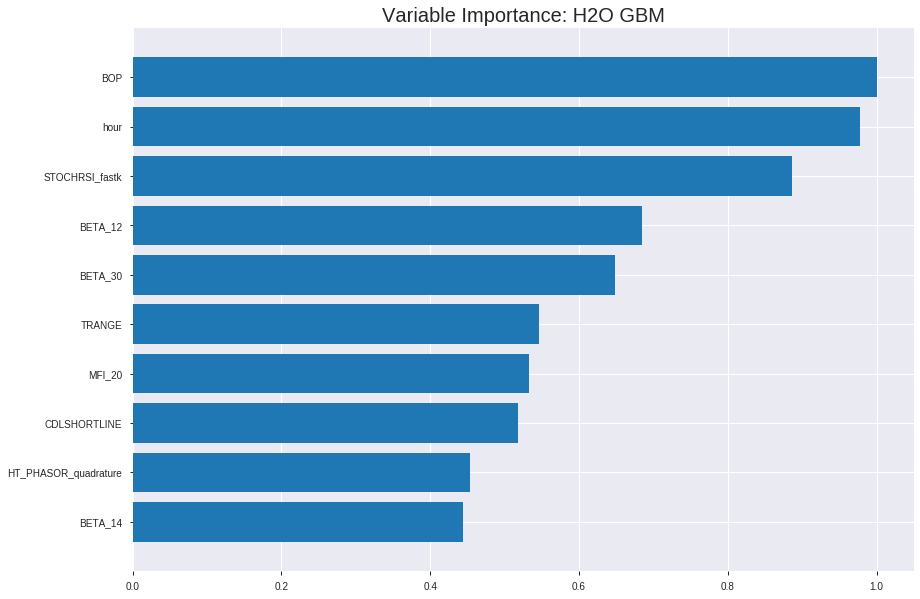

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_grid_1_AutoML_20191208_081343_model_1


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.23087722331071242
RMSE: 0.4804968504690873
LogLoss: 0.6548089137825392
Mean Per-Class Error: 0.13934688159617803
AUC: 0.9415288828152042
pr_auc: 0.9441484985511978
Gini: 0.8830577656304084
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4932587782327184: 


,0,1,Error,Rate
0,1905.0,281.0,0.1285,(281.0/2186.0)
1,321.0,1812.0,0.1505,(321.0/2133.0)
Total,2226.0,2093.0,0.1394,(602.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4932588,0.8575485,202.0
max f2,0.4828373,0.9060107,245.0
max f0point5,0.4990268,0.8826160,179.0
max accuracy,0.4940534,0.8608474,199.0
max precision,0.5866966,1.0,0.0
max recall,0.4638992,1.0,308.0
max specificity,0.5866966,1.0,0.0
max absolute_mcc,0.4940534,0.7222027,199.0
max min_per_class_accuracy,0.4926371,0.8568161,205.0
max mean_per_class_accuracy,0.4934805,0.8606531,201.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.38 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5636563,2.0248476,2.0248476,1.0,0.5722769,1.0,0.5722769,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.5569068,2.0248476,2.0248476,1.0,0.5604248,1.0,0.5664190,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.5521120,2.0248476,2.0248476,1.0,0.5546214,1.0,0.5625167,0.0201594,0.0609470,102.4847632,102.4847632
,4,0.0400556,0.5466946,2.0248476,2.0248476,1.0,0.5492085,1.0,0.5592089,0.0201594,0.0811064,102.4847632,102.4847632
,5,0.0500116,0.5439727,2.0248476,2.0248476,1.0,0.5450685,1.0,0.5563939,0.0201594,0.1012658,102.4847632,102.4847632
,6,0.1000232,0.5316014,2.0248476,2.0248476,1.0,0.5375239,1.0,0.5469589,0.1012658,0.2025316,102.4847632,102.4847632
,7,0.1500347,0.5214736,2.0248476,2.0248476,1.0,0.5267506,1.0,0.5402228,0.1012658,0.3037975,102.4847632,102.4847632
,8,0.2000463,0.5159263,1.9686019,2.0107862,0.9722222,0.5187035,0.9930556,0.5348430,0.0984529,0.4022504,96.8601865,101.0786191
,9,0.3000695,0.5059785,1.9217304,1.9811009,0.9490741,0.5105474,0.9783951,0.5267445,0.1922175,0.5944679,92.1730392,98.1100924
,10,0.4000926,0.4986269,1.5326972,1.8690000,0.7569444,0.5022415,0.9230324,0.5206187,0.1533052,0.7477731,53.2697166,86.8999985




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.24852845240222143
RMSE: 0.4985262805532136
LogLoss: 0.6901985144727527
Mean Per-Class Error: 0.44950673234811167
AUC: 0.5560866995073891
pr_auc: 0.5441395676649804
Gini: 0.11217339901477819
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4534293222635713: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4534293,0.6615970,397.0
max f2,0.4534293,0.8301527,397.0
max f0point5,0.4861545,0.5532489,318.0
max accuracy,0.5090991,0.5502431,207.0
max precision,0.5625278,0.7,8.0
max recall,0.4534293,1.0,397.0
max specificity,0.5864564,0.9984,0.0
max absolute_mcc,0.5090991,0.1010483,207.0
max min_per_class_accuracy,0.5100987,0.5467980,201.0
max mean_per_class_accuracy,0.5090991,0.5504933,207.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 50.98 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5603752,1.0910698,1.0910698,0.5384615,0.5672366,0.5384615,0.5672366,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.5556514,1.3508484,1.2157635,0.6666667,0.5578354,0.6,0.5627240,0.0131363,0.0246305,35.0848385,21.5763547
,3,0.0299838,0.5514234,1.3508484,1.2595748,0.6666667,0.5533019,0.6216216,0.5596682,0.0131363,0.0377668,35.0848385,25.9574846
,4,0.0405186,0.5490151,1.2469370,1.2562890,0.6153846,0.5504668,0.62,0.5572758,0.0131363,0.0509031,24.6936971,25.6288998
,5,0.0502431,0.5465686,1.5197044,1.3072726,0.75,0.5477428,0.6451613,0.5554307,0.0147783,0.0656814,51.9704433,30.7272631
,6,0.1004862,0.5388674,1.1438636,1.2255681,0.5645161,0.5419208,0.6048387,0.5486758,0.0574713,0.1231527,14.3863552,22.5568092
,7,0.1499190,0.5326174,1.0629627,1.1719522,0.5245902,0.5358227,0.5783784,0.5444377,0.0525452,0.1756979,6.2962664,17.1952248
,8,0.2001621,0.5281324,1.1111817,1.1566981,0.5483871,0.5305716,0.5708502,0.5409572,0.0558292,0.2315271,11.1181736,15.6698111
,9,0.2998379,0.5217048,1.1037420,1.1390938,0.5447154,0.5247893,0.5621622,0.5355824,0.1100164,0.3415435,10.3741973,13.9093774
,10,0.4003241,0.5158825,0.8987499,1.0787646,0.4435484,0.5190522,0.5323887,0.5314331,0.0903120,0.4318555,-10.1250066,7.8764551



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:14:33,0.018 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 08:14:34,1.247 sec,5.0,0.4970564,0.6872757,0.7959871,0.8060890,2.0248476,0.3232230,0.4995409,0.6922291,0.5342069,0.5249032,1.0910698,0.4975689
,2019-12-08 08:14:36,2.719 sec,10.0,0.4935075,0.6802390,0.8697294,0.8739720,2.0248476,0.2282936,0.4994472,0.6920417,0.5313419,0.5212061,0.9352027,0.4951378
,2019-12-08 08:14:37,4.200 sec,15.0,0.4899924,0.6733133,0.9073847,0.9098036,2.0248476,0.1852281,0.4991144,0.6913759,0.5427862,0.5277896,1.2469370,0.4975689
,2019-12-08 08:14:39,5.742 sec,20.0,0.4868586,0.6671736,0.9202060,0.9229246,2.0248476,0.1715675,0.4987663,0.6906794,0.5519921,0.5384102,1.0910698,0.4991896
,2019-12-08 08:14:40,7.159 sec,25.0,0.4837080,0.6610343,0.9329413,0.9355969,2.0248476,0.1602223,0.4986700,0.6904856,0.5509727,0.5440118,1.5586712,0.5016207
,2019-12-08 08:14:42,8.600 sec,30.0,0.4804969,0.6548089,0.9415289,0.9441485,2.0248476,0.1393841,0.4985263,0.6901985,0.5560867,0.5441396,1.0910698,0.5048622


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BOP,78.1980972,1.0,0.0187280
hour,76.4370117,0.9774792,0.0183062
STOCHRSI_fastk,69.2902374,0.8860860,0.0165946
BETA_12,53.4950066,0.6840960,0.0128117
BETA_30,50.7210884,0.6486231,0.0121474
---,---,---,---
SUM_12,0.0,0.0,0.0
MIN_20,0.0,0.0,0.0
MINMAX_min_24,0.0,0.0,0.0
MAX_30,0.0,0.0,0.0



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5413290113452188)

('F1', 0.6901709401709402)

('auc', 0.5166961521450686)

('logloss', 0.6922738417420817)

('mean_per_class_error', 0.4626640129736105)

('rmse', 0.499564489787054)

('mse', 0.24956467945619953)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


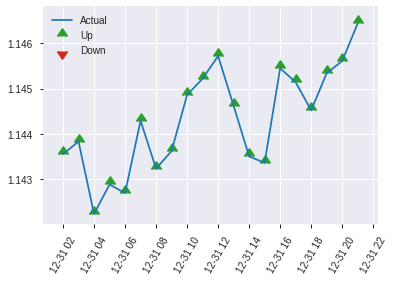


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.24956467945619953
RMSE: 0.499564489787054
LogLoss: 0.6922738417420817
Mean Per-Class Error: 0.4626640129736105
AUC: 0.5166961521450686
pr_auc: 0.5412019324819042
Gini: 0.033392304290137176
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4532434980301636: 


,0,1,Error,Rate
0,4.0,290.0,0.9864,(290.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,4.0,613.0,0.47,(290.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4532435,0.6901709,395.0
max f2,0.4532435,0.8477690,395.0
max f0point5,0.4532435,0.5819820,395.0
max accuracy,0.5046955,0.5413290,232.0
max precision,0.5833043,1.0,0.0
max recall,0.4532435,1.0,395.0
max specificity,0.5833043,1.0,0.0
max absolute_mcc,0.5714270,0.0862346,4.0
max min_per_class_accuracy,0.5101800,0.5204082,205.0
max mean_per_class_accuracy,0.5046955,0.5373360,232.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 51.15 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5699527,1.3644405,1.3644405,0.7142857,0.5757280,0.7142857,0.5757280,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.5643834,1.2734778,1.3224577,0.6666667,0.5656069,0.6923077,0.5710567,0.0123839,0.0278638,27.3477812,32.2457728
,3,0.0307942,0.5612039,0.9551084,1.2064527,0.5,0.5628045,0.6315789,0.5684508,0.0092879,0.0371517,-4.4891641,20.6452664
,4,0.0405186,0.5592718,0.6367389,1.0697214,0.3333333,0.5603535,0.56,0.5665074,0.0061920,0.0433437,-36.3261094,6.9721362
,5,0.0502431,0.5575502,0.3183695,0.9242984,0.1666667,0.5584615,0.4838710,0.5649502,0.0030960,0.0464396,-68.1630547,-7.5701588
,6,0.1004862,0.5469511,1.1707780,1.0475382,0.6129032,0.5524417,0.5483871,0.5586959,0.0588235,0.1052632,17.0777989,4.7538200
,7,0.1507293,0.5407204,0.8626785,0.9859183,0.4516129,0.5435059,0.5161290,0.5536326,0.0433437,0.1486068,-13.7321482,-1.4081694
,8,0.2009724,0.5341505,1.1091581,1.0167283,0.5806452,0.5369136,0.5322581,0.5494528,0.0557276,0.2043344,10.9158094,1.6728253
,9,0.2998379,0.5239738,1.1273410,1.0532006,0.5901639,0.5289152,0.5513514,0.5426809,0.1114551,0.3157895,12.7341014,5.3200569
,10,0.4003241,0.5167048,1.0475382,1.0517792,0.5483871,0.5206550,0.5506073,0.5371522,0.1052632,0.4210526,4.7538200,5.1779246


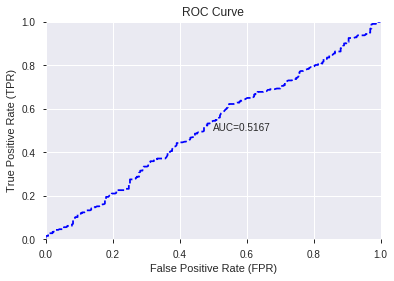

This function is available for GLM models only


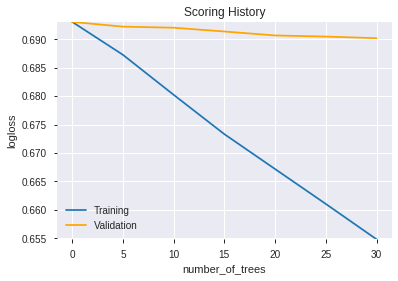

--2019-12-08 08:15:51--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.217.41.140
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.217.41.140|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      160.0
            depth:       1
            colId:       432
            colName:     BBANDS_lowerband_20_3_5
            leftward:    true
            naVsRest:    false
            splitVal:    0.9765625
            isBitset:    false
            predValue:   -0.15636432
            squaredErr:  35.775
            leftChild:   Node 5
      

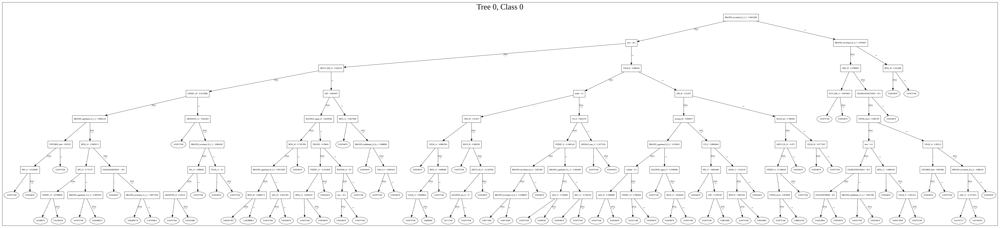

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_grid_1_AutoML_20191208_081343_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_grid_1_AutoML_20191208_081343_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_103_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_103

['BOP',
 'hour',
 'STOCHRSI_fastk',
 'BETA_12',
 'BETA_30',
 'TRANGE',
 'MFI_20',
 'CDLSHORTLINE',
 'HT_PHASOR_quadrature',
 'BETA_14',
 'MFI_14',
 'STOCHF_fastk',
 'ADX_24',
 'BETA_24',
 'WILLR_8',
 'aroonup_8',
 'HT_DCPERIOD',
 'HT_PHASOR_inphase',
 'MACDEXT_signal',
 'WILLR_14',
 'STOCHRSI_fastd',
 'MFI_12',
 'BETA_8',
 'WILLR_12',
 'STOCH_slowk',
 'ADXR_12',
 'AROONOSC_24',
 'ULTOSC',
 'ADX_8',
 'ROC_20',
 'DX_8',
 'ATR_8',
 'STDDEV_8',
 'CCI_8',
 'MFI_8',
 'AROONOSC_20',
 'MFI_30',
 'CCI_12',
 'aroondown_12',
 'MFI_24',
 'DIV',
 'AROONOSC_14',
 'WILLR_30',
 'BBANDS_lowerband_24_2_5',
 'ADX_20',
 'BETA_20',
 'DX_12',
 'STOCHF_fastd',
 'MINUS_DM_24',
 'STDDEV_14',
 'AROONOSC_8',
 'CCI_14',
 'AROONOSC_30',
 'aroonup_14',
 'ATR_20',
 'PLUS_DI_8',
 'aroondown_20',
 'ADXR_14',
 'ROCP_20',
 'MOM_8',
 'day',
 'MINUS_DI_30',
 'NATR_30',
 'STDDEV_24',
 'LINEARREG_ANGLE_14',
 'APO',
 'MOM_14',
 'aroondown_8',
 'ADOSC',
 'CDLHIKKAKE',
 'ATR_12',
 'LINEARREG_ANGLE_20',
 'MINUS_DI_8',
 'aroonup

In [88]:
# GBM with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="GBM",features_list=features_list)

In [89]:
# StackedEnsemble with Select Family-wise error features
model_train(feature_name='Fwe',model_algo="StackedEnsemble",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_081649_model_1,0.529975,0.694103,0.498299,0.500476,0.250476
1,XGBoost_1_AutoML_20191208_081649,0.527606,0.694173,0.491344,0.500521,0.250521
2,GBM_4_AutoML_20191208_081649,0.516428,0.762237,0.500000,0.528467,0.279277
3,XGBoost_3_AutoML_20191208_081649,0.512647,0.702278,0.500000,0.504363,0.254382
4,DRF_1_AutoML_20191208_081649,0.512373,0.721197,0.489491,0.512679,0.262840
5,GBM_1_AutoML_20191208_081649,0.510494,0.767097,0.498299,0.529938,0.280834
6,XGBoost_2_AutoML_20191208_081649,0.508825,0.702240,0.498147,0.504327,0.254346
7,GBM_2_AutoML_20191208_081649,0.502643,0.767495,0.498299,0.530426,0.281352
8,GBM_3_AutoML_20191208_081649,0.493840,0.797265,0.500000,0.541310,0.293017
9,GBM_5_AutoML_20191208_081649,0.486158,0.702391,0.491497,0.504555,0.254576


,variable,relative_importance,scaled_importance,percentage
0,CDLSHORTLINE,0.008538,1.000000,0.019061
1,aroonup_8,0.007059,0.826744,0.015758
2,hour,0.006835,0.800495,0.015258
3,STOCHRSI_fastk,0.006258,0.732887,0.013969
4,BOP,0.006248,0.731811,0.013949
...,...,...,...,...
947,BBANDS_middleband_24_2_3,0.000000,0.000000,0.000000
948,BBANDS_middleband_30_2_3,0.000000,0.000000,0.000000
949,BBANDS_middleband_30_5_2,0.000000,0.000000,0.000000
950,BBANDS_middleband_30_6_2,0.000000,0.000000,0.000000


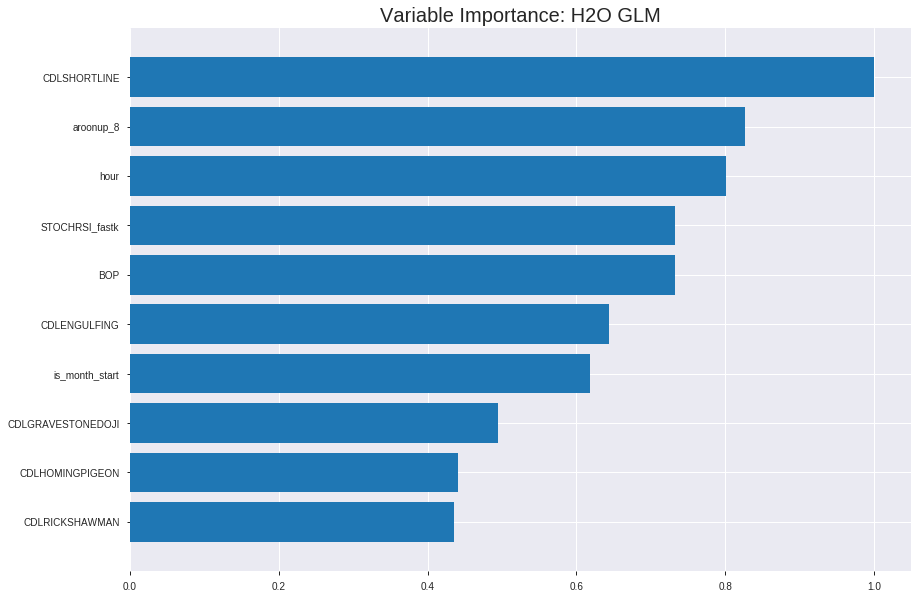

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_081649_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24836982429218807
RMSE: 0.4983671581195816
LogLoss: 0.6898824805369406
Null degrees of freedom: 4318
Residual degrees of freedom: 3385
Null deviance: 5986.754947319863
Residual deviance: 5959.204866878093
AIC: 7827.204866878093
AUC: 0.5583693529424129
pr_auc: 0.5509099632254683
Gini: 0.11673870588482571
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.45118675135706754: 


,0,1,Error,Rate
0,7.0,2179.0,0.9968,(2179.0/2186.0)
1,1.0,2132.0,0.0005,(1.0/2133.0)
Total,8.0,4311.0,0.5047,(2180.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4511868,0.6617008,393.0
max f2,0.4483516,0.8300903,396.0
max f0point5,0.4695589,0.5560161,340.0
max accuracy,0.4933300,0.5445705,209.0
max precision,0.5828778,1.0,0.0
max recall,0.4483516,1.0,396.0
max specificity,0.5828778,1.0,0.0
max absolute_mcc,0.5108556,0.0960796,111.0
max min_per_class_accuracy,0.4936412,0.5425435,207.0
max mean_per_class_accuracy,0.4933300,0.5446582,209.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5379126,1.3345587,1.3345587,0.6590909,0.5466020,0.6590909,0.5466020,0.0135959,0.0135959,33.4558667,33.4558667
,2,0.0201436,0.5316129,1.3185054,1.3266243,0.6511628,0.5341298,0.6551724,0.5404376,0.0131271,0.0267229,31.8505435,32.6624311
,3,0.0300996,0.5279928,1.4126844,1.3550903,0.6976744,0.5299427,0.6692308,0.5369662,0.0140647,0.0407876,41.2684395,35.5090339
,4,0.0400556,0.5246799,1.2714160,1.3342927,0.6279070,0.5263339,0.6589595,0.5343235,0.0126582,0.0534459,27.1415955,33.4292660
,5,0.0500116,0.5229627,1.0359686,1.2749041,0.5116279,0.5237463,0.6296296,0.5322178,0.0103141,0.0637600,3.5968556,27.4904065
,6,0.1000232,0.5163472,1.2092840,1.2420940,0.5972222,0.5194346,0.6134259,0.5258262,0.0604782,0.1242382,20.9284003,24.2094034
,7,0.1500347,0.5118006,1.1342896,1.2061592,0.5601852,0.5141359,0.5956790,0.5219294,0.0567276,0.1809658,13.4289646,20.6159238
,8,0.2000463,0.5083508,1.1061668,1.1811611,0.5462963,0.5099970,0.5833333,0.5189463,0.0553211,0.2362869,10.6166762,18.1161119
,9,0.3000695,0.5027993,1.0171110,1.1264777,0.5023148,0.5056126,0.5563272,0.5145018,0.1017346,0.3380216,1.7110964,12.6477734
,10,0.4000926,0.4979136,1.0030495,1.0956207,0.4953704,0.5002923,0.5410880,0.5109494,0.1003282,0.4383497,0.3049522,9.5620681




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.24959235610544206
RMSE: 0.4995921897962798
LogLoss: 0.6923317296383404
Null degrees of freedom: 1233
Residual degrees of freedom: 300
Null deviance: 1710.4803758483042
Residual deviance: 1708.6747087474241
AIC: 3576.674708747424
AUC: 0.520543842364532
pr_auc: 0.5215931665876472
Gini: 0.04108768472906399
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.44875101181618093: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4487510,0.6615970,397.0
max f2,0.4487510,0.8301527,397.0
max f0point5,0.4487510,0.5499368,397.0
max accuracy,0.4963162,0.5291734,135.0
max precision,0.5593444,1.0,0.0
max recall,0.4487510,1.0,397.0
max specificity,0.5593444,1.0,0.0
max absolute_mcc,0.5161880,0.0848711,33.0
max min_per_class_accuracy,0.4872976,0.5088,201.0
max mean_per_class_accuracy,0.4963162,0.5263934,135.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 48.71 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5241509,1.2469370,1.2469370,0.6153846,0.5336905,0.6153846,0.5336905,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.5202396,1.5197044,1.3778654,0.75,0.5214643,0.68,0.5278220,0.0147783,0.0279146,51.9704433,37.7865353
,3,0.0299838,0.5170764,1.1819923,1.3143390,0.5833333,0.5183830,0.6486486,0.5247607,0.0114943,0.0394089,18.1992337,31.4338970
,4,0.0405186,0.5159044,1.7145383,1.4183908,0.8461538,0.5165524,0.7,0.5226265,0.0180624,0.0574713,71.4538335,41.8390805
,5,0.0502431,0.5140609,0.8442802,1.3072726,0.4166667,0.5149452,0.6451613,0.5211398,0.0082102,0.0656814,-15.5719759,30.7272631
,6,0.1004862,0.5088829,0.8170454,1.0621590,0.4032258,0.5112501,0.5241935,0.5161950,0.0410509,0.1067323,-18.2954606,6.2159013
,7,0.1499190,0.5047144,1.0961802,1.0733768,0.5409836,0.5066338,0.5297297,0.5130424,0.0541872,0.1609195,9.6180247,7.3376825
,8,0.2001621,0.5009059,1.1438636,1.0910698,0.5645161,0.5027055,0.5384615,0.5104477,0.0574713,0.2183908,14.3863552,9.1069850
,9,0.2998379,0.4956933,1.0543207,1.0788532,0.5203252,0.4980037,0.5324324,0.5063109,0.1050903,0.3234811,5.4320691,7.8853237
,10,0.4003241,0.4908081,0.8987499,1.0336451,0.4435484,0.4930211,0.5101215,0.5029750,0.0903120,0.4137931,-10.1250066,3.3645121



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 08:17:15,0.000 sec,2,.27E1,934,1.3797650,1.3846635
,2019-12-08 08:17:18,2.284 sec,4,.2E1,937,1.3783517,1.3847884
,2019-12-08 08:17:20,4.624 sec,6,.14E1,937,1.3766759,1.3849111
,2019-12-08 08:17:22,6.882 sec,8,.1E1,937,1.3747459,1.3851804
,2019-12-08 08:17:25,9.161 sec,10,.75E0,945,1.3725697,1.3857078
,2019-12-08 08:17:27,11.450 sec,12,.55E0,945,1.3701720,1.3865706


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5429497568881686)

('F1', 0.6879659211927582)

('auc', 0.5299751479539184)

('logloss', 0.6941030186152913)

('mean_per_class_error', 0.4557928434531707)

('rmse', 0.5004761139840862)

('mse', 0.2504763406686121)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


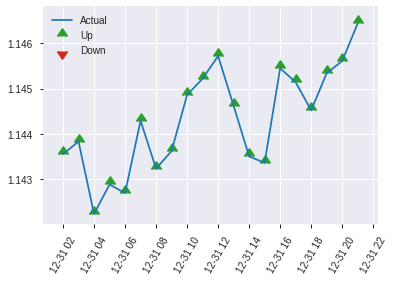


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.2504763406686121
RMSE: 0.5004761139840862
LogLoss: 0.6941030186152913
Null degrees of freedom: 616
Residual degrees of freedom: -317
Null deviance: 856.148314083962
Residual deviance: 856.5231249712696
AIC: 2724.5231249712697
AUC: 0.5299751479539184
pr_auc: 0.5543671007090404
Gini: 0.05995029590783685
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4483366774276998: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4483367,0.6879659,398.0
max f2,0.4483367,0.8464361,398.0
max f0point5,0.4483367,0.5794761,398.0
max accuracy,0.4740212,0.5429498,277.0
max precision,0.5420202,1.0,0.0
max recall,0.4483367,1.0,398.0
max specificity,0.5420202,1.0,0.0
max absolute_mcc,0.4861970,0.0889413,182.0
max min_per_class_accuracy,0.4830840,0.5068027,204.0
max mean_per_class_accuracy,0.4861970,0.5442072,182.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 48.35 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5223840,1.3644405,1.3644405,0.7142857,0.5277957,0.7142857,0.5277957,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.5170586,1.5918473,1.4693975,0.8333333,0.5202647,0.7692308,0.5243198,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.5140307,0.9551084,1.3069904,0.5,0.5152844,0.6842105,0.5214665,0.0092879,0.0402477,-4.4891641,30.6990386
,4,0.0405186,0.5118911,0.3183695,1.0697214,0.1666667,0.5127537,0.56,0.5193755,0.0030960,0.0433437,-68.1630547,6.9721362
,5,0.0502431,0.5102232,1.2734778,1.1091581,0.6666667,0.5108229,0.5806452,0.5177201,0.0123839,0.0557276,27.3477812,10.9158094
,6,0.1004862,0.5052854,1.1091581,1.1091581,0.5806452,0.5076844,0.5806452,0.5127022,0.0557276,0.1114551,10.9158094,10.9158094
,7,0.1507293,0.5012882,0.8626785,1.0269982,0.4516129,0.5031574,0.5376344,0.5095206,0.0433437,0.1547988,-13.7321482,2.6998236
,8,0.2009724,0.4968007,1.1707780,1.0629432,0.6129032,0.4988319,0.5564516,0.5068485,0.0588235,0.2136223,17.0777989,6.2943174
,9,0.2998379,0.4920355,1.0333959,1.0532006,0.5409836,0.4942409,0.5513514,0.5026914,0.1021672,0.3157895,3.3395930,5.3200569
,10,0.4003241,0.4879561,1.1091581,1.0672466,0.5806452,0.4898440,0.5587045,0.4994665,0.1114551,0.4272446,10.9158094,6.7246588


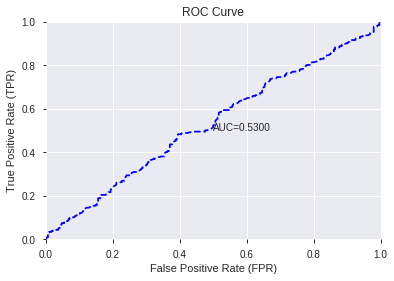

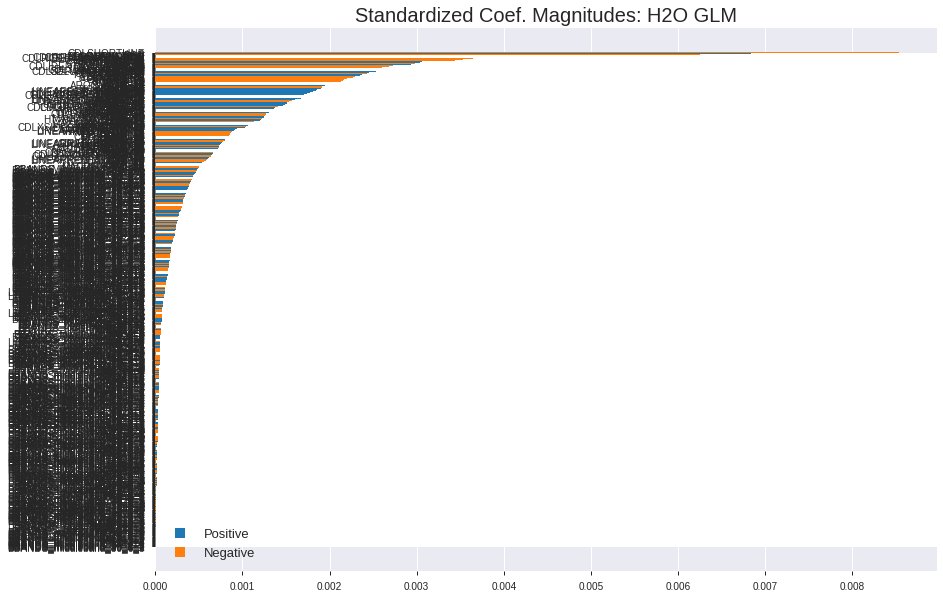

'log_likelihood'
--2019-12-08 08:18:54--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.217.39.20
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.217.39.20|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


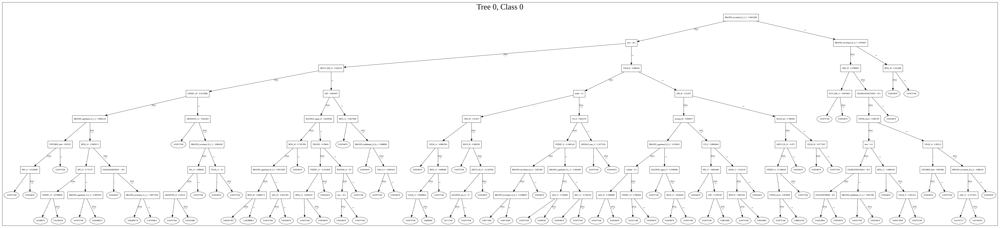

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_081649_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_081649_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_111_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_111

['CDLSHORTLINE',
 'aroonup_8',
 'hour',
 'STOCHRSI_fastk',
 'BOP',
 'CDLENGULFING',
 'is_month_start',
 'CDLGRAVESTONEDOJI',
 'CDLHOMINGPIGEON',
 'CDLRICKSHAWMAN',
 'CDLRISEFALL3METHODS',
 'STOCHF_fastk',
 'CDLONNECK',
 'CDLTHRUSTING',
 'Volume',
 'AROONOSC_8',
 'DX_14',
 'CDLHARAMI',
 'DX_20',
 'STDDEV_24',
 'STOCHRSI_fastd',
 'ADOSC',
 'DX_12',
 'aroondown_20',
 'DX_24',
 'CDLIDENTICAL3CROWS',
 'BETA_30',
 'is_month_end',
 'CDLDOJISTAR',
 'ULTOSC',
 'CDL3BLACKCROWS',
 'quarter',
 'days_in_month',
 'CORREL_20',
 'CDLSEPARATINGLINES',
 'CDLUNIQUE3RIVER',
 'SAREXT',
 'STDDEV_30',
 'CDL3OUTSIDE',
 'HT_DCPERIOD',
 'SUB',
 'DIV',
 'STDDEV_20',
 'CDLINNECK',
 'aroondown_30',
 'MFI_20',
 'CDLHAMMER',
 'ADXR_8',
 'TRANGE',
 'CORREL_24',
 'BETA_20',
 'aroonup_14',
 'CORREL_8',
 'MFI_8',
 'aroonup_12',
 'DX_30',
 'CCI_8',
 'NATR_14',
 'NATR_12',
 'AROONOSC_20',
 'ATR_12',
 'ATR_14',
 'BETA_24',
 'BETA_12',
 'aroondown_12',
 'dayofyear',
 'weekofyear',
 'week',
 'WILLR_8',
 'aroondown_24',
 'aro

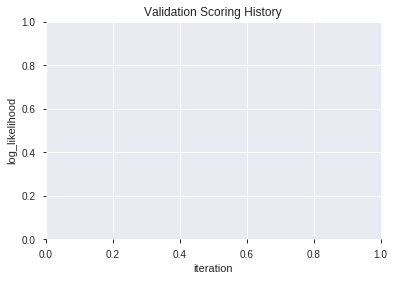

In [90]:
# All algos with Select Family-wise error features
model_train(feature_name='Fwe',model_algo=None,features_list=features_list)

In [91]:
# recursive feature elimination
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'RFE' in features_to_include:
  from sklearn.feature_selection import RFE
  from sklearn.svm import LinearSVC
  from sklearn.tree import DecisionTreeClassifier,ExtraTreeClassifier
  from sklearn.linear_model import LogisticRegression, LinearRegression

  bestfeatures = RFE(ExtraTreeClassifier(random_state=1,criterion='entropy'), n_features_to_select=select_rfe, step=1).fit(pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1)
                                                              ,pd.read_pickle('scaled_df')[:index_splits[0]][data_label_name])

  features_list = list(np.array(train_hf.columns)[:-1][bestfeatures.get_support()])

  del bestfeatures, RFE, LinearSVC, DecisionTreeClassifier,ExtraTreeClassifier, LogisticRegression, LinearRegression
  gc.collect()
  display(len(features_list),features_list)
else:
  features_list = []

50

['BBANDS_lowerband_8_4_4',
 'BBANDS_middleband_24_1_5',
 'BOP',
 'DX_8',
 'MACDFIX_hist_8',
 'MFI_8',
 'MINUS_DI_8',
 'MINUS_DM_8',
 'MOM_8',
 'PLUS_DM_8',
 'ROC_8',
 'ROCR_8',
 'WILLR_8',
 'aroonup_12',
 'AROONOSC_12',
 'CCI_12',
 'MFI_12',
 'ROC_12',
 'ADXR_14',
 'aroondown_14',
 'CCI_14',
 'WILLR_14',
 'ADX_20',
 'MOM_20',
 'ROCR100_20',
 'WILLR_20',
 'DX_24',
 'MFI_24',
 'MINUS_DI_24',
 'MOM_24',
 'RSI_24',
 'WILLR_24',
 'aroondown_30',
 'MACDEXT',
 'STOCH_slowk',
 'STOCHF_fastk',
 'STOCHRSI_fastk',
 'STOCHRSI_fastd',
 'ULTOSC',
 'ATR_8',
 'NATR_14',
 'TRANGE',
 'HT_PHASOR_inphase',
 'HT_PHASOR_quadrature',
 'BETA_8',
 'LINEARREG_ANGLE_8',
 'LINEARREG_SLOPE_8',
 'BETA_14',
 'STDDEV_14',
 'BETA_30']

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,DeepLearning_grid_1_AutoML_20191208_082021_model_3,0.549957,0.762273,0.498299,0.524368,0.274962
1,DeepLearning_grid_1_AutoML_20191208_082021_model_6,0.543454,0.690198,0.493197,0.498526,0.248528
2,DeepLearning_grid_1_AutoML_20191208_082021_model_7,0.539837,0.793262,0.500000,0.536288,0.287605
3,DeepLearning_1_AutoML_20191208_082021,0.538615,0.756037,0.498299,0.524086,0.274667
4,DeepLearning_grid_1_AutoML_20191208_082021_model_1,0.535751,0.926872,0.498299,0.556409,0.309591
5,DeepLearning_grid_1_AutoML_20191208_082021_model_8,0.531423,0.692350,0.496599,0.499616,0.249616
6,DeepLearning_grid_1_AutoML_20191208_082021_model_4,0.526416,0.706520,0.493045,0.505867,0.255901
7,DeepLearning_grid_1_AutoML_20191208_082021_model_5,0.512910,0.707691,0.489491,0.507161,0.257212
8,DeepLearning_grid_1_AutoML_20191208_082021_model_2,0.512853,0.967918,0.494745,0.572003,0.327187
9,DeepLearning_grid_1_AutoML_20191208_082021_model_9,0.509093,0.691824,0.496599,0.499338,0.249338


,variable,relative_importance,scaled_importance,percentage
0,BBANDS_middleband_24_1_5,1.000000,1.000000,0.027049
1,BBANDS_lowerband_8_4_4,0.956360,0.956360,0.025868
2,aroonup_12,0.881422,0.881422,0.023841
3,STOCHRSI_fastk,0.870935,0.870935,0.023558
4,aroondown_14,0.860092,0.860092,0.023264
5,BETA_30,0.845683,0.845683,0.022875
6,DX_8,0.833067,0.833067,0.022533
7,ADX_20,0.823603,0.823603,0.022277
8,BOP,0.820048,0.820048,0.022181
9,aroondown_30,0.819163,0.819163,0.022157


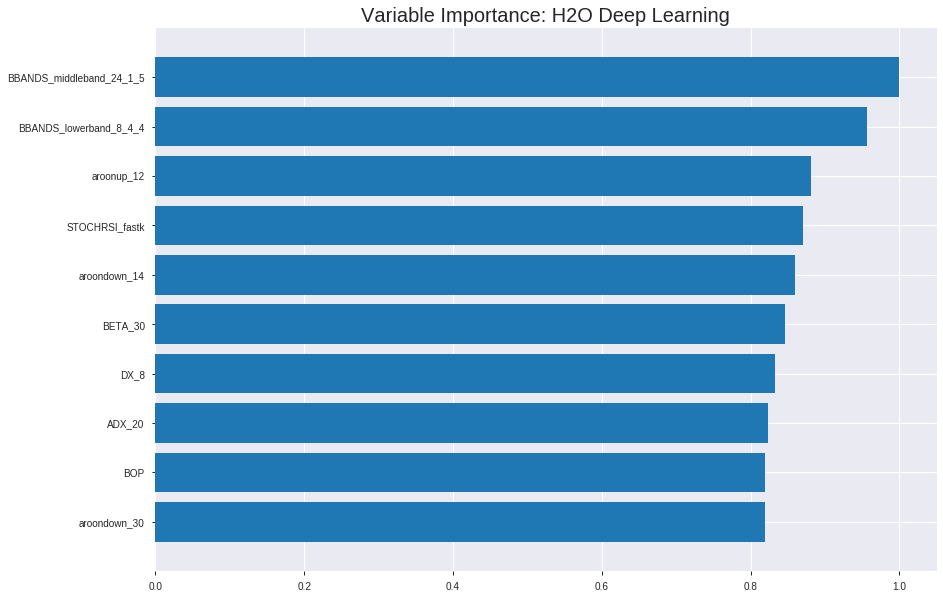

Model Details
H2ODeepLearningEstimator :  Deep Learning
Model Key:  DeepLearning_grid_1_AutoML_20191208_082021_model_3


ModelMetricsBinomial: deeplearning
** Reported on train data. **

MSE: 0.28430813638018904
RMSE: 0.5332055292100684
LogLoss: 0.7875859952814664
Mean Per-Class Error: 0.4727397293178386
AUC: 0.5349235792360626
pr_auc: 0.5220775744580587
Gini: 0.06984715847212519
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.021308018447316265: 


,0,1,Error,Rate
0,1.0,2185.0,0.9995,(2185.0/2186.0)
1,0.0,2133.0,0.0,(0.0/2133.0)
Total,1.0,4318.0,0.5059,(2185.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0213080,0.6612928,398.0
max f2,0.0213080,0.8299611,398.0
max f0point5,0.2255967,0.5506128,316.0
max accuracy,0.5798865,0.5304469,127.0
max precision,0.8982708,0.5957447,15.0
max recall,0.0213080,1.0,398.0
max specificity,0.9938863,0.9990851,0.0
max absolute_mcc,0.5798865,0.0654113,127.0
max min_per_class_accuracy,0.3964109,0.5222691,222.0
max mean_per_class_accuracy,0.5455108,0.5272603,144.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 41.65 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.9014903,1.1504816,1.1504816,0.5681818,0.9336414,0.5681818,0.9336414,0.0117206,0.0117206,15.0481609,15.0481609
,2,0.0201436,0.8590475,1.0830580,1.1171573,0.5348837,0.8802937,0.5517241,0.9072742,0.0107829,0.0225035,8.3058036,11.7157314
,3,0.0300996,0.8325046,1.0830580,1.1058783,0.5348837,0.8460937,0.5461538,0.8870375,0.0107829,0.0332865,8.3058036,10.5878322
,4,0.0400556,0.8061527,1.1772370,1.1236149,0.5813953,0.8212323,0.5549133,0.8706813,0.0117206,0.0450070,17.7236996,12.3614871
,5,0.0500116,0.7883557,0.9417896,1.0874182,0.4651163,0.7978324,0.5370370,0.8561790,0.0093765,0.0543835,-5.8210404,8.7418173
,6,0.1000232,0.7141043,1.0592953,1.0733567,0.5231481,0.7505835,0.5300926,0.8033813,0.0529770,0.1073605,5.9295289,7.3356731
,7,0.1500347,0.6443723,1.1999097,1.1155411,0.5925926,0.6769771,0.5509259,0.7612465,0.0600094,0.1673699,19.9909708,11.5541057
,8,0.2000463,0.5930052,1.0874182,1.1085103,0.5370370,0.6190773,0.5474537,0.7257042,0.0543835,0.2217534,8.7418173,10.8510336
,9,0.3000695,0.5147285,1.0124238,1.0764815,0.5,0.5524299,0.5316358,0.6679461,0.1012658,0.3230192,1.2423816,7.6481496
,10,0.4000926,0.4492269,1.0358596,1.0663260,0.5115741,0.4805381,0.5266204,0.6210941,0.1036099,0.4266292,3.5859553,6.6326010




ModelMetricsBinomial: deeplearning
** Reported on validation data. **

MSE: 0.283349393895828
RMSE: 0.5323057334801382
LogLoss: 0.7893803762510718
Mean Per-Class Error: 0.45592643678160916
AUC: 0.5319133004926109
pr_auc: 0.5149378036122448
Gini: 0.06382660098522175
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.06907908313938098: 


,0,1,Error,Rate
0,0.0,625.0,1.0,(625.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,0.0,1234.0,0.5065,(625.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0690791,0.6608790,399.0
max f2,0.0690791,0.8297003,399.0
max f0point5,0.0690791,0.5491434,399.0
max accuracy,0.4912108,0.5445705,200.0
max precision,0.9498891,0.6470588,7.0
max recall,0.0690791,1.0,399.0
max specificity,0.9686145,0.9968,0.0
max absolute_mcc,0.4899573,0.0884077,201.0
max min_per_class_accuracy,0.4683749,0.5369458,214.0
max mean_per_class_accuracy,0.4899573,0.5440736,201.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 48.91 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.9522200,1.2469370,1.2469370,0.6153846,0.9592825,0.6153846,0.9592825,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.9314319,1.0131363,1.1347126,0.5,0.9432406,0.56,0.9515824,0.0098522,0.0229885,1.3136289,13.4712644
,3,0.0299838,0.9165279,1.0131363,1.0952825,0.5,0.9248466,0.5405405,0.9429113,0.0098522,0.0328407,1.3136289,9.5282475
,4,0.0405186,0.8920080,1.0910698,1.0941872,0.5384615,0.9048922,0.54,0.9330263,0.0114943,0.0443350,9.1069850,9.4187192
,5,0.0502431,0.8798044,0.8442802,1.0458181,0.4166667,0.8865970,0.5161290,0.9240400,0.0082102,0.0525452,-15.5719759,4.5818105
,6,0.1004862,0.7936087,1.0458181,1.0458181,0.5161290,0.8312219,0.5161290,0.8776310,0.0525452,0.1050903,4.5818105,4.5818105
,7,0.1499190,0.7238769,1.0629627,1.0514712,0.5245902,0.7509318,0.5189189,0.8358545,0.0525452,0.1576355,6.2962664,5.1471176
,8,0.2001621,0.6796503,1.0458181,1.0500522,0.5161290,0.7032406,0.5182186,0.8025668,0.0525452,0.2101806,4.5818105,5.0052186
,9,0.2998379,0.6004428,1.0707945,1.0569476,0.5284553,0.6403893,0.5216216,0.7486537,0.1067323,0.3169130,7.0794452,5.6947588
,10,0.4003241,0.5289582,1.1275226,1.0746628,0.5564516,0.5676568,0.5303644,0.7032213,0.1133005,0.4302135,12.7522644,7.4662784



Scoring History: 


,timestamp,duration,training_speed,epochs,iterations,samples,training_rmse,training_logloss,training_r2,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_r2,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:21:48,0.000 sec,None,0.0,0,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
,2019-12-08 08:21:51,1 min 29.290 sec,13620 obs/sec,10.0,1,43190.0,0.5332055,0.7875860,-0.1374038,0.5349236,0.5220776,1.1504816,0.5059041,0.5323057,0.7893804,-0.1335882,0.5319133,0.5149378,1.2469370,0.5064830
,2019-12-08 08:21:57,1 min 35.331 sec,18999 obs/sec,40.0,4,172760.0,0.5103043,0.7347758,-0.0417987,0.5995900,0.5757757,1.3345587,0.4943274,0.5515851,0.8609898,-0.2171890,0.5103645,0.5064920,1.2469370,0.5048622
,2019-12-08 08:22:03,1 min 41.056 sec,23477 obs/sec,80.0,8,345520.0,0.4861909,0.6780775,0.0543314,0.6785042,0.6464339,1.5186357,0.4107432,0.5516017,0.8700019,-0.2172624,0.5257616,0.5188591,1.2469370,0.5040519
,2019-12-08 08:22:09,1 min 46.969 sec,27351 obs/sec,130.0,13,561470.0,0.4391860,0.5665732,0.2283465,0.7761438,0.7692953,2.0248476,0.3123408,0.5477881,0.8447090,-0.2004890,0.5173504,0.5139700,0.7793356,0.5064830
,2019-12-08 08:22:14,1 min 52.587 sec,28370 obs/sec,170.0,17,734230.0,0.4242307,0.5352362,0.2800049,0.8067483,0.8015704,2.0248476,0.2877981,0.5559500,0.8955396,-0.2365293,0.5250417,0.5228514,1.2469370,0.5048622
,2019-12-08 08:22:20,1 min 57.692 sec,30782 obs/sec,220.0,22,950180.0,0.4098239,0.5064340,0.3280763,0.8310733,0.8254811,1.9788284,0.2583931,0.5730331,0.9923749,-0.3136884,0.5133412,0.5069080,1.2469370,0.5064830
,2019-12-08 08:22:20,1 min 57.798 sec,30777 obs/sec,220.0,22,950180.0,0.5332055,0.7875860,-0.1374038,0.5349236,0.5220776,1.1504816,0.5059041,0.5323057,0.7893804,-0.1335882,0.5319133,0.5149378,1.2469370,0.5064830


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BBANDS_middleband_24_1_5,1.0,1.0,0.0270488
BBANDS_lowerband_8_4_4,0.9563600,0.9563600,0.0258684
aroonup_12,0.8814217,0.8814217,0.0238414
STOCHRSI_fastk,0.8709345,0.8709345,0.0235577
aroondown_14,0.8600923,0.8600923,0.0232645
---,---,---,---
MINUS_DI_8,0.6437800,0.6437800,0.0174135
LINEARREG_SLOPE_8,0.6419040,0.6419040,0.0173627
ROC_8,0.6330666,0.6330666,0.0171237
MOM_24,0.6290767,0.6290767,0.0170158



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5672609400324149)

('F1', 0.6879659211927582)

('auc', 0.5499568248351973)

('logloss', 0.7622734665360638)

('mean_per_class_error', 0.43881236705208404)

('rmse', 0.5243679836421857)

('mse', 0.2749617822689716)

deeplearning prediction progress: |███████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


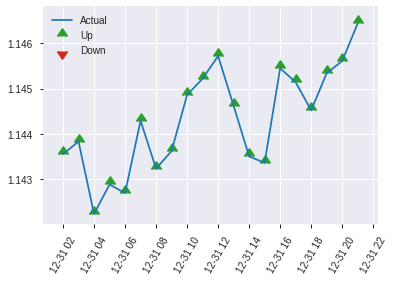


ModelMetricsBinomial: deeplearning
** Reported on test data. **

MSE: 0.2749617822689716
RMSE: 0.5243679836421857
LogLoss: 0.7622734665360638
Mean Per-Class Error: 0.43881236705208404
AUC: 0.5499568248351973
pr_auc: 0.5562363554387758
Gini: 0.09991364967039451
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.09855189790428427: 


,0,1,Error,Rate
0,1.0,293.0,0.9966,(293.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,1.0,616.0,0.4749,(293.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.0985519,0.6879659,398.0
max f2,0.0985519,0.8464361,398.0
max f0point5,0.3073962,0.5951850,312.0
max accuracy,0.3886134,0.5672609,257.0
max precision,0.9740166,1.0,0.0
max recall,0.0985519,1.0,398.0
max specificity,0.9740166,1.0,0.0
max absolute_mcc,0.3886134,0.1267428,257.0
max min_per_class_accuracy,0.4551433,0.5442177,209.0
max mean_per_class_accuracy,0.3886134,0.5611876,257.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 47.26 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.9362004,1.6373286,1.6373286,0.8571429,0.9579657,0.8571429,0.9579657,0.0185759,0.0185759,63.7328616,63.7328616
,2,0.0210697,0.9238800,0.3183695,1.0285782,0.1666667,0.9303827,0.5384615,0.9452350,0.0030960,0.0216718,-68.1630547,2.8578233
,3,0.0307942,0.9057307,0.6367389,0.9048395,0.3333333,0.9163471,0.4736842,0.9361125,0.0061920,0.0278638,-36.3261094,-9.5160502
,4,0.0405186,0.8755072,0.9551084,0.9169040,0.5,0.8897484,0.48,0.9249851,0.0092879,0.0371517,-4.4891641,-8.3095975
,5,0.0502431,0.8328622,1.2734778,0.9859183,0.6666667,0.8575338,0.5161290,0.9119300,0.0123839,0.0495356,27.3477812,-1.4081694
,6,0.1004862,0.7581043,1.1707780,1.0783481,0.6129032,0.7844191,0.5645161,0.8481746,0.0588235,0.1083591,17.0777989,7.8348147
,7,0.1507293,0.6943400,1.1707780,1.1091581,0.6129032,0.7230660,0.5806452,0.8064717,0.0588235,0.1671827,17.0777989,10.9158094
,8,0.2009724,0.6441376,0.9242984,1.0629432,0.4838710,0.6690121,0.5564516,0.7721068,0.0464396,0.2136223,-7.5701588,6.2943174
,9,0.2998379,0.5499008,0.9707659,1.0325496,0.5081967,0.5898664,0.5405405,0.7120167,0.0959752,0.3095975,-2.9234127,3.2549577
,10,0.4003241,0.5040852,1.1399680,1.0595129,0.5967742,0.5264542,0.5546559,0.6654383,0.1145511,0.4241486,13.9968042,5.9512917


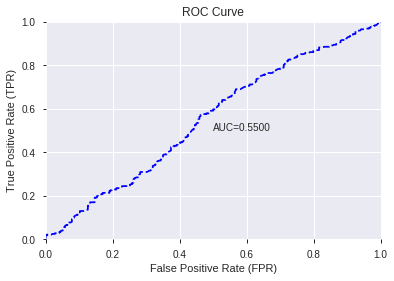

This function is available for GLM models only


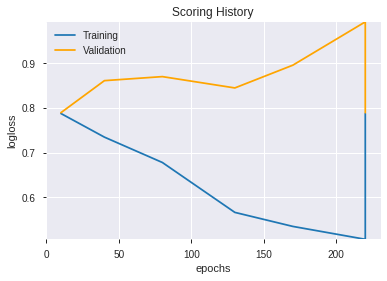

--2019-12-08 08:28:31--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.140.68
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.140.68|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


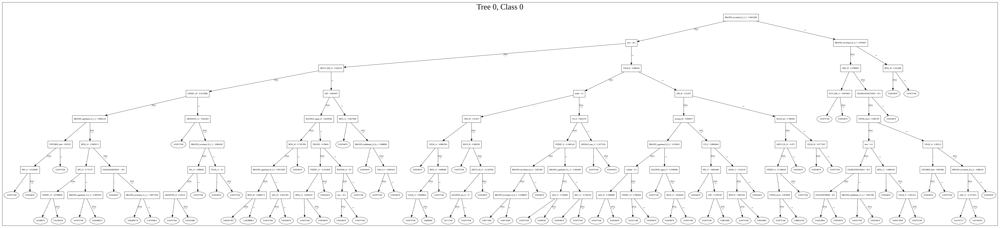

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/DeepLearning_grid_1_AutoML_20191208_082021_model_3',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'DeepLearning_grid_1_AutoML_20191208_082021_model_3',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_116_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'auto

['BBANDS_middleband_24_1_5',
 'BBANDS_lowerband_8_4_4',
 'aroonup_12',
 'STOCHRSI_fastk',
 'aroondown_14',
 'BETA_30',
 'DX_8',
 'ADX_20',
 'BOP',
 'aroondown_30',
 'BETA_14',
 'DX_24',
 'STOCHRSI_fastd',
 'STOCH_slowk',
 'ADXR_14',
 'MFI_8',
 'STDDEV_14',
 'BETA_8',
 'HT_PHASOR_quadrature',
 'AROONOSC_12',
 'NATR_14',
 'STOCHF_fastk',
 'ATR_8',
 'PLUS_DM_8',
 'MACDFIX_hist_8',
 'MFI_12',
 'MFI_24',
 'MINUS_DI_24',
 'MINUS_DM_8',
 'HT_PHASOR_inphase',
 'WILLR_8',
 'WILLR_20',
 'TRANGE',
 'ROCR_8',
 'ULTOSC',
 'MACDEXT',
 'WILLR_24',
 'MOM_20',
 'WILLR_14',
 'RSI_24',
 'MOM_8',
 'CCI_14',
 'ROC_12',
 'ROCR100_20',
 'CCI_12',
 'MINUS_DI_8',
 'LINEARREG_SLOPE_8',
 'ROC_8',
 'MOM_24',
 'LINEARREG_ANGLE_8']

In [92]:
# DeepLearning with recursive feature elimination
model_train(feature_name='RFE',model_algo="DeepLearning",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GLM_grid_1_AutoML_20191208_082928_model_1,0.534214,0.693212,0.5,0.500032,0.250032


,variable,relative_importance,scaled_importance,percentage
0,STOCHRSI_fastk,0.007349,1.000000,0.079349
1,BOP,0.007213,0.981497,0.077881
2,DX_24,0.004779,0.650276,0.051599
3,NATR_14,0.004530,0.616399,0.048911
4,STOCHF_fastk,0.004384,0.596475,0.047330
5,STDDEV_14,0.003949,0.537266,0.042632
6,ATR_8,0.003769,0.512879,0.040697
7,STOCHRSI_fastd,0.003737,0.508481,0.040348
8,BETA_30,0.003532,0.480617,0.038137
9,DX_8,0.003148,0.428392,0.033993


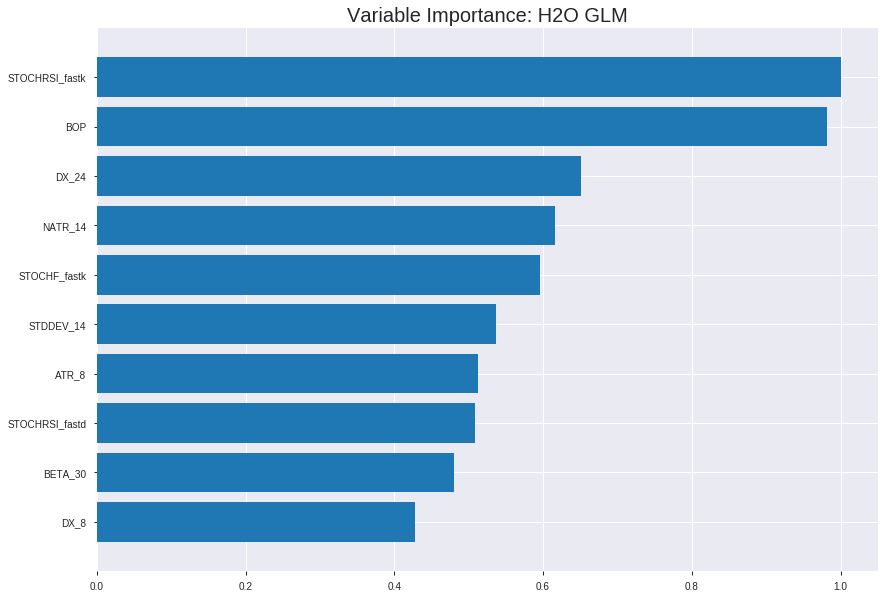

Model Details
H2OGeneralizedLinearEstimator :  Generalized Linear Modeling
Model Key:  GLM_grid_1_AutoML_20191208_082928_model_1


ModelMetricsBinomialGLM: glm
** Reported on train data. **

MSE: 0.24946963465315677
RMSE: 0.49946935306698925
LogLoss: 0.6920860390485404
Null degrees of freedom: 4318
Residual degrees of freedom: 4268
Null deviance: 5986.754947319863
Residual deviance: 5978.239205301291
AIC: 6080.239205301291
AUC: 0.5347953284100457
pr_auc: 0.5211873865388152
Gini: 0.06959065682009147
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.47134711060386153: 


,0,1,Error,Rate
0,2.0,2184.0,0.9991,(2184.0/2186.0)
1,0.0,2133.0,0.0,(0.0/2133.0)
Total,2.0,4317.0,0.5057,(2184.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4713471,0.6613953,398.0
max f2,0.4713471,0.8300257,398.0
max f0point5,0.4824824,0.5520706,328.0
max accuracy,0.4926064,0.5269738,223.0
max precision,0.5153436,0.6229508,31.0
max recall,0.4713471,1.0,398.0
max specificity,0.5356567,0.9995425,0.0
max absolute_mcc,0.4899183,0.0583947,253.0
max min_per_class_accuracy,0.4935348,0.5264885,214.0
max mean_per_class_accuracy,0.4899183,0.5281473,253.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.5162781,1.1044623,1.1044623,0.5454545,0.5214539,0.5454545,0.5214539,0.0112518,0.0112518,10.4462345,10.4462345
,2,0.0201436,0.5142062,1.3185054,1.2102538,0.6511628,0.5150962,0.5977011,0.5183116,0.0131271,0.0243788,31.8505435,21.0253757
,3,0.0300996,0.5127195,1.0830580,1.1681813,0.5348837,0.5134168,0.5769231,0.5166925,0.0107829,0.0351617,8.3058036,16.8181326
,4,0.0400556,0.5116636,0.9888791,1.1236149,0.4883721,0.5121441,0.5549133,0.5155620,0.0098453,0.0450070,-1.1120924,12.3614871
,5,0.0500116,0.5106962,1.0359686,1.1061668,0.5116279,0.5111834,0.5462963,0.5146903,0.0103141,0.0553211,3.5968556,10.6166762
,6,0.1000232,0.5071014,1.1061668,1.1061668,0.5462963,0.5087845,0.5462963,0.5117374,0.0553211,0.1106423,10.6166762,10.6166762
,7,0.1500347,0.5042887,1.0686696,1.0936677,0.5277778,0.5056471,0.5401235,0.5097073,0.0534459,0.1640881,6.8669584,9.3667703
,8,0.2000463,0.5022099,1.0592953,1.0850746,0.5231481,0.5032281,0.5358796,0.5080875,0.0529770,0.2170652,5.9295289,8.5074599
,9,0.3000695,0.4988596,0.9983624,1.0561705,0.4930556,0.5005105,0.5216049,0.5055618,0.0998594,0.3169245,-0.1637626,5.6170524
,10,0.4000926,0.4960505,1.0499210,1.0546081,0.5185185,0.4974677,0.5208333,0.5035383,0.1050164,0.4219409,4.9920995,5.4608142




ModelMetricsBinomialGLM: glm
** Reported on validation data. **

MSE: 0.24965043838472353
RMSE: 0.4996503161058977
LogLoss: 0.6924477896847594
Null degrees of freedom: 1233
Residual degrees of freedom: 1183
Null deviance: 1710.4803758483042
Residual deviance: 1708.9611449419863
AIC: 1810.9611449419863
AUC: 0.5237819376026273
pr_auc: 0.5166596961334263
Gini: 0.04756387520525451
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.47288593638267146: 


,0,1,Error,Rate
0,1.0,624.0,0.9984,(624.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,1.0,1233.0,0.5057,(624.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4728859,0.6612378,398.0
max f2,0.4728859,0.8299264,398.0
max f0point5,0.4811981,0.5510406,348.0
max accuracy,0.4905752,0.5340357,245.0
max precision,0.5199331,1.0,0.0
max recall,0.4728859,1.0,398.0
max specificity,0.5199331,1.0,0.0
max absolute_mcc,0.4905752,0.0728716,245.0
max min_per_class_accuracy,0.4931701,0.5216,215.0
max mean_per_class_accuracy,0.4905752,0.5355021,245.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 49.34 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.5153291,1.4028041,1.4028041,0.6923077,0.5170497,0.6923077,0.5170497,0.0147783,0.0147783,40.2804092,40.2804092
,2,0.0202593,0.5135599,1.0131363,1.2157635,0.5,0.5142363,0.6,0.5156992,0.0098522,0.0246305,1.3136289,21.5763547
,3,0.0299838,0.5122566,1.3508484,1.2595748,0.6666667,0.5127991,0.6216216,0.5147587,0.0131363,0.0377668,35.0848385,25.9574846
,4,0.0405186,0.5110295,1.2469370,1.2562890,0.6153846,0.5116085,0.62,0.5139396,0.0131363,0.0509031,24.6936971,25.6288998
,5,0.0502431,0.5104354,0.8442802,1.1765454,0.4166667,0.5107117,0.5806452,0.5133149,0.0082102,0.0591133,-15.5719759,17.6545368
,6,0.1004862,0.5069002,0.9804545,1.0784999,0.4838710,0.5085883,0.5322581,0.5109516,0.0492611,0.1083744,-1.9545527,7.8499921
,7,0.1499190,0.5033132,0.9965275,1.0514712,0.4918033,0.5047260,0.5189189,0.5088988,0.0492611,0.1576355,-0.3472503,5.1471176
,8,0.2001621,0.5013824,0.8497272,1.0008310,0.4193548,0.5023803,0.4939271,0.5072626,0.0426929,0.2003284,-15.0272790,0.0830990
,9,0.2998379,0.4985609,1.0872682,1.0295655,0.5365854,0.4999283,0.5081081,0.5048244,0.1083744,0.3087028,8.7268213,2.9565526
,10,0.4003241,0.4958427,1.0131363,1.0254416,0.5,0.4971681,0.5060729,0.5029026,0.1018062,0.4105090,1.3136289,2.5441588



Scoring History: 


,timestamp,duration,iteration,lambda,predictors,deviance_train,deviance_test
,2019-12-08 08:29:29,0.000 sec,2,.25E1,51,1.3841721,1.3848956
,2019-12-08 08:29:29,0.011 sec,3,.16E1,51,1.3835328,1.3849234
,2019-12-08 08:29:29,0.025 sec,5,.98E0,51,1.3827706,1.3851238
,2019-12-08 08:29:29,0.040 sec,7,.61E0,51,1.3818973,1.3855010
,2019-12-08 08:29:29,0.054 sec,9,.38E0,51,1.3809298,1.3860538
,2019-12-08 08:29:29,0.068 sec,11,.23E0,51,1.3798871,1.3867484


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.546191247974068)

('F1', 0.6872340425531915)

('auc', 0.5342136854741897)

('logloss', 0.6932115835153483)

('mean_per_class_error', 0.4598523619974306)

('rmse', 0.5000322121574858)

('mse', 0.2500322131951089)

glm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


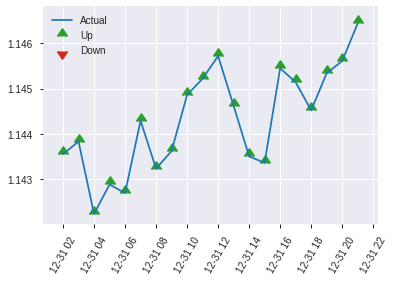


ModelMetricsBinomialGLM: glm
** Reported on test data. **

MSE: 0.2500322131951089
RMSE: 0.5000322121574858
LogLoss: 0.6932115835153483
Null degrees of freedom: 616
Residual degrees of freedom: 566
Null deviance: 856.148314083962
Residual deviance: 855.4230940579397
AIC: 957.4230940579397
AUC: 0.5342136854741897
pr_auc: 0.5560833835396237
Gini: 0.06842737094837936
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.47328870078201546: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4732887,0.6872340,399.0
max f2,0.4732887,0.8459927,399.0
max f0point5,0.4810866,0.5831622,332.0
max accuracy,0.4873596,0.5461912,251.0
max precision,0.5177788,1.0,0.0
max recall,0.4732887,1.0,399.0
max specificity,0.5177788,1.0,0.0
max absolute_mcc,0.5146008,0.1093475,7.0
max min_per_class_accuracy,0.4907967,0.5170279,204.0
max mean_per_class_accuracy,0.4873596,0.5401476,251.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 49.15 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.5146688,1.9102167,1.9102167,1.0,0.5154142,1.0,0.5154142,0.0216718,0.0216718,91.0216718,91.0216718
,2,0.0210697,0.5125606,0.9551084,1.4693975,0.5,0.5135682,0.7692308,0.5145622,0.0092879,0.0309598,-4.4891641,46.9397476
,3,0.0307942,0.5108361,0.9551084,1.3069904,0.5,0.5114179,0.6842105,0.5135693,0.0092879,0.0402477,-4.4891641,30.6990386
,4,0.0405186,0.5104690,0.9551084,1.2225387,0.5,0.5105995,0.64,0.5128565,0.0092879,0.0495356,-4.4891641,22.2538700
,5,0.0502431,0.5093054,0.6367389,1.1091581,0.3333333,0.5099442,0.5806452,0.5122928,0.0061920,0.0557276,-36.3261094,10.9158094
,6,0.1004862,0.5047597,0.9859183,1.0475382,0.5161290,0.5065722,0.5483871,0.5094325,0.0495356,0.1052632,-1.4081694,4.7538200
,7,0.1507293,0.5021022,0.9859183,1.0269982,0.5161290,0.5032869,0.5376344,0.5073840,0.0495356,0.1547988,-1.4081694,2.6998236
,8,0.2009724,0.4994388,1.1707780,1.0629432,0.6129032,0.5005298,0.5564516,0.5056704,0.0588235,0.2136223,17.0777989,6.2943174
,9,0.2998379,0.4961741,1.0647110,1.0635261,0.5573770,0.4977845,0.5567568,0.5030702,0.1052632,0.3188854,6.4710958,6.3526065
,10,0.4003241,0.4933207,1.0783481,1.0672466,0.5645161,0.4948147,0.5587045,0.5009980,0.1083591,0.4272446,7.8348147,6.7246588


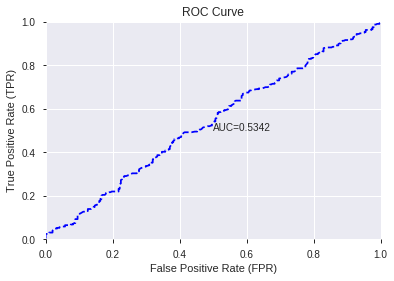

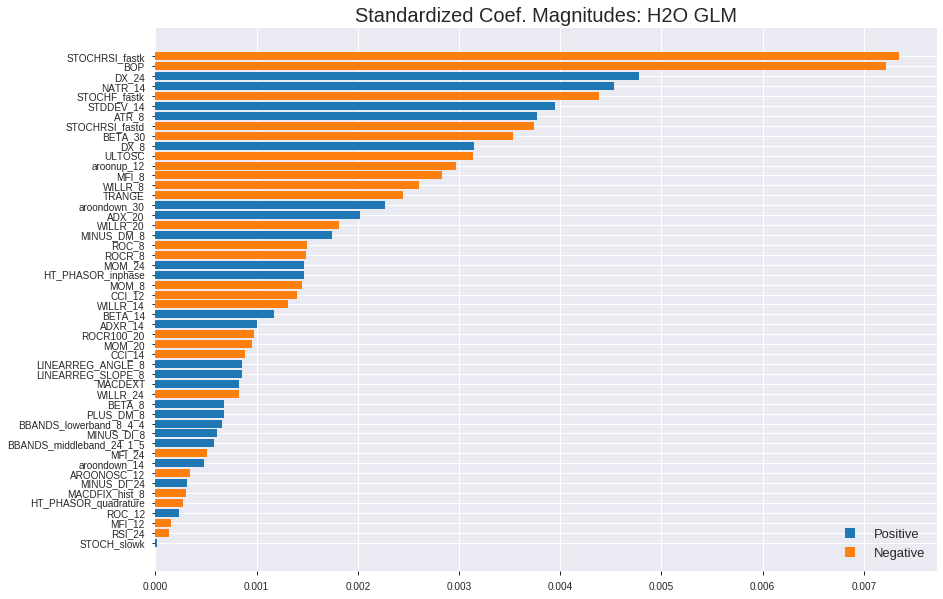

'log_likelihood'
--2019-12-08 08:29:38--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 54.231.82.18
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|54.231.82.18|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
ERROR: Unknown MOJO type


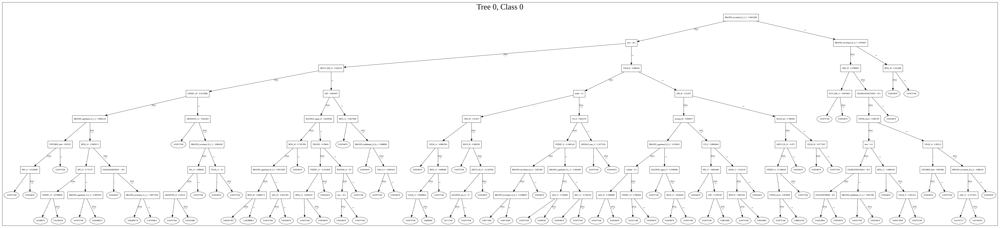

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GLM_grid_1_AutoML_20191208_082928_model_1',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GLM_grid_1_AutoML_20191208_082928_model_1',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_121_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_121

['STOCHRSI_fastk',
 'BOP',
 'DX_24',
 'NATR_14',
 'STOCHF_fastk',
 'STDDEV_14',
 'ATR_8',
 'STOCHRSI_fastd',
 'BETA_30',
 'DX_8',
 'ULTOSC',
 'aroonup_12',
 'MFI_8',
 'WILLR_8',
 'TRANGE',
 'aroondown_30',
 'ADX_20',
 'WILLR_20',
 'MINUS_DM_8',
 'ROC_8',
 'ROCR_8',
 'MOM_24',
 'HT_PHASOR_inphase',
 'MOM_8',
 'CCI_12',
 'WILLR_14',
 'BETA_14',
 'ADXR_14',
 'ROCR100_20',
 'MOM_20',
 'CCI_14',
 'LINEARREG_ANGLE_8',
 'LINEARREG_SLOPE_8',
 'MACDEXT',
 'WILLR_24',
 'BETA_8',
 'PLUS_DM_8',
 'BBANDS_lowerband_8_4_4',
 'MINUS_DI_8',
 'BBANDS_middleband_24_1_5',
 'MFI_24',
 'aroondown_14',
 'AROONOSC_12',
 'MINUS_DI_24',
 'MACDFIX_hist_8',
 'HT_PHASOR_quadrature',
 'ROC_12',
 'MFI_12',
 'RSI_24',
 'STOCH_slowk']

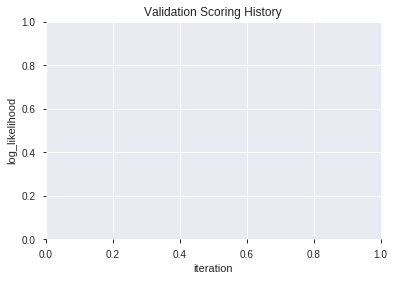

In [93]:
# GLM with recursive feature elimination
model_train(feature_name='RFE',model_algo="GLM",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,XGBoost_grid_1_AutoML_20191208_083036_model_6,0.559497,0.685601,0.474969,0.496248,0.246262
1,XGBoost_grid_1_AutoML_20191208_083036_model_1,0.557539,0.689200,0.500000,0.497978,0.247982
2,XGBoost_3_AutoML_20191208_083036,0.552784,0.688604,0.494745,0.497719,0.247724
3,XGBoost_grid_1_AutoML_20191208_083036_model_4,0.550241,0.688550,0.485784,0.497697,0.247703
4,XGBoost_grid_1_AutoML_20191208_083036_model_2,0.547614,0.689643,0.500000,0.498237,0.248240
5,XGBoost_grid_1_AutoML_20191208_083036_model_5,0.544734,0.700051,0.479286,0.503172,0.253182
6,XGBoost_1_AutoML_20191208_083036,0.533898,0.695849,0.496293,0.501181,0.251183
7,XGBoost_grid_1_AutoML_20191208_083036_model_7,0.509288,0.704412,0.500000,0.505291,0.255319
8,XGBoost_grid_1_AutoML_20191208_083036_model_3,0.507282,0.696852,0.488095,0.501771,0.251774
9,XGBoost_2_AutoML_20191208_083036,0.505681,0.703532,0.496599,0.504954,0.254978


,variable,relative_importance,scaled_importance,percentage
0,BETA_30,414.560852,1.000000,0.047735
1,BOP,315.404541,0.760816,0.036318
2,MFI_8,304.978760,0.735667,0.035117
3,BETA_14,283.247650,0.683247,0.032615
4,TRANGE,282.679077,0.681876,0.032550
5,BBANDS_middleband_24_1_5,264.141510,0.637160,0.030415
6,HT_PHASOR_inphase,258.680695,0.623987,0.029786
7,STDDEV_14,251.085327,0.605666,0.028912
8,MOM_24,248.038666,0.598317,0.028561
9,HT_PHASOR_quadrature,246.729401,0.595158,0.028410


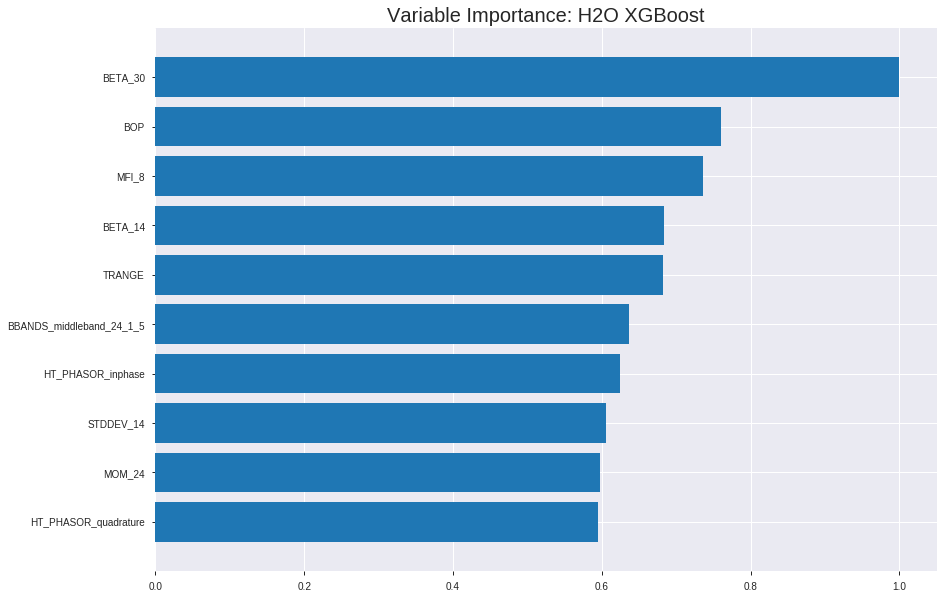

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_grid_1_AutoML_20191208_083036_model_6


ModelMetricsBinomial: xgboost
** Reported on train data. **

MSE: 0.214088735764189
RMSE: 0.46269723984933064
LogLoss: 0.6202811710666744
Mean Per-Class Error: 0.22633043074691317
AUC: 0.8532192887526598
pr_auc: 0.8474289372996902
Gini: 0.7064385775053197
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.48704201231400174: 


,0,1,Error,Rate
0,1589.0,597.0,0.2731,(597.0/2186.0)
1,383.0,1750.0,0.1796,(383.0/2133.0)
Total,1972.0,2347.0,0.2269,(980.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4870420,0.7812500,216.0
max f2,0.4475879,0.8646107,275.0
max f0point5,0.5079904,0.7816984,183.0
max accuracy,0.4875042,0.7730956,215.0
max precision,0.7177968,1.0,0.0
max recall,0.3661508,1.0,362.0
max specificity,0.7177968,1.0,0.0
max absolute_mcc,0.4870420,0.5493726,216.0
max min_per_class_accuracy,0.4944658,0.7698994,204.0
max mean_per_class_accuracy,0.4870420,0.7736696,216.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.42 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6552308,2.0248476,2.0248476,1.0,0.6741462,1.0,0.6741462,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.6388631,2.0248476,2.0248476,1.0,0.6471509,1.0,0.6608037,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.6240402,1.9777582,2.0092719,0.9767442,0.6321850,0.9923077,0.6513375,0.0196906,0.0604782,97.7758153,100.9271881
,4,0.0400556,0.6161471,2.0248476,2.0131433,1.0,0.6197914,0.9942197,0.6434966,0.0201594,0.0806376,102.4847632,101.3143311
,5,0.0500116,0.6096330,1.9306687,1.9967247,0.9534884,0.6130891,0.9861111,0.6374432,0.0192218,0.0998594,93.0668673,99.6724749
,6,0.1000232,0.5833410,1.9029818,1.9498533,0.9398148,0.5964142,0.9629630,0.6169287,0.0951711,0.1950305,90.2981803,94.9853276
,7,0.1500347,0.5636217,1.7529931,1.8842332,0.8657407,0.5725901,0.9305556,0.6021492,0.0876699,0.2827004,75.2993089,88.4233214
,8,0.2000463,0.5502398,1.6592501,1.8279874,0.8194444,0.5567383,0.9027778,0.5907965,0.0829817,0.3656821,65.9250143,82.7987446
,9,0.3000695,0.5286975,1.5420715,1.7326821,0.7615741,0.5386116,0.8557099,0.5734015,0.1542429,0.5199250,54.2071461,73.2682118
,10,0.4000926,0.5112348,1.4014570,1.6498758,0.6921296,0.5194078,0.8148148,0.5599031,0.1401782,0.6601031,40.1457042,64.9875849




ModelMetricsBinomial: xgboost
** Reported on validation data. **

MSE: 0.25331693362835345
RMSE: 0.5033060039661293
LogLoss: 0.7000014274121453
Mean Per-Class Error: 0.4625392446633826
AUC: 0.5164269293924466
pr_auc: 0.4990773976996224
Gini: 0.03285385878489322
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3202524483203888: 


,0,1,Error,Rate
0,2.0,623.0,0.9968,(623.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,2.0,1232.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3202524,0.6615970,397.0
max f2,0.3202524,0.8301527,397.0
max f0point5,0.3912652,0.5503057,371.0
max accuracy,0.5133612,0.5364668,205.0
max precision,0.7094814,1.0,0.0
max recall,0.3202524,1.0,397.0
max specificity,0.7094814,1.0,0.0
max absolute_mcc,0.5068784,0.0758001,217.0
max min_per_class_accuracy,0.5212335,0.5296,190.0
max mean_per_class_accuracy,0.5068784,0.5374608,217.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 51.72 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.6620267,1.0910698,1.0910698,0.5384615,0.6794605,0.5384615,0.6794605,0.0114943,0.0114943,9.1069850,9.1069850
,2,0.0202593,0.6403643,1.0131363,1.0536617,0.5,0.6500662,0.52,0.6653512,0.0098522,0.0213465,1.3136289,5.3661741
,3,0.0299838,0.6315034,1.1819923,1.0952825,0.5833333,0.6366239,0.5405405,0.6560343,0.0114943,0.0328407,18.1992337,9.5282475
,4,0.0405186,0.6230599,0.6234685,0.9726108,0.3076923,0.6277115,0.48,0.6486703,0.0065681,0.0394089,-37.6531514,-2.7389163
,5,0.0502431,0.6186829,0.8442802,0.9477727,0.4166667,0.6207562,0.4677419,0.6432676,0.0082102,0.0476190,-15.5719759,-5.2227343
,6,0.1004862,0.5982812,0.9150908,0.9314317,0.4516129,0.6092644,0.4596774,0.6262660,0.0459770,0.0935961,-8.4909158,-6.8568250
,7,0.1499190,0.5819388,1.0297451,0.9638486,0.5081967,0.5898581,0.4756757,0.6142612,0.0509031,0.1444992,2.9745081,-3.6151422
,8,0.2001621,0.5701036,0.9804545,0.9680169,0.4838710,0.5756351,0.4777328,0.6045656,0.0492611,0.1937603,-1.9545527,-3.1983141
,9,0.2998379,0.5511434,1.1531633,1.0295655,0.5691057,0.5601368,0.5081081,0.5897960,0.1149425,0.3087028,15.3163256,2.9565526
,10,0.4003241,0.5355321,1.0784999,1.0418487,0.5322581,0.5430264,0.5141700,0.5780563,0.1083744,0.4170772,7.8499921,4.1848653



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:30:49,7.720 sec,0.0,0.5,0.6931472,0.5,0.0,1.0,0.5061357,0.5,0.6931472,0.5,0.0,1.0,0.5064830
,2019-12-08 08:30:49,7.789 sec,5.0,0.4949531,0.6830926,0.6892454,0.6747309,1.8867898,0.4054179,0.5002003,0.6935501,0.5109741,0.4944367,0.7793356,0.5064830
,2019-12-08 08:30:49,7.839 sec,10.0,0.4911099,0.6754799,0.7202280,0.7074069,1.9328091,0.3683723,0.5006060,0.6943690,0.5125005,0.5020133,1.2469370,0.5064830
,2019-12-08 08:30:49,7.891 sec,15.0,0.4871807,0.6677390,0.7476523,0.7312429,1.9328091,0.3438296,0.5011723,0.6955221,0.5101294,0.4982367,0.9352027,0.5064830
,2019-12-08 08:30:49,7.943 sec,20.0,0.4833215,0.6601724,0.7706417,0.7564753,1.9788284,0.3086363,0.5019989,0.6972052,0.5077754,0.4951687,1.0910698,0.5064830
,2019-12-08 08:30:49,8.000 sec,25.0,0.4793539,0.6524136,0.7900932,0.7779322,1.9788284,0.3088678,0.5022232,0.6976770,0.5098194,0.4965043,1.2469370,0.5064830
,2019-12-08 08:30:49,8.059 sec,30.0,0.4759007,0.6456887,0.8022208,0.7915766,2.0248476,0.2847881,0.5028425,0.6989673,0.5076020,0.4893771,1.0910698,0.5056726
,2019-12-08 08:30:49,8.119 sec,35.0,0.4730318,0.6401338,0.8162651,0.8088908,2.0248476,0.2764529,0.5030743,0.6994426,0.5056920,0.4911955,1.0910698,0.5040519
,2019-12-08 08:30:49,8.182 sec,40.0,0.4695713,0.6334519,0.8285778,0.8212237,2.0248476,0.2537624,0.5029849,0.6993405,0.5168985,0.4958586,0.7793356,0.5048622
,2019-12-08 08:30:49,8.239 sec,45.0,0.4660906,0.6267680,0.8414518,0.8346011,2.0248476,0.2505210,0.5030533,0.6995114,0.5190608,0.4967632,0.7793356,0.5048622


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BETA_30,414.5608521,1.0,0.0477355
BOP,315.4045410,0.7608160,0.0363179
MFI_8,304.9787598,0.7356671,0.0351174
BETA_14,283.2476501,0.6832475,0.0326151
TRANGE,282.6790771,0.6818760,0.0325497
---,---,---,---
aroonup_12,79.0246582,0.1906226,0.0090995
aroondown_14,70.0261841,0.1689165,0.0080633
ROC_8,66.0804062,0.1593986,0.0076090
ROCR_8,36.8881378,0.0889812,0.0042476



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5575364667747164)

('F1', 0.6923076923076922)

('auc', 0.5594974832038078)

('logloss', 0.6856013917157628)

('mean_per_class_error', 0.4476580105726501)

('rmse', 0.4962475608815931)

('mse', 0.24626164168093045)

xgboost prediction progress: |████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


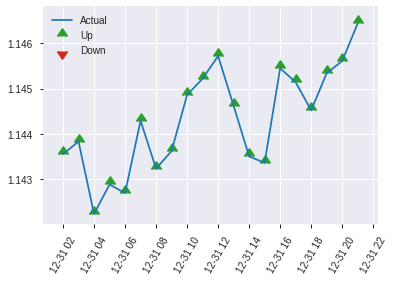


ModelMetricsBinomial: xgboost
** Reported on test data. **

MSE: 0.24626164168093045
RMSE: 0.4962475608815931
LogLoss: 0.6856013917157628
Mean Per-Class Error: 0.4476580105726501
AUC: 0.5594974832038078
pr_auc: 0.5715305603796362
Gini: 0.11899496640761553
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4277030676603317: 


,0,1,Error,Rate
0,22.0,272.0,0.9252,(272.0/294.0)
1,8.0,315.0,0.0248,(8.0/323.0)
Total,30.0,587.0,0.4538,(280.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4277031,0.6923077,372.0
max f2,0.3645146,0.8477690,395.0
max f0point5,0.4554887,0.5945303,342.0
max accuracy,0.4554887,0.5575365,342.0
max precision,0.6301327,0.7777778,8.0
max recall,0.3645146,1.0,395.0
max specificity,0.6535604,0.9965986,0.0
max absolute_mcc,0.4554887,0.1259397,342.0
max min_per_class_accuracy,0.5290703,0.5408163,190.0
max mean_per_class_accuracy,0.5484286,0.5523420,135.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 52.48 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6343598,1.3644405,1.3644405,0.7142857,0.6447294,0.7142857,0.6447294,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.6217452,1.2734778,1.3224577,0.6666667,0.6277559,0.6923077,0.6368955,0.0123839,0.0278638,27.3477812,32.2457728
,3,0.0307942,0.6155908,0.9551084,1.2064527,0.5,0.6177701,0.6315789,0.6308559,0.0092879,0.0371517,-4.4891641,20.6452664
,4,0.0405186,0.6132769,1.2734778,1.2225387,0.6666667,0.6144393,0.64,0.6269159,0.0123839,0.0495356,27.3477812,22.2538700
,5,0.0502431,0.6100306,0.6367389,1.1091581,0.3333333,0.6115712,0.5806452,0.6239460,0.0061920,0.0557276,-36.3261094,10.9158094
,6,0.1004862,0.5930333,1.2323979,1.1707780,0.6451613,0.6008295,0.6129032,0.6123878,0.0619195,0.1176471,23.2397883,17.0777989
,7,0.1507293,0.5781133,1.1091581,1.1502380,0.5806452,0.5850134,0.6021505,0.6032630,0.0557276,0.1733746,10.9158094,15.0238024
,8,0.2009724,0.5675102,1.1091581,1.1399680,0.5806452,0.5719782,0.5967742,0.5954418,0.0557276,0.2291022,10.9158094,13.9968042
,9,0.2998379,0.5529751,1.1273410,1.1358045,0.5901639,0.5599118,0.5945946,0.5837265,0.1114551,0.3405573,12.7341014,13.5804535
,10,0.4003241,0.5426030,1.0167283,1.1059149,0.5322581,0.5474209,0.5789474,0.5746133,0.1021672,0.4427245,1.6728253,10.5914942


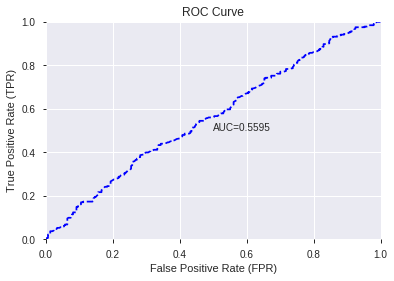

This function is available for GLM models only


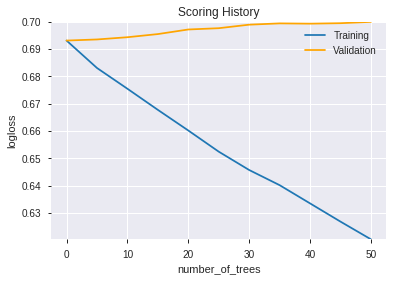

--2019-12-08 08:30:59--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.228.232
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.228.232|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip
Exception in thread "main" java.lang.StackOverflowError
	at java.base/java.lang.String.substring(String.java:1874)
	at java.base/java.lang.String.split(String.java:2289)
	at java.base/java.lang.String.split(String.java:2364)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:101)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:106)
	at hex.genmodel.algos.xgboost.XGBoostMojoModel.constructSubgraph(XGBoostMojoModel.java:106)
	at hex.genmodel.algos.xgboost.XGBoostMojoMo

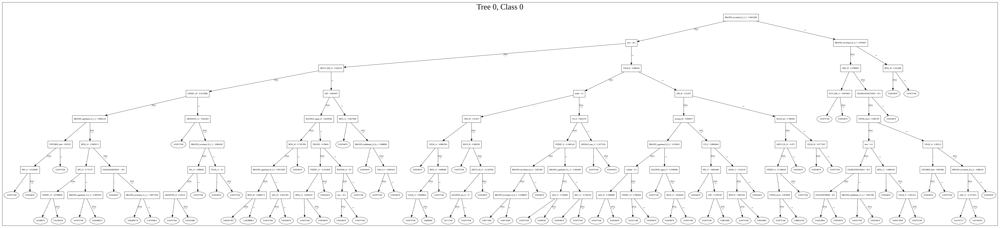

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/XGBoost_grid_1_AutoML_20191208_083036_model_6',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'XGBoost_grid_1_AutoML_20191208_083036_model_6',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_126_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_trainin

['BETA_30',
 'BOP',
 'MFI_8',
 'BETA_14',
 'TRANGE',
 'BBANDS_middleband_24_1_5',
 'HT_PHASOR_inphase',
 'STDDEV_14',
 'MOM_24',
 'HT_PHASOR_quadrature',
 'MFI_24',
 'DX_24',
 'MFI_12',
 'ATR_8',
 'STOCHRSI_fastd',
 'PLUS_DM_8',
 'BBANDS_lowerband_8_4_4',
 'DX_8',
 'MACDEXT',
 'MACDFIX_hist_8',
 'BETA_8',
 'ULTOSC',
 'STOCHRSI_fastk',
 'ADX_20',
 'STOCH_slowk',
 'WILLR_14',
 'LINEARREG_ANGLE_8',
 'WILLR_20',
 'MOM_8',
 'MOM_20',
 'MINUS_DI_8',
 'WILLR_8',
 'MINUS_DI_24',
 'STOCHF_fastk',
 'NATR_14',
 'RSI_24',
 'ADXR_14',
 'MINUS_DM_8',
 'CCI_14',
 'CCI_12',
 'ROCR100_20',
 'WILLR_24',
 'ROC_12',
 'aroondown_30',
 'AROONOSC_12',
 'aroonup_12',
 'aroondown_14',
 'ROC_8',
 'ROCR_8',
 'LINEARREG_SLOPE_8']

In [94]:
# XGBoost with recursive feature elimination
model_train(feature_name='RFE',model_algo="XGBoost",features_list=features_list)

In [95]:
# DRF with recursive feature elimination
model_train(feature_name='RFE',model_algo="DRF",features_list=features_list)

Output hidden; open in https://colab.research.google.com to view.

AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_1_AutoML_20191208_083307,0.557333,0.692302,0.500000,0.499258,0.249258
1,GBM_grid_1_AutoML_20191208_083307_model_5,0.542270,0.693259,0.489643,0.500056,0.250056
2,GBM_grid_1_AutoML_20191208_083307_model_2,0.531802,0.692234,0.487637,0.499544,0.249544
3,GBM_5_AutoML_20191208_083307,0.531413,0.694375,0.491344,0.500530,0.250531
4,GBM_grid_1_AutoML_20191208_083307_model_4,0.528417,0.692730,0.496599,0.499792,0.249792
5,GBM_2_AutoML_20191208_083307,0.526516,0.700771,0.500000,0.503552,0.253564
6,GBM_3_AutoML_20191208_083307,0.520750,0.708052,0.498299,0.506723,0.256768
7,GBM_grid_1_AutoML_20191208_083307_model_3,0.519513,0.997651,0.500000,0.574872,0.330478
8,GBM_grid_1_AutoML_20191208_083307_model_1,0.514090,0.692841,0.494745,0.499847,0.249847
9,GBM_4_AutoML_20191208_083307,0.494503,0.724726,0.500000,0.514410,0.264618


,variable,relative_importance,scaled_importance,percentage
0,BETA_30,60.540707,1.000000,0.044721
1,STOCHRSI_fastk,51.375656,0.848613,0.037951
2,MFI_8,48.005211,0.792941,0.035461
3,STDDEV_14,44.649609,0.737514,0.032983
4,HT_PHASOR_inphase,43.402172,0.716909,0.032061
5,HT_PHASOR_quadrature,42.155525,0.696317,0.031140
6,BOP,40.939640,0.676233,0.030242
7,TRANGE,37.906094,0.626126,0.028001
8,DX_8,37.665642,0.622154,0.027824
9,MFI_24,37.597061,0.621021,0.027773


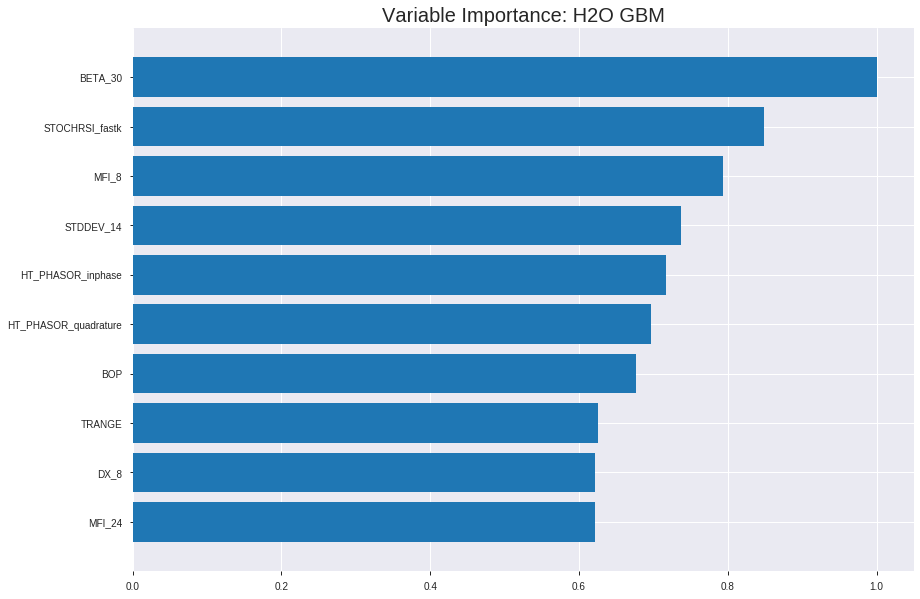

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_1_AutoML_20191208_083307


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.19328365038847692
RMSE: 0.43964036483070673
LogLoss: 0.5764111712776016
Mean Per-Class Error: 0.1875290869870878
AUC: 0.8993286776996692
pr_auc: 0.9011641467652739
Gini: 0.7986573553993384
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.46738347792048807: 


,0,1,Error,Rate
0,1523.0,663.0,0.3033,(663.0/2186.0)
1,218.0,1915.0,0.1022,(218.0/2133.0)
Total,1741.0,2578.0,0.204,(881.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4673835,0.8129909,233.0
max f2,0.4311096,0.8826295,270.0
max f0point5,0.5286119,0.8318404,169.0
max accuracy,0.5031798,0.8129197,197.0
max precision,0.8609494,1.0,0.0
max recall,0.3503892,1.0,338.0
max specificity,0.8609494,1.0,0.0
max absolute_mcc,0.5031798,0.6269450,197.0
max min_per_class_accuracy,0.4954853,0.8064959,206.0
max mean_per_class_accuracy,0.5031798,0.8124709,197.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.38 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.7358056,2.0248476,2.0248476,1.0,0.7800955,1.0,0.7800955,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.7118145,2.0248476,2.0248476,1.0,0.7228153,1.0,0.7517846,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.6901370,2.0248476,2.0248476,1.0,0.7008117,1.0,0.7349243,0.0201594,0.0609470,102.4847632,102.4847632
,4,0.0400556,0.6765395,2.0248476,2.0248476,1.0,0.6824947,1.0,0.7218927,0.0201594,0.0811064,102.4847632,102.4847632
,5,0.0500116,0.6623177,2.0248476,2.0248476,1.0,0.6697483,1.0,0.7115121,0.0201594,0.1012658,102.4847632,102.4847632
,6,0.1000232,0.6230822,2.0248476,2.0248476,1.0,0.6410759,1.0,0.6762940,0.1012658,0.2025316,102.4847632,102.4847632
,7,0.1500347,0.5976295,1.9029818,1.9842257,0.9398148,0.6099934,0.9799383,0.6541938,0.0951711,0.2977028,90.2981803,98.4225689
,8,0.2000463,0.5763552,1.9029818,1.9639147,0.9398148,0.5872102,0.9699074,0.6374479,0.0951711,0.3928739,90.2981803,96.3914718
,9,0.3000695,0.5441058,1.6639373,1.8639222,0.8217593,0.5593214,0.9205247,0.6114057,0.1664323,0.5593061,66.3937291,86.3922242
,10,0.4000926,0.5171704,1.4202056,1.7529931,0.7013889,0.5309313,0.8657407,0.5912871,0.1420534,0.7013596,42.0205631,75.2993089




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.25514490151349833
RMSE: 0.5051187004195136
LogLoss: 0.704200914648369
Mean Per-Class Error: 0.47081510673234805
AUC: 0.5232262725779967
pr_auc: 0.5121061604760095
Gini: 0.0464525451559934
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.2783781299249017: 


,0,1,Error,Rate
0,3.0,622.0,0.9952,(622.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,3.0,1231.0,0.5041,(622.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2783781,0.6619565,396.0
max f2,0.2783781,0.8303791,396.0
max f0point5,0.3371335,0.5509642,380.0
max accuracy,0.5480559,0.5283630,162.0
max precision,0.7984465,0.75,2.0
max recall,0.2783781,1.0,396.0
max specificity,0.8239018,0.9984,0.0
max absolute_mcc,0.4842506,0.0629872,246.0
max min_per_class_accuracy,0.5247309,0.52,194.0
max mean_per_class_accuracy,0.4842506,0.5291849,246.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 52.36 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.7376883,1.2469370,1.2469370,0.6153846,0.7722720,0.6153846,0.7722720,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.7171435,1.0131363,1.1347126,0.5,0.7248318,0.56,0.7495007,0.0098522,0.0229885,1.3136289,13.4712644
,3,0.0299838,0.6955111,1.0131363,1.0952825,0.5,0.7076221,0.5405405,0.7359184,0.0098522,0.0328407,1.3136289,9.5282475
,4,0.0405186,0.6779795,1.2469370,1.1347126,0.6153846,0.6880103,0.56,0.7234623,0.0131363,0.0459770,24.6936971,13.4712644
,5,0.0502431,0.6670654,1.0131363,1.1111817,0.5,0.6715556,0.5483871,0.7134159,0.0098522,0.0558292,1.3136289,11.1181736
,6,0.1004862,0.6327476,0.9804545,1.0458181,0.4838710,0.6478983,0.5161290,0.6806571,0.0492611,0.1050903,-1.9545527,4.5818105
,7,0.1499190,0.6145236,1.1293978,1.0733768,0.5573770,0.6231032,0.5297297,0.6616798,0.0558292,0.1609195,12.9397830,7.3376825
,8,0.2001621,0.5944625,0.9477727,1.0418487,0.4677419,0.6042904,0.5141700,0.6472744,0.0476190,0.2085386,-5.2227343,4.1848653
,9,0.2998379,0.5657071,0.9719519,1.0186127,0.4796748,0.5794120,0.5027027,0.6247147,0.0968801,0.3054187,-2.8048113,1.8612701
,10,0.4003241,0.5455420,1.1438636,1.0500522,0.5645161,0.5551395,0.5182186,0.6072505,0.1149425,0.4203612,14.3863552,5.0052186



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:33:07,0.005 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 08:33:07,0.122 sec,5.0,0.4860697,0.6654973,0.7361741,0.7379771,1.9788284,0.3815698,0.4999442,0.6930383,0.5262555,0.5078686,1.0910698,0.5008104
,2019-12-08 08:33:07,0.241 sec,10.0,0.4721669,0.6382844,0.8063958,0.8051001,2.0248476,0.2959018,0.5005077,0.6942104,0.5292309,0.5196929,1.5586712,0.4991896
,2019-12-08 08:33:08,0.473 sec,15.0,0.4622917,0.6192434,0.8420535,0.8437884,2.0248476,0.2567724,0.5020972,0.6976125,0.5246936,0.5145537,1.4028041,0.5032415
,2019-12-08 08:33:08,0.565 sec,20.0,0.4529921,0.6015355,0.8700164,0.8698313,2.0248476,0.2190322,0.5040171,0.7016508,0.5189938,0.5140124,1.5586712,0.5040519
,2019-12-08 08:33:08,0.655 sec,25.0,0.4456088,0.5876711,0.8902697,0.8915661,2.0248476,0.2032878,0.5040174,0.7017199,0.5237911,0.5139578,1.4028041,0.5016207
,2019-12-08 08:33:08,0.747 sec,30.0,0.4396404,0.5764112,0.8993287,0.9011641,2.0248476,0.2039824,0.5051187,0.7042009,0.5232263,0.5121062,1.2469370,0.5040519


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BETA_30,60.5407066,1.0,0.0447214
STOCHRSI_fastk,51.3756561,0.8486134,0.0379512
MFI_8,48.0052109,0.7929410,0.0354614
STDDEV_14,44.6496086,0.7375138,0.0329827
HT_PHASOR_inphase,43.4021721,0.7169089,0.0320612
---,---,---,---
ROC_8,11.2642593,0.1860609,0.0083209
MINUS_DI_8,10.4667253,0.1728874,0.0077318
MINUS_DM_8,9.7922192,0.1617460,0.0072335
ROCR_8,5.0972981,0.0841962,0.0037654



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5640194489465153)

('F1', 0.6872340425531915)

('auc', 0.5573334596996694)

('logloss', 0.6923024661009424)

('mean_per_class_error', 0.43915987447610627)

('rmse', 0.49925779027805256)

('mse', 0.2492583411533239)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


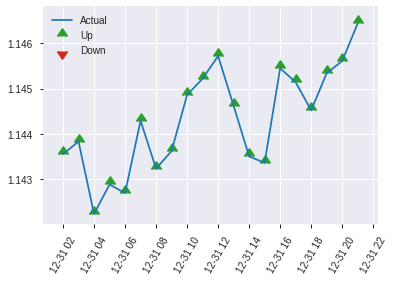


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.2492583411533239
RMSE: 0.49925779027805256
LogLoss: 0.6923024661009424
Mean Per-Class Error: 0.43915987447610627
AUC: 0.5573334596996694
pr_auc: 0.5562194160980594
Gini: 0.11466691939933882
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.25380222339281205: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2538022,0.6872340,399.0
max f2,0.2538022,0.8459927,399.0
max f0point5,0.4113589,0.5889282,348.0
max accuracy,0.5054456,0.5640194,222.0
max precision,0.7953345,1.0,0.0
max recall,0.2538022,1.0,399.0
max specificity,0.7953345,1.0,0.0
max absolute_mcc,0.5054456,0.1227724,222.0
max min_per_class_accuracy,0.5185867,0.5448916,201.0
max mean_per_class_accuracy,0.5054456,0.5608401,222.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 51.85 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6963681,0.8186643,0.8186643,0.4285714,0.7390542,0.4285714,0.7390542,0.0092879,0.0092879,-18.1335692,-18.1335692
,2,0.0210697,0.6832257,0.9551084,0.8816385,0.5,0.6915603,0.4615385,0.7171339,0.0092879,0.0185759,-4.4891641,-11.8361515
,3,0.0307942,0.6751331,0.9551084,0.9048395,0.5,0.6805019,0.4736842,0.7055659,0.0092879,0.0278638,-4.4891641,-9.5160502
,4,0.0405186,0.6632169,0.9551084,0.9169040,0.5,0.6681418,0.48,0.6965841,0.0092879,0.0371517,-4.4891641,-8.3095975
,5,0.0502431,0.6556461,1.5918473,1.0475382,0.8333333,0.6601291,0.5483871,0.6895283,0.0154799,0.0526316,59.1847265,4.7538200
,6,0.1004862,0.6257927,1.0475382,1.0475382,0.5483871,0.6389840,0.5483871,0.6642562,0.0526316,0.1052632,4.7538200,4.7538200
,7,0.1507293,0.6068120,1.2323979,1.1091581,0.6451613,0.6159363,0.5806452,0.6481495,0.0619195,0.1671827,23.2397883,10.9158094
,8,0.2009724,0.5871174,1.4172576,1.1861830,0.7419355,0.5952001,0.6209677,0.6349122,0.0712074,0.2383901,41.7257565,18.6182962
,9,0.2998379,0.5615627,1.0020809,1.1254790,0.5245902,0.5738282,0.5891892,0.6147710,0.0990712,0.3374613,0.2080901,12.5479039
,10,0.4003241,0.5391959,0.9551084,1.0827139,0.5,0.5503853,0.5668016,0.5986094,0.0959752,0.4334365,-4.4891641,8.2713929


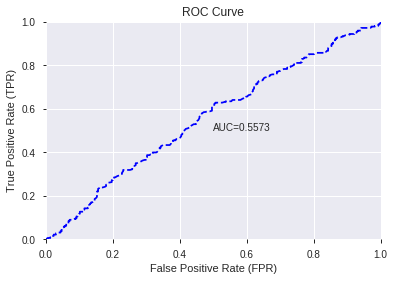

This function is available for GLM models only


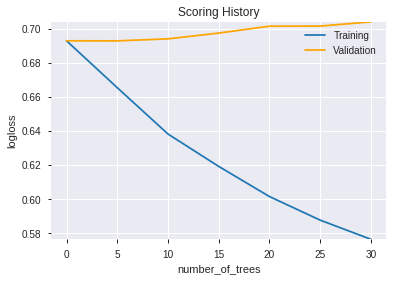

--2019-12-08 08:33:25--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.95.11
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.95.11|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      1206.0
            depth:       1
            colId:       42
            colName:     HT_PHASOR_inphase
            leftward:    true
            naVsRest:    false
            splitVal:    0.7578125
            isBitset:    false
            predValue:   -0.041127995
            squaredErr:  298.806
            leftChild:   Node 5
            

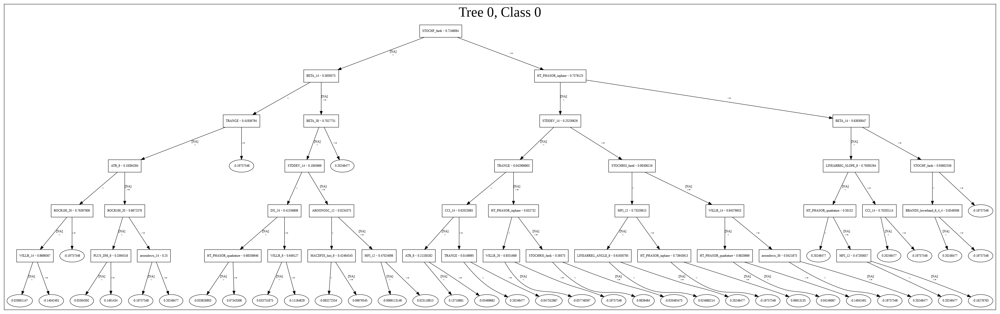

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_1_AutoML_20191208_083307',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_1_AutoML_20191208_083307',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_136_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_136_sid_887f',
   'type': 'Ke

['BETA_30',
 'STOCHRSI_fastk',
 'MFI_8',
 'STDDEV_14',
 'HT_PHASOR_inphase',
 'HT_PHASOR_quadrature',
 'BOP',
 'TRANGE',
 'DX_8',
 'MFI_24',
 'NATR_14',
 'BBANDS_middleband_24_1_5',
 'BETA_14',
 'WILLR_8',
 'STOCH_slowk',
 'DX_24',
 'ULTOSC',
 'CCI_14',
 'ATR_8',
 'WILLR_14',
 'STOCHF_fastk',
 'MACDEXT',
 'BBANDS_lowerband_8_4_4',
 'CCI_12',
 'WILLR_24',
 'PLUS_DM_8',
 'MFI_12',
 'MINUS_DI_24',
 'BETA_8',
 'STOCHRSI_fastd',
 'ADXR_14',
 'ROC_12',
 'ADX_20',
 'WILLR_20',
 'RSI_24',
 'aroondown_30',
 'LINEARREG_ANGLE_8',
 'ROCR100_20',
 'MOM_20',
 'aroondown_14',
 'MOM_24',
 'AROONOSC_12',
 'MACDFIX_hist_8',
 'aroonup_12',
 'MOM_8',
 'ROC_8',
 'MINUS_DI_8',
 'MINUS_DM_8',
 'ROCR_8',
 'LINEARREG_SLOPE_8']

In [96]:
# GBM with recursive feature elimination
model_train(feature_name='RFE',model_algo="GBM",features_list=features_list)

In [97]:
# StackedEnsemble with recursive feature elimination
model_train(feature_name='RFE',model_algo="StackedEnsemble",features_list=features_list)

AutoML progress: |████████████████████████████████████████████████████████| 100%


AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_1_AutoML_20191208_083424,0.557333,0.692302,0.500000,0.499258,0.249258
1,XGBoost_3_AutoML_20191208_083424,0.552784,0.688604,0.494745,0.497719,0.247724
2,GLM_grid_1_AutoML_20191208_083424_model_1,0.534214,0.693212,0.500000,0.500032,0.250032
3,XGBoost_1_AutoML_20191208_083424,0.533898,0.695849,0.496293,0.501181,0.251183
4,GBM_5_AutoML_20191208_083424,0.531413,0.694375,0.491344,0.500530,0.250531
5,GBM_2_AutoML_20191208_083424,0.526516,0.700771,0.500000,0.503552,0.253564
6,DRF_1_AutoML_20191208_083424,0.521624,0.719409,0.491191,0.511514,0.261647
7,GBM_3_AutoML_20191208_083424,0.520750,0.708052,0.498299,0.506723,0.256768
8,XGBoost_2_AutoML_20191208_083424,0.505681,0.703532,0.496599,0.504954,0.254978
9,GBM_4_AutoML_20191208_083424,0.494503,0.724726,0.500000,0.514410,0.264618


,variable,relative_importance,scaled_importance,percentage
0,BETA_30,60.540707,1.000000,0.044721
1,STOCHRSI_fastk,51.375656,0.848613,0.037951
2,MFI_8,48.005211,0.792941,0.035461
3,STDDEV_14,44.649609,0.737514,0.032983
4,HT_PHASOR_inphase,43.402172,0.716909,0.032061
5,HT_PHASOR_quadrature,42.155525,0.696317,0.031140
6,BOP,40.939640,0.676233,0.030242
7,TRANGE,37.906094,0.626126,0.028001
8,DX_8,37.665642,0.622154,0.027824
9,MFI_24,37.597061,0.621021,0.027773


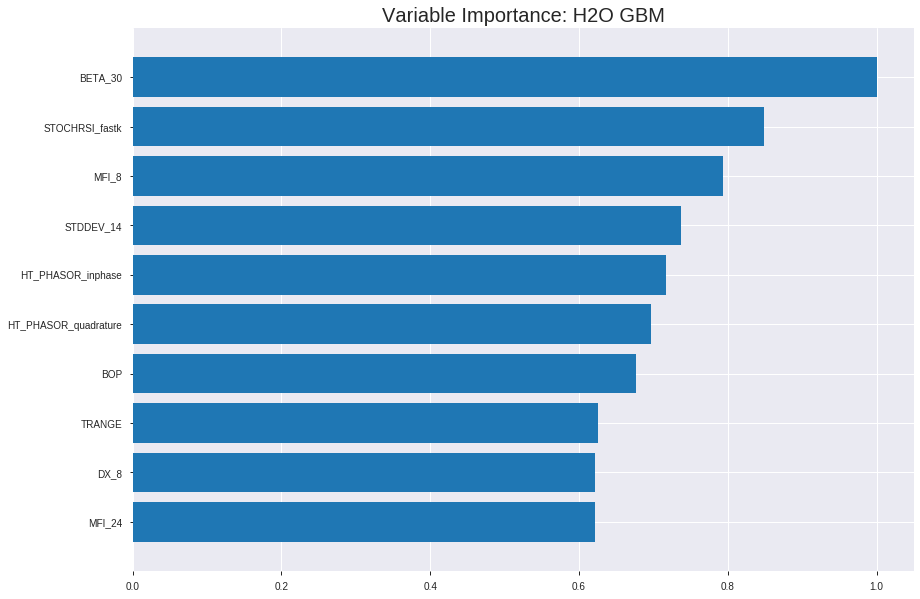

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_1_AutoML_20191208_083424


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.19328365038847692
RMSE: 0.43964036483070673
LogLoss: 0.5764111712776016
Mean Per-Class Error: 0.1875290869870878
AUC: 0.8993286776996692
pr_auc: 0.9011641467652739
Gini: 0.7986573553993384
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.46738347792048807: 


,0,1,Error,Rate
0,1523.0,663.0,0.3033,(663.0/2186.0)
1,218.0,1915.0,0.1022,(218.0/2133.0)
Total,1741.0,2578.0,0.204,(881.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4673835,0.8129909,233.0
max f2,0.4311096,0.8826295,270.0
max f0point5,0.5286119,0.8318404,169.0
max accuracy,0.5031798,0.8129197,197.0
max precision,0.8609494,1.0,0.0
max recall,0.3503892,1.0,338.0
max specificity,0.8609494,1.0,0.0
max absolute_mcc,0.5031798,0.6269450,197.0
max min_per_class_accuracy,0.4954853,0.8064959,206.0
max mean_per_class_accuracy,0.5031798,0.8124709,197.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.38 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.7358056,2.0248476,2.0248476,1.0,0.7800955,1.0,0.7800955,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.7118145,2.0248476,2.0248476,1.0,0.7228153,1.0,0.7517846,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.6901370,2.0248476,2.0248476,1.0,0.7008117,1.0,0.7349243,0.0201594,0.0609470,102.4847632,102.4847632
,4,0.0400556,0.6765395,2.0248476,2.0248476,1.0,0.6824947,1.0,0.7218927,0.0201594,0.0811064,102.4847632,102.4847632
,5,0.0500116,0.6623177,2.0248476,2.0248476,1.0,0.6697483,1.0,0.7115121,0.0201594,0.1012658,102.4847632,102.4847632
,6,0.1000232,0.6230822,2.0248476,2.0248476,1.0,0.6410759,1.0,0.6762940,0.1012658,0.2025316,102.4847632,102.4847632
,7,0.1500347,0.5976295,1.9029818,1.9842257,0.9398148,0.6099934,0.9799383,0.6541938,0.0951711,0.2977028,90.2981803,98.4225689
,8,0.2000463,0.5763552,1.9029818,1.9639147,0.9398148,0.5872102,0.9699074,0.6374479,0.0951711,0.3928739,90.2981803,96.3914718
,9,0.3000695,0.5441058,1.6639373,1.8639222,0.8217593,0.5593214,0.9205247,0.6114057,0.1664323,0.5593061,66.3937291,86.3922242
,10,0.4000926,0.5171704,1.4202056,1.7529931,0.7013889,0.5309313,0.8657407,0.5912871,0.1420534,0.7013596,42.0205631,75.2993089




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.25514490151349833
RMSE: 0.5051187004195136
LogLoss: 0.704200914648369
Mean Per-Class Error: 0.47081510673234805
AUC: 0.5232262725779967
pr_auc: 0.5121061604760095
Gini: 0.0464525451559934
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.2783781299249017: 


,0,1,Error,Rate
0,3.0,622.0,0.9952,(622.0/625.0)
1,0.0,609.0,0.0,(0.0/609.0)
Total,3.0,1231.0,0.5041,(622.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2783781,0.6619565,396.0
max f2,0.2783781,0.8303791,396.0
max f0point5,0.3371335,0.5509642,380.0
max accuracy,0.5480559,0.5283630,162.0
max precision,0.7984465,0.75,2.0
max recall,0.2783781,1.0,396.0
max specificity,0.8239018,0.9984,0.0
max absolute_mcc,0.4842506,0.0629872,246.0
max min_per_class_accuracy,0.5247309,0.52,194.0
max mean_per_class_accuracy,0.4842506,0.5291849,246.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 52.36 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.7376883,1.2469370,1.2469370,0.6153846,0.7722720,0.6153846,0.7722720,0.0131363,0.0131363,24.6936971,24.6936971
,2,0.0202593,0.7171435,1.0131363,1.1347126,0.5,0.7248318,0.56,0.7495007,0.0098522,0.0229885,1.3136289,13.4712644
,3,0.0299838,0.6955111,1.0131363,1.0952825,0.5,0.7076221,0.5405405,0.7359184,0.0098522,0.0328407,1.3136289,9.5282475
,4,0.0405186,0.6779795,1.2469370,1.1347126,0.6153846,0.6880103,0.56,0.7234623,0.0131363,0.0459770,24.6936971,13.4712644
,5,0.0502431,0.6670654,1.0131363,1.1111817,0.5,0.6715556,0.5483871,0.7134159,0.0098522,0.0558292,1.3136289,11.1181736
,6,0.1004862,0.6327476,0.9804545,1.0458181,0.4838710,0.6478983,0.5161290,0.6806571,0.0492611,0.1050903,-1.9545527,4.5818105
,7,0.1499190,0.6145236,1.1293978,1.0733768,0.5573770,0.6231032,0.5297297,0.6616798,0.0558292,0.1609195,12.9397830,7.3376825
,8,0.2001621,0.5944625,0.9477727,1.0418487,0.4677419,0.6042904,0.5141700,0.6472744,0.0476190,0.2085386,-5.2227343,4.1848653
,9,0.2998379,0.5657071,0.9719519,1.0186127,0.4796748,0.5794120,0.5027027,0.6247147,0.0968801,0.3054187,-2.8048113,1.8612701
,10,0.4003241,0.5455420,1.1438636,1.0500522,0.5645161,0.5551395,0.5182186,0.6072505,0.1149425,0.4203612,14.3863552,5.0052186



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:34:31,0.003 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 08:34:31,0.189 sec,5.0,0.4860697,0.6654973,0.7361741,0.7379771,1.9788284,0.3815698,0.4999442,0.6930383,0.5262555,0.5078686,1.0910698,0.5008104
,2019-12-08 08:34:31,0.289 sec,10.0,0.4721669,0.6382844,0.8063958,0.8051001,2.0248476,0.2959018,0.5005077,0.6942104,0.5292309,0.5196929,1.5586712,0.4991896
,2019-12-08 08:34:31,0.378 sec,15.0,0.4622917,0.6192434,0.8420535,0.8437884,2.0248476,0.2567724,0.5020972,0.6976125,0.5246936,0.5145537,1.4028041,0.5032415
,2019-12-08 08:34:31,0.467 sec,20.0,0.4529921,0.6015355,0.8700164,0.8698313,2.0248476,0.2190322,0.5040171,0.7016508,0.5189938,0.5140124,1.5586712,0.5040519
,2019-12-08 08:34:32,0.561 sec,25.0,0.4456088,0.5876711,0.8902697,0.8915661,2.0248476,0.2032878,0.5040174,0.7017199,0.5237911,0.5139578,1.4028041,0.5016207
,2019-12-08 08:34:32,0.649 sec,30.0,0.4396404,0.5764112,0.8993287,0.9011641,2.0248476,0.2039824,0.5051187,0.7042009,0.5232263,0.5121062,1.2469370,0.5040519


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
BETA_30,60.5407066,1.0,0.0447214
STOCHRSI_fastk,51.3756561,0.8486134,0.0379512
MFI_8,48.0052109,0.7929410,0.0354614
STDDEV_14,44.6496086,0.7375138,0.0329827
HT_PHASOR_inphase,43.4021721,0.7169089,0.0320612
---,---,---,---
ROC_8,11.2642593,0.1860609,0.0083209
MINUS_DI_8,10.4667253,0.1728874,0.0077318
MINUS_DM_8,9.7922192,0.1617460,0.0072335
ROCR_8,5.0972981,0.0841962,0.0037654



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5640194489465153)

('F1', 0.6872340425531915)

('auc', 0.5573334596996694)

('logloss', 0.6923024661009424)

('mean_per_class_error', 0.43915987447610627)

('rmse', 0.49925779027805256)

('mse', 0.2492583411533239)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           1
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


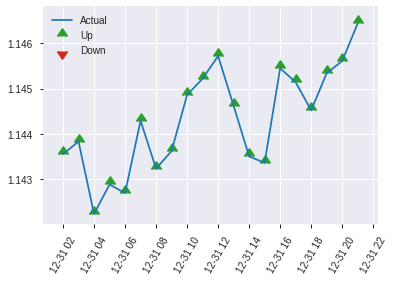


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.2492583411533239
RMSE: 0.49925779027805256
LogLoss: 0.6923024661009424
Mean Per-Class Error: 0.43915987447610627
AUC: 0.5573334596996694
pr_auc: 0.5562194160980594
Gini: 0.11466691939933882
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.25380222339281205: 


,0,1,Error,Rate
0,0.0,294.0,1.0,(294.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,0.0,617.0,0.4765,(294.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.2538022,0.6872340,399.0
max f2,0.2538022,0.8459927,399.0
max f0point5,0.4113589,0.5889282,348.0
max accuracy,0.5054456,0.5640194,222.0
max precision,0.7953345,1.0,0.0
max recall,0.2538022,1.0,399.0
max specificity,0.7953345,1.0,0.0
max absolute_mcc,0.5054456,0.1227724,222.0
max min_per_class_accuracy,0.5185867,0.5448916,201.0
max mean_per_class_accuracy,0.5054456,0.5608401,222.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 51.85 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6963681,0.8186643,0.8186643,0.4285714,0.7390542,0.4285714,0.7390542,0.0092879,0.0092879,-18.1335692,-18.1335692
,2,0.0210697,0.6832257,0.9551084,0.8816385,0.5,0.6915603,0.4615385,0.7171339,0.0092879,0.0185759,-4.4891641,-11.8361515
,3,0.0307942,0.6751331,0.9551084,0.9048395,0.5,0.6805019,0.4736842,0.7055659,0.0092879,0.0278638,-4.4891641,-9.5160502
,4,0.0405186,0.6632169,0.9551084,0.9169040,0.5,0.6681418,0.48,0.6965841,0.0092879,0.0371517,-4.4891641,-8.3095975
,5,0.0502431,0.6556461,1.5918473,1.0475382,0.8333333,0.6601291,0.5483871,0.6895283,0.0154799,0.0526316,59.1847265,4.7538200
,6,0.1004862,0.6257927,1.0475382,1.0475382,0.5483871,0.6389840,0.5483871,0.6642562,0.0526316,0.1052632,4.7538200,4.7538200
,7,0.1507293,0.6068120,1.2323979,1.1091581,0.6451613,0.6159363,0.5806452,0.6481495,0.0619195,0.1671827,23.2397883,10.9158094
,8,0.2009724,0.5871174,1.4172576,1.1861830,0.7419355,0.5952001,0.6209677,0.6349122,0.0712074,0.2383901,41.7257565,18.6182962
,9,0.2998379,0.5615627,1.0020809,1.1254790,0.5245902,0.5738282,0.5891892,0.6147710,0.0990712,0.3374613,0.2080901,12.5479039
,10,0.4003241,0.5391959,0.9551084,1.0827139,0.5,0.5503853,0.5668016,0.5986094,0.0959752,0.4334365,-4.4891641,8.2713929


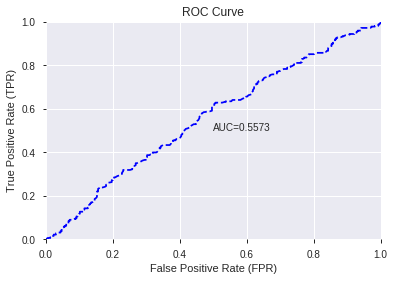

This function is available for GLM models only


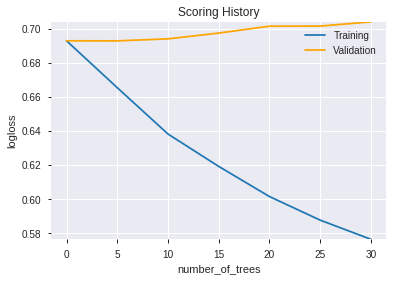

--2019-12-08 08:34:44--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.216.170.67
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.216.170.67|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      1206.0
            depth:       1
            colId:       42
            colName:     HT_PHASOR_inphase
            leftward:    true
            naVsRest:    false
            splitVal:    0.7578125
            isBitset:    false
            predValue:   -0.041127995
            squaredErr:  298.806
            leftChild:   Node 5
          

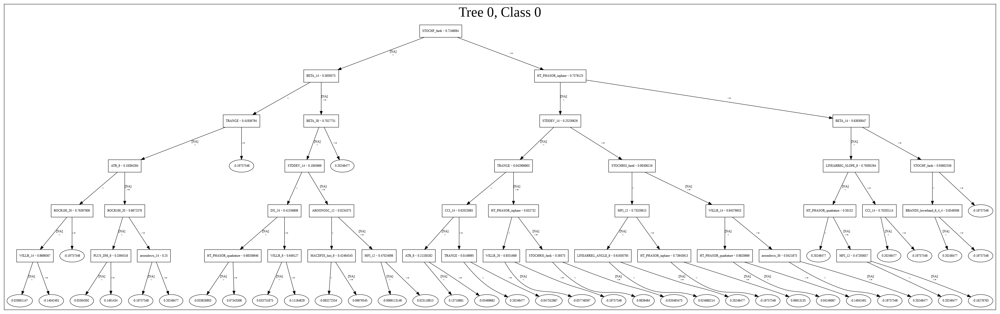

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_1_AutoML_20191208_083424',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_1_AutoML_20191208_083424',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_144_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_144_sid_887f',
   'type': 'Ke

['BETA_30',
 'STOCHRSI_fastk',
 'MFI_8',
 'STDDEV_14',
 'HT_PHASOR_inphase',
 'HT_PHASOR_quadrature',
 'BOP',
 'TRANGE',
 'DX_8',
 'MFI_24',
 'NATR_14',
 'BBANDS_middleband_24_1_5',
 'BETA_14',
 'WILLR_8',
 'STOCH_slowk',
 'DX_24',
 'ULTOSC',
 'CCI_14',
 'ATR_8',
 'WILLR_14',
 'STOCHF_fastk',
 'MACDEXT',
 'BBANDS_lowerband_8_4_4',
 'CCI_12',
 'WILLR_24',
 'PLUS_DM_8',
 'MFI_12',
 'MINUS_DI_24',
 'BETA_8',
 'STOCHRSI_fastd',
 'ADXR_14',
 'ROC_12',
 'ADX_20',
 'WILLR_20',
 'RSI_24',
 'aroondown_30',
 'LINEARREG_ANGLE_8',
 'ROCR100_20',
 'MOM_20',
 'aroondown_14',
 'MOM_24',
 'AROONOSC_12',
 'MACDFIX_hist_8',
 'aroonup_12',
 'MOM_8',
 'ROC_8',
 'MINUS_DI_8',
 'MINUS_DM_8',
 'ROCR_8',
 'LINEARREG_SLOPE_8']

In [98]:
# All algos with recursive feature elimination
model_train(feature_name='RFE',model_algo=None,features_list=features_list)

In [0]:
# recursive feature elimination with cross validation
try:
  del features_list
except:
  pass
gc.collect()

if features_to_include is True or 'RFECV' in features_to_include:
  from sklearn.feature_selection import RFECV
  from sklearn.svm import LinearSVC
  from sklearn.tree import DecisionTreeClassifier,ExtraTreeClassifier
  from sklearn.linear_model import LogisticRegression, LinearRegression

  bestfeatures = RFECV(ExtraTreeClassifier(random_state=1,criterion='entropy'), min_features_to_select=select_rfe, step=1,cv=cv_rfe).fit(pd.read_pickle('scaled_df')[:index_splits[0]].drop(data_label_name,axis=1)
                                                              ,pd.read_pickle('scaled_df')[:index_splits[0]][data_label_name])

  features_list = list(np.array(train_hf.columns)[:-1][bestfeatures.get_support()])

  del bestfeatures, RFECV, LinearSVC, DecisionTreeClassifier,ExtraTreeClassifier, LogisticRegression, LinearRegression
  gc.collect()
  display(len(features_list),features_list)
else:
  features_list = []

In [100]:
# DeepLearning with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="DeepLearning",features_list=features_list)

[]

In [101]:
# GLM with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="GLM",features_list=features_list)

[]

In [102]:
# XGBoost with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="XGBoost",features_list=features_list)

[]

In [103]:
# DRF with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="DRF",features_list=features_list)

[]

In [104]:
# GBM with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="GBM",features_list=features_list)

[]

In [105]:
# StackedEnsemble with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo="StackedEnsemble",features_list=features_list)

[]

In [106]:
# All algos with recursive feature elimination with cross validation
model_train(feature_name='RFECV',model_algo=None,features_list=features_list)

[]

In [107]:
# Stacked ensemble

## filter models based on ensemble_model_threshold
models_arr = []
for model_name in best_models:
  if best_models[max(best_models.keys(), key=(lambda k: best_models[k]['AUC']))]['AUC'] - best_models[model_name]['AUC'] <= ensemble_model_threshold:
    models_arr.append(best_models[model_name]['id'])

from h2o.estimators.stackedensemble import H2OStackedEnsembleEstimator

try:
  ensemble = H2OStackedEnsembleEstimator(seed=1,
                                        base_models=models_arr)

  ensemble.train(y=data_label_name, training_frame=train_hf[:index_splits[0],:], blending_frame =train_hf[index_splits[0]:index_splits[1],:])
except:
  pass

try:
  display(ensemble)
  model_performance = ensemble.model_performance(test_data=train_hf[index_splits[1]:,:])
  display(model_performance)
  for k in models_summary:
    result = getattr(model_performance, k)()
    result = result[0][1] if isinstance(result,list) else result
    models_summary[k] = models_summary[k].append(pd.DataFrame({'StackedEnsemble':[result]},index=['All']))
    display((k,result))
except Exception as e:
  print(e)

stackedensemble Model Build progress: |███████████████████████████████████| 100%
Model Details
H2OStackedEnsembleEstimator :  Stacked Ensemble
Model Key:  StackedEnsemble_model_python_1575787622554_3855
No model summary for this model


ModelMetricsBinomialGLM: stackedensemble
** Reported on train data. **

MSE: 0.21688190280417957
RMSE: 0.4657058114348366
LogLoss: 0.6257874571302321
Null degrees of freedom: 4318
Residual degrees of freedom: 4312
Null deviance: 5986.757031473575
Residual deviance: 5405.552054690945
AIC: 5419.552054690945
AUC: 0.8581465439404916
pr_auc: 0.8539807623682688
Gini: 0.7162930878809832
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.4439589628482594: 


,0,1,Error,Rate
0,1483.0,703.0,0.3216,(703.0/2186.0)
1,325.0,1808.0,0.1524,(325.0/2133.0)
Total,1808.0,2511.0,0.238,(1028.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.4439590,0.7786391,233.0
max f2,0.4016301,0.8694747,300.0
max f0point5,0.4832192,0.7907203,168.0
max accuracy,0.4523592,0.7698541,218.0
max precision,0.6781032,1.0,0.0
max recall,0.3519262,1.0,362.0
max specificity,0.6781032,1.0,0.0
max absolute_mcc,0.4523592,0.5415861,218.0
max min_per_class_accuracy,0.4578796,0.7653248,209.0
max mean_per_class_accuracy,0.4523592,0.7702798,218.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 45.88 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.6128625,2.0248476,2.0248476,1.0,0.6299568,1.0,0.6299568,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.5901010,2.0248476,2.0248476,1.0,0.5998754,1.0,0.6150890,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.5786972,2.0248476,2.0248476,1.0,0.5840372,1.0,0.6048180,0.0201594,0.0609470,102.4847632,102.4847632
,4,0.0400556,0.5701736,1.9306687,2.0014390,0.9534884,0.5738277,0.9884393,0.5971152,0.0192218,0.0801688,93.0668673,100.1438989
,5,0.0500116,0.5640647,1.9306687,1.9873505,0.9534884,0.5670282,0.9814815,0.5911257,0.0192218,0.0993905,93.0668673,98.7350454
,6,0.1000232,0.5403241,1.8936075,1.9404790,0.9351852,0.5515653,0.9583333,0.5713455,0.0947023,0.1940928,89.3607508,94.0478981
,7,0.1500347,0.5275263,1.7529931,1.8779837,0.8657407,0.5339611,0.9274691,0.5588840,0.0876699,0.2817628,75.2993089,87.7983684
,8,0.2000463,0.5141320,1.7904903,1.8561103,0.8842593,0.5206074,0.9166667,0.5493149,0.0895452,0.3713080,79.0490268,85.6110330
,9,0.3000695,0.4923543,1.6405016,1.7842407,0.8101852,0.5027843,0.8811728,0.5338047,0.1640881,0.5353962,64.0501554,78.4240738
,10,0.4000926,0.4743931,1.2936527,1.6615937,0.6388889,0.4835170,0.8206019,0.5212328,0.1293952,0.6647914,29.3652654,66.1593717



ModelMetricsBinomialGLM: stackedensemble
** Reported on test data. **

MSE: 0.24650953574602855
RMSE: 0.49649726660479065
LogLoss: 0.6860894153437438
Null degrees of freedom: 616
Residual degrees of freedom: 610
Null deviance: 856.1994253246229
Residual deviance: 846.6343385341797
AIC: 860.6343385341797
AUC: 0.5632884732840505
pr_auc: 0.5890603339518059
Gini: 0.12657694656810103
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.3971106425627081: 


,0,1,Error,Rate
0,3.0,291.0,0.9898,(291.0/294.0)
1,0.0,323.0,0.0,(0.0/323.0)
Total,3.0,614.0,0.4716,(291.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.3971106,0.6894344,396.0
max f2,0.3971106,0.8473242,396.0
max f0point5,0.4610599,0.5876202,314.0
max accuracy,0.5027701,0.5591572,190.0
max precision,0.6486225,1.0,0.0
max recall,0.3971106,1.0,396.0
max specificity,0.6486225,1.0,0.0
max absolute_mcc,0.5027701,0.1227548,190.0
max min_per_class_accuracy,0.4978593,0.5442177,204.0
max mean_per_class_accuracy,0.5027701,0.5612350,190.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 50.05 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.6151208,1.3644405,1.3644405,0.7142857,0.6295108,0.7142857,0.6295108,0.0154799,0.0154799,36.4440513,36.4440513
,2,0.0210697,0.6033887,1.5918473,1.4693975,0.8333333,0.6091837,0.7692308,0.6201291,0.0154799,0.0309598,59.1847265,46.9397476
,3,0.0307942,0.5951603,1.5918473,1.5080658,0.8333333,0.5997544,0.7894737,0.6136950,0.0154799,0.0464396,59.1847265,50.8065830
,4,0.0405186,0.5870093,0.9551084,1.3753560,0.5,0.5895314,0.72,0.6078957,0.0092879,0.0557276,-4.4891641,37.5356037
,5,0.0502431,0.5808099,1.2734778,1.3556377,0.6666667,0.5841896,0.7096774,0.6033074,0.0123839,0.0681115,27.3477812,35.5637671
,6,0.1004862,0.5584325,1.2323979,1.2940178,0.6451613,0.5690528,0.6774194,0.5861801,0.0619195,0.1300310,23.2397883,29.4017777
,7,0.1507293,0.5422708,0.9242984,1.1707780,0.4838710,0.5496242,0.6129032,0.5739948,0.0464396,0.1764706,-7.5701588,17.0777989
,8,0.2009724,0.5337756,1.1091581,1.1553730,0.5806452,0.5370936,0.6048387,0.5647695,0.0557276,0.2321981,10.9158094,15.5373015
,9,0.2998379,0.5223827,1.0333959,1.1151535,0.5409836,0.5283935,0.5837838,0.5527753,0.1021672,0.3343653,3.3395930,11.5153544
,10,0.4003241,0.5101086,1.0167283,1.0904476,0.5322581,0.5163900,0.5708502,0.5436421,0.1021672,0.4365325,1.6728253,9.0447600


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.5591572123176661)

('F1', 0.6894343649946638)

('auc', 0.5632884732840505)

('logloss', 0.6860894153437438)

('mean_per_class_error', 0.43876497967608097)

('rmse', 0.49649726660479065)

('mse', 0.24650953574602855)

Parse progress: |█████████████████████████████████████████████████████████| 100%
AutoML progress: |████████████████████████████████████████████████████████| 100%


,model_id,auc,logloss,mean_per_class_error,rmse,mse
0,GBM_grid_1_AutoML_20191208_083553_model_12,0.590963,0.738593,0.494593,0.515207,0.265438
1,GBM_grid_1_AutoML_20191208_083553_model_17,0.588830,0.729676,0.498299,0.512883,0.263049
2,GBM_grid_1_AutoML_20191208_083553_model_1,0.588657,0.691524,0.492892,0.499188,0.249189
3,GBM_grid_1_AutoML_20191208_083553_model_13,0.586861,0.740182,0.496446,0.516017,0.266273
4,GBM_grid_1_AutoML_20191208_083553_model_16,0.585234,0.739842,0.498299,0.516197,0.266460
...,...,...,...,...,...,...
281,XGBoost_grid_1_AutoML_20191208_083553_model_191,0.521135,1.268234,0.500000,0.621901,0.386761
282,XGBoost_grid_1_AutoML_20191208_083553_model_195,0.520819,1.279543,0.472657,0.631621,0.398946
283,GBM_grid_1_AutoML_20191208_083553_model_18,0.516917,1.365698,0.496446,0.643882,0.414584
284,XGBoost_grid_1_AutoML_20191208_083553_model_155,0.516770,1.269636,0.490886,0.627751,0.394072


,variable,relative_importance,scaled_importance,percentage
0,RFE_['DRF'],3343.540527,1.000000,0.379045
1,XGBF_['DRF'],1558.756226,0.466199,0.176711
2,DLF_['GBM'],866.491638,0.259154,0.098231
3,RFE_['GBM'],810.225586,0.242326,0.091852
4,RFE_None,698.055176,0.208777,0.079136
5,RFE_['XGBoost'],552.052734,0.165110,0.062584
6,Fwe_['XGBoost'],171.469376,0.051284,0.019439
7,XGBF_None,130.477798,0.039024,0.014792
8,XGBF_['XGBoost'],103.527847,0.030964,0.011737
9,XGBF_['GBM'],97.516800,0.029166,0.011055


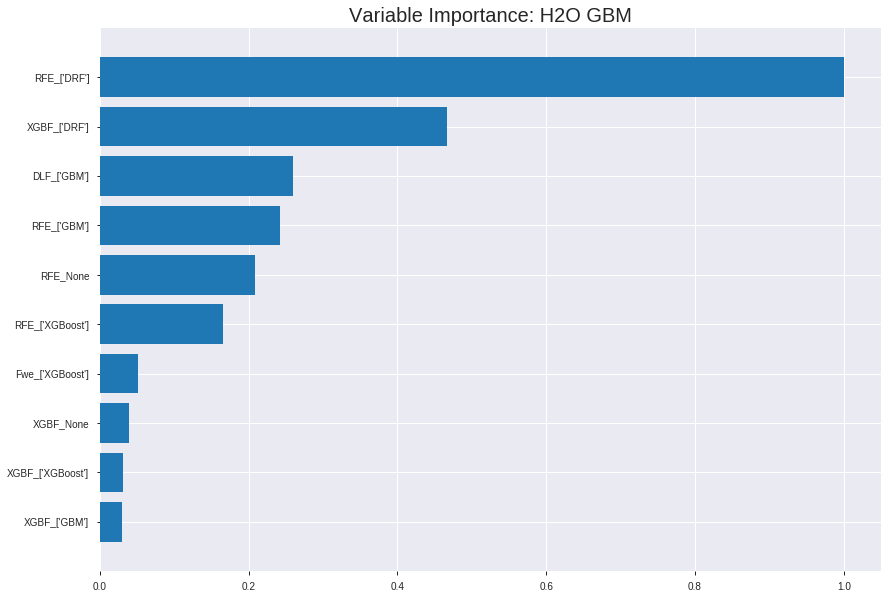

Model Details
H2OGradientBoostingEstimator :  Gradient Boosting Machine
Model Key:  GBM_grid_1_AutoML_20191208_083553_model_12


ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.03061841414426338
RMSE: 0.17498118225758844
LogLoss: 0.18148963573750027
Mean Per-Class Error: 0.0025501111149714983
AUC: 0.9999680445266279
pr_auc: 0.996216841245466
Gini: 0.9999360890532558
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.5178771270229819: 


,0,1,Error,Rate
0,2181.0,5.0,0.0023,(5.0/2186.0)
1,6.0,2127.0,0.0028,(6.0/2133.0)
Total,2187.0,2132.0,0.0025,(11.0/4319.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.5178771,0.9974209,198.0
max f2,0.4389518,0.9979395,208.0
max f0point5,0.5444685,0.9984018,195.0
max accuracy,0.5444685,0.9974531,195.0
max precision,0.8916553,1.0,0.0
max recall,0.3596977,1.0,220.0
max specificity,0.8916553,1.0,0.0
max absolute_mcc,0.5444685,0.9949105,195.0
max min_per_class_accuracy,0.5178771,0.9971871,198.0
max mean_per_class_accuracy,0.5178771,0.9974499,198.0


Gains/Lift Table: Avg response rate: 49.39 %, avg score: 49.39 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0101875,0.8895214,2.0248476,2.0248476,1.0,0.8904352,1.0,0.8904352,0.0206282,0.0206282,102.4847632,102.4847632
,2,0.0201436,0.8883530,2.0248476,2.0248476,1.0,0.8888821,1.0,0.8896676,0.0201594,0.0407876,102.4847632,102.4847632
,3,0.0300996,0.8875219,2.0248476,2.0248476,1.0,0.8879399,1.0,0.8890961,0.0201594,0.0609470,102.4847632,102.4847632
,4,0.0400556,0.8866424,2.0248476,2.0248476,1.0,0.8870617,1.0,0.8885905,0.0201594,0.0811064,102.4847632,102.4847632
,5,0.0500116,0.8857232,2.0248476,2.0248476,1.0,0.8862177,1.0,0.8881181,0.0201594,0.1012658,102.4847632,102.4847632
,6,0.1000232,0.8801299,2.0248476,2.0248476,1.0,0.8830172,1.0,0.8855677,0.1012658,0.2025316,102.4847632,102.4847632
,7,0.1500347,0.8743623,2.0248476,2.0248476,1.0,0.8773623,1.0,0.8828325,0.1012658,0.3037975,102.4847632,102.4847632
,8,0.2000463,0.8671996,2.0248476,2.0248476,1.0,0.8708833,1.0,0.8798452,0.1012658,0.4050633,102.4847632,102.4847632
,9,0.3000695,0.8446669,2.0248476,2.0248476,1.0,0.8571137,1.0,0.8722681,0.2025316,0.6075949,102.4847632,102.4847632
,10,0.4000926,0.7931842,2.0248476,2.0248476,1.0,0.8229851,1.0,0.8599473,0.2025316,0.8101266,102.4847632,102.4847632




ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 0.2903812973685248
RMSE: 0.5388703901389691
LogLoss: 0.798983215407894
Mean Per-Class Error: 0.4625169129720854
AUC: 0.5370824302134647
pr_auc: 0.5211905672252958
Gini: 0.07416486042692938
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.11378331494977077: 


,0,1,Error,Rate
0,3.0,622.0,0.9952,(622.0/625.0)
1,1.0,608.0,0.0016,(1.0/609.0)
Total,4.0,1230.0,0.5049,(623.0/1234.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.1137833,0.6612289,396.0
max f2,0.1062573,0.8297003,399.0
max f0point5,0.3605578,0.5520995,292.0
max accuracy,0.6276223,0.5372771,158.0
max precision,0.8885750,0.6666667,1.0
max recall,0.1062573,1.0,399.0
max specificity,0.8899211,0.9984,0.0
max absolute_mcc,0.5984883,0.0749954,174.0
max min_per_class_accuracy,0.6137643,0.5303777,167.0
max mean_per_class_accuracy,0.5984883,0.5374831,174.0


Gains/Lift Table: Avg response rate: 49.35 %, avg score: 56.76 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0105348,0.8864816,1.4028041,1.4028041,0.6923077,0.8879909,0.6923077,0.8879909,0.0147783,0.0147783,40.2804092,40.2804092
,2,0.0202593,0.8800294,0.8442802,1.1347126,0.4166667,0.8831244,0.56,0.8856550,0.0082102,0.0229885,-15.5719759,13.4712644
,3,0.0299838,0.8750286,0.8442802,1.0405184,0.4166667,0.8773051,0.5135135,0.8829469,0.0082102,0.0311987,-15.5719759,4.0518351
,4,0.0405186,0.8706438,1.2469370,1.0941872,0.6153846,0.8727241,0.54,0.8802890,0.0131363,0.0443350,24.6936971,9.4187192
,5,0.0502431,0.8642240,1.1819923,1.1111817,0.5833333,0.8675970,0.5483871,0.8778325,0.0114943,0.0558292,18.1992337,11.1181736
,6,0.1004862,0.8405672,1.2092272,1.1602045,0.5967742,0.8545538,0.5725806,0.8661931,0.0607553,0.1165846,20.9227184,16.0204460
,7,0.1499190,0.8170693,0.9965275,1.1062353,0.4918033,0.8293777,0.5459459,0.8540540,0.0492611,0.1658456,-0.3472503,10.6235299
,8,0.2001621,0.7847669,1.1438636,1.1156804,0.5645161,0.8026057,0.5506073,0.8411398,0.0574713,0.2233169,14.3863552,11.5680448
,9,0.2998379,0.7286350,0.9225306,1.0514712,0.4552846,0.7567641,0.5189189,0.8130906,0.0919540,0.3152709,-7.7469395,5.1471176
,10,0.4003241,0.6702538,1.1111817,1.0664593,0.5483871,0.6992106,0.5263158,0.7845053,0.1116585,0.4269294,11.1181736,6.6459252



Scoring History: 


,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_auc,training_pr_auc,training_lift,training_classification_error,validation_rmse,validation_logloss,validation_auc,validation_pr_auc,validation_lift,validation_classification_error
,2019-12-08 08:38:01,7.702 sec,0.0,0.4999624,0.6930719,0.5,0.0,1.0,0.5061357,0.4999581,0.6930634,0.5,0.0,1.0,0.5064830
,2019-12-08 08:38:01,7.763 sec,5.0,0.4041686,0.5174946,0.9998661,0.9970532,2.0248476,0.0043992,0.5005945,0.6944275,0.5354680,0.5118395,1.0910698,0.5056726
,2019-12-08 08:38:01,7.828 sec,10.0,0.3491951,0.4275022,0.9993244,0.9988614,2.0248476,0.0083353,0.5043255,0.7026549,0.5443363,0.5160538,0.9352027,0.5
,2019-12-08 08:38:01,7.893 sec,15.0,0.2853152,0.3322109,0.9999453,0.9980694,2.0248476,0.0032415,0.5140476,0.7250577,0.5350332,0.5201704,1.0910698,0.5024311
,2019-12-08 08:38:01,7.958 sec,20.0,0.2423904,0.2710957,0.9999091,0.9961584,2.0248476,0.0034730,0.5219639,0.7462245,0.5380059,0.5207024,1.4028041,0.5032415
,2019-12-08 08:38:01,8.024 sec,25.0,0.2016408,0.2169621,0.9999639,0.9990259,2.0248476,0.0025469,0.5314461,0.7738029,0.5349176,0.5218803,1.2469370,0.5016207
,2019-12-08 08:38:01,8.098 sec,30.0,0.1749812,0.1814896,0.9999680,0.9962168,2.0248476,0.0025469,0.5388704,0.7989832,0.5370824,0.5211906,1.4028041,0.5048622


Variable Importances: 


variable,relative_importance,scaled_importance,percentage
RFE_['DRF'],3343.5405273,1.0,0.3790451
XGBF_['DRF'],1558.7562256,0.4661993,0.1767106
DLF_['GBM'],866.4916382,0.2591539,0.0982310
RFE_['GBM'],810.2255859,0.2423256,0.0918523
RFE_None,698.0551758,0.2087772,0.0791360
---,---,---,---
RFE_['DeepLearning']predict,0.0,0.0,0.0
RFE_['GLM']predict,0.0,0.0,0.0
RFE_['XGBoost']predict,0.0,0.0,0.0
RFE_['GBM']predict,0.0,0.0,0.0



See the whole table with table.as_data_frame()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


('accuracy', 0.586709886547812)

('F1', 0.6881028938906752)

('auc', 0.5909627008698216)

('logloss', 0.7385925600874607)

('mean_per_class_error', 0.4124702512583981)

('rmse', 0.5152065771243086)

('mse', 0.26543781711214615)

gbm prediction progress: |████████████████████████████████████████████████| 100%
      predict
0           1
1           1
2           0
3           1
4           1
...       ...
6165        1
6166        1
6167        1
6168        1
6169        1

[6170 rows x 1 columns]


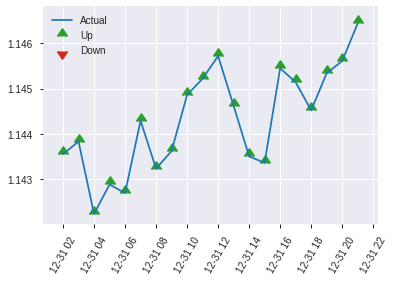


ModelMetricsBinomial: gbm
** Reported on test data. **

MSE: 0.26543781711214615
RMSE: 0.5152065771243086
LogLoss: 0.7385925600874607
Mean Per-Class Error: 0.4124702512583981
AUC: 0.5909627008698216
pr_auc: 0.6079525191418512
Gini: 0.18192540173964322
Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.13611017599897884: 


,0,1,Error,Rate
0,5.0,289.0,0.983,(289.0/294.0)
1,2.0,321.0,0.0062,(2.0/323.0)
Total,7.0,610.0,0.4716,(291.0/617.0)


Maximum Metrics: Maximum metrics at their respective thresholds



metric,threshold,value,idx
max f1,0.1361102,0.6881029,393.0
max f2,0.1145199,0.8464361,398.0
max f0point5,0.6093071,0.6049149,183.0
max accuracy,0.6093071,0.5867099,183.0
max precision,0.8901775,1.0,0.0
max recall,0.1145199,1.0,398.0
max specificity,0.8901775,1.0,0.0
max absolute_mcc,0.6387833,0.1756710,162.0
max min_per_class_accuracy,0.6125344,0.5789474,180.0
max mean_per_class_accuracy,0.6387833,0.5875297,162.0


Gains/Lift Table: Avg response rate: 52.35 %, avg score: 57.28 %



,group,cumulative_data_fraction,lower_threshold,lift,cumulative_lift,response_rate,score,cumulative_response_rate,cumulative_score,capture_rate,cumulative_capture_rate,gain,cumulative_gain
,1,0.0113452,0.8844982,1.6373286,1.6373286,0.8571429,0.8876208,0.8571429,0.8876208,0.0185759,0.0185759,63.7328616,63.7328616
,2,0.0210697,0.8779322,1.5918473,1.6163372,0.8333333,0.8818061,0.8461538,0.8849371,0.0154799,0.0340557,59.1847265,61.6337223
,3,0.0307942,0.8761674,1.2734778,1.5080658,0.6666667,0.8770790,0.7894737,0.8824556,0.0123839,0.0464396,27.3477812,50.8065830
,4,0.0405186,0.8715499,0.6367389,1.2989474,0.3333333,0.8738502,0.68,0.8803903,0.0061920,0.0526316,-36.3261094,29.8947368
,5,0.0502431,0.8643111,1.5918473,1.3556377,0.8333333,0.8676515,0.7096774,0.8779247,0.0154799,0.0681115,59.1847265,35.5637671
,6,0.1004862,0.8387570,1.1707780,1.2632078,0.6129032,0.8514336,0.6612903,0.8646792,0.0588235,0.1269350,17.0777989,26.3207830
,7,0.1507293,0.8114125,1.0475382,1.1913180,0.5483871,0.8243889,0.6236559,0.8512491,0.0526316,0.1795666,4.7538200,19.1317953
,8,0.2009724,0.7729315,1.2940178,1.2169929,0.6774194,0.7891578,0.6370968,0.8357263,0.0650155,0.2445820,29.4017777,21.6992909
,9,0.2998379,0.7259778,1.0960260,1.1771065,0.5737705,0.7485610,0.6162162,0.8069853,0.1083591,0.3529412,9.6025986,17.7106518
,10,0.4003241,0.6770664,1.1399680,1.1677843,0.5967742,0.6981016,0.6113360,0.7796542,0.1145511,0.4674923,13.9968042,16.7784310


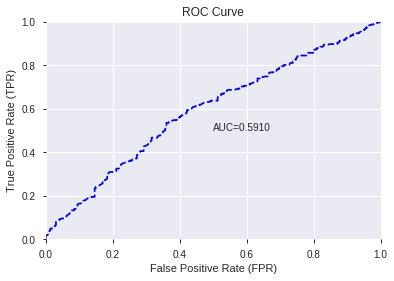

This function is available for GLM models only


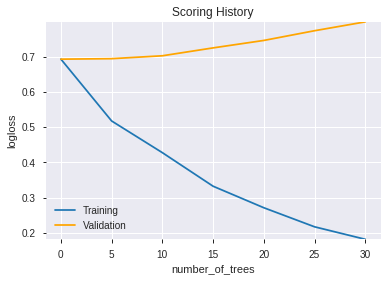

--2019-12-08 09:16:47--  https://h2o-release.s3.amazonaws.com/h2o/rel-yates/5/h2o-3.24.0.5.zip
Resolving h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)... 52.217.40.148
Connecting to h2o-release.s3.amazonaws.com (h2o-release.s3.amazonaws.com)|52.217.40.148|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

Archive:  h2o-3.24.0.5.zip

Tree inconsistency found:
Note: this is a known issue for DRF and Isolation Forest models, please refer to https://0xdata.atlassian.net/browse/PUBDEV-6140
        Node 2 (parent)
            weight:      2145.0
            depth:       1
            colId:       42
            colName:     RFE_['DRF']
            leftward:    false
            naVsRest:    false
            splitVal:    0.5321522
            isBitset:    false
            predValue:   0.4884201
            squaredErr:  37.326805
            leftChild:   Node 5
            righ

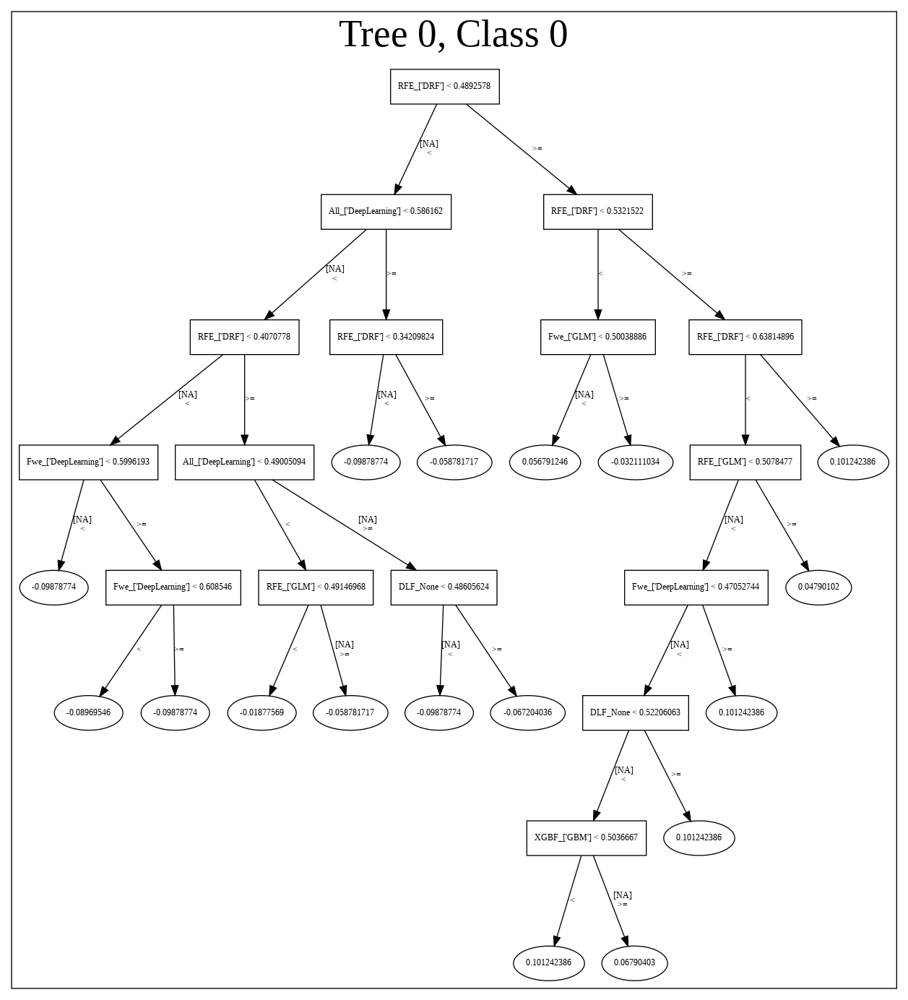

[{'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Models/GBM_grid_1_AutoML_20191208_083553_model_12',
   '__meta': {'schema_name': 'ModelKeyV3',
    'schema_type': 'Key<Model>',
    'schema_version': 3},
   'name': 'GBM_grid_1_AutoML_20191208_083553_model_12',
   'type': 'Key<Model>'},
  'default_value': None,
  'gridable': False,
  'help': 'Destination id for this model; auto-generated if not specified.',
  'is_member_of_frames': [],
  'is_mutually_exclusive_with': [],
  'label': 'model_id',
  'level': 'critical',
  'name': 'model_id',
  'required': False,
  'type': 'Key<Model>',
  'values': []},
 {'__meta': {'schema_name': 'ModelParameterSchemaV3',
   'schema_type': 'Iced',
   'schema_version': 3},
  'actual_value': {'URL': '/3/Frames/automl_training_py_153_sid_887f',
   '__meta': {'schema_name': 'FrameKeyV3',
    'schema_type': 'Key<Frame>',
    'schema_version': 3},
   'name': 'automl_training_py_1

["RFE_['DRF']",
 "XGBF_['DRF']",
 "DLF_['GBM']",
 "RFE_['GBM']",
 'RFE_None',
 "RFE_['XGBoost']",
 "Fwe_['XGBoost']",
 'XGBF_None',
 "XGBF_['XGBoost']",
 "XGBF_['GBM']",
 "DLF_['XGBoost']",
 "Fwe_['GLM']",
 "RFE_['GLM']",
 "XGBF_['GLM']",
 "RFE_['DRF']predict",
 'DLF_None',
 "XGBF_['DeepLearning']",
 "RFE_['DeepLearning']",
 "All_['GLM']",
 "DLF_['GLM']",
 "DLF_['DeepLearning']",
 "Fwe_['DeepLearning']",
 'Fwe_None',
 "All_['DeepLearning']",
 "All_['XGBoost']",
 "XGBF_['DRF']predict",
 "All_['DeepLearning']predict",
 "Fwe_['DeepLearning']predict",
 "DLF_['DeepLearning']predict",
 "DLF_['GLM']predict",
 "DLF_['XGBoost']predict",
 "DLF_['GBM']predict",
 'DLF_Nonepredict',
 "All_['GLM']predict",
 "All_['XGBoost']predict",
 "XGBF_['DeepLearning']predict",
 "XGBF_['GLM']predict",
 "XGBF_['XGBoost']predict",
 "XGBF_['GBM']predict",
 'XGBF_Nonepredict',
 "Fwe_['GLM']predict",
 "Fwe_['XGBoost']predict",
 'Fwe_Nonepredict',
 "RFE_['DeepLearning']predict",
 "RFE_['GLM']predict",
 "RFE_['XGBoost'

In [108]:
# Super learner
models_df = pd.DataFrame()
for model_name in best_models:
  if best_models[max(best_models.keys(), key=(lambda k: best_models[k]['AUC']))]['AUC'] - best_models[model_name]['AUC'] <= ensemble_model_threshold:
    models_df[model_name] = pd.read_csv(model_name+".csv")['p1']
    models_df[model_name+'predict'] = pd.read_csv(model_name+".csv")['predict']

models_df[data_label_name] = pd.read_pickle('scaled_df')[[data_label_name]].values[-len(models_df):]

training_frame = h2o.H2OFrame(models_df)
training_frame[data_label_name] = training_frame[data_label_name].ascharacter().asfactor()

model_train(feature_name='Super_learner',model_algo=None,training_frame= training_frame,max_models=500)

In [109]:
# Majority Voting
models1_df = pd.DataFrame()
for model_name in best_models:
  if best_models[max(best_models.keys(), key=(lambda k: best_models[k]['AUC']))]['AUC'] - best_models[model_name]['AUC'] <= ensemble_model_threshold:
    models1_df[model_name] = pd.read_csv(model_name+".csv")['predict']

model_accuracy = accuracy_score(models1_df.mode(1)[0].values[index_splits[1]:],pd.read_pickle('scaled_df')[[data_label_name]].values[index_splits[1]:])
models_summary['accuracy'] = models_summary['accuracy'].append(pd.DataFrame({'MajorityVoting':[model_accuracy]},index=['All']))
display('MajorityVoting', model_accuracy)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


'MajorityVoting'

0.5235008103727715

In [110]:
# LogReg SuperLearner
from sklearn.linear_model import LogisticRegression
models2_df = pd.DataFrame()
for model_name in best_models:
  if best_models[max(best_models.keys(), key=(lambda k: best_models[k]['AUC']))]['AUC'] - best_models[model_name]['AUC'] <= ensemble_model_threshold:
    models2_df[model_name] = pd.read_csv(model_name+".csv")['predict']
    models2_df[model_name+'p1'] = pd.read_csv(model_name+".csv")['p1']

clf = LogisticRegression(random_state=0, solver='lbfgs',
                         multi_class='multinomial').fit(models2_df.values[index_splits[0]:index_splits[1]], pd.read_pickle('scaled_df')[[data_label_name]].values[index_splits[0]:index_splits[1]])

model_accuracy = clf.score(models2_df.values[index_splits[1]:], pd.read_pickle('scaled_df')[[data_label_name]].values[index_splits[1]:])
models_summary['accuracy'] = models_summary['accuracy'].append(pd.DataFrame({'LogReg':[model_accuracy]},index=['All']))
model_accuracy

/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


0.5283630470016207

In [111]:
# DTree SuperLearner
from sklearn.tree import DecisionTreeClassifier
clf = DecisionTreeClassifier(random_state=0).fit(models2_df.values[index_splits[0]:index_splits[1]], pd.read_pickle('scaled_df')[[data_label_name]].values[index_splits[0]:index_splits[1]])

model_accuracy = clf.score(models2_df.values[index_splits[1]:], pd.read_pickle('scaled_df')[[data_label_name]].values[index_splits[1]:])
models_summary['accuracy'] = models_summary['accuracy'].append(pd.DataFrame({'DTree':[model_accuracy]},index=['All']))
model_accuracy

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


0.5429497568881686

In [112]:
# Experiment Summary
pd.set_option('precision', 3) 

for k in models_summary:
  print(k)
  display(models_summary[k].max())
  print('\n'*3)
  display(models_summary[k].groupby(models_summary[k].index).max())
  print('\n'*3)
  
display(models_summary)

pd.set_option('precision', 6) 

accuracy


All                0.587
DRF                0.561
DTree              0.543
DeepLearning       0.574
GBM                0.564
GLM                0.546
LogReg             0.528
MajorityVoting     0.524
StackedEnsemble    0.559
XGBoost            0.567
dtype: float64

,All,DRF,DTree,DeepLearning,GBM,GLM,LogReg,MajorityVoting,StackedEnsemble,XGBoost
All,NaN,NaN,0.543,0.549,NaN,0.543,0.528,0.524,0.559,0.562
DLF,0.554,0.524,NaN,0.541,0.556,0.535,NaN,NaN,NaN,0.554
Fwe,0.543,0.549,NaN,0.545,0.541,0.543,NaN,NaN,NaN,0.562
RFE,0.564,0.561,NaN,0.567,0.564,0.546,NaN,NaN,NaN,0.558
Super_learner,0.587,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.558,0.546,NaN,0.574,0.558,0.541,NaN,NaN,NaN,0.567






F1


All                0.689
DRF                0.689
DeepLearning       0.689
GBM                0.690
GLM                0.689
StackedEnsemble    0.689
XGBoost            0.692
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.689,NaN,0.688,0.689,0.691
DLF,0.687,0.687,0.688,0.687,0.689,NaN,0.687
Fwe,0.688,0.687,0.687,0.690,0.688,NaN,0.691
RFE,0.687,0.689,0.688,0.687,0.687,NaN,0.692
Super_learner,0.688,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.689,0.689,0.688,0.689,0.688,NaN,0.689






auc


All                0.591
DRF                0.551
DeepLearning       0.571
GBM                0.561
GLM                0.534
StackedEnsemble    0.563
XGBoost            0.569
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.545,NaN,0.530,0.563,0.562
DLF,0.535,0.510,0.530,0.559,0.531,NaN,0.535
Fwe,0.530,0.518,0.542,0.517,0.530,NaN,0.562
RFE,0.557,0.551,0.550,0.557,0.534,NaN,0.559
Super_learner,0.591,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.561,0.529,0.571,0.561,0.533,NaN,0.569






logloss


All                0.739
DRF                0.729
DeepLearning       0.783
GBM                0.692
GLM                0.694
StackedEnsemble    0.686
XGBoost            0.692
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.689,NaN,0.694,0.686,0.686
DLF,0.692,0.729,0.689,0.692,0.692,NaN,0.692
Fwe,0.694,0.719,0.749,0.692,0.694,NaN,0.686
RFE,0.692,0.714,0.762,0.692,0.693,NaN,0.686
Super_learner,0.739,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.688,0.711,0.783,0.688,0.693,NaN,0.684






mean_per_class_error


All                0.456
DRF                0.469
DeepLearning       0.455
GBM                0.463
GLM                0.465
StackedEnsemble    0.439
XGBoost            0.449
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.453,NaN,0.456,0.439,0.431
DLF,0.449,0.469,0.454,0.437,0.452,NaN,0.449
Fwe,0.456,0.467,0.455,0.463,0.456,NaN,0.431
RFE,0.439,0.445,0.439,0.439,0.460,NaN,0.448
Super_learner,0.412,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.446,0.459,0.431,0.446,0.465,NaN,0.425






rmse


All                0.515
DRF                0.515
DeepLearning       0.526
GBM                0.500
GLM                0.500
StackedEnsemble    0.496
XGBoost            0.500
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.498,NaN,0.500,0.496,0.497
DLF,0.500,0.515,0.498,0.499,0.499,NaN,0.500
Fwe,0.500,0.511,0.524,0.500,0.500,NaN,0.497
RFE,0.499,0.508,0.524,0.499,0.500,NaN,0.496
Super_learner,0.515,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.497,0.508,0.526,0.497,0.500,NaN,0.495






mse


All                0.265
DRF                0.266
DeepLearning       0.277
GBM                0.250
GLM                0.250
StackedEnsemble    0.247
XGBoost            0.250
dtype: float64

,All,DRF,DeepLearning,GBM,GLM,StackedEnsemble,XGBoost
All,NaN,NaN,0.248,NaN,0.250,0.247,0.247
DLF,0.250,0.266,0.248,0.249,0.249,NaN,0.250
Fwe,0.250,0.261,0.274,0.250,0.250,NaN,0.247
RFE,0.249,0.258,0.275,0.249,0.250,NaN,0.246
Super_learner,0.265,NaN,NaN,NaN,NaN,NaN,NaN
XGBF,0.247,0.258,0.277,0.247,0.250,NaN,0.246


{'F1':                  All    DRF  DeepLearning    GBM    GLM  StackedEnsemble  XGBoost
 All              NaN    NaN         0.689    NaN    NaN              NaN      NaN
 DLF              NaN    NaN         0.688    NaN    NaN              NaN      NaN
 DLF              NaN    NaN           NaN    NaN  0.689              NaN      NaN
 DLF              NaN    NaN           NaN    NaN    NaN              NaN    0.687
 DLF              NaN  0.687           NaN    NaN    NaN              NaN      NaN
 DLF              NaN    NaN           NaN  0.687    NaN              NaN      NaN
 DLF            0.687    NaN           NaN    NaN    NaN              NaN      NaN
 All              NaN    NaN           NaN    NaN  0.688              NaN      NaN
 All              NaN    NaN           NaN    NaN    NaN              NaN    0.691
 XGBF             NaN    NaN         0.688    NaN    NaN              NaN      NaN
 XGBF             NaN    NaN           NaN    NaN  0.688              NaN      Na